In [1]:
import os
import sys
import glob
import datetime

import gzip
import pickle

import numpy as np
import pandas as pd
import scipy 

import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns

import biosppy
from biosppy.signals import ecg
from scipy import signal
import pyhrv
import pyhrv.tools as tools
import pyhrv.time_domain as td

# import matplotlib as mpl
# # %matplotlib
# mpl.use('TkAgg')

In [48]:
# current work directory
path = os.path.abspath(os.getcwd())
print('경로:',path)
# directory file list
# file_list = glob.glob(path+ '/**/*.csv')

DEVICES = ['H10', 'VERITY']
PROTOCOL = ['RESTING', 'MAST']

# 시간은 초
RESTING_TIME = [420]
MAST_TIME_TABLE = [300, 90, 45, 60, 60, 60, 90, 90, 45, 60]

# REST = 1, COLD = 2, CACULATE = 3, EMPTY = 0 
MAST_PROTOCOL = [1,2,3,2,3,2,3,2,3,2]
MAST_PROTOCOL_NAME = {0:'EMPTY', 1:'BASELINE', 2: 'HIT', 3:'MA'}
# MAST_PROTOCOL = ['REST','COLD','CACUL','COLD','CACUL','COLD','CACUL','COLD','CACUL','COLD']
# MAST_PROTOCOL = [['REST'],['COLD'],['CACUL'],['COLD'],['CACUL'],['COLD'],['CACUL'],['COLD'],['CACUL'],['COLD']]

# 데이터 시간, 인덱스, ppg 센서 3개, ambient 센서, 수동 입력 marker
##(중요) ppg 처리 로직 있는지 확인 중!!!!!!!!
VERITY_COL = ['time', 'idx', 'ppg0', 'ppg1', 'ppg2', 'ambient', 'marker', 'proc']
# 심박 ecg 센서
H10_COL = ['time', 'idx', 'sensor', 'marker', 'proc']

TIME_FORMAT = "%Y%m%d%H%M%S%f"

# time interval caculation을 위한 
Z_list = [0]

경로: /home/pilab/workspace/Stress_sensor_data_processing


In [3]:
def file_search(path):
    '''
        Mast, Resting csv 파일 찾는 함수
        근데 이거 왜 만듬?
        
        path = 현재 작업 디렉토리 절대 위치
        
        파일 명명 로직:(F)_subject_day_time_sensor
    '''
    try:
        filenames = os.listdir(path)
        for filename in filenames:
            full_filename = os.path.join(path, filename)
            if filename == 'Mast':
                # mast_path = full_filename
                file_list_mast = sorted([f for f in os.listdir(full_filename) if f.startswith('(M)')])
            elif filename == 'Resting':
                # resting_path = full_filename
                file_list_resting = sorted([f for f in os.listdir(full_filename) if f.startswith('(H)')])
            else:
                pass 
        # return file_list_mast, file_list_resting, resting_path, mast_path
        return file_list_mast, file_list_resting
    
    except PermissionError:
        print('file search fail')
        pass
    
# file_list_mast, file_list_resting, resting_path, mast_path = file_search(path)
file_list_mast, file_list_resting = file_search(path)
# file_search(path)

In [4]:
def device_listing(file_list):
    '''
        기기 별 csv 파일 찾는 함수
        기기 별로 찾아야 할지, 피험자 별로 찾아야할지 아직 모르겠음, 둘다 해야겠지?
        
        파일 명명 로직:(F)_subject_day_time_sensor
    '''
    # polar sensor data list
    try:
        if file_list[0][:3] == ('(H)'):
            print('Resting data')
        elif file_list[0][:3] == ('(M)'):
            print('Mast data')
            
        file_list_h10 = sorted([f for f in file_list if f.endswith('H10.csv')])
        file_list_verity = sorted([f for f in file_list if f.endswith('Verity.csv')])
        print('Got list')
    except:
        print('wrong list or files')

    return {'h10':file_list_h10, 'verity': file_list_verity}
    

resting_device_dict = device_listing(file_list_resting)
mast_device_dict = device_listing(file_list_mast)

Resting data
Got list
Mast data
Got list


In [5]:
def id_listing():
    return
# print('*** Rest h10 데이터:',rest_file_list_h10)
print('h10 데이터 개수',len(mast_device_dict['h10']),'개')
# print('*** Rest verity 데이터:',rest_file_list_verity)
print('verity 데이터 개수',len(mast_device_dict['verity']),'개')

# 파일 별  분석하려고 대충 보고 있는 for loop
if len(mast_device_dict['h10']) == len(mast_device_dict['verity']):
    print('Number of Data equl')
#     i = 1
#     for h10, verity in zip(rest_file_list_h10, rest_file_list_verity):
        
#         print()
#         print(f'{i}-1:',h10)
#         print('ID:',h10[3:6])
#         print('Date:',h10[7:22])

#         print(f'{i}-2:',verity)
#         print('ID:',verity[3:6])
#         print('Date:',verity[7:22])
        
#         i += 1
else:
    print('expected data missing')

h10 데이터 개수 21 개
verity 데이터 개수 21 개
Number of Data equl


In [6]:
def date_data_load(device_file_dict = {}, date = '20230101', task = 'resting'):
    date_h10_dict = {}
    date_verity_dict = {}
    if task == 'resting':
        task_path = path + '/Resting/'
    else:
        task_path = path + '/Mast/'
    
    for i in device_file_dict:
        if i == 'h10':
            date_h10 = [data for data in device_file_dict[i] if date in data]
        elif i == 'verity':
            date_verity = [data for data in device_file_dict[i] if date in data]
        else:
            print('someting is wrong')
            
    print('Data Loading...')
    for df in  date_h10:
        date_h10_dict[df] = pd.read_csv(task_path + df, names = H10_COL)
    for df in  date_verity:
        date_verity_dict[df] = pd.read_csv(task_path + df, names = VERITY_COL)
    print('Data Load complete')

    print(f'{date} - H10 데이터: {len(date_h10_dict)} 개')
    print(f'{date} - Verity 데이터: {len(date_verity_dict)} 개')
            
    return {'h10_dict': date_h10_dict, 'verity_dict': date_verity_dict}


# rest_h10_dict, rest_verity_dict =  date_listing(rest_file_list_h10, rest_file_list_verity)
# dir(rest_file_list_h10)
mast_date_dict_list = date_data_load(mast_device_dict, '20230507', 'mast')

Data Loading...
Data Load complete
20230507 - H10 데이터: 20 개
20230507 - Verity 데이터: 20 개


In [7]:
print(path)
'''
'CID', = cid
'워치번호', = wid
'심박 실시일자', = resting_date
'조사실(스트랩 넘버)예. 220호(2번)', = resting_room
'키', - height
'몸무게', - weight
'신체/심박 특이사항 (조사 컨디션 상세하게 작성)', = p_note
'MAST실시일자(23-05-06 10:00)', = mast_date
'조사실(스트랩 넘버)예. 220호(4번)', = mast_room
'마지막 음식 섭취 시간', = ate_time
'M0 타액 채취 시간', = m0
'T(실험 시작 시간)##:##:00초 기준', = t
'M1 타액 채취 시간', = m1
'M2 타액 채취 시간', = m2
'MAST 특이사항', = m_note
'M3 타액 채취 시간', = m3
'M4 타액 채취 시간', = m4
'M5 타액 채취 시간', = m5
'M6 타액 채취 시간', = m6
'채취실 특이사항' = etc
'''
tmp = pd.DataFrame(columns = ['id', 'mast_start_time'])
protocol_cols = ['id', 'wid', 'resting_date', 'resting_room', 'height', 'weight',
       'p_note', 'mast_date', 'mast_room', 'ate_time', 'M0', 't', 'M1', 'M2', 'm_note', 'M3', 'M4', 'M5', 'M6', 'etc']
protocol_data = pd.read_csv(path + '/현장조사 기록지(통합).csv', header = 2, names = protocol_cols)
for i, v in protocol_data.iterrows():
    if type(v.mast_date) == str:
        t_time = datetime.datetime.strptime(v.mast_date +'-'+ v.t, '%y-%m-%d-%H:%M')
        t_start_time = t_time - datetime.timedelta(minutes = 5)
        row = pd.DataFrame({'id':[v.id], 'mast_start_time':[t_start_time]})
    else:
        t_start_time = None
        pass
    
    tmp = pd.concat([tmp, row]).drop_duplicates().reset_index(drop=True)
    
protocol_data = pd.merge(protocol_data,tmp, on = 'id')
task_time = protocol_data[['id','t', 'mast_start_time']]
print(task_time)

/home/pilab/workspace/Stress_sensor_data_processing
    id      t     mast_start_time
0    1   9:48 2023-05-07 09:43:00
1    2  10:44 2023-05-07 10:39:00
2    3   9:12 2023-05-07 09:07:00
3    4   9:44 2023-05-07 09:39:00
4    5  11:49 2023-05-07 11:44:00
5    6  11:16 2023-05-07 11:11:00
6    7  11:15 2023-05-07 11:10:00
7    8  11:45 2023-05-07 11:40:00
8    9   9:58 2023-05-07 09:53:00
9   10  10:44 2023-05-07 10:39:00
10  11  12:15 2023-05-07 12:10:00
11  12   9:40 2023-05-07 09:35:00
12  13  11:45 2023-05-07 11:40:00
13  14   9:55 2023-05-07 09:50:00
14  16   9:10 2023-05-07 09:05:00
15  17  11:14 2023-05-07 11:09:00
16  18  10:21 2023-05-07 10:16:00
17  19  10:17 2023-05-07 10:12:00
18  20  12:37 2023-05-07 12:32:00


In [8]:
# Data check 1
for i in mast_date_dict_list:
    try:
        with gzip.open(f'./pkl/{i}_mast.pickle','rb') as f:
            df = pickle.load(f)
    except:
        pass
    if len(df) == 0 :
        df = pd.DataFrame(columns = ['id', 'date', 'protocol', 'device', 'start', 'end', 'total', 'avg', 'fs'])
    
    for j in mast_date_dict_list[i]:
        # print(j)
        if j.endswith('H10.csv'):
            # print('H10 모양 :', mast_date_dict_list[i][j].shape)
            h10_rows, h10_columns = mast_date_dict_list[i][j].shape
            if h10_columns == 4:
                # print('H10 Data columns length is correct')
                pass
            else:
                break
                print('H10 Data columns length is Not correct')
        elif j.endswith('Verity.csv'):
            # print('verity 모양 :', mast_date_dict_list[i][j].shape)
            verity_rows, verity_columns = mast_date_dict_list[i][j].shape
            if verity_columns == 7:
                # print('Verity sensor Data columns length is correct')
                pass
            else:
                break
                print('Verity sensor Data columns length is Not correct')
    print(i + ' OK!')
    
    for j in mast_date_dict_list[i]:
        print(j)
        mast_date_dict_list[i][j]['times'] = pd.to_datetime(mast_date_dict_list[i][j]['time'], 
                                                               format = TIME_FORMAT)
        mast_date_dict_list[i][j]['interval'] = \
            Z_list + [mast_date_dict_list[i][j]['times'].loc[k+1]-mast_date_dict_list[i][j]['times'].loc[k] 
                      for k in range(len(mast_date_dict_list[i][j])-1)]
        
        mast_start_time = mast_date_dict_list[i][j].iloc[0][-2]
        mast_end_time = mast_date_dict_list[i][j].iloc[-1][-2]
        mast_total_time = mast_end_time-mast_start_time
        mast_time_resolution = (mast_end_time-mast_start_time)/ len(mast_date_dict_list[i][j])
        mast_fs = 1/ mast_time_resolution.total_seconds()
        
        print('Time domain window')
        print('시작 시간:',mast_start_time, '종료 시간:',mast_end_time, '총 측정 시간:', mast_total_time)
        
        if 20 <= abs(mast_total_time.total_seconds()-MAST_TIME_TABLE[0]):
            print('Wrong measurement time')

        print('해상도:', mast_time_resolution, 'fs:', mast_fs)

        row = pd.DataFrame({'id':[j[3:6]], 'date':[j[7:22]], 'protocol':[j[1:2]], 'device':[j[23:-4]], 
                        'start':[mast_start_time], 'end':[mast_end_time], 'total':[mast_total_time],
                        'avg':[mast_time_resolution], 'fs':[mast_fs]})
        df = pd.concat([df, row]).drop_duplicates().reset_index(drop=True)
        
        
#         if 'h10' in i:

#             if mast_fs <= 0.07693 and mast_fs >= 0.07692:
#                 # print("Hz correct.")
#                 pass
#             else:
#                 print("Hz Error!!!!")
#         else:
#             print('해상도:', mast_time_resolution, 'fs:', mast_fs)
#             if rest_h10_fs <= 0.018182 and rest_h10_fs >= 18181:
#                 # print("Hz correct.")
#                 pass
#             else:
#                 print("Hz Error!!!!")
        # print('interval data...')
        # print(mast_date_dict_list[i][j]['interval'])
            # time col datatype cast to datetime 

        print('----------------------------------------------------------------------')

    if 'h10' in i:
        mast_h10_dict = mast_date_dict_list[i]
    else:
        mast_verity_dict = mast_date_dict_list[i]
    with gzip.open(f'./pkl/{i}_mast.pickle', 'wb') as f:
        pickle.dump(df, f)

h10_dict OK!
(M)001_20230507_093641_H10.csv
Time domain window
시작 시간: 2023-05-07 09:36:41.616168 종료 시간: 2023-05-07 09:40:53.398193 총 측정 시간: 0 days 00:04:11.782025
Wrong measurement time
해상도: 0 days 00:00:00.007698814 fs: 129.90387113535982
----------------------------------------------------------------------
(M)001_20230507_094057_H10.csv
Time domain window
시작 시간: 2023-05-07 09:40:57.469639 종료 시간: 2023-05-07 09:59:22.239601 총 측정 시간: 0 days 00:18:24.769962
Wrong measurement time
해상도: 0 days 00:00:00.007697779 fs: 129.92074834351047
----------------------------------------------------------------------
(M)002_20230507_103326_H10.csv
Time domain window
시작 시간: 2023-05-07 10:33:26.750762 종료 시간: 2023-05-07 10:56:52.227299 총 측정 시간: 0 days 00:23:25.476537
Wrong measurement time
해상도: 0 days 00:00:00.007698162 fs: 129.90387113535982
----------------------------------------------------------------------
(M)003_20230507_090129_H10.csv
Time domain window
시작 시간: 2023-05-07 09:01:29.822624 종료 시간: 20

In [9]:
with gzip.open(f'./pkl/h10_dict_mast.pickle','rb') as f:
    df = pickle.load(f)
df['id'] = pd.to_numeric(df['id'], downcast = 'integer')
df = pd.merge(df, task_time, how = 'outer', on = 'id')
# df = pd.concat([df, task_time], axis = 1)

In [10]:
# pd.set_option('display.max_row', None)
# pd.set_option('display.max_columns', None)
# print(mast_h10['interval'])

In [11]:
# index to time 사실 필요없고 오히려 방해됨... 수정 필수
# for i in mast_h10_dict:
#     print(mast_h10_dict[i])
#     mast_h10_dict[i]['times_index'] = mast_h10_dict[i].loc[:, 'times']
#     mast_h10_dict[i] = mast_h10_dict[i].set_index('times_index')
    # mast_verity_dict[i] = mast_verity_dict[i].set_index('times')
# sns.set(rc={'figure.figsize':(11, 4)})

(M)001_20230507_093641_H10.csv
전체길이: 32704
시작 시간: 2023-05-07 09:43:00
시작 인덱스 값: nan
기간 리스트: [Timestamp('2023-05-07 09:43:00'), Timestamp('2023-05-07 09:48:00'), Timestamp('2023-05-07 09:49:30'), Timestamp('2023-05-07 09:50:15'), Timestamp('2023-05-07 09:51:15'), Timestamp('2023-05-07 09:52:15'), Timestamp('2023-05-07 09:53:15'), Timestamp('2023-05-07 09:54:45'), Timestamp('2023-05-07 09:56:15'), Timestamp('2023-05-07 09:57:00'), Timestamp('2023-05-07 09:58:00')]
각 섹터 길이: [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
각 섹터: [nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan]


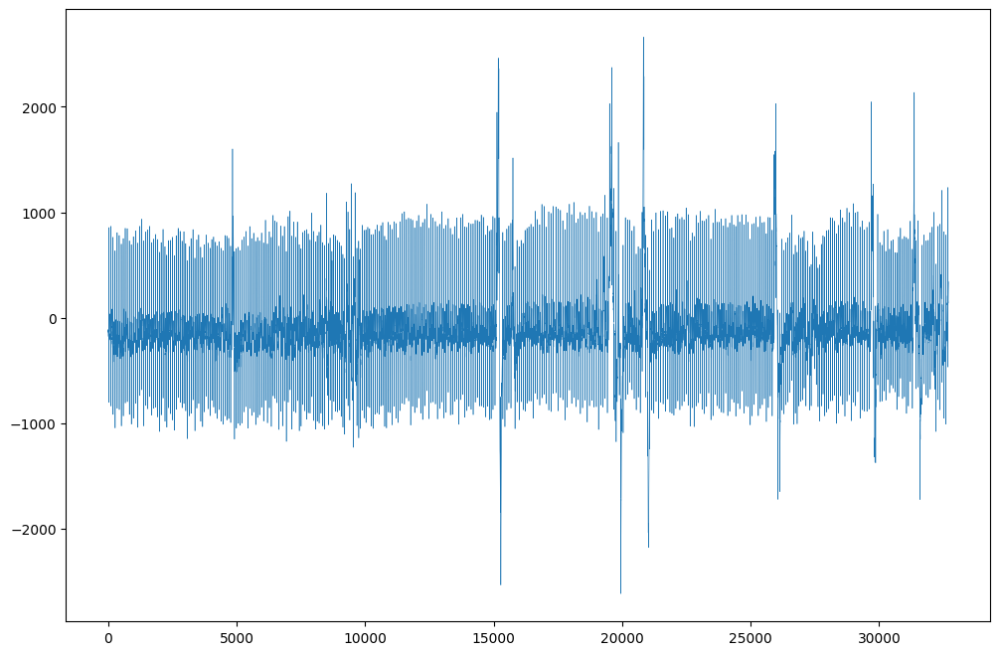

(M)001_20230507_094057_H10.csv
전체길이: 143518
시작 시간: 2023-05-07 09:43:00
시작 인덱스 값: 15917
기간 리스트: [Timestamp('2023-05-07 09:43:00'), Timestamp('2023-05-07 09:48:00'), Timestamp('2023-05-07 09:49:30'), Timestamp('2023-05-07 09:50:15'), Timestamp('2023-05-07 09:51:15'), Timestamp('2023-05-07 09:52:15'), Timestamp('2023-05-07 09:53:15'), Timestamp('2023-05-07 09:54:45'), Timestamp('2023-05-07 09:56:15'), Timestamp('2023-05-07 09:57:00'), Timestamp('2023-05-07 09:58:00')]
각 섹터 길이: [38971, 11691, 5846, 7795, 7794, 7795, 11692, 11692, 5846, 7795]
각 섹터: [15917, 54888, 66579, 72425, 80220, 88014, 95809, 107501, 119193, 125039, 132834]


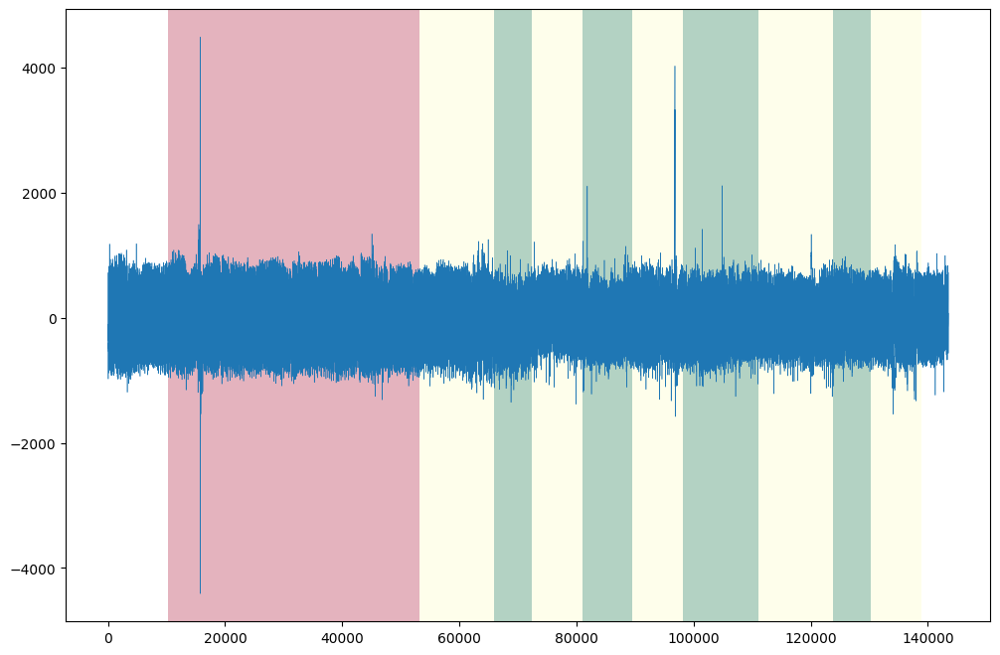

(M)002_20230507_103326_H10.csv
전체길이: 182573
시작 시간: 2023-05-07 10:39:00
시작 인덱스 값: 43280
기간 리스트: [Timestamp('2023-05-07 10:39:00'), Timestamp('2023-05-07 10:44:00'), Timestamp('2023-05-07 10:45:30'), Timestamp('2023-05-07 10:46:15'), Timestamp('2023-05-07 10:47:15'), Timestamp('2023-05-07 10:48:15'), Timestamp('2023-05-07 10:49:15'), Timestamp('2023-05-07 10:50:45'), Timestamp('2023-05-07 10:52:15'), Timestamp('2023-05-07 10:53:00'), Timestamp('2023-05-07 10:54:00')]
각 섹터 길이: [38971, 11692, 5845, 7795, 7795, 7794, 11692, 11692, 5846, 7795]
각 섹터: [43280, 82251, 93943, 99788, 107583, 115378, 123172, 134864, 146556, 152402, 160197]


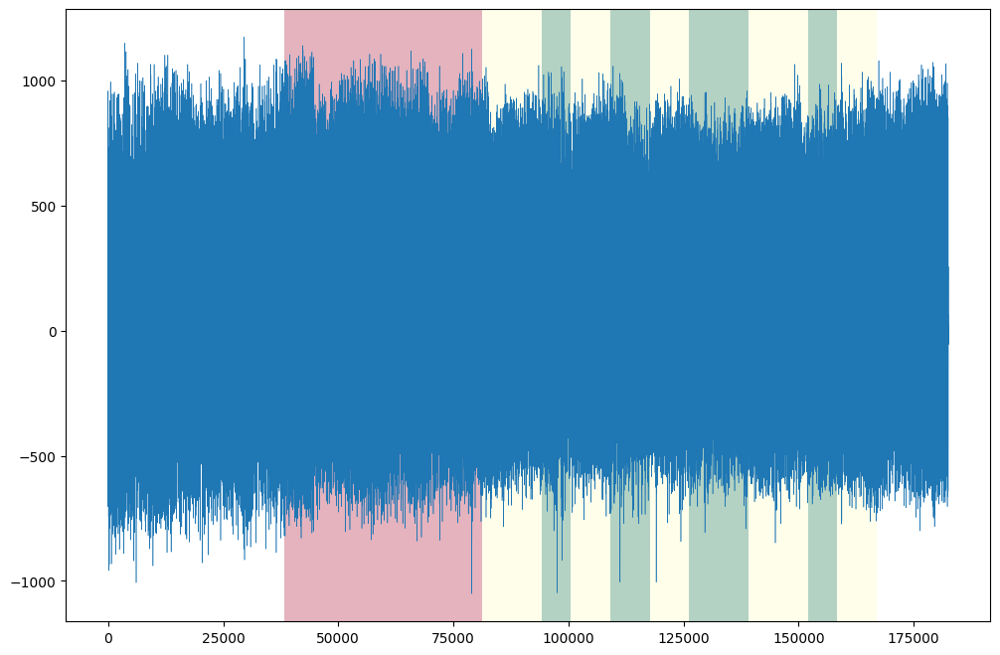

(M)003_20230507_090129_H10.csv
전체길이: 182062
시작 시간: 2023-05-07 09:07:00
시작 인덱스 값: 42889
기간 리스트: [Timestamp('2023-05-07 09:07:00'), Timestamp('2023-05-07 09:12:00'), Timestamp('2023-05-07 09:13:30'), Timestamp('2023-05-07 09:14:15'), Timestamp('2023-05-07 09:15:15'), Timestamp('2023-05-07 09:16:15'), Timestamp('2023-05-07 09:17:15'), Timestamp('2023-05-07 09:18:45'), Timestamp('2023-05-07 09:20:15'), Timestamp('2023-05-07 09:21:00'), Timestamp('2023-05-07 09:22:00')]
각 섹터 길이: [38972, 11692, 5846, 7794, 7795, 7795, 11692, 11692, 5846, 7795]
각 섹터: [42889, 81861, 93553, 99399, 107193, 114988, 122783, 134475, 146167, 152013, 159808]


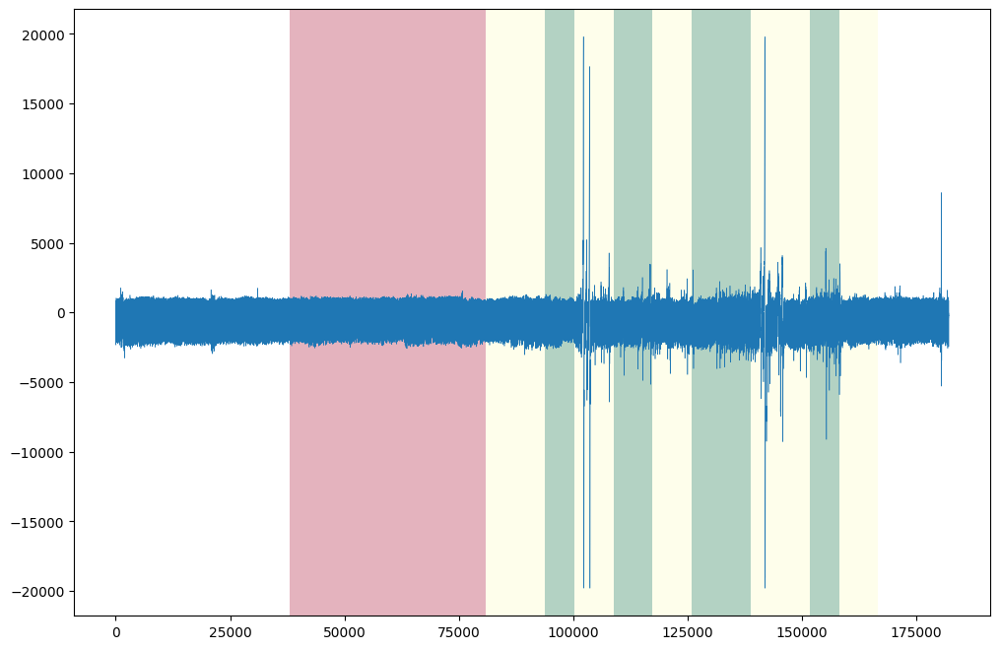

(M)004_20230507_093440_H10.csv
전체길이: 154906
시작 시간: 2023-05-07 09:39:00
시작 인덱스 값: 33744
기간 리스트: [Timestamp('2023-05-07 09:39:00'), Timestamp('2023-05-07 09:44:00'), Timestamp('2023-05-07 09:45:30'), Timestamp('2023-05-07 09:46:15'), Timestamp('2023-05-07 09:47:15'), Timestamp('2023-05-07 09:48:15'), Timestamp('2023-05-07 09:49:15'), Timestamp('2023-05-07 09:50:45'), Timestamp('2023-05-07 09:52:15'), Timestamp('2023-05-07 09:53:00'), Timestamp('2023-05-07 09:54:00')]
각 섹터 길이: [38966, 11692, 5845, 7795, 7794, 7795, 11692, 11692, 5846, 7795]
각 섹터: [33744, 72710, 84402, 90247, 98042, 105836, 113631, 125323, 137015, 142861, 150656]


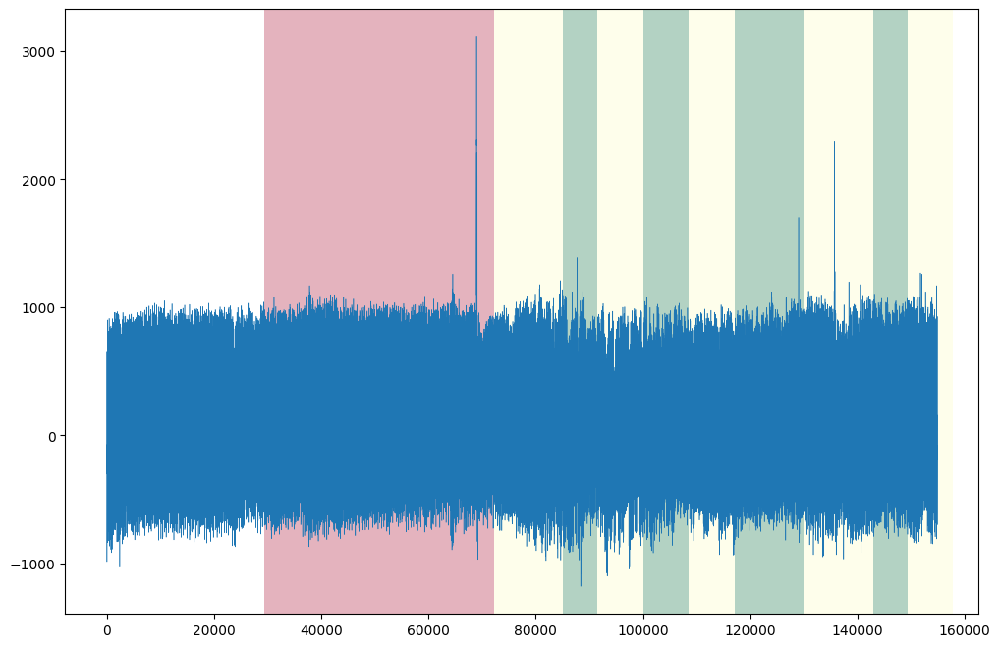

(M)005_20230507_113956_H10.csv
전체길이: 157242
시작 시간: 2023-05-07 11:44:00
시작 인덱스 값: 31589
기간 리스트: [Timestamp('2023-05-07 11:44:00'), Timestamp('2023-05-07 11:49:00'), Timestamp('2023-05-07 11:50:30'), Timestamp('2023-05-07 11:51:15'), Timestamp('2023-05-07 11:52:15'), Timestamp('2023-05-07 11:53:15'), Timestamp('2023-05-07 11:54:15'), Timestamp('2023-05-07 11:55:45'), Timestamp('2023-05-07 11:57:15'), Timestamp('2023-05-07 11:58:00'), Timestamp('2023-05-07 11:59:00')]
각 섹터 길이: [38968, 11690, 5846, 7793, 7794, 7794, 11691, 11690, 5846, 7794]
각 섹터: [31589, 70557, 82247, 88093, 95886, 103680, 111474, 123165, 134855, 140701, 148495]


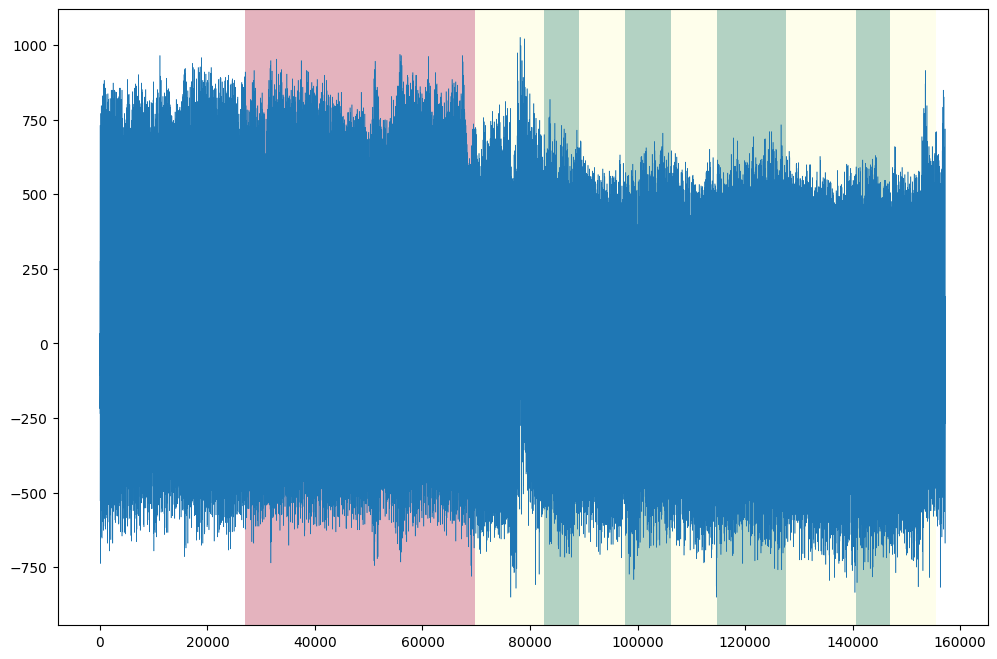

(M)006_20230507_110506_H10.csv
전체길이: 165053
시작 시간: 2023-05-07 11:11:00
시작 인덱스 값: 45863
기간 리스트: [Timestamp('2023-05-07 11:11:00'), Timestamp('2023-05-07 11:16:00'), Timestamp('2023-05-07 11:17:30'), Timestamp('2023-05-07 11:18:15'), Timestamp('2023-05-07 11:19:15'), Timestamp('2023-05-07 11:20:15'), Timestamp('2023-05-07 11:21:15'), Timestamp('2023-05-07 11:22:45'), Timestamp('2023-05-07 11:24:15'), Timestamp('2023-05-07 11:25:00'), Timestamp('2023-05-07 11:26:00')]
각 섹터 길이: [38968, 11691, 5845, 7794, 7793, 7794, 11691, 11690, 5845, 7794]
각 섹터: [45863, 84831, 96522, 102367, 110161, 117954, 125748, 137439, 149129, 154974, 162768]


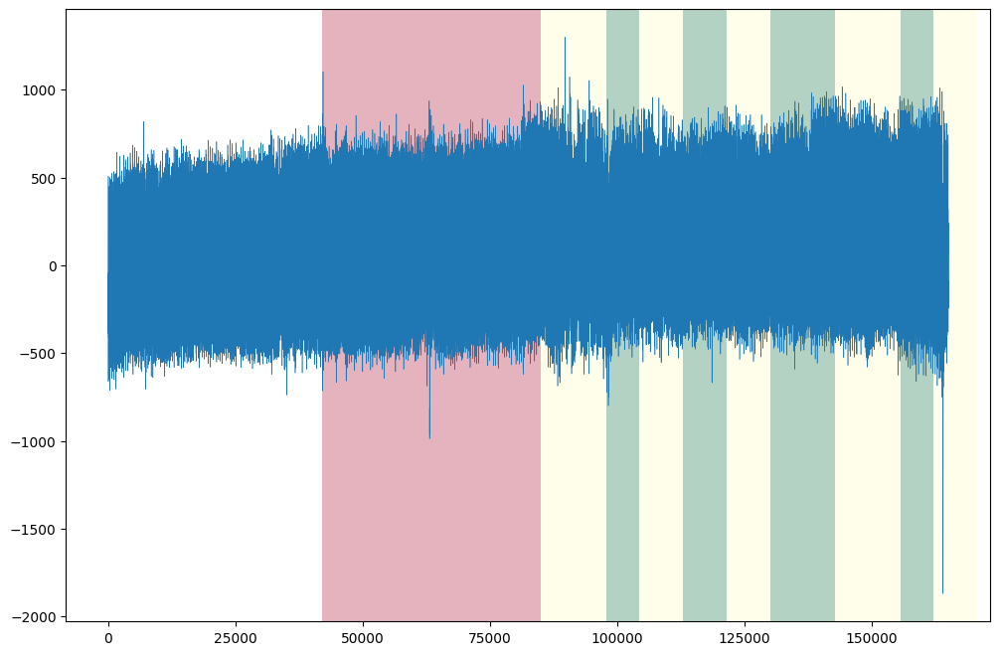

(M)007_20230507_110503_H10.csv
전체길이: 178631
시작 시간: 2023-05-07 11:10:00
시작 인덱스 값: 38537
기간 리스트: [Timestamp('2023-05-07 11:10:00'), Timestamp('2023-05-07 11:15:00'), Timestamp('2023-05-07 11:16:30'), Timestamp('2023-05-07 11:17:15'), Timestamp('2023-05-07 11:18:15'), Timestamp('2023-05-07 11:19:15'), Timestamp('2023-05-07 11:20:15'), Timestamp('2023-05-07 11:21:45'), Timestamp('2023-05-07 11:23:15'), Timestamp('2023-05-07 11:24:00'), Timestamp('2023-05-07 11:25:00')]
각 섹터 길이: [38967, 11691, 5845, 7794, 7794, 7794, 11692, 11691, 5846, 7794]
각 섹터: [38537, 77504, 89195, 95040, 102834, 110628, 118422, 130114, 141805, 147651, 155445]


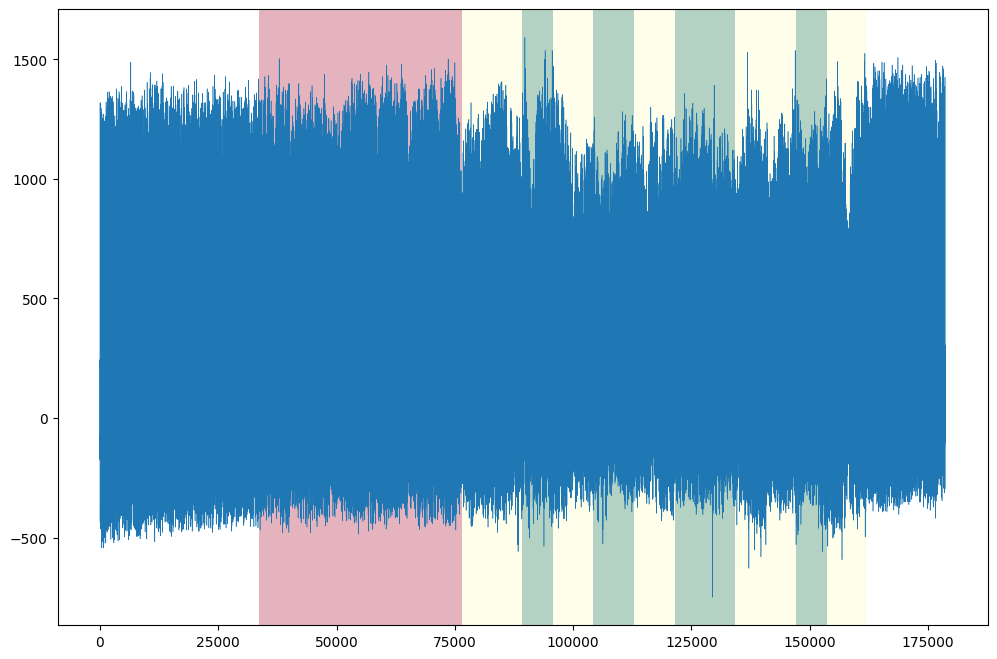

(M)008_20230507_113824_H10.csv
전체길이: 194107
시작 시간: 2023-05-07 11:40:00
시작 인덱스 값: 12462
기간 리스트: [Timestamp('2023-05-07 11:40:00'), Timestamp('2023-05-07 11:45:00'), Timestamp('2023-05-07 11:46:30'), Timestamp('2023-05-07 11:47:15'), Timestamp('2023-05-07 11:48:15'), Timestamp('2023-05-07 11:49:15'), Timestamp('2023-05-07 11:50:15'), Timestamp('2023-05-07 11:51:45'), Timestamp('2023-05-07 11:53:15'), Timestamp('2023-05-07 11:54:00'), Timestamp('2023-05-07 11:55:00')]
각 섹터 길이: [38975, 11694, 5847, 7796, 7796, 7797, 11695, 11694, 5848, 7796]
각 섹터: [12462, 51437, 63131, 68978, 76774, 84570, 92367, 104062, 115756, 121604, 129400]


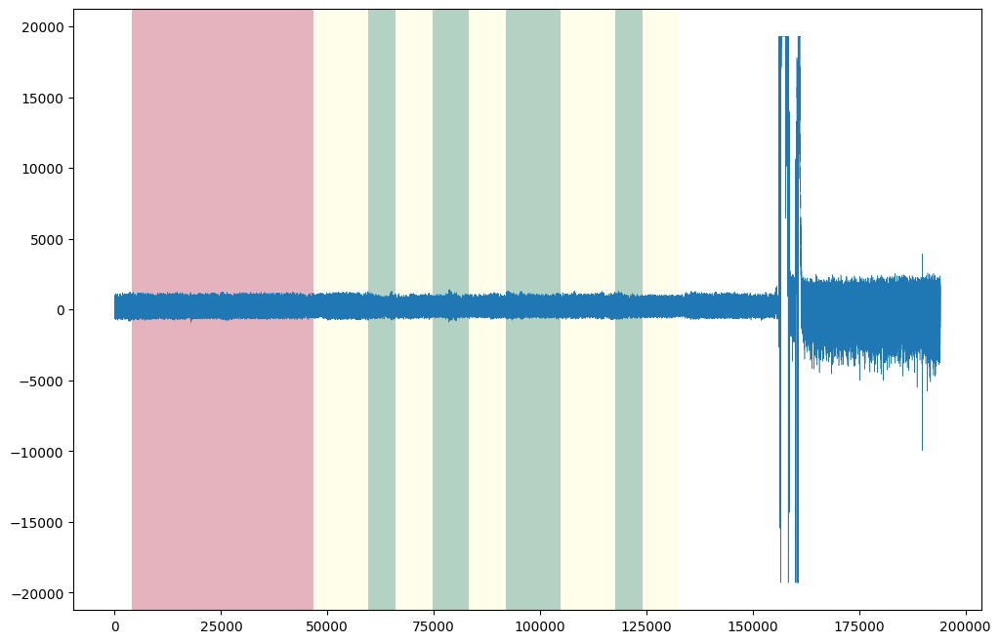

(M)009_20230507_095758_H10.csv
unknown error
전체길이: 100010
시작 시간: 2023-05-07 09:53:00
시작 인덱스 값: 12462
기간 리스트: [Timestamp('2023-05-07 09:53:00'), Timestamp('2023-05-07 09:58:00'), Timestamp('2023-05-07 09:59:30'), Timestamp('2023-05-07 10:00:15'), Timestamp('2023-05-07 10:01:15'), Timestamp('2023-05-07 10:02:15'), Timestamp('2023-05-07 10:03:15'), Timestamp('2023-05-07 10:04:45'), Timestamp('2023-05-07 10:06:15'), Timestamp('2023-05-07 10:07:00'), Timestamp('2023-05-07 10:08:00')]
각 섹터 길이: [153, 11693, 5847, 7796, 7796, 7797, 11694, 11696, 5847, 7797]
각 섹터: [12462, 12615, 24308, 30155, 37951, 45747, 53544, 65238, 76934, 82781, 90578]


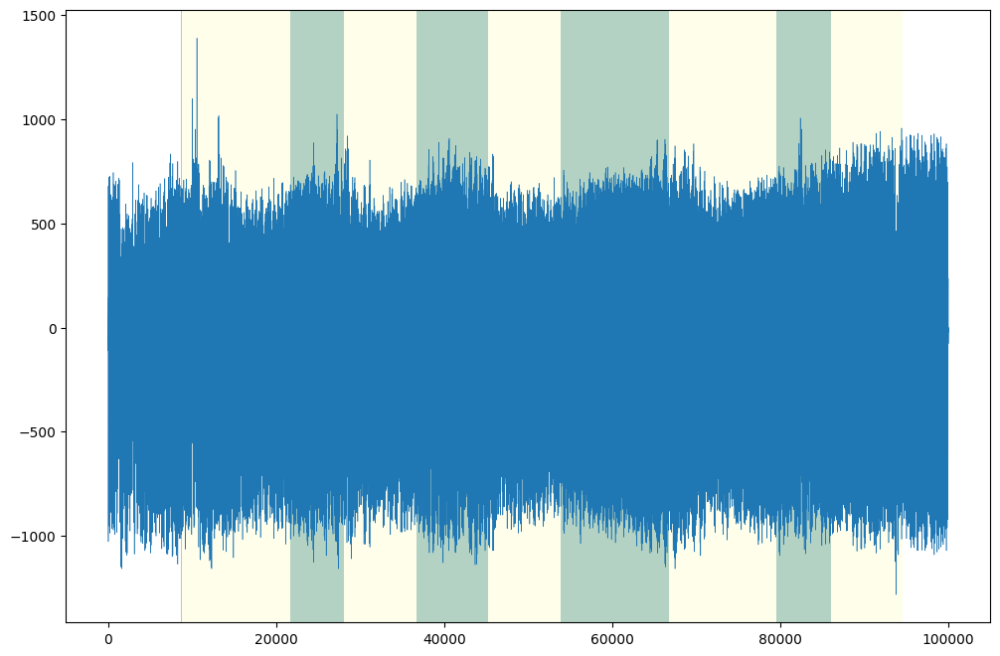

(M)010_20230507_103416_H10.csv
전체길이: 172134
시작 시간: 2023-05-07 10:39:00
시작 인덱스 값: 36807
기간 리스트: [Timestamp('2023-05-07 10:39:00'), Timestamp('2023-05-07 10:44:00'), Timestamp('2023-05-07 10:45:30'), Timestamp('2023-05-07 10:46:15'), Timestamp('2023-05-07 10:47:15'), Timestamp('2023-05-07 10:48:15'), Timestamp('2023-05-07 10:49:15'), Timestamp('2023-05-07 10:50:45'), Timestamp('2023-05-07 10:52:15'), Timestamp('2023-05-07 10:53:00'), Timestamp('2023-05-07 10:54:00')]
각 섹터 길이: [38975, 11693, 5847, 7795, 7796, 7795, 11693, 11693, 5847, 7795]
각 섹터: [36807, 75782, 87475, 93322, 101117, 108913, 116708, 128401, 140094, 145941, 153736]


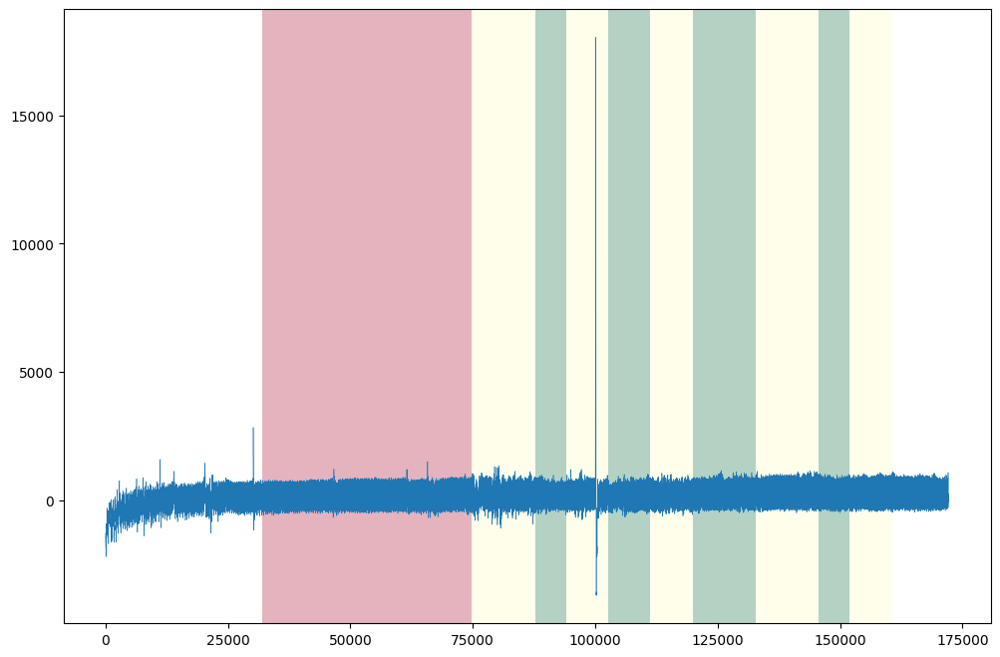

(M)011_20230507_120541_H10.csv
전체길이: 179945
시작 시간: 2023-05-07 12:10:00
시작 인덱스 값: 33581
기간 리스트: [Timestamp('2023-05-07 12:10:00'), Timestamp('2023-05-07 12:15:00'), Timestamp('2023-05-07 12:16:30'), Timestamp('2023-05-07 12:17:15'), Timestamp('2023-05-07 12:18:15'), Timestamp('2023-05-07 12:19:15'), Timestamp('2023-05-07 12:20:15'), Timestamp('2023-05-07 12:21:45'), Timestamp('2023-05-07 12:23:15'), Timestamp('2023-05-07 12:24:00'), Timestamp('2023-05-07 12:25:00')]
각 섹터 길이: [38977, 11694, 5847, 7796, 7796, 7796, 11694, 11695, 5847, 7797]
각 섹터: [33581, 72558, 84252, 90099, 97895, 105691, 113487, 125181, 136876, 142723, 150520]


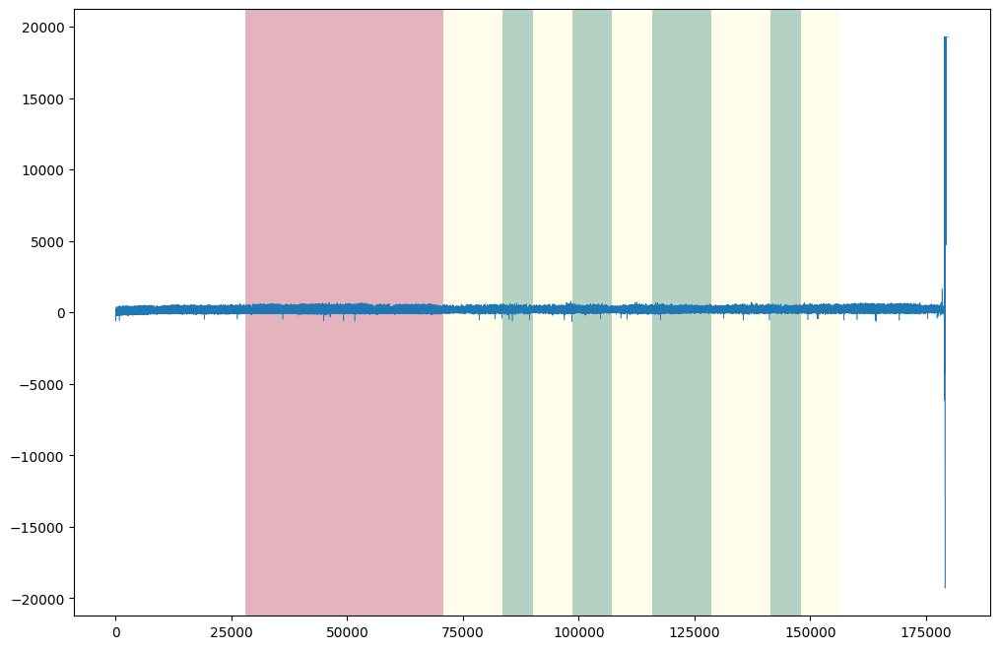

(M)012_20230507_093010_H10.csv
전체길이: 172134
시작 시간: 2023-05-07 09:35:00
시작 인덱스 값: 37549
기간 리스트: [Timestamp('2023-05-07 09:35:00'), Timestamp('2023-05-07 09:40:00'), Timestamp('2023-05-07 09:41:30'), Timestamp('2023-05-07 09:42:15'), Timestamp('2023-05-07 09:43:15'), Timestamp('2023-05-07 09:44:15'), Timestamp('2023-05-07 09:45:15'), Timestamp('2023-05-07 09:46:45'), Timestamp('2023-05-07 09:48:15'), Timestamp('2023-05-07 09:49:00'), Timestamp('2023-05-07 09:50:00')]
각 섹터 길이: [38973, 11692, 5846, 7795, 7795, 7795, 11692, 11693, 5846, 7795]
각 섹터: [37549, 76522, 88214, 94060, 101855, 109650, 117445, 129137, 140830, 146676, 154471]


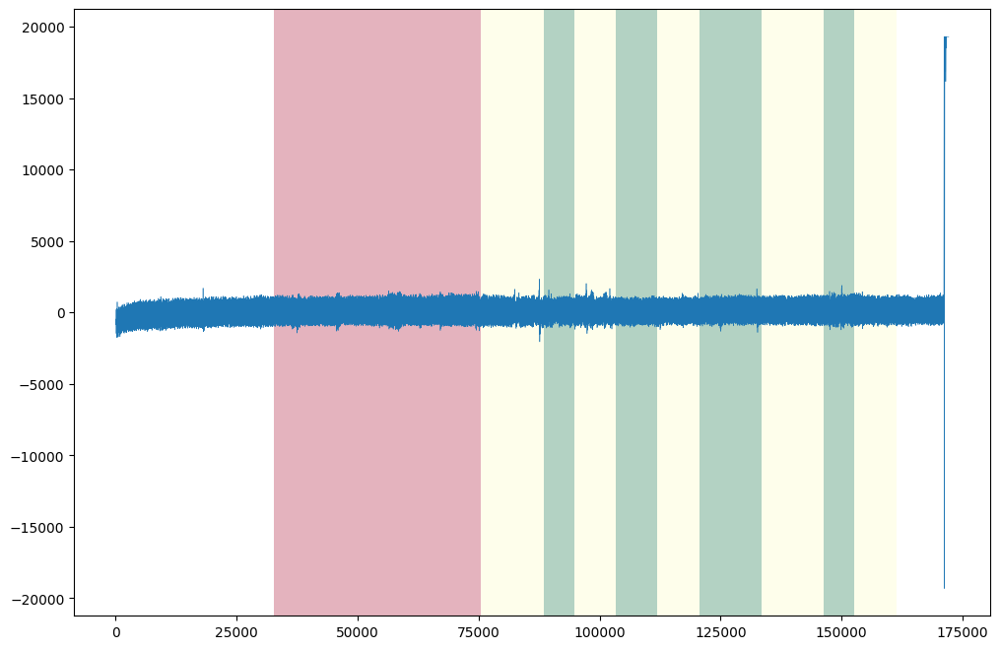

(M)013_20230507_113448_H10.csv
전체길이: 191406
시작 시간: 2023-05-07 11:40:00
시작 인덱스 값: 40431
기간 리스트: [Timestamp('2023-05-07 11:40:00'), Timestamp('2023-05-07 11:45:00'), Timestamp('2023-05-07 11:46:30'), Timestamp('2023-05-07 11:47:15'), Timestamp('2023-05-07 11:48:15'), Timestamp('2023-05-07 11:49:15'), Timestamp('2023-05-07 11:50:15'), Timestamp('2023-05-07 11:51:45'), Timestamp('2023-05-07 11:53:15'), Timestamp('2023-05-07 11:54:00'), Timestamp('2023-05-07 11:55:00')]
각 섹터 길이: [38975, 11692, 5847, 7795, 7795, 7795, 11693, 11693, 5846, 7795]
각 섹터: [40431, 79406, 91098, 96945, 104740, 112535, 120330, 132023, 143716, 149562, 157357]


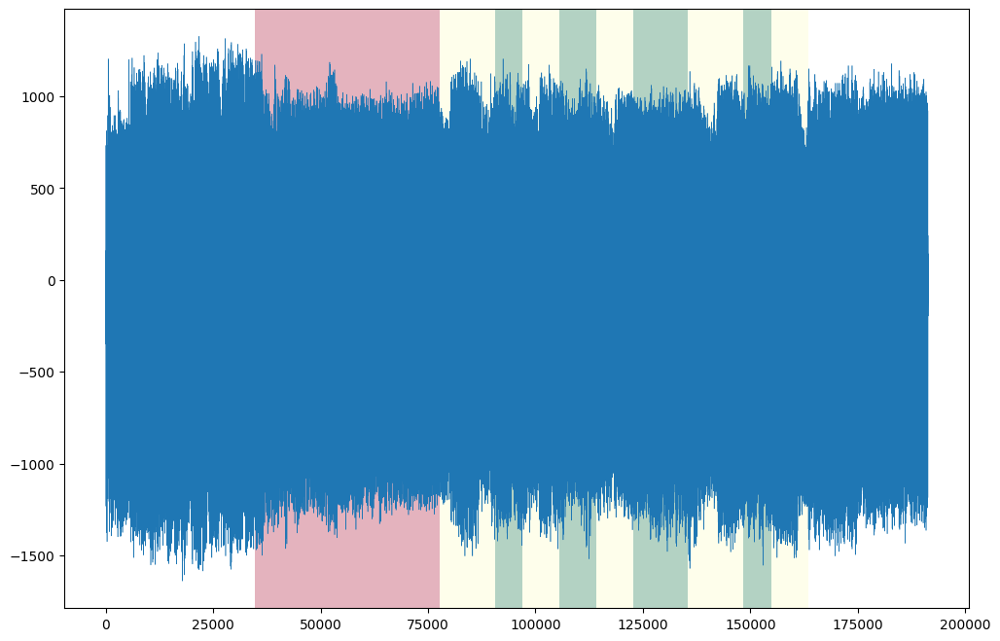

(M)014_20230507_095721_H10.csv
unknown error
전체길이: 85629
시작 시간: 2023-05-07 09:50:00
시작 인덱스 값: 40431
기간 리스트: [Timestamp('2023-05-07 09:50:00'), Timestamp('2023-05-07 09:55:00'), Timestamp('2023-05-07 09:56:30'), Timestamp('2023-05-07 09:57:15'), Timestamp('2023-05-07 09:58:15'), Timestamp('2023-05-07 09:59:15'), Timestamp('2023-05-07 10:00:15'), Timestamp('2023-05-07 10:01:45'), Timestamp('2023-05-07 10:03:15'), Timestamp('2023-05-07 10:04:00'), Timestamp('2023-05-07 10:05:00')]
각 섹터 길이: [0, 0, 0, 6993, 7795, 7795, 11692, 11692, 5846, 7795]
각 섹터: [40431, 40431, 40431, 40431, 47424, 55219, 63014, 74706, 86398, 92244, 100039]


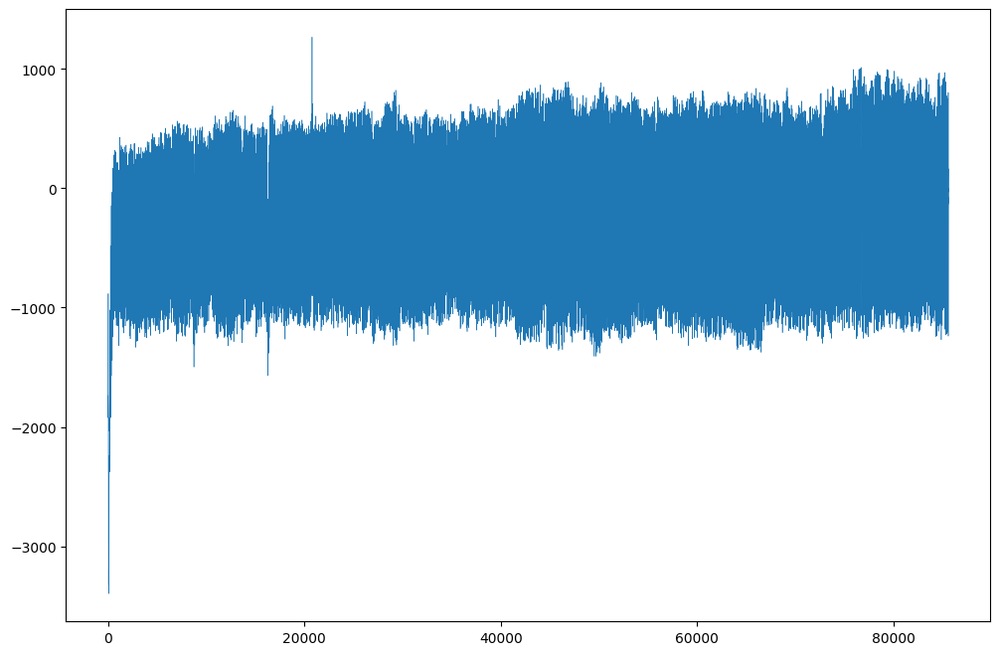

(M)016_20230507_085913_H10.csv
전체길이: 183011
시작 시간: 2023-05-07 09:05:00
시작 인덱스 값: 45024
기간 리스트: [Timestamp('2023-05-07 09:05:00'), Timestamp('2023-05-07 09:10:00'), Timestamp('2023-05-07 09:11:30'), Timestamp('2023-05-07 09:12:15'), Timestamp('2023-05-07 09:13:15'), Timestamp('2023-05-07 09:14:15'), Timestamp('2023-05-07 09:15:15'), Timestamp('2023-05-07 09:16:45'), Timestamp('2023-05-07 09:18:15'), Timestamp('2023-05-07 09:19:00'), Timestamp('2023-05-07 09:20:00')]
각 섹터 길이: [38968, 11691, 5845, 7794, 7794, 7794, 11690, 11691, 5845, 7794]
각 섹터: [45024, 83992, 95683, 101528, 109322, 117116, 124910, 136600, 148291, 154136, 161930]


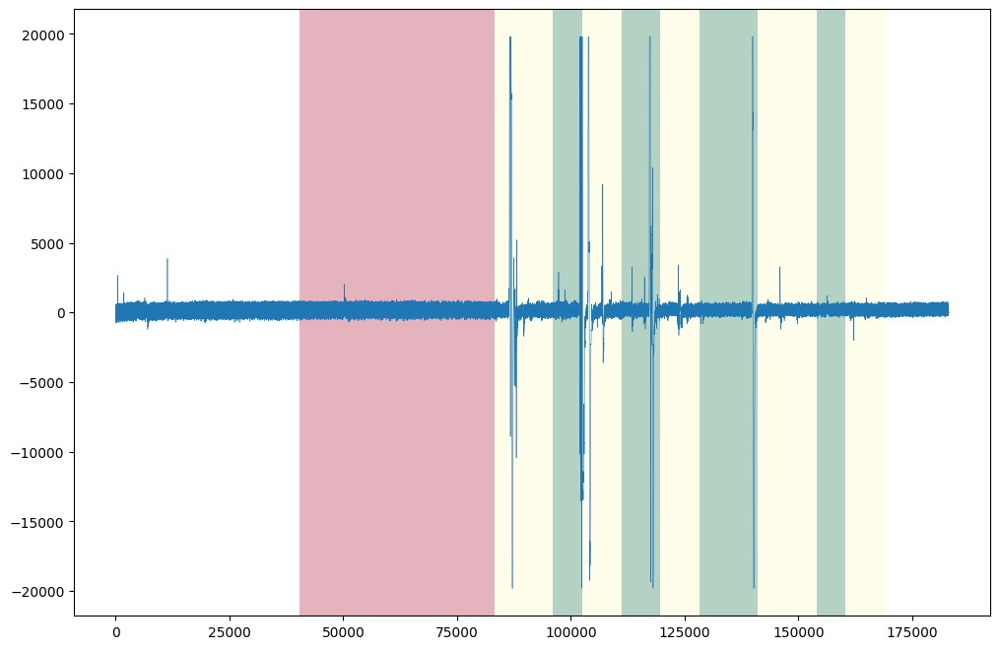

(M)017_20230507_110427_H10.csv
전체길이: 181259
시작 시간: 2023-05-07 11:09:00
시작 인덱스 값: 35442
기간 리스트: [Timestamp('2023-05-07 11:09:00'), Timestamp('2023-05-07 11:14:00'), Timestamp('2023-05-07 11:15:30'), Timestamp('2023-05-07 11:16:15'), Timestamp('2023-05-07 11:17:15'), Timestamp('2023-05-07 11:18:15'), Timestamp('2023-05-07 11:19:15'), Timestamp('2023-05-07 11:20:45'), Timestamp('2023-05-07 11:22:15'), Timestamp('2023-05-07 11:23:00'), Timestamp('2023-05-07 11:24:00')]
각 섹터 길이: [38975, 11693, 5846, 7796, 7795, 7795, 11693, 11693, 5846, 7796]
각 섹터: [35442, 74417, 86110, 91956, 99752, 107547, 115342, 127035, 138728, 144574, 152370]


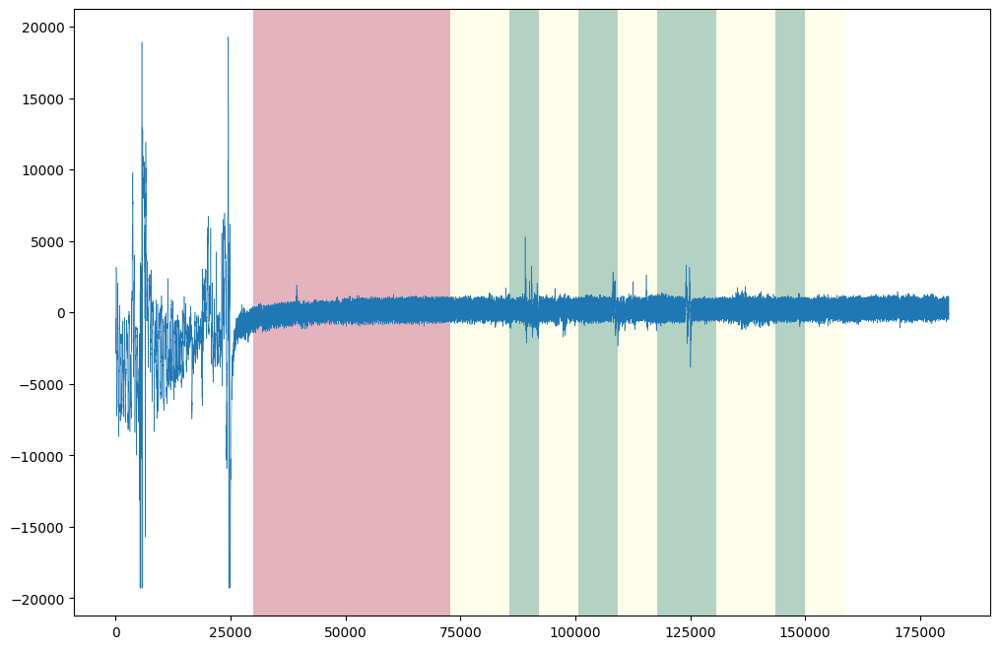

(M)018_20230507_100932_H10.csv
전체길이: 175492
시작 시간: 2023-05-07 10:16:00
시작 인덱스 값: 50309
기간 리스트: [Timestamp('2023-05-07 10:16:00'), Timestamp('2023-05-07 10:21:00'), Timestamp('2023-05-07 10:22:30'), Timestamp('2023-05-07 10:23:15'), Timestamp('2023-05-07 10:24:15'), Timestamp('2023-05-07 10:25:15'), Timestamp('2023-05-07 10:26:15'), Timestamp('2023-05-07 10:27:45'), Timestamp('2023-05-07 10:29:15'), Timestamp('2023-05-07 10:30:00'), Timestamp('2023-05-07 10:31:00')]
각 섹터 길이: [38973, 11692, 5846, 7794, 7795, 7794, 11692, 11692, 5846, 7795]
각 섹터: [50309, 89282, 100974, 106820, 114614, 122409, 130203, 141895, 153587, 159433, 167228]


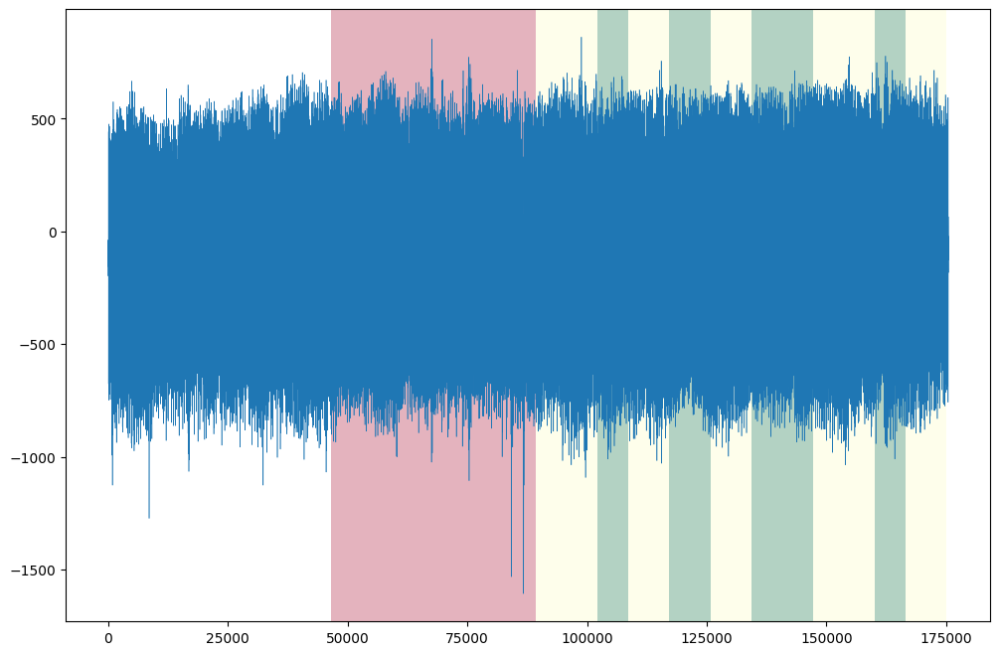

(M)019_20230507_101420_H10.csv
unknown error
전체길이: 131400
시작 시간: 2023-05-07 10:12:00
시작 인덱스 값: 50309
기간 리스트: [Timestamp('2023-05-07 10:12:00'), Timestamp('2023-05-07 10:17:00'), Timestamp('2023-05-07 10:18:30'), Timestamp('2023-05-07 10:19:15'), Timestamp('2023-05-07 10:20:15'), Timestamp('2023-05-07 10:21:15'), Timestamp('2023-05-07 10:22:15'), Timestamp('2023-05-07 10:23:45'), Timestamp('2023-05-07 10:25:15'), Timestamp('2023-05-07 10:26:00'), Timestamp('2023-05-07 10:27:00')]
각 섹터 길이: [20691, 11692, 5846, 7796, 7795, 7795, 11692, 11693, 5846, 7796]
각 섹터: [50309, 71000, 82692, 88538, 96334, 104129, 111924, 123616, 135309, 141155, 148951]


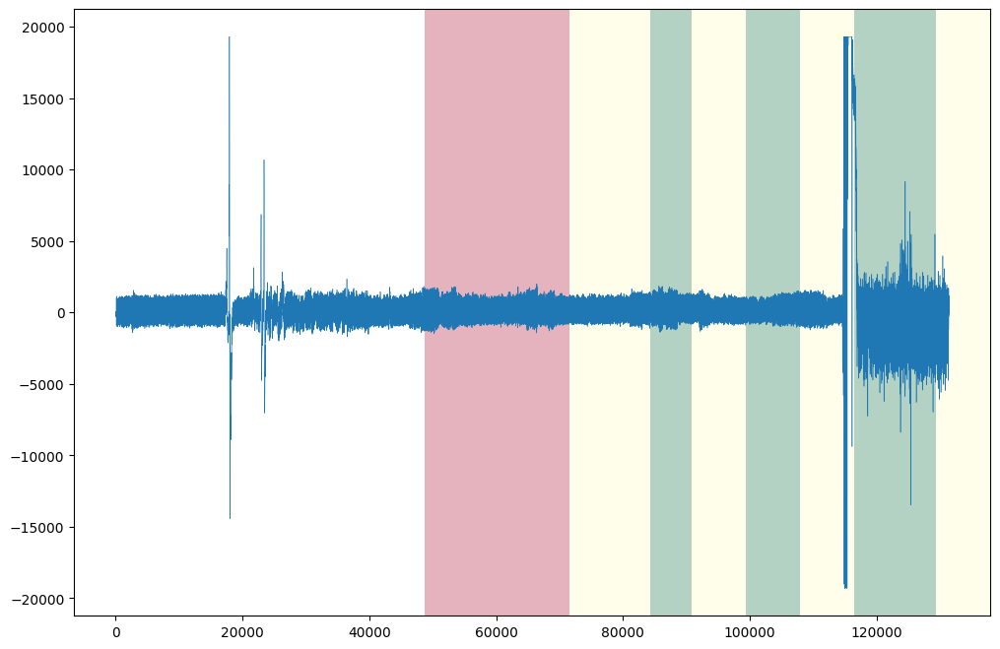

(M)020_20230507_122941_H10.csv
전체길이: 148628
시작 시간: 2023-05-07 12:32:00
시작 인덱스 값: 18028
기간 리스트: [Timestamp('2023-05-07 12:32:00'), Timestamp('2023-05-07 12:37:00'), Timestamp('2023-05-07 12:38:30'), Timestamp('2023-05-07 12:39:15'), Timestamp('2023-05-07 12:40:15'), Timestamp('2023-05-07 12:41:15'), Timestamp('2023-05-07 12:42:15'), Timestamp('2023-05-07 12:43:45'), Timestamp('2023-05-07 12:45:15'), Timestamp('2023-05-07 12:46:00'), Timestamp('2023-05-07 12:47:00')]
각 섹터 길이: [38967, 11690, 5845, 7794, 7794, 7793, 11691, 11691, 5845, 7794]
각 섹터: [18028, 56995, 68685, 74530, 82324, 90118, 97911, 109602, 121293, 127138, 134932]


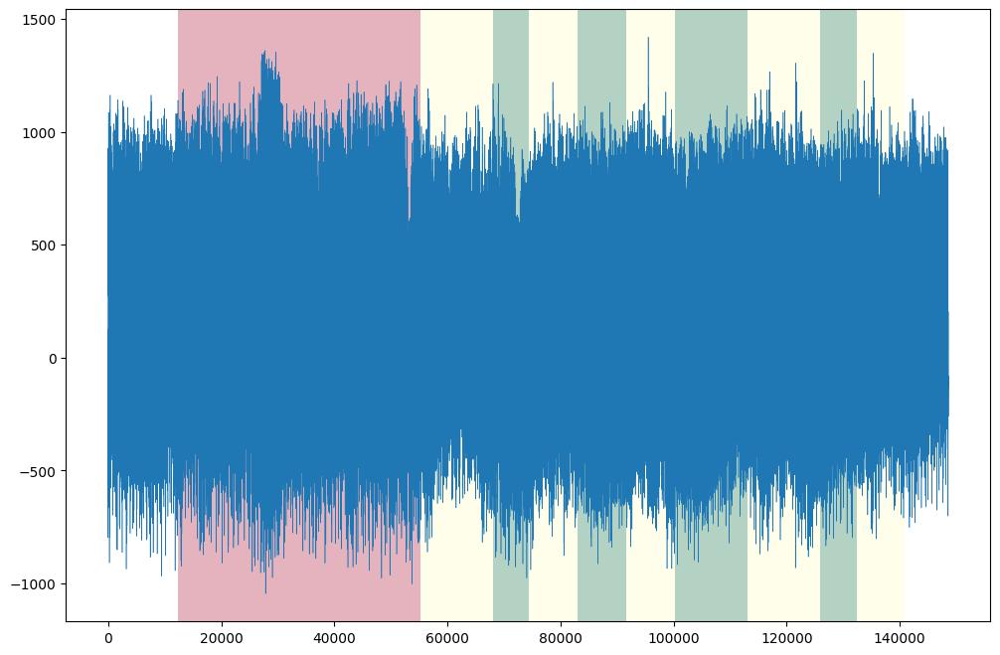

In [47]:
for i in mast_h10_dict:
    
    print(i)
    cid = int(i[3:6])
    # print(mast_h10_dict[i][mast_h10_dict[i]['times'] >= (df[df['id'] == cid].iloc[0]['mast_start_time'])].head())
    
    #start 시간은 마스트 시작 시간 5분 전
    start_time = df[df['id'] == cid].iloc[0]['mast_start_time']
    try:
        start_index = mast_h10_dict[i][mast_h10_dict[i]['times'] >= start_time].min().idx
    except:
        print('unknown error')
        pass
    print('전체길이:',len(mast_h10_dict[i]))
    print('시작 시간:', start_time)
    print('시작 인덱스 값:', start_index)
    
    #시작 시간 init
    period= start_time
    period_ls = [start_time] # [휴식, HIT, N, HIT ...]
    
    #sector init
    period_sector = [start_index] # 마커 리스트
    part_len = [] # 각 파트 길이
    tmp =  start_index # 길이 계산용
    
    
    #MAST_TIME_TABLE에 따라서 설정
    for s in MAST_TIME_TABLE:
        #시작 시간 + 섹션 길이
        period += datetime.timedelta(seconds = s)
        # 기간 리스트에 추가
        period_ls.append(period) 
    print('기간 리스트:',period_ls)
        
    #기간 리스트에 따라서 길이 계산    
    for j in range(len(period_ls)-1):
        #n-1 ~ n 기간 길이 계산 
        period_length = len(mast_h10_dict[i][mast_h10_dict[i].times.between(period_ls[j], period_ls[j+1]) == True])
        #부분 인덱스 길이 리스트에 추가 
        part_len.append(period_length)

        #전체 인덱스 길이 계산 즉 이게 마커
        tmp += period_length
        #섹터 리스트에 추가 마커 리스트
        period_sector.append(tmp)
    
    print('각 섹터 길이:',part_len)
    print('각 섹터:', period_sector)
    # 프로토콜 번호 지정
    for j in range(len(period_sector)-1):
        if period_sector[j] < period_sector[j+1]:
            mast_h10_dict[i].loc[period_sector[j]+1:period_sector[j+1], 'proc'] = MAST_PROTOCOL[j]
            
        else:
            break
    
    fig = plt.figure(figsize=(12,8), facecolor='white')
    axes = mast_h10_dict[i]['sensor'].plot(linewidth = 0.4)
    cmap = mpl.colormaps.get_cmap('Set3')
    axes.pcolorfast(axes.get_xlim(), axes.get_ylim(), mast_h10_dict[i]['proc'].values[np.newaxis],
              cmap='RdYlGn', alpha=0.3)
    plt.show()
       

(M)001_20230507_093641_H10.csv
(M)001_20230507_094057_H10.csv
1.0
프로토콜: 1.0 BASELINE


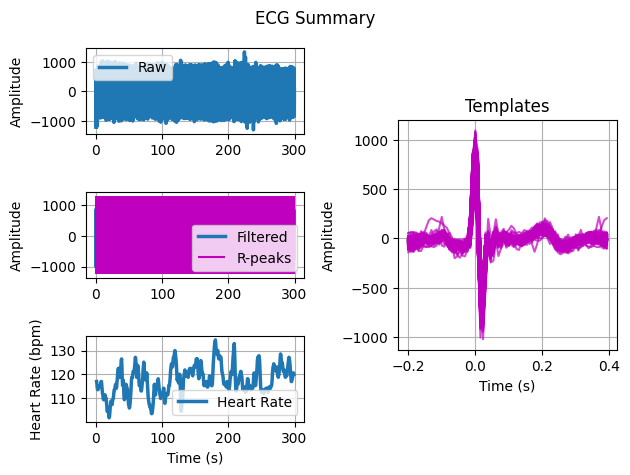

2.0
프로토콜: 2.0 HIT


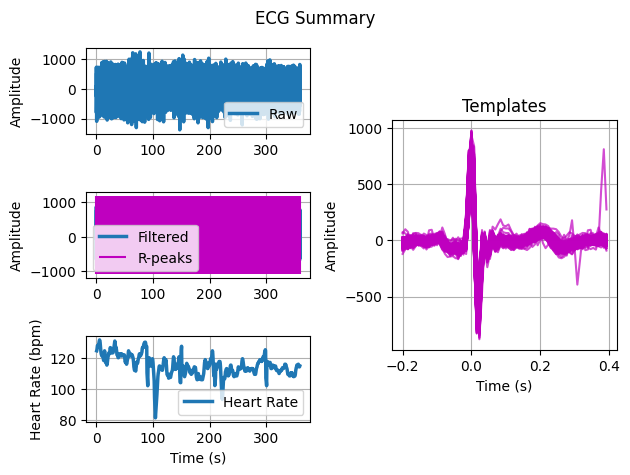

3.0
프로토콜: 3.0 MA


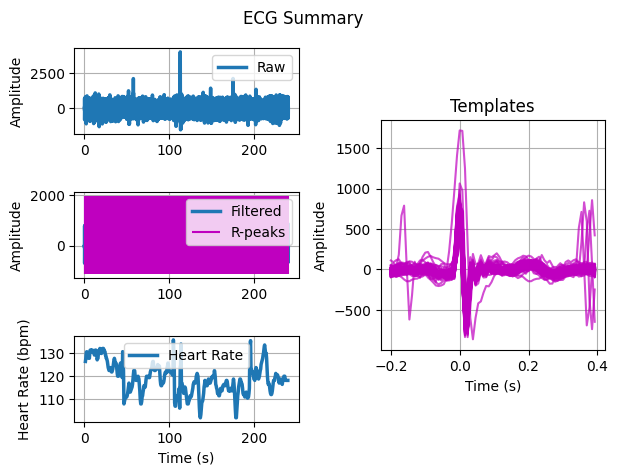

(M)002_20230507_103326_H10.csv
1.0
프로토콜: 1.0 BASELINE


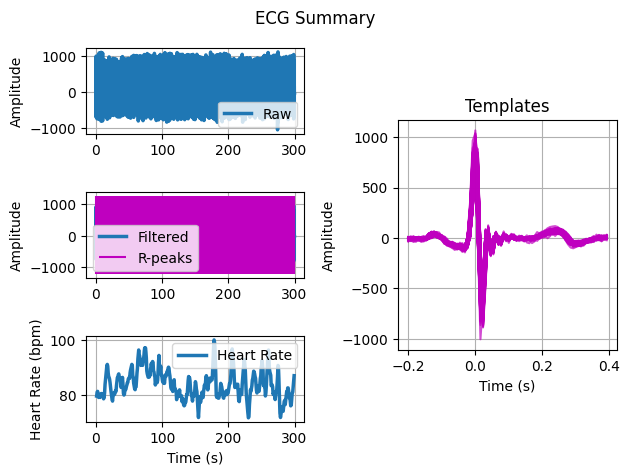

2.0
프로토콜: 2.0 HIT


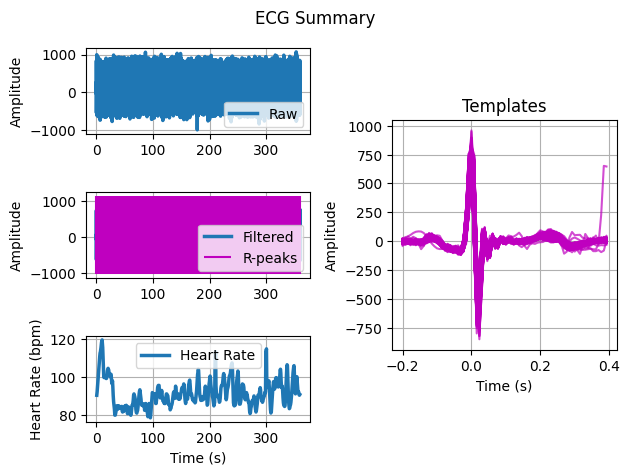

3.0
프로토콜: 3.0 MA


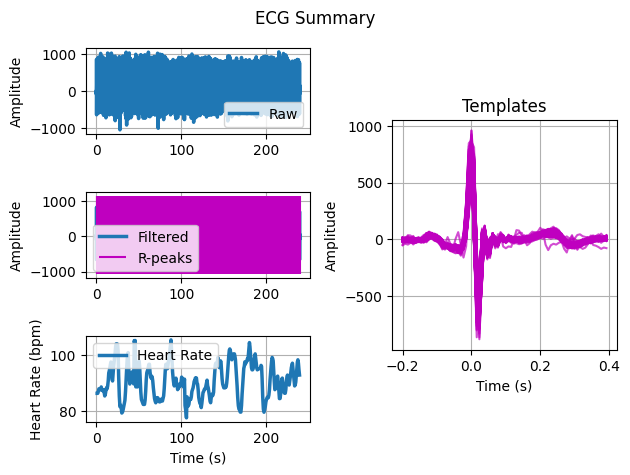

(M)003_20230507_090129_H10.csv
1.0
프로토콜: 1.0 BASELINE


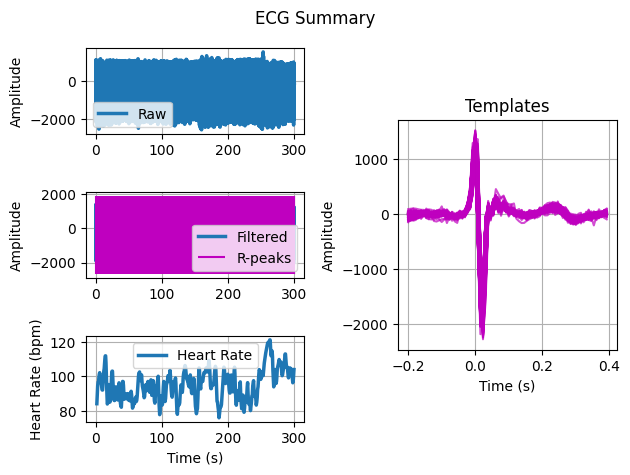

2.0
프로토콜: 2.0 HIT


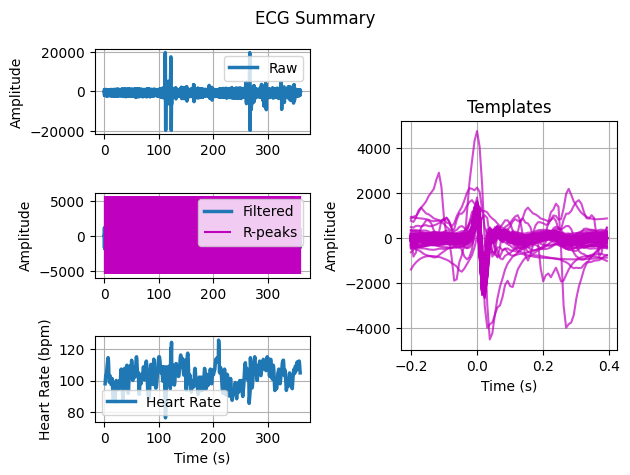

3.0
프로토콜: 3.0 MA


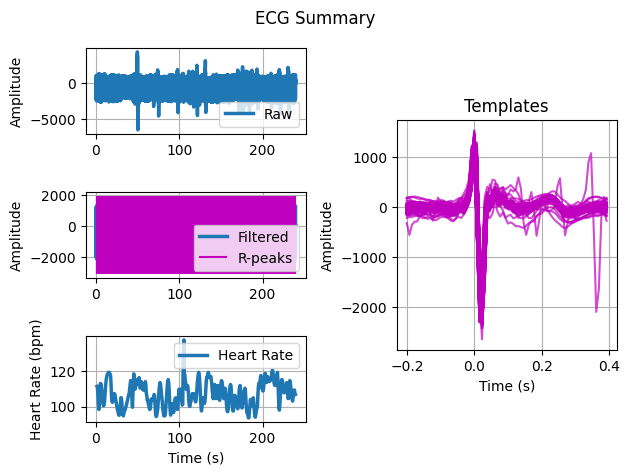

(M)004_20230507_093440_H10.csv
1.0
프로토콜: 1.0 BASELINE


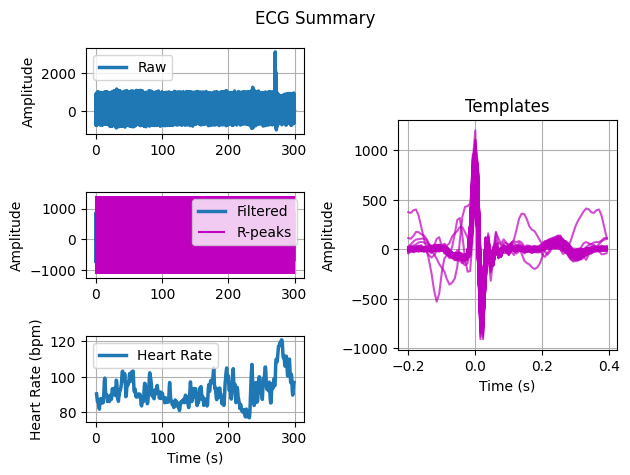

2.0
프로토콜: 2.0 HIT


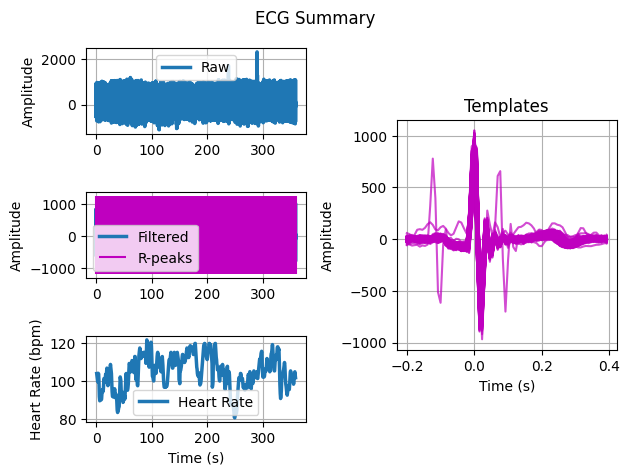

3.0
프로토콜: 3.0 MA


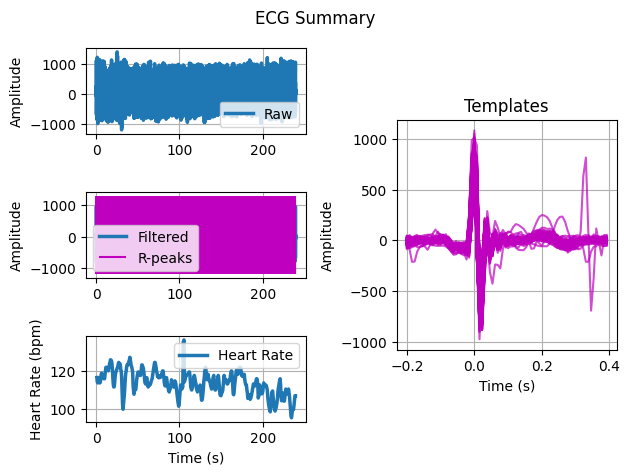

(M)005_20230507_113956_H10.csv
1.0
프로토콜: 1.0 BASELINE


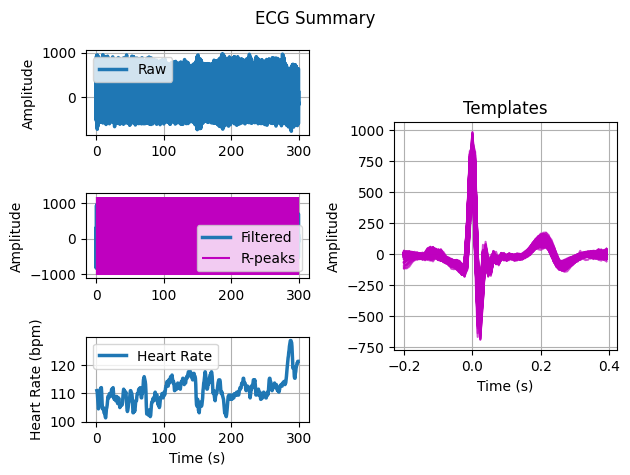

2.0
프로토콜: 2.0 HIT


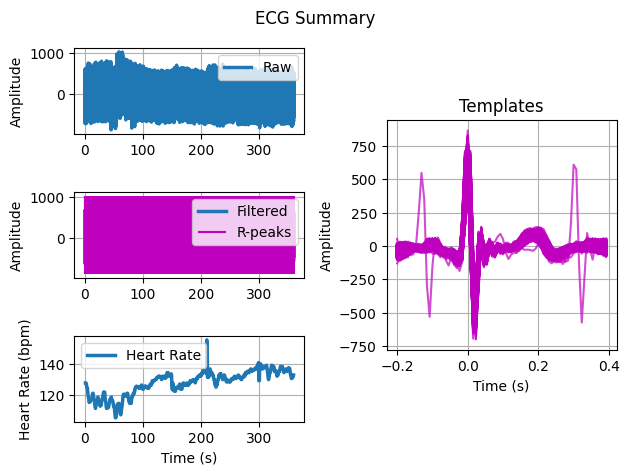

3.0
프로토콜: 3.0 MA


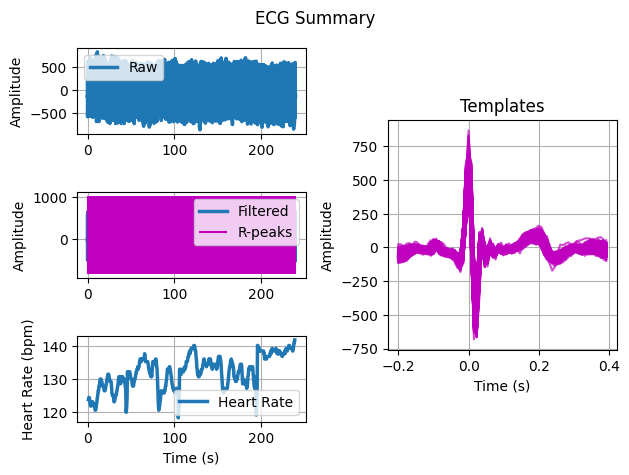

(M)006_20230507_110506_H10.csv
1.0
프로토콜: 1.0 BASELINE


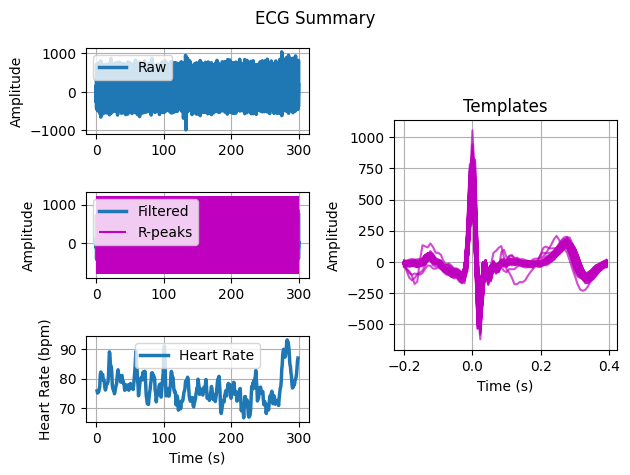

2.0
프로토콜: 2.0 HIT


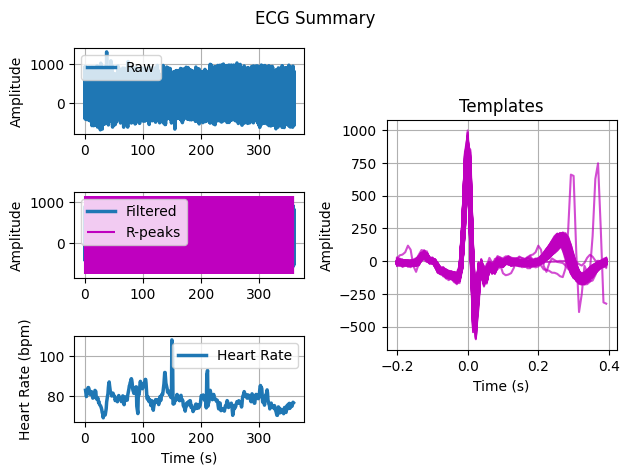

3.0
프로토콜: 3.0 MA


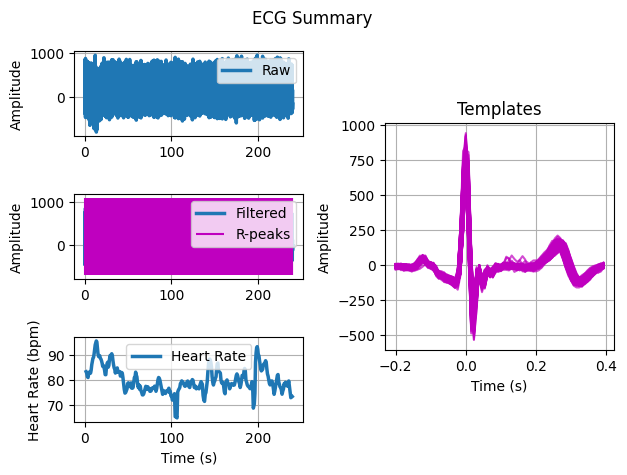

(M)007_20230507_110503_H10.csv
1.0
프로토콜: 1.0 BASELINE


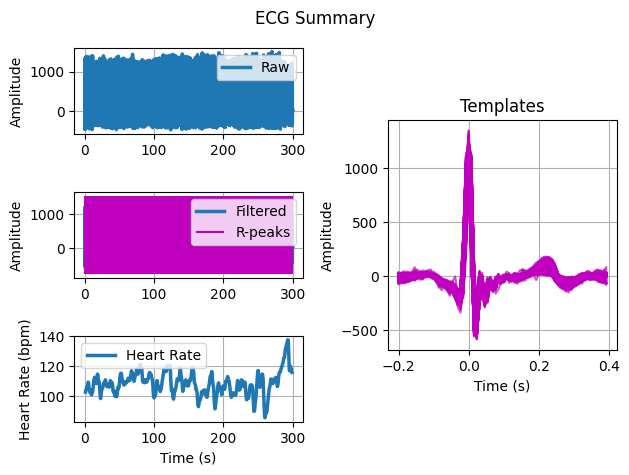

2.0
프로토콜: 2.0 HIT


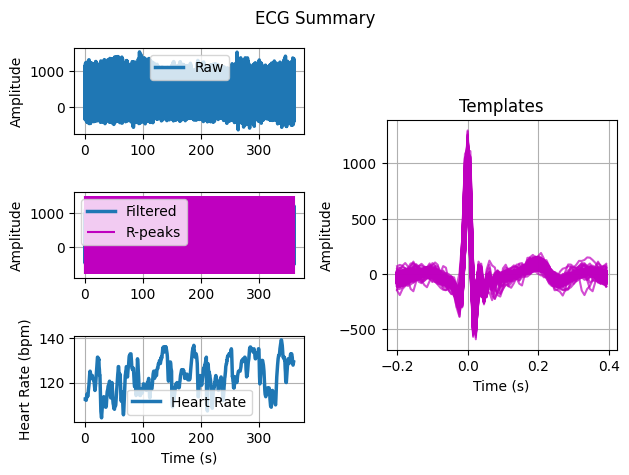

3.0
프로토콜: 3.0 MA


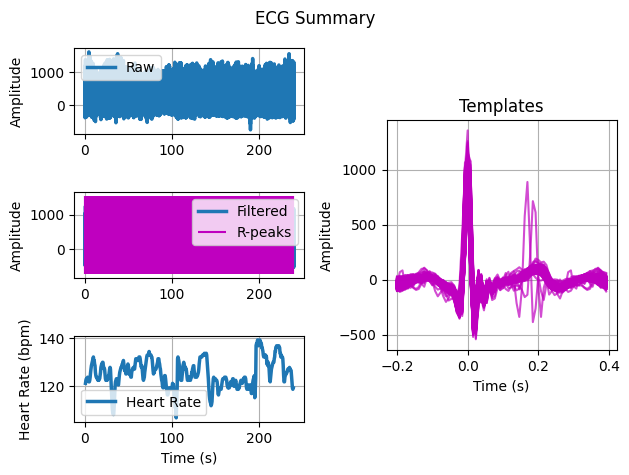

(M)008_20230507_113824_H10.csv
1.0
프로토콜: 1.0 BASELINE


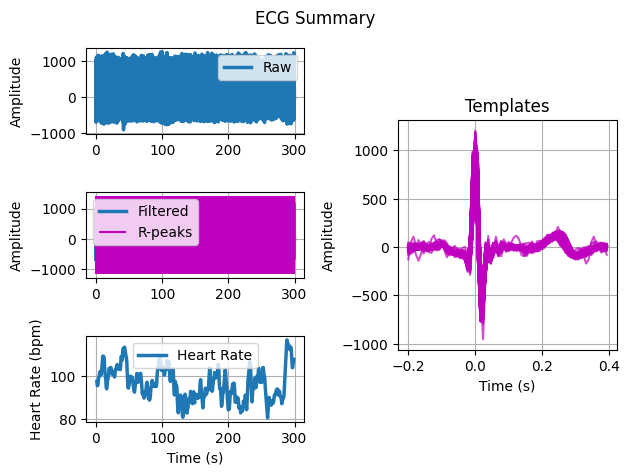

2.0
프로토콜: 2.0 HIT


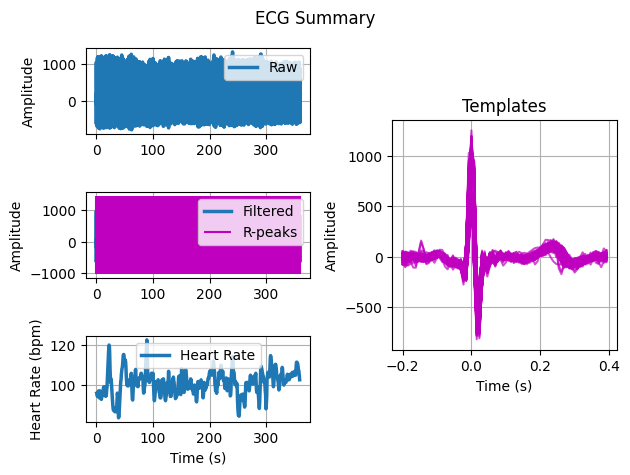

3.0
프로토콜: 3.0 MA


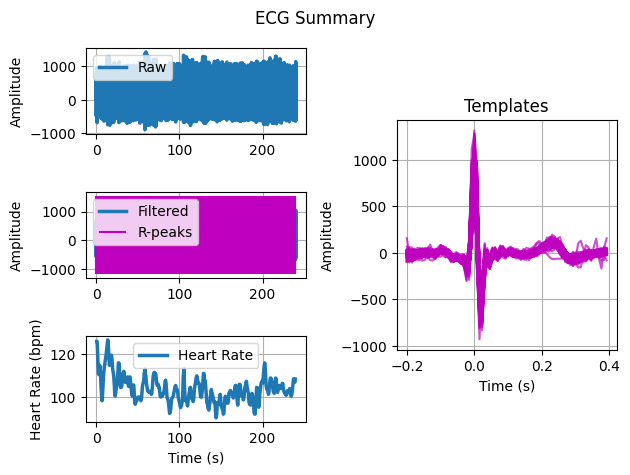

(M)009_20230507_095758_H10.csv
1.0
프로토콜: 1.0 BASELINE
 VALUE ERROR
------------------------------
2.0
프로토콜: 2.0 HIT


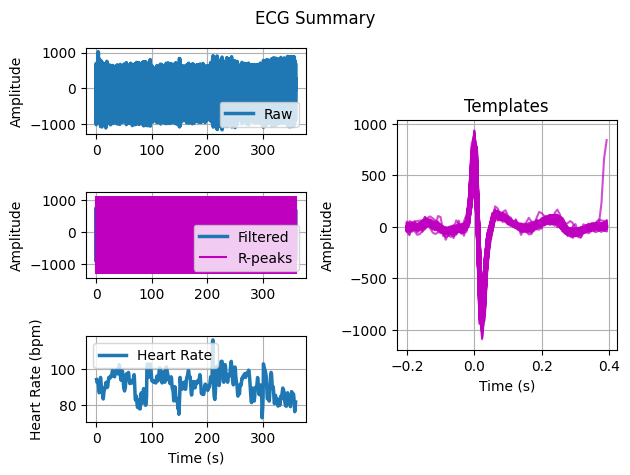

3.0
프로토콜: 3.0 MA


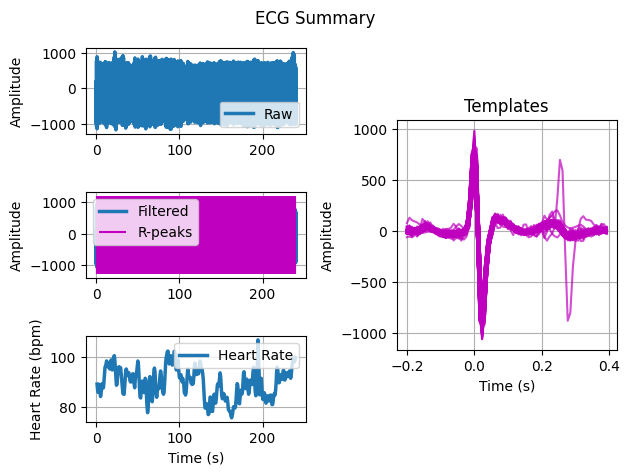

(M)010_20230507_103416_H10.csv
1.0
프로토콜: 1.0 BASELINE


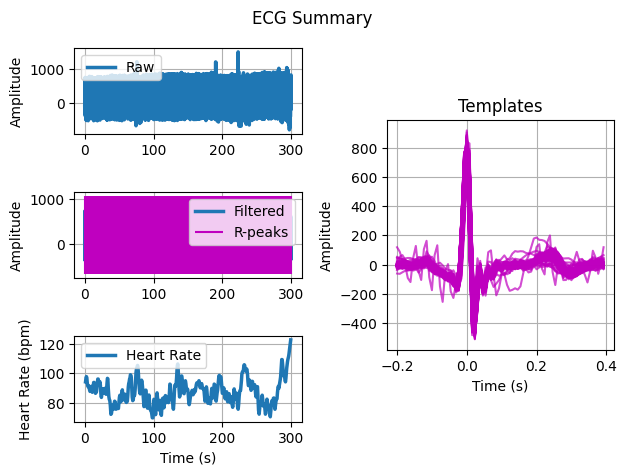

2.0
프로토콜: 2.0 HIT


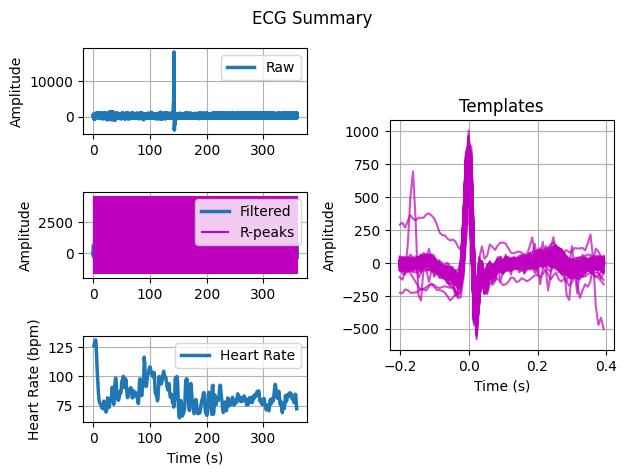

3.0
프로토콜: 3.0 MA


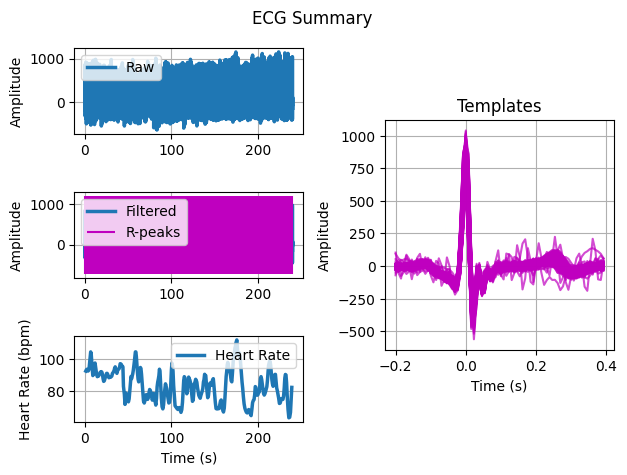

(M)011_20230507_120541_H10.csv
1.0
프로토콜: 1.0 BASELINE


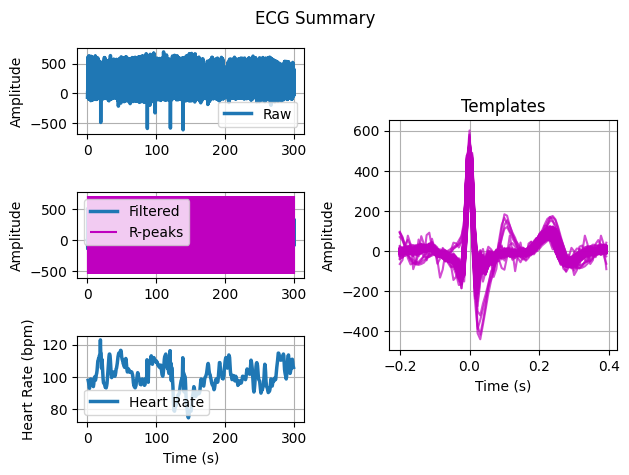

2.0
프로토콜: 2.0 HIT


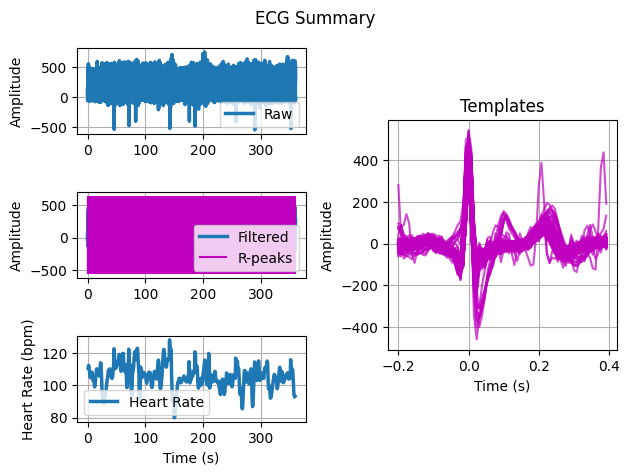

3.0
프로토콜: 3.0 MA


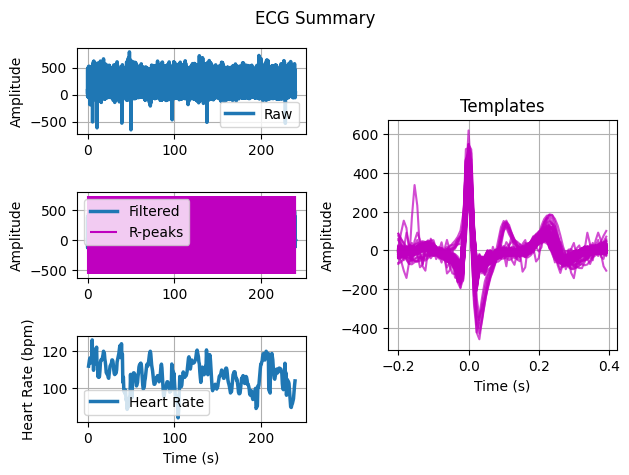

(M)012_20230507_093010_H10.csv
1.0
프로토콜: 1.0 BASELINE


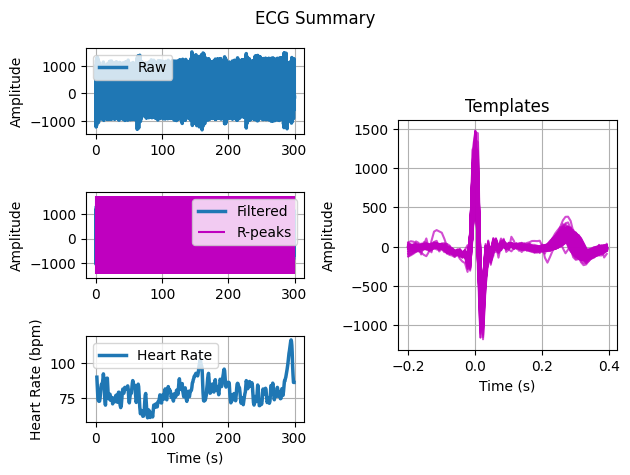

2.0
프로토콜: 2.0 HIT


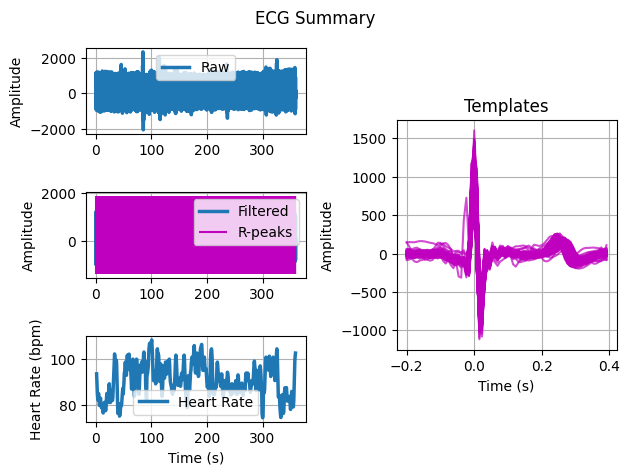

3.0
프로토콜: 3.0 MA


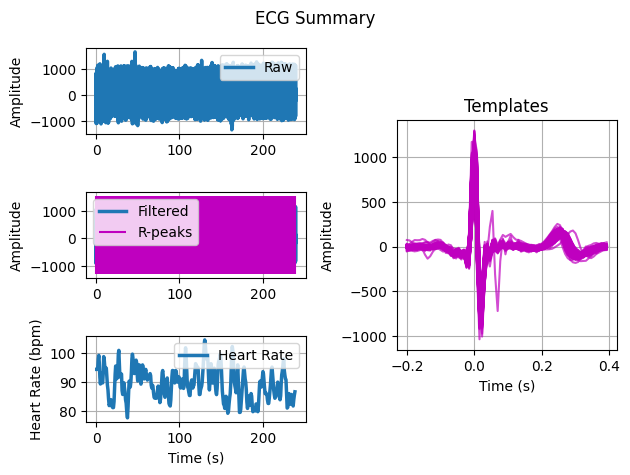

(M)013_20230507_113448_H10.csv
1.0
프로토콜: 1.0 BASELINE


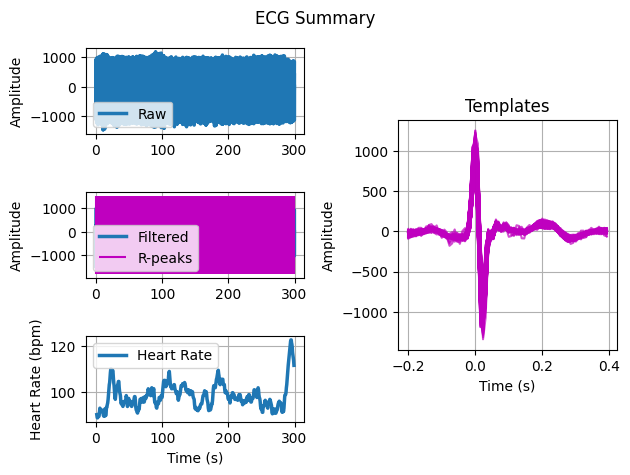

2.0
프로토콜: 2.0 HIT


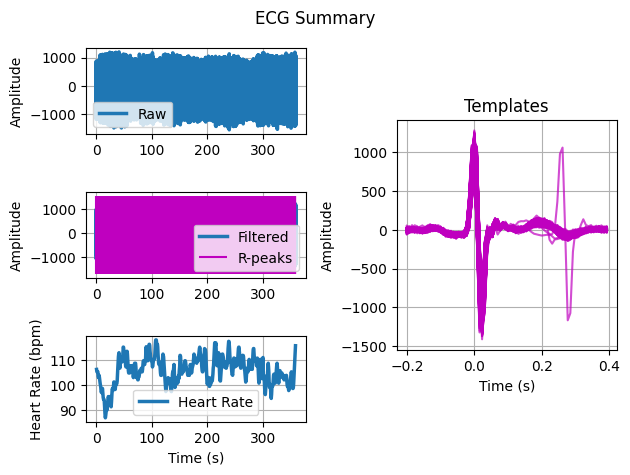

3.0
프로토콜: 3.0 MA


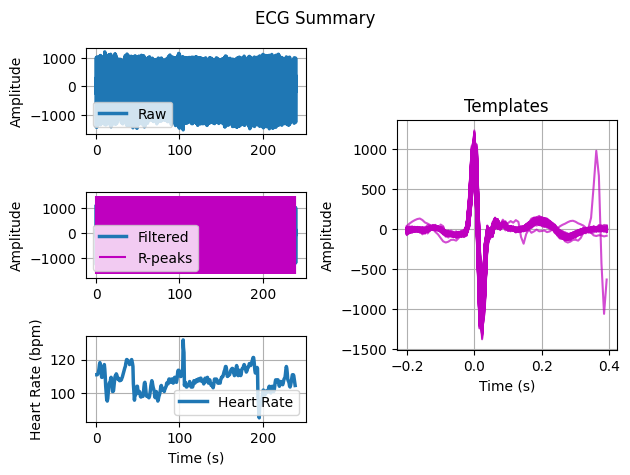

(M)014_20230507_095721_H10.csv
(M)016_20230507_085913_H10.csv
1.0
프로토콜: 1.0 BASELINE


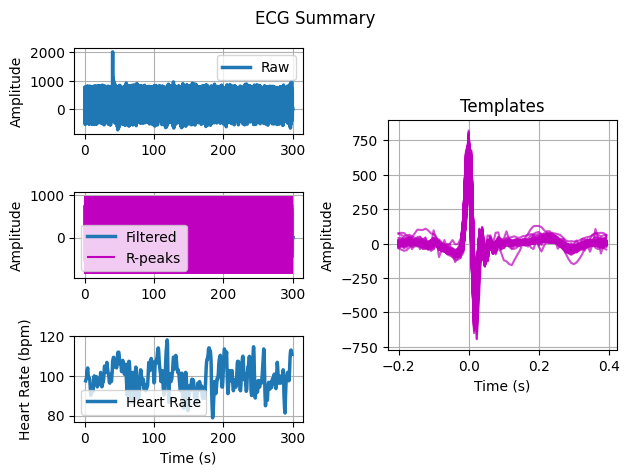

2.0
프로토콜: 2.0 HIT


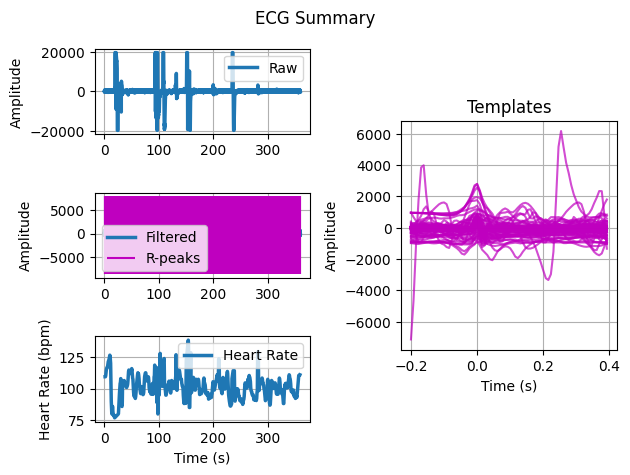

3.0
프로토콜: 3.0 MA


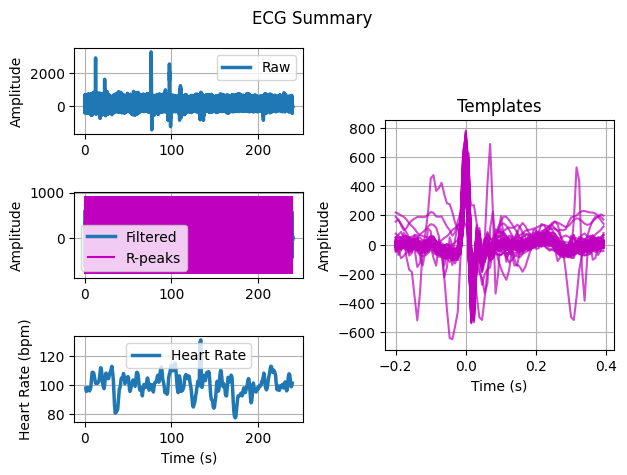

(M)017_20230507_110427_H10.csv
1.0
프로토콜: 1.0 BASELINE


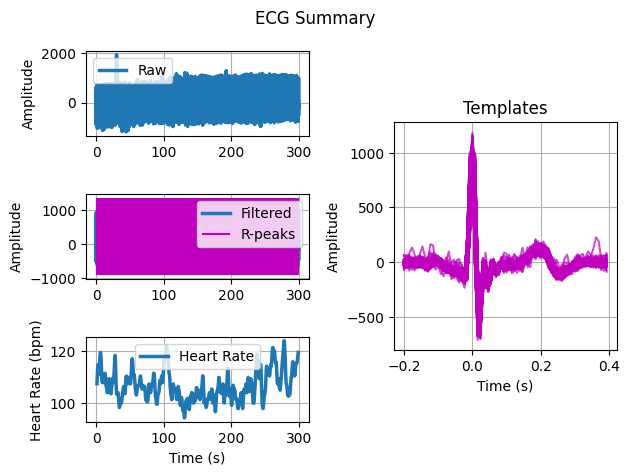

2.0
프로토콜: 2.0 HIT


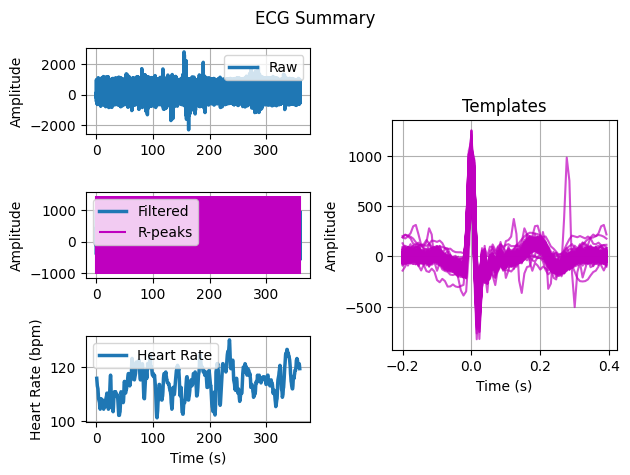

3.0
프로토콜: 3.0 MA


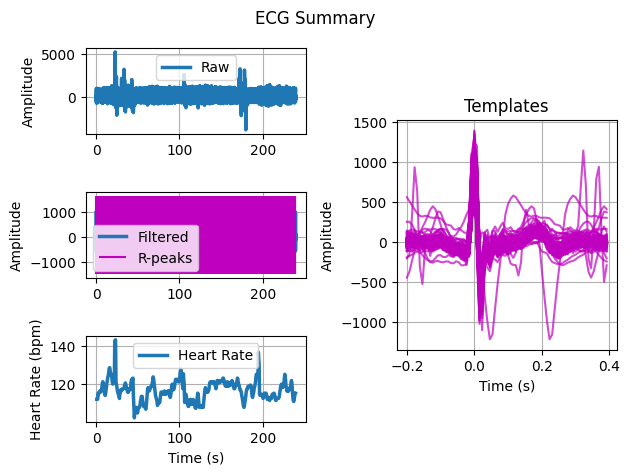

(M)018_20230507_100932_H10.csv
1.0
프로토콜: 1.0 BASELINE


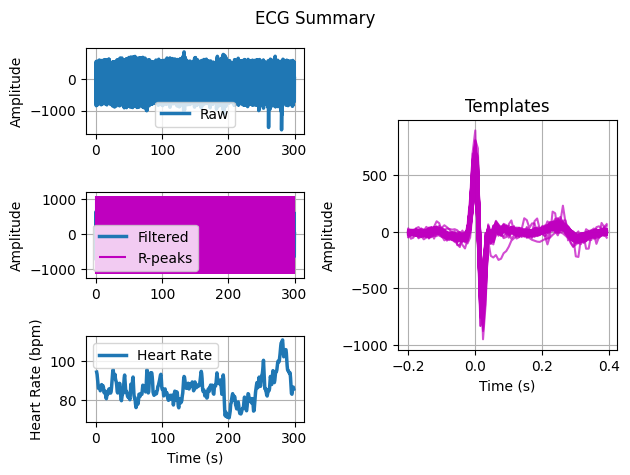

2.0
프로토콜: 2.0 HIT


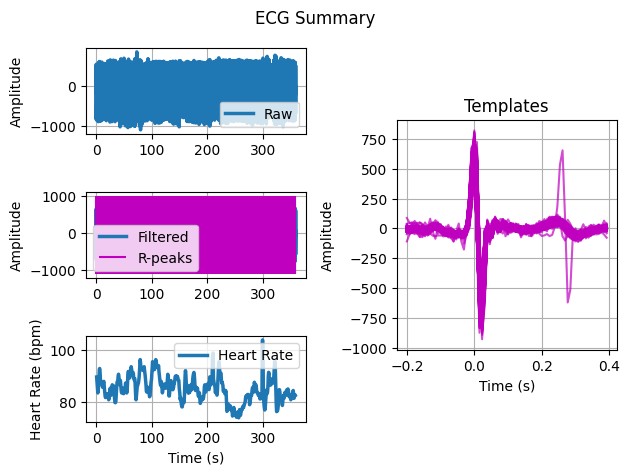

3.0
프로토콜: 3.0 MA


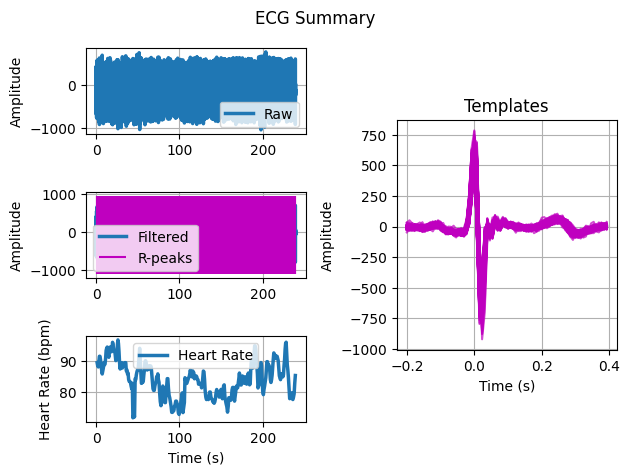

(M)019_20230507_101420_H10.csv
1.0
프로토콜: 1.0 BASELINE


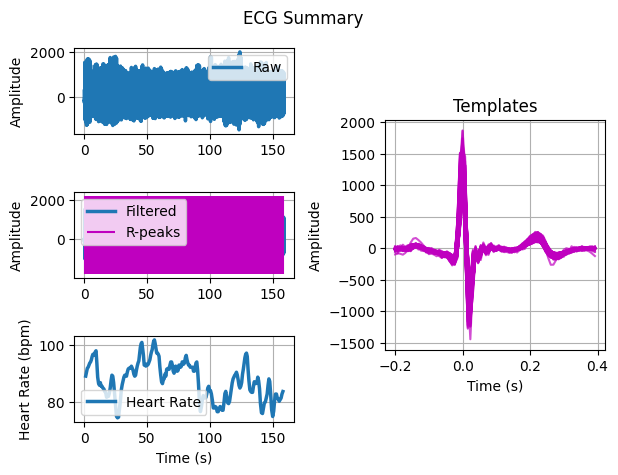

2.0
프로토콜: 2.0 HIT


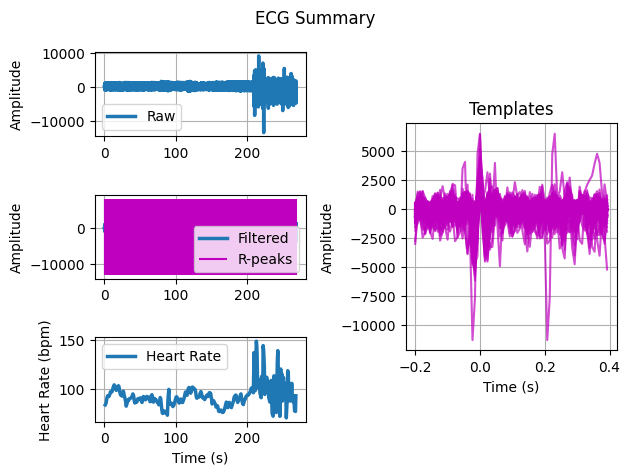

3.0
프로토콜: 3.0 MA


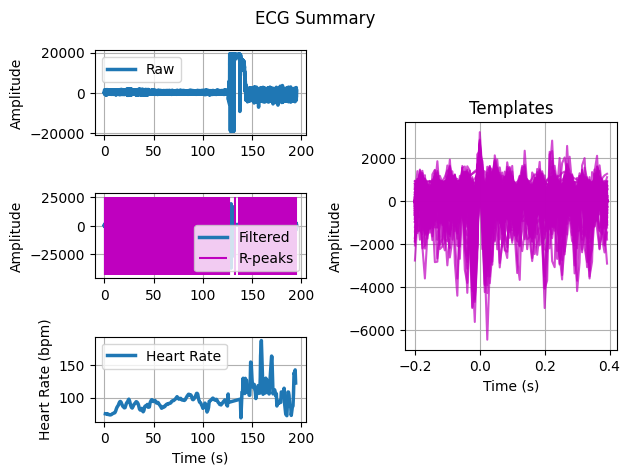

(M)020_20230507_122941_H10.csv
1.0
프로토콜: 1.0 BASELINE


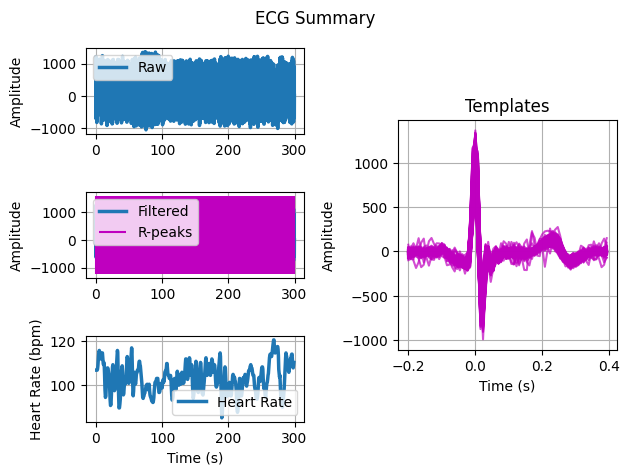

2.0
프로토콜: 2.0 HIT


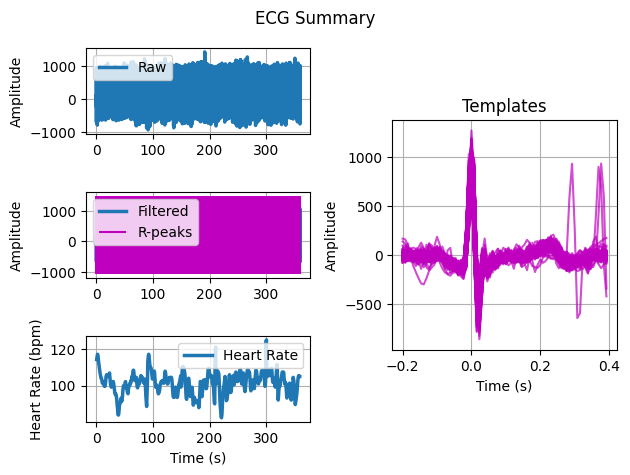

3.0
프로토콜: 3.0 MA


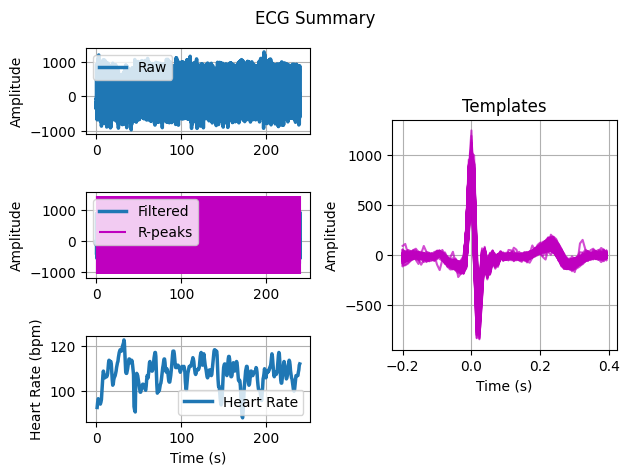

In [60]:
for i in mast_h10_dict:
    print(i)
    for p in mast_h10_dict[i]['proc'].unique():
        if np.isnan(p):
            print('Value is nan')
            pass
        else:
            print(p)
            print('프로토콜:', p, MAST_PROTOCOL_NAME[p])
            signal = mast_h10_dict[i][mast_h10_dict[i]['proc'] == p]['sensor']
            try:
                out = ecg.ecg(signal=signal, 
                              sampling_rate=130., 
                              show=False
                             )
                ecg_data = out.as_dict()
                biosppy.plotting.plot_ecg(
                                      ts = ecg_data['ts'],
                                      raw=signal, 
                                      filtered = ecg_data['filtered'], 
                                      rpeaks = ecg_data['rpeaks'],
                                      templates_ts = ecg_data['templates_ts'],
                                      templates = ecg_data['templates'],
                                      heart_rate_ts = ecg_data['heart_rate_ts'],
                                      heart_rate = ecg_data['heart_rate'],
                                      # sampling_rate=130., 
                                      show=True
                                      )
            except:
                print(' VALUE ERROR')
                print('-'*30)
                pass


(M)001_20230507_093641_H10.csv
Value is nan
(M)001_20230507_094057_H10.csv
Value is nan
1.0
프로토콜: 1.0 BASELINE


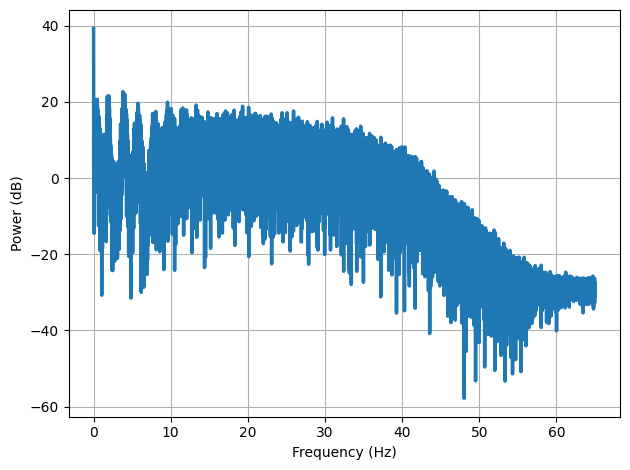

2.0
프로토콜: 2.0 HIT


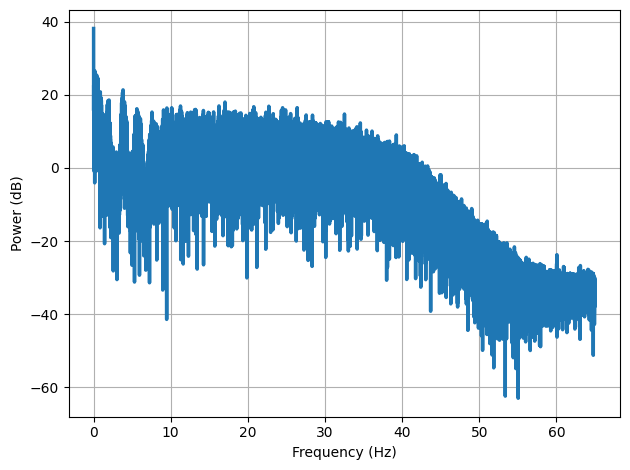

3.0
프로토콜: 3.0 MA


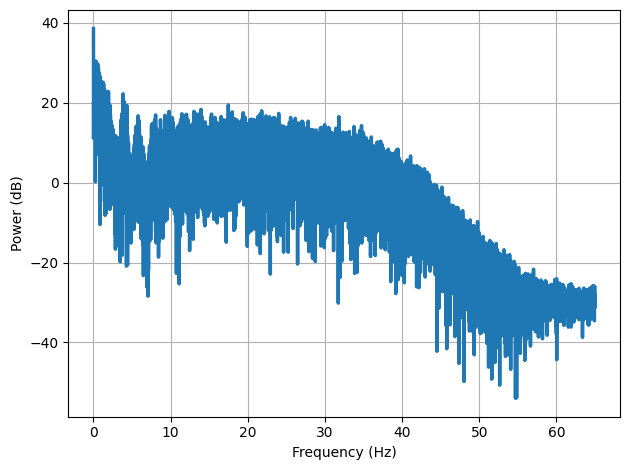

(M)002_20230507_103326_H10.csv
Value is nan
1.0
프로토콜: 1.0 BASELINE


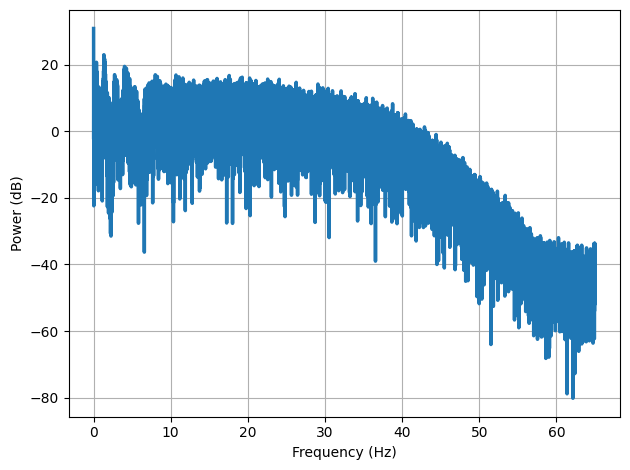

2.0
프로토콜: 2.0 HIT


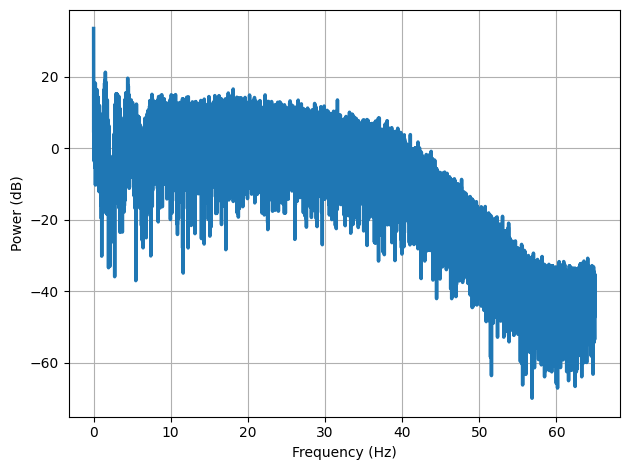

3.0
프로토콜: 3.0 MA


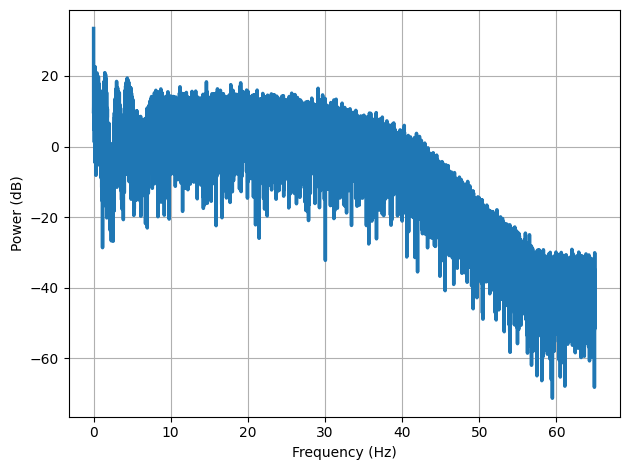

(M)003_20230507_090129_H10.csv
Value is nan
1.0
프로토콜: 1.0 BASELINE


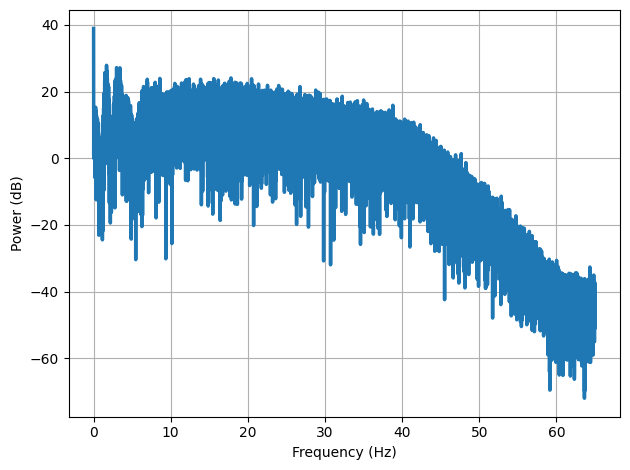

2.0
프로토콜: 2.0 HIT


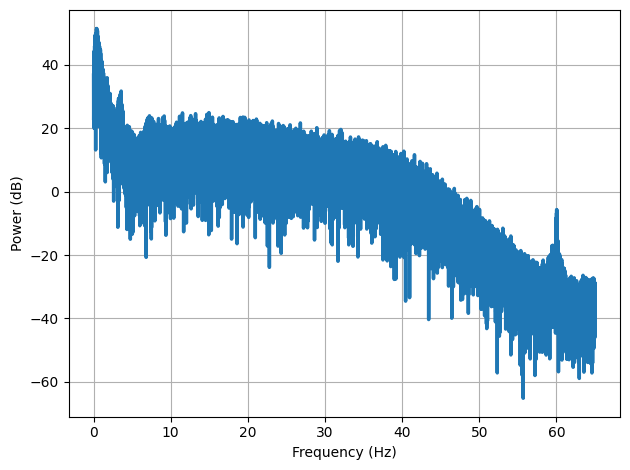

3.0
프로토콜: 3.0 MA


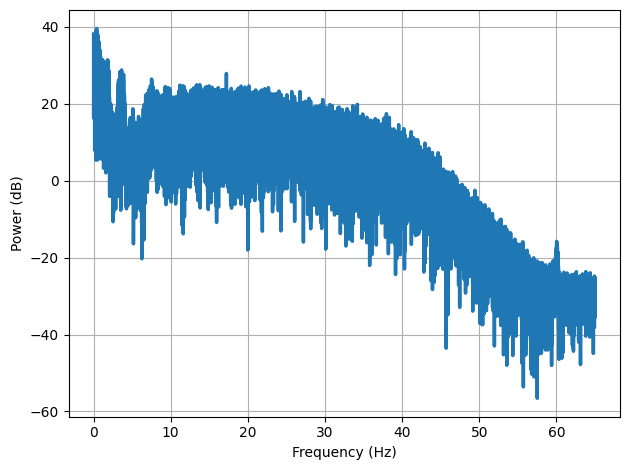

(M)004_20230507_093440_H10.csv
Value is nan
1.0
프로토콜: 1.0 BASELINE


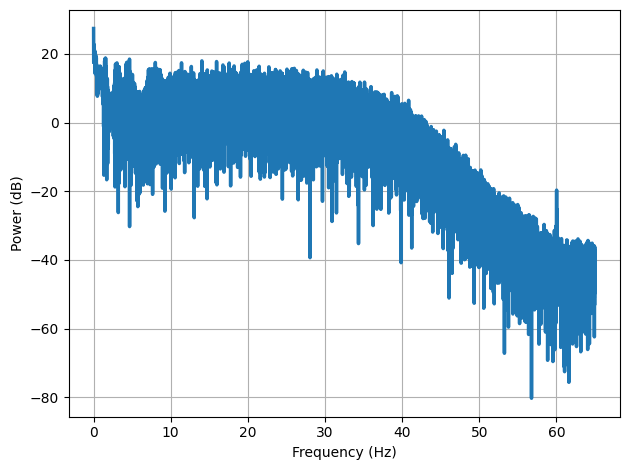

2.0
프로토콜: 2.0 HIT


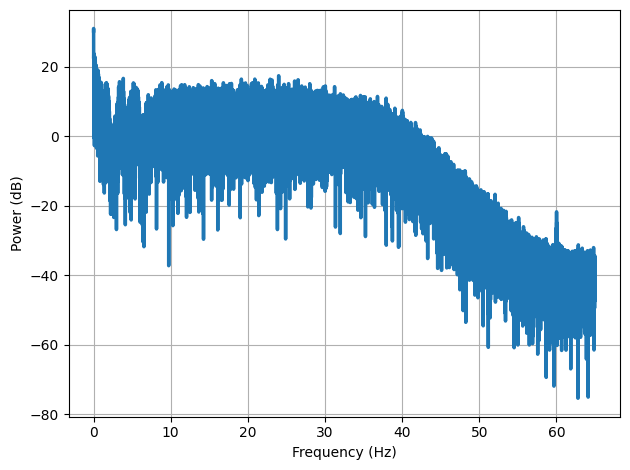

3.0
프로토콜: 3.0 MA


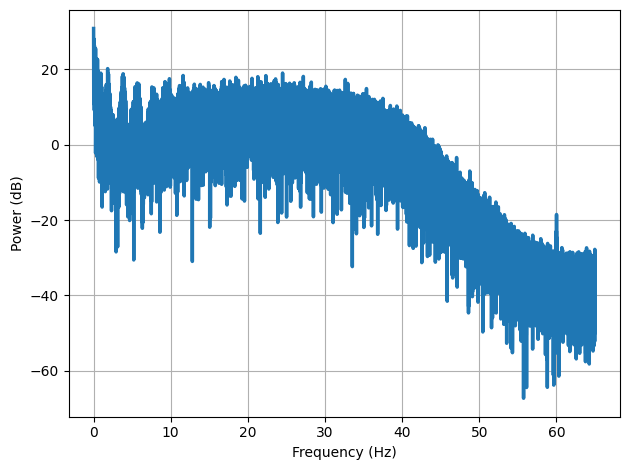

(M)005_20230507_113956_H10.csv
Value is nan
1.0
프로토콜: 1.0 BASELINE


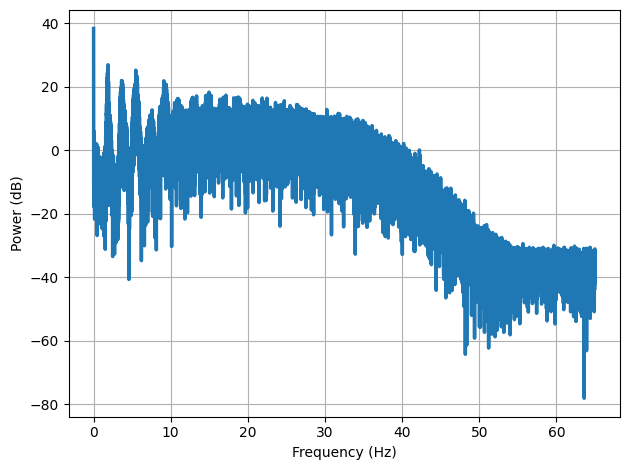

2.0
프로토콜: 2.0 HIT


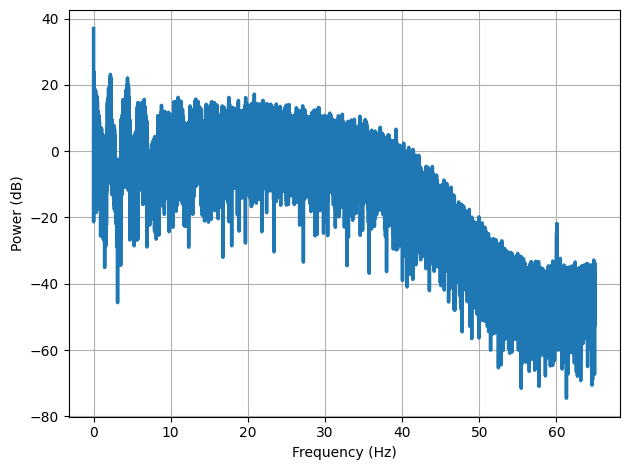

3.0
프로토콜: 3.0 MA


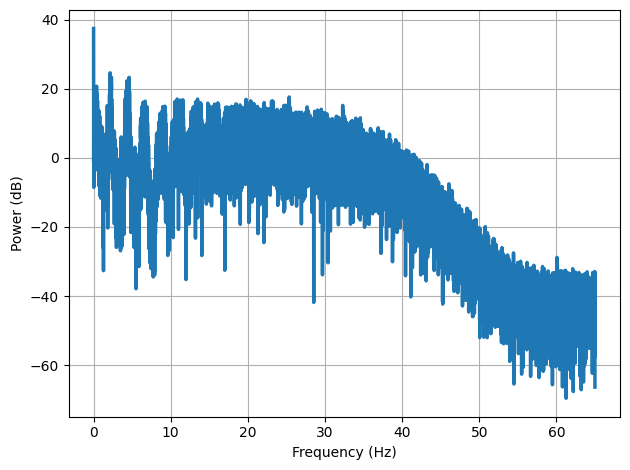

(M)006_20230507_110506_H10.csv
Value is nan
1.0
프로토콜: 1.0 BASELINE


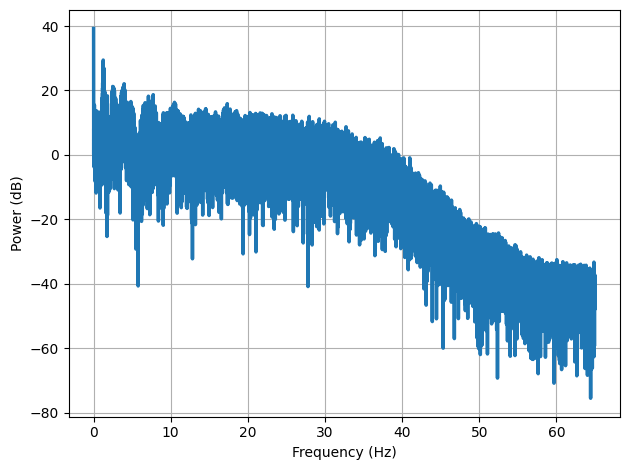

2.0
프로토콜: 2.0 HIT


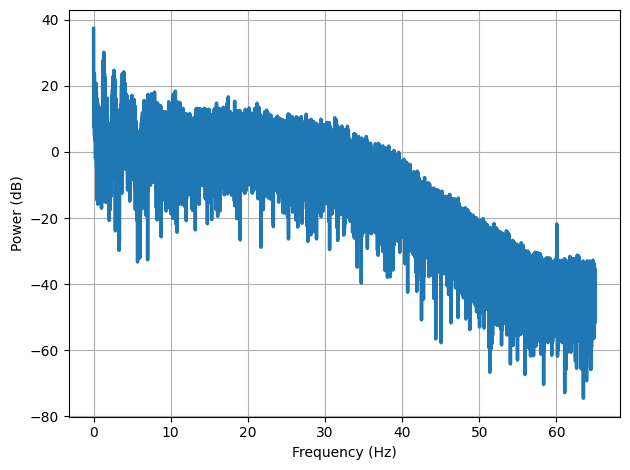

3.0
프로토콜: 3.0 MA


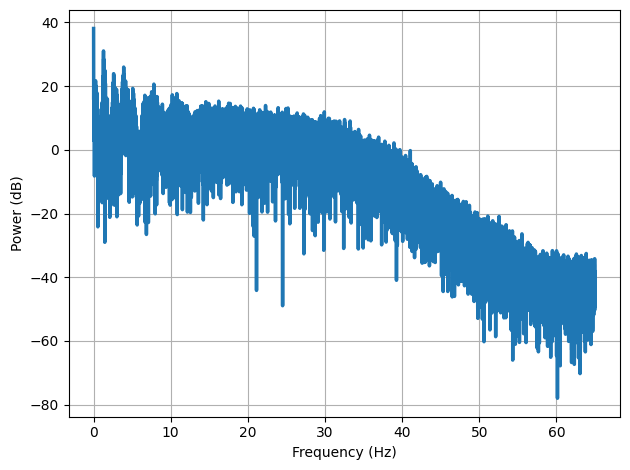

(M)007_20230507_110503_H10.csv
Value is nan
1.0
프로토콜: 1.0 BASELINE


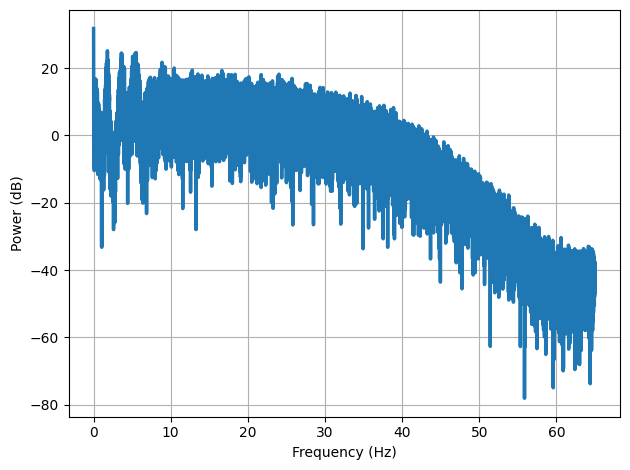

2.0
프로토콜: 2.0 HIT


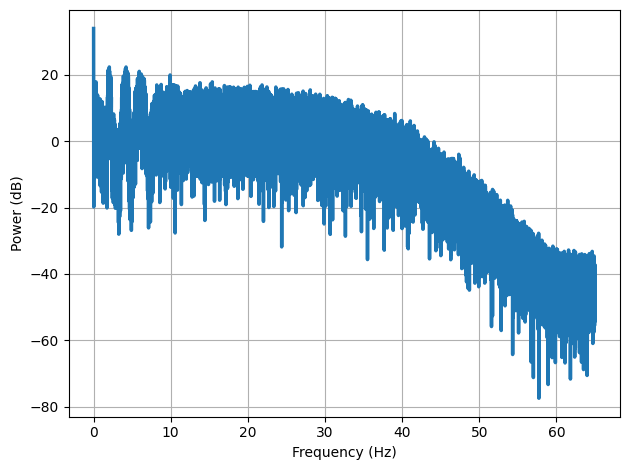

3.0
프로토콜: 3.0 MA


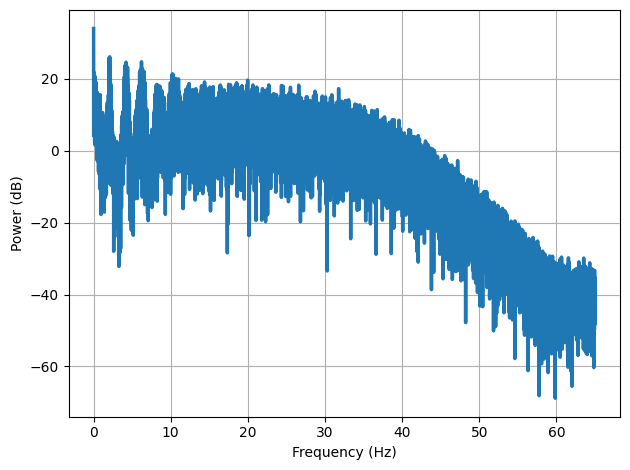

(M)008_20230507_113824_H10.csv
Value is nan
1.0
프로토콜: 1.0 BASELINE


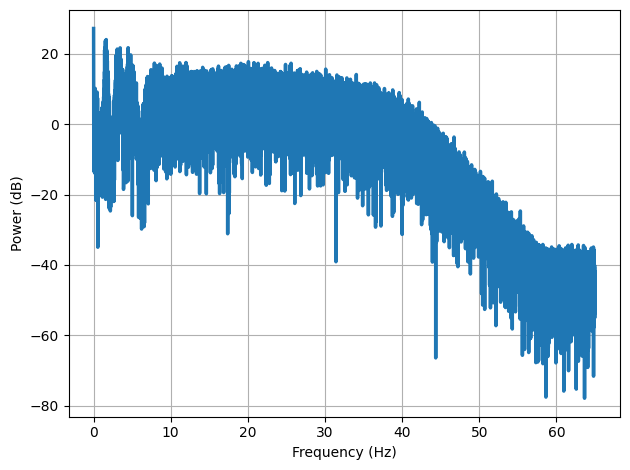

2.0
프로토콜: 2.0 HIT


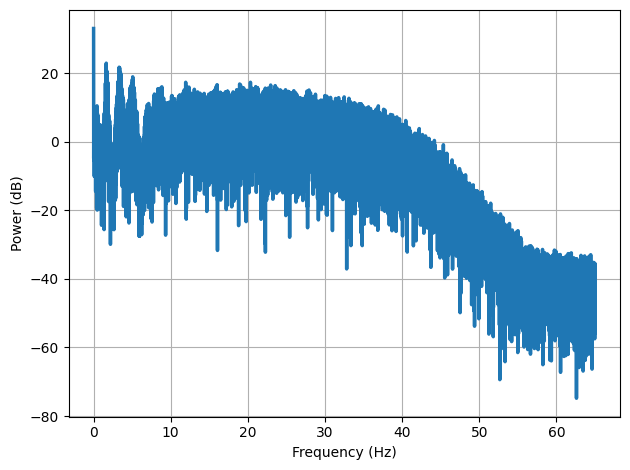

3.0
프로토콜: 3.0 MA


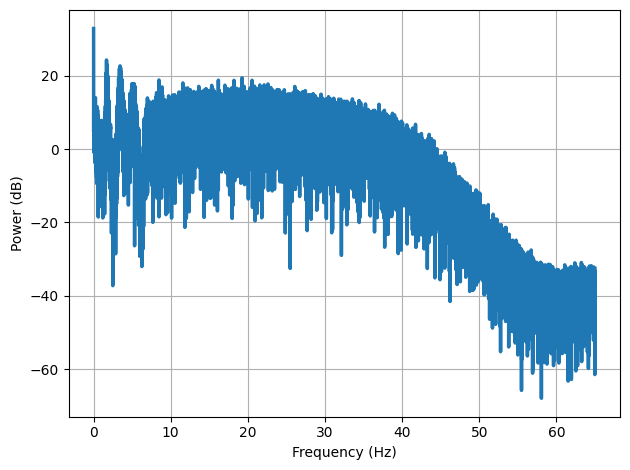

(M)009_20230507_095758_H10.csv
Value is nan
1.0
프로토콜: 1.0 BASELINE


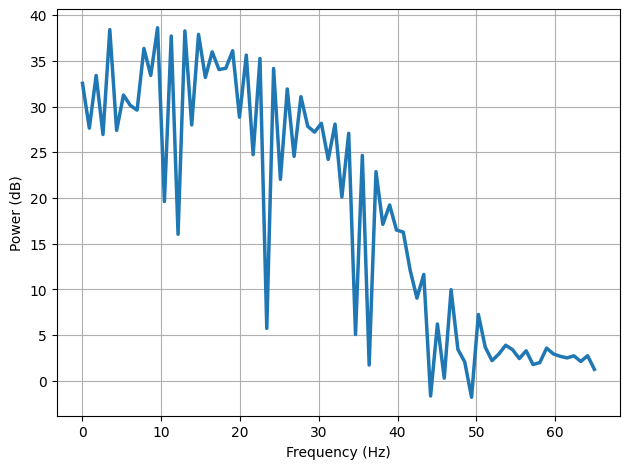

2.0
프로토콜: 2.0 HIT


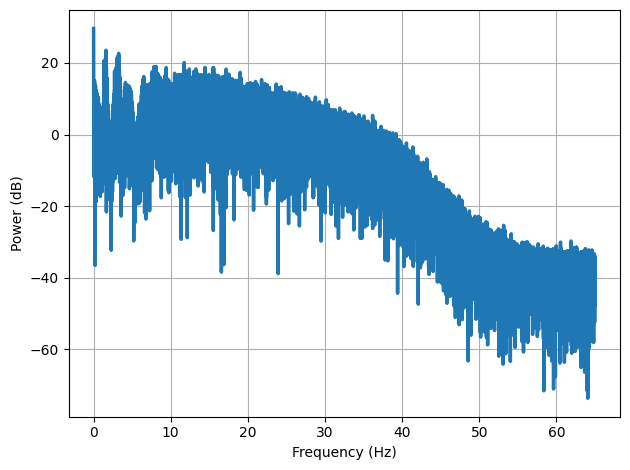

3.0
프로토콜: 3.0 MA


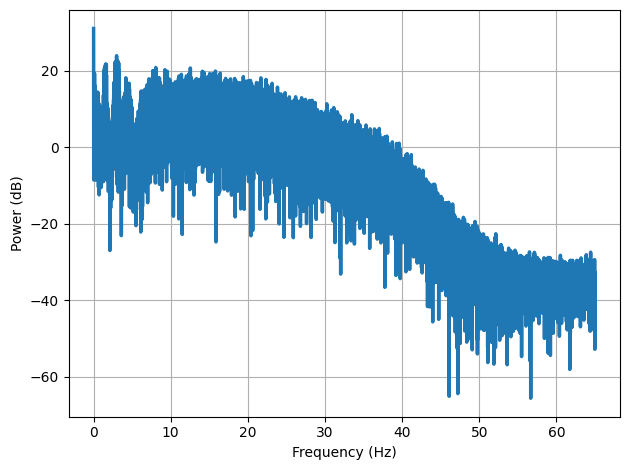

(M)010_20230507_103416_H10.csv
Value is nan
1.0
프로토콜: 1.0 BASELINE


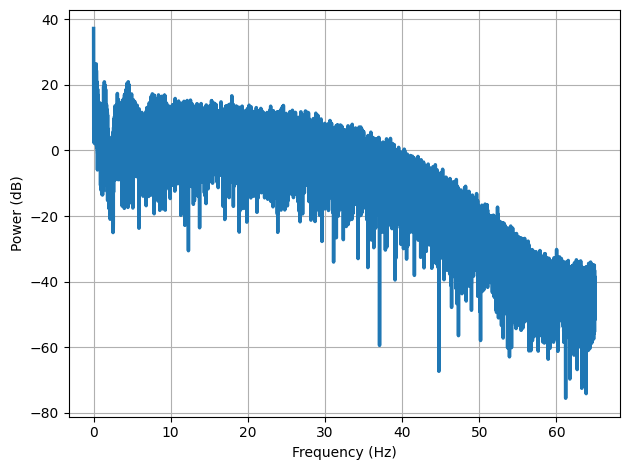

2.0
프로토콜: 2.0 HIT


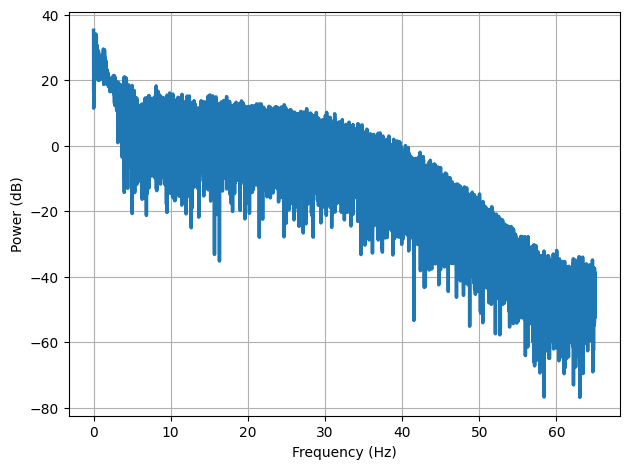

3.0
프로토콜: 3.0 MA


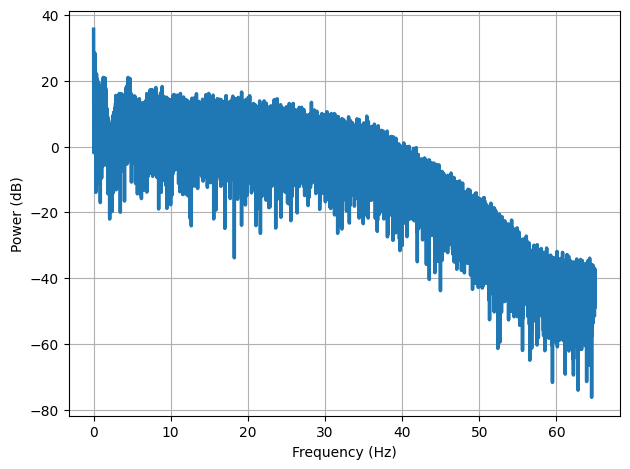

(M)011_20230507_120541_H10.csv
Value is nan
1.0
프로토콜: 1.0 BASELINE


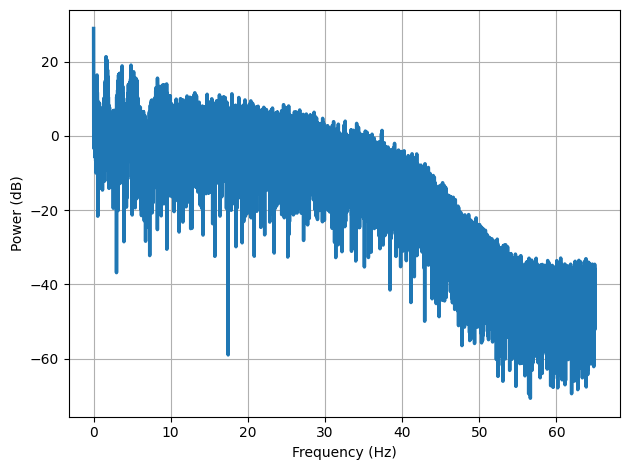

2.0
프로토콜: 2.0 HIT


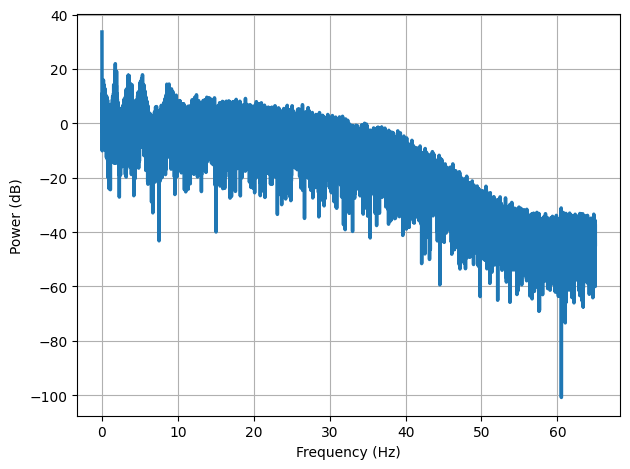

3.0
프로토콜: 3.0 MA


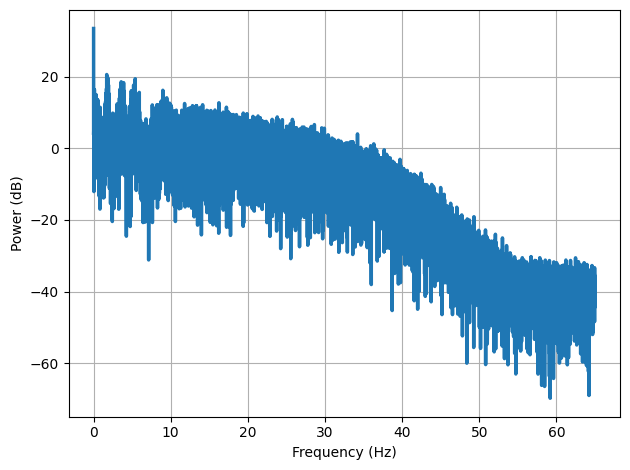

(M)012_20230507_093010_H10.csv
Value is nan
1.0
프로토콜: 1.0 BASELINE


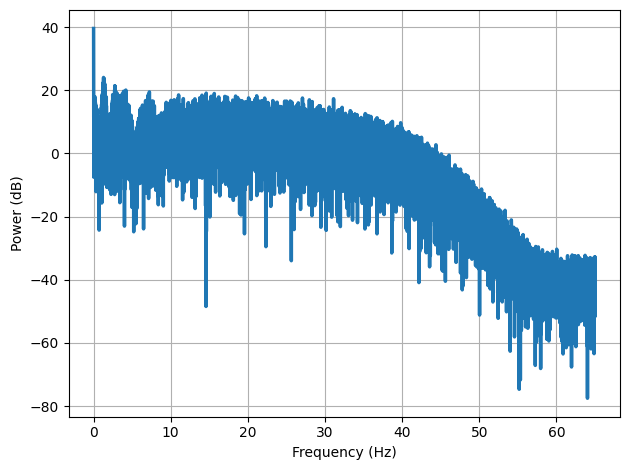

2.0
프로토콜: 2.0 HIT


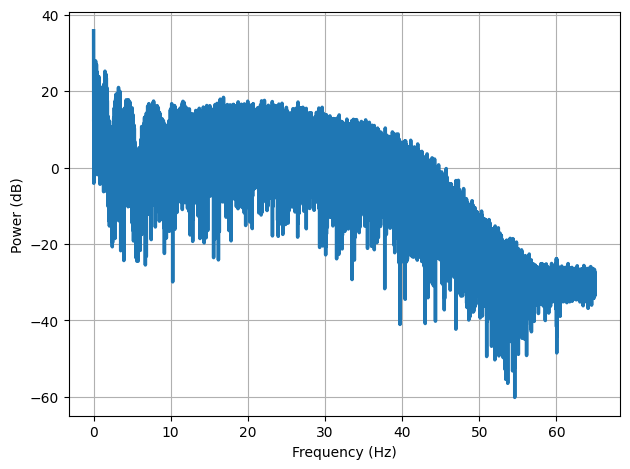

3.0
프로토콜: 3.0 MA


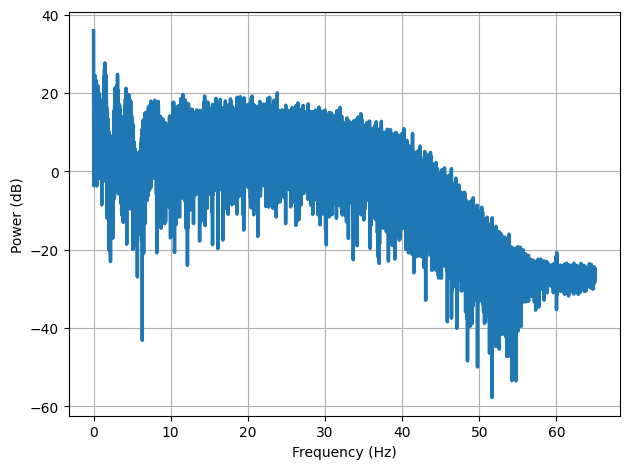

(M)013_20230507_113448_H10.csv
Value is nan
1.0
프로토콜: 1.0 BASELINE


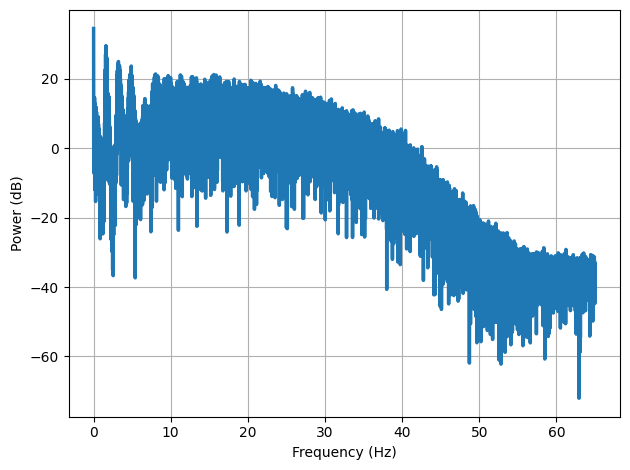

2.0
프로토콜: 2.0 HIT


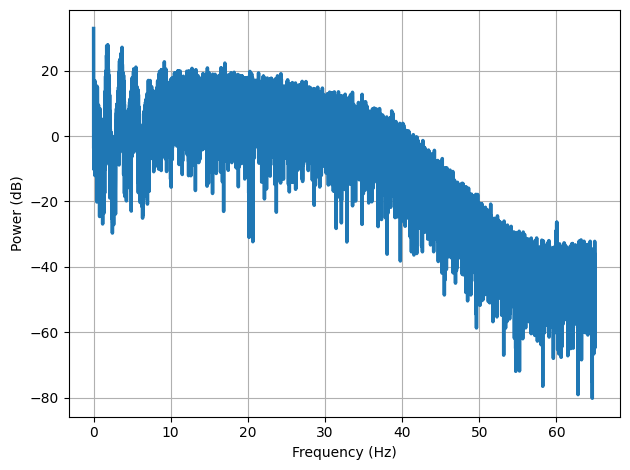

3.0
프로토콜: 3.0 MA


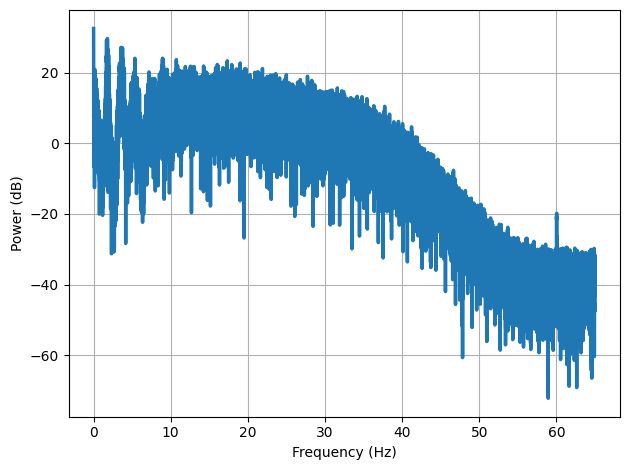

(M)014_20230507_095721_H10.csv
Value is nan
(M)016_20230507_085913_H10.csv
Value is nan
1.0
프로토콜: 1.0 BASELINE


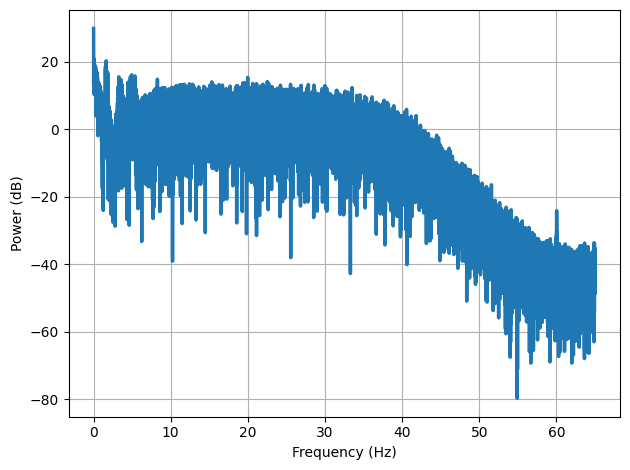

2.0
프로토콜: 2.0 HIT


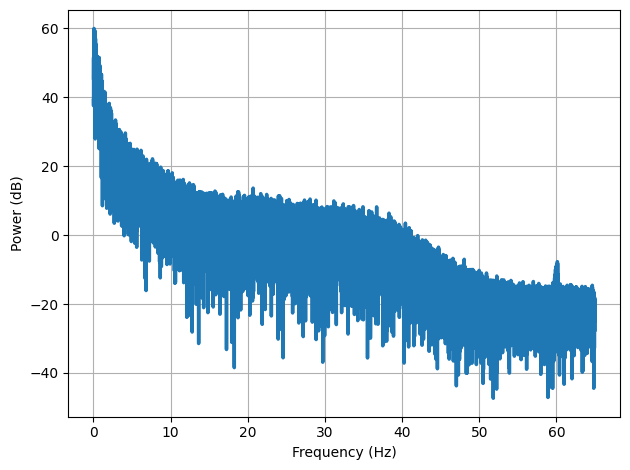

3.0
프로토콜: 3.0 MA


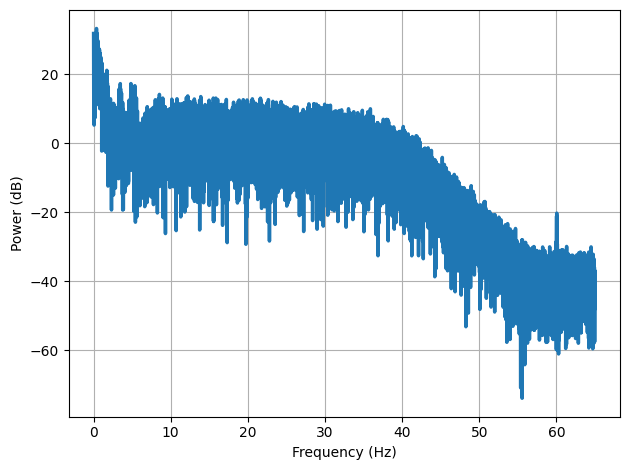

(M)017_20230507_110427_H10.csv
Value is nan
1.0
프로토콜: 1.0 BASELINE


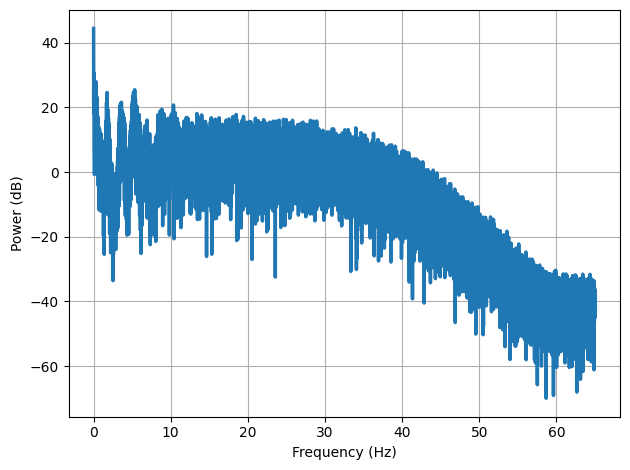

2.0
프로토콜: 2.0 HIT


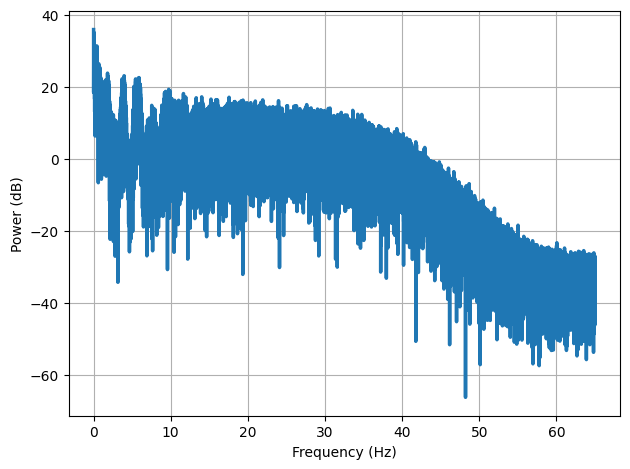

3.0
프로토콜: 3.0 MA


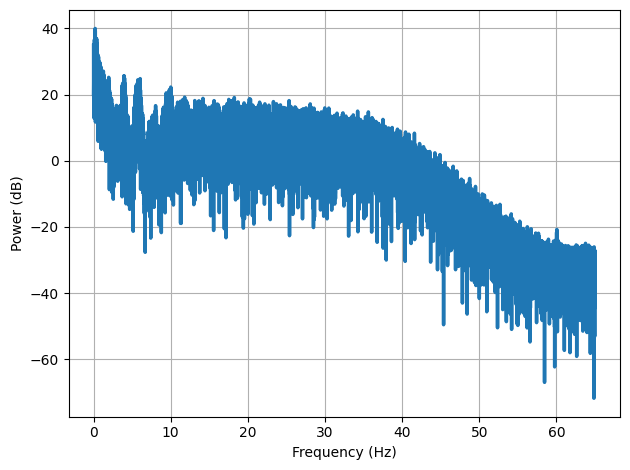

(M)018_20230507_100932_H10.csv
Value is nan
1.0
프로토콜: 1.0 BASELINE


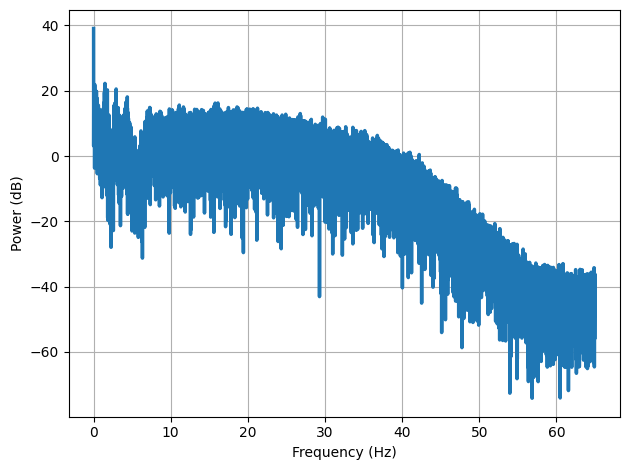

2.0
프로토콜: 2.0 HIT


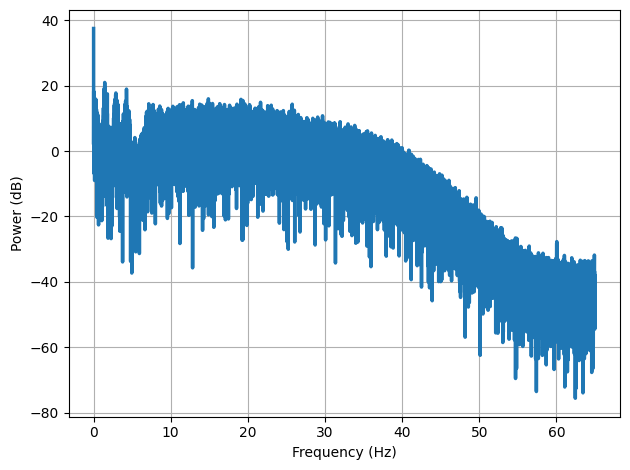

3.0
프로토콜: 3.0 MA


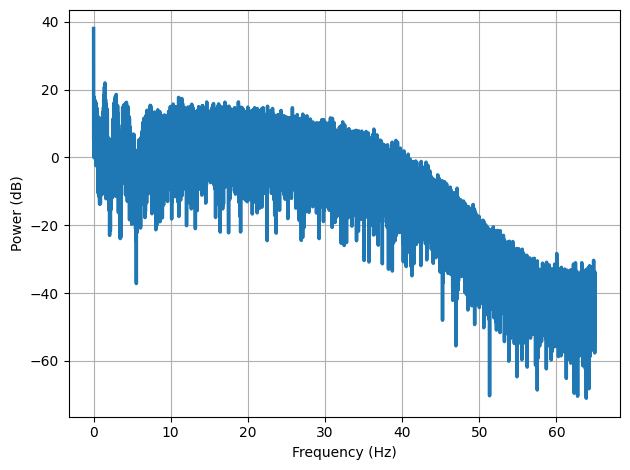

(M)019_20230507_101420_H10.csv
Value is nan
1.0
프로토콜: 1.0 BASELINE


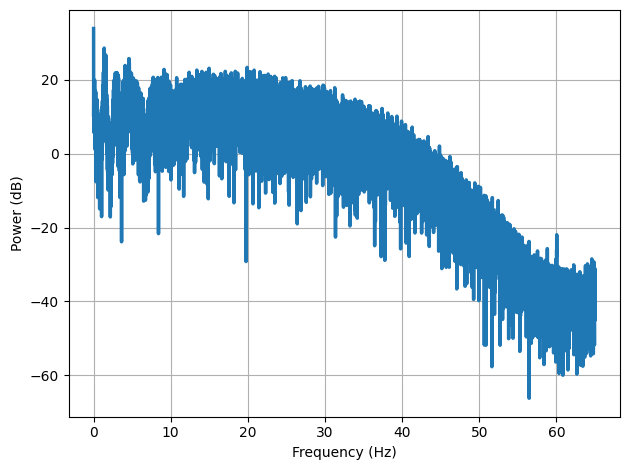

2.0
프로토콜: 2.0 HIT


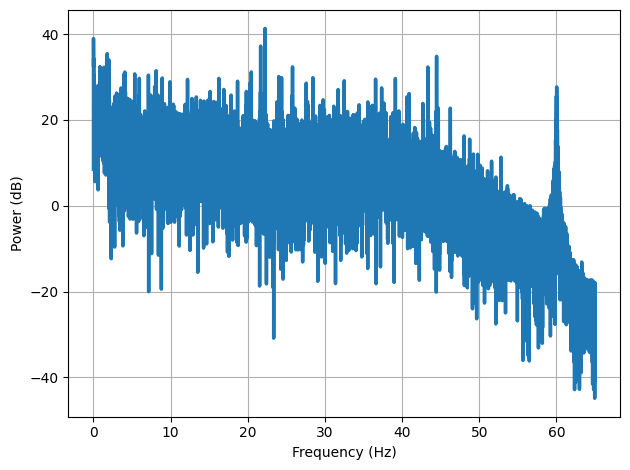

3.0
프로토콜: 3.0 MA


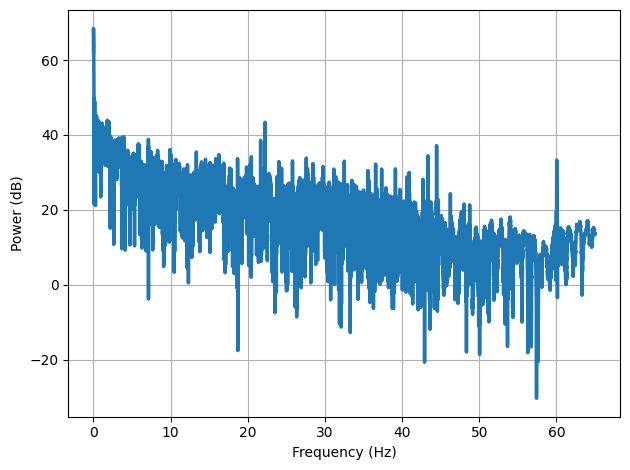

(M)020_20230507_122941_H10.csv
Value is nan
1.0
프로토콜: 1.0 BASELINE


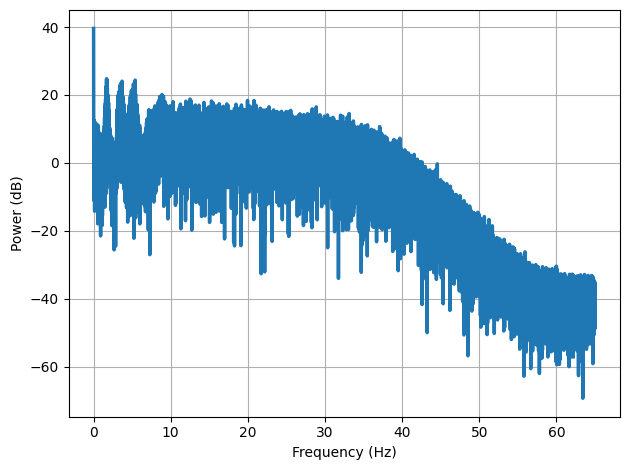

2.0
프로토콜: 2.0 HIT


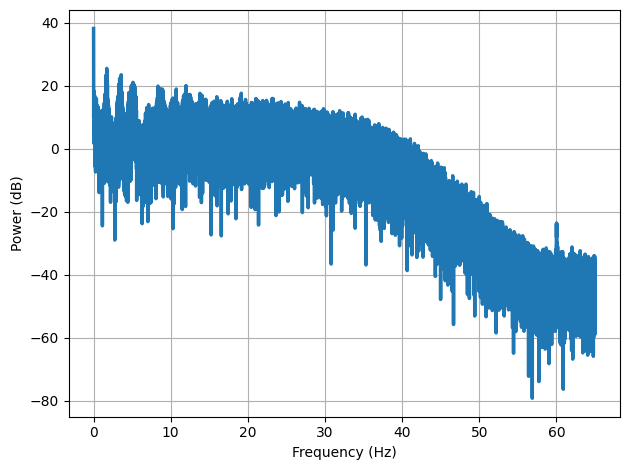

3.0
프로토콜: 3.0 MA


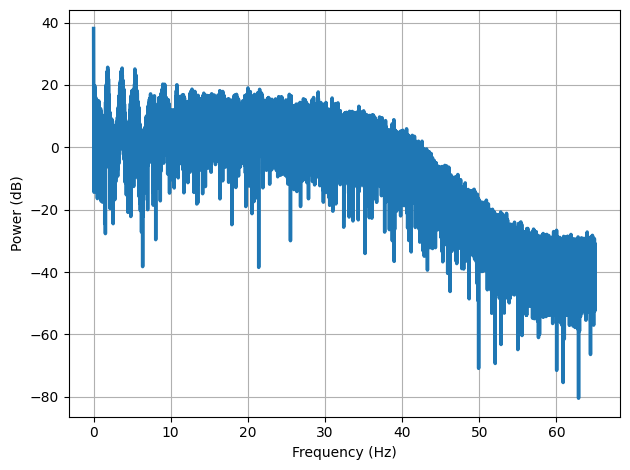

In [63]:
for i in mast_h10_dict:
    print(i)
    for p in mast_h10_dict[i]['proc'].unique():
        if np.isnan(p):
            print('Value is nan')
            pass
        else:
            print(p)
            print('프로토콜:', p, MAST_PROTOCOL_NAME[p])
            signal = mast_h10_dict[i][mast_h10_dict[i]['proc'] == p]['sensor']
            try:
                out = biosppy.plotting.plot_spectrum(signal = signal, sampling_rate = 130)
            except:
                print(' VALUE ERROR')
                print('-'*30)
                pass



In [ ]:
for i in mast_h10_dict:
    print(i)
    print(len(mast_h10_dict[i]))
    signal = mast_h10_dict[i]['sensor']
    out = biosppy.plotting.plot_filter(ftype='butter', 
                                       band='bandpass', 
                                       order=2, 
                                       frequency= [0.05, 0.1], 
                                       sampling_rate = 130)

In [66]:
for i in mast_h10_dict:
    print(i)
    for p in mast_h10_dict[i]['proc'].unique():
        if np.isnan(p):
            print('Value is nan')
            pass
        else:
            print(p)
            print('프로토콜:', p, MAST_PROTOCOL_NAME[p])
            signal = mast_h10_dict[i][mast_h10_dict[i]['proc'] == p]['sensor']
            try:
                signal, rpeaks = biosppy.signals.ecg.ecg(signal= signal, 
                                                         sampling_rate = 130, 
                                                         show=False)[1:3]
                nni = tools.nn_intervals(rpeaks)
            except:
                print(' VALUE ERROR')
                print('-'*30)
                pass


(M)001_20230507_093641_H10.csv
Value is nan
(M)001_20230507_094057_H10.csv
Value is nan
1.0
프로토콜: 1.0 BASELINE
2.0
프로토콜: 2.0 HIT
3.0
프로토콜: 3.0 MA
(M)002_20230507_103326_H10.csv
Value is nan
1.0
프로토콜: 1.0 BASELINE
2.0
프로토콜: 2.0 HIT
3.0
프로토콜: 3.0 MA
(M)003_20230507_090129_H10.csv
Value is nan
1.0
프로토콜: 1.0 BASELINE
2.0
프로토콜: 2.0 HIT
3.0
프로토콜: 3.0 MA
(M)004_20230507_093440_H10.csv
Value is nan
1.0
프로토콜: 1.0 BASELINE
2.0
프로토콜: 2.0 HIT
3.0
프로토콜: 3.0 MA
(M)005_20230507_113956_H10.csv
Value is nan
1.0
프로토콜: 1.0 BASELINE
2.0
프로토콜: 2.0 HIT
3.0
프로토콜: 3.0 MA
(M)006_20230507_110506_H10.csv
Value is nan
1.0
프로토콜: 1.0 BASELINE
2.0
프로토콜: 2.0 HIT
3.0
프로토콜: 3.0 MA
(M)007_20230507_110503_H10.csv
Value is nan
1.0
프로토콜: 1.0 BASELINE
2.0
프로토콜: 2.0 HIT
3.0
프로토콜: 3.0 MA
(M)008_20230507_113824_H10.csv
Value is nan
1.0
프로토콜: 1.0 BASELINE
2.0
프로토콜: 2.0 HIT
3.0
프로토콜: 3.0 MA
(M)009_20230507_095758_H10.csv
Value is nan
1.0
프로토콜: 1.0 BASELINE
 VALUE ERROR
------------------------------
2.0
프로토콜: 2.0 HIT
3.0
프로토콜: 3

(M)001_20230507_093641_H10.csv
Value is nan
(M)001_20230507_094057_H10.csv
Value is nan
프로토콜: 1.0 BASELINE


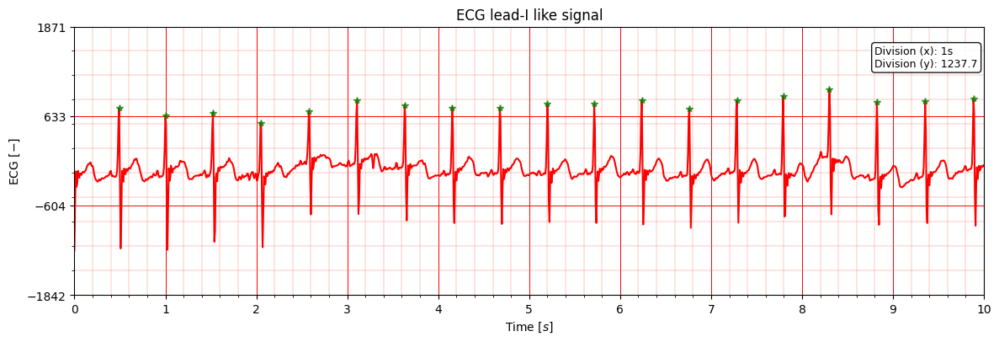

프로토콜: 2.0 HIT


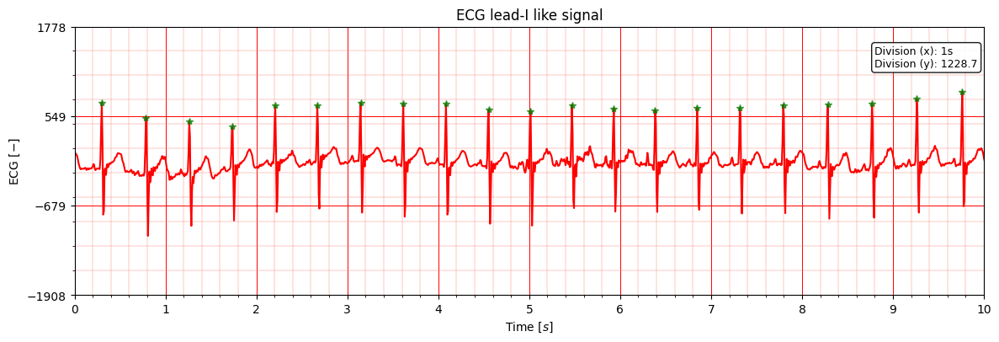

프로토콜: 3.0 MA


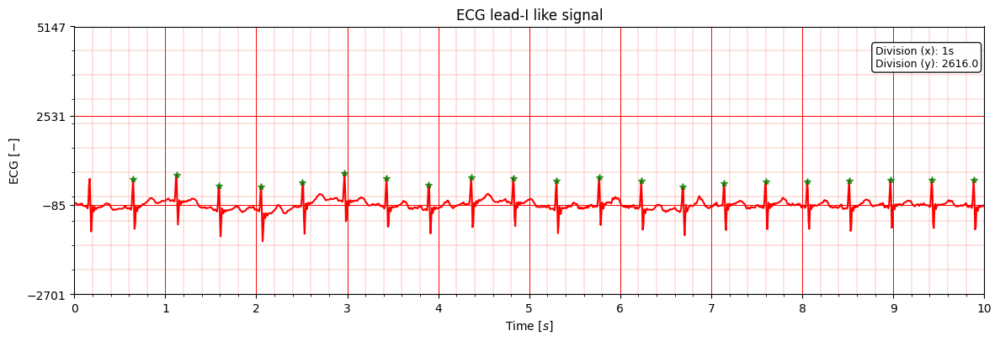

(M)002_20230507_103326_H10.csv
Value is nan
프로토콜: 1.0 BASELINE


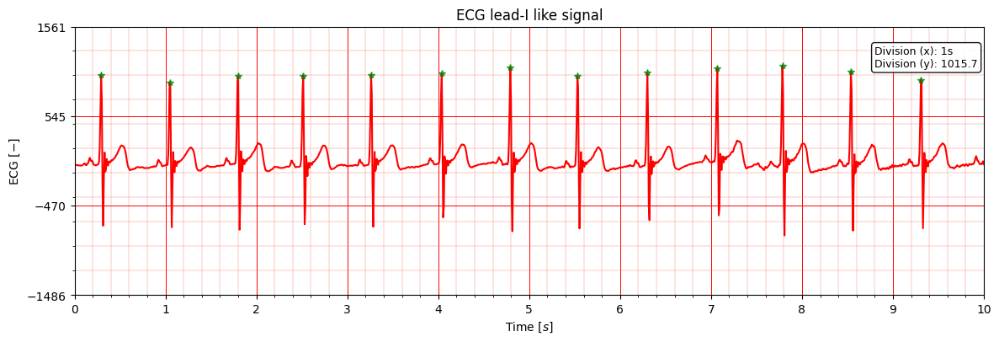

프로토콜: 2.0 HIT


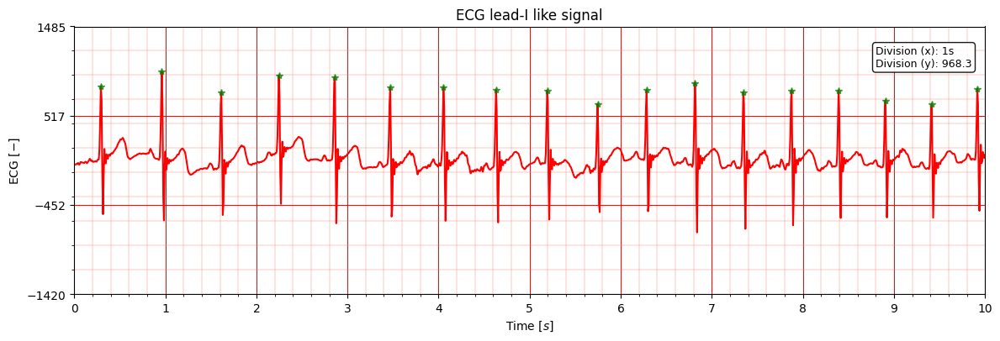

프로토콜: 3.0 MA


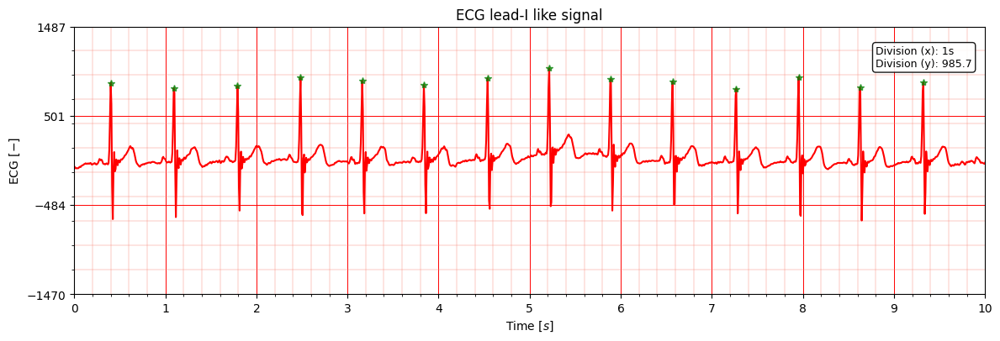

(M)003_20230507_090129_H10.csv
Value is nan
프로토콜: 1.0 BASELINE


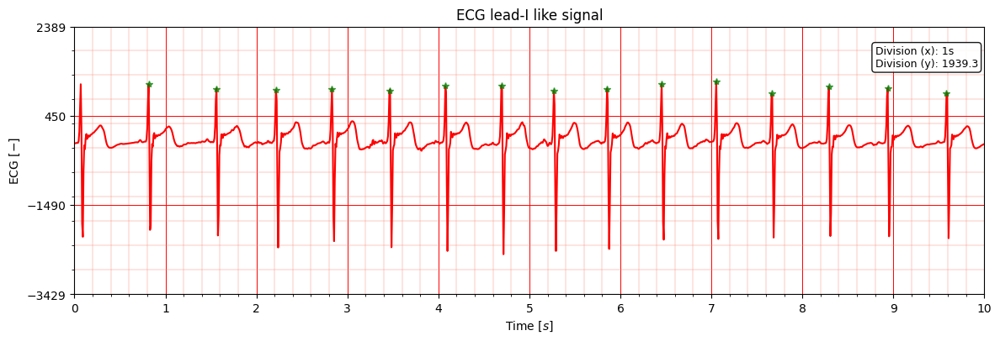

프로토콜: 2.0 HIT


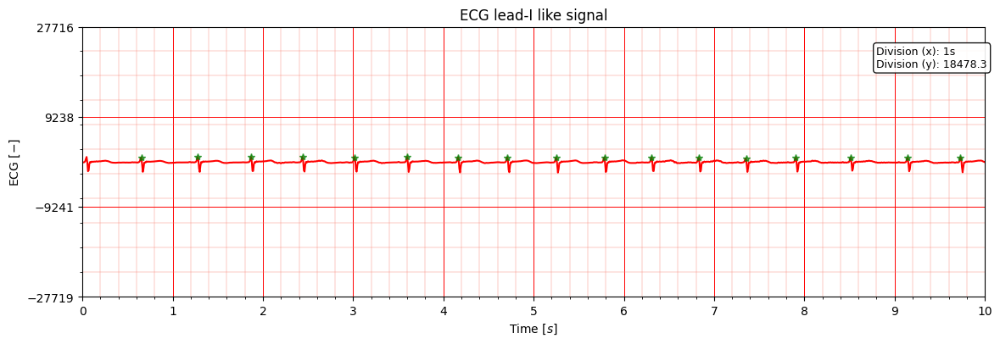

프로토콜: 3.0 MA


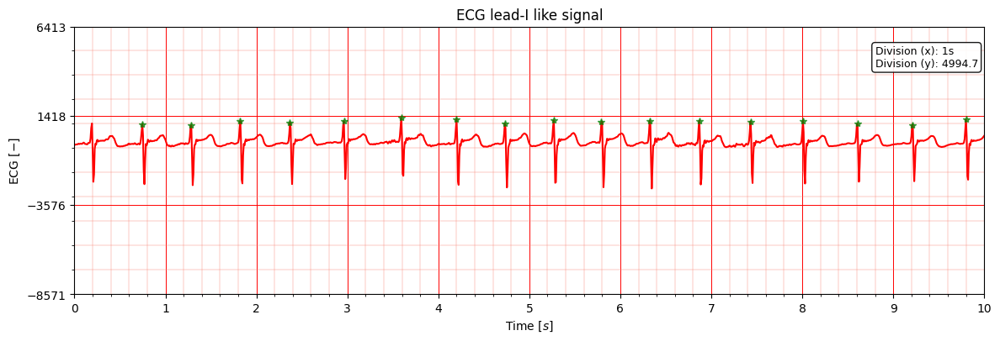

(M)004_20230507_093440_H10.csv
Value is nan
프로토콜: 1.0 BASELINE


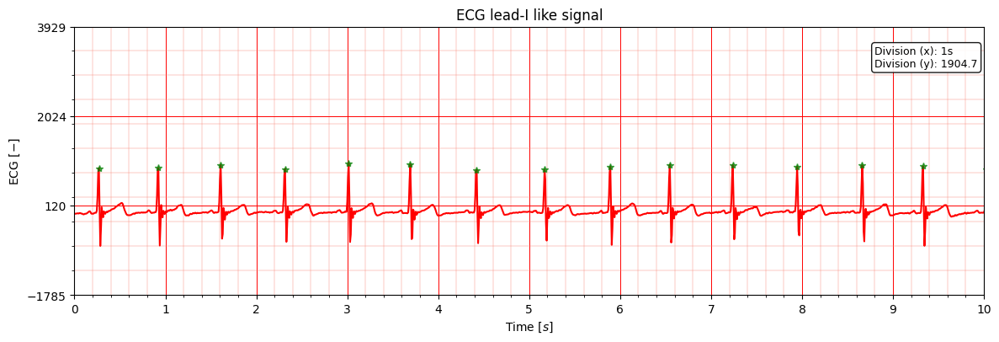

프로토콜: 2.0 HIT


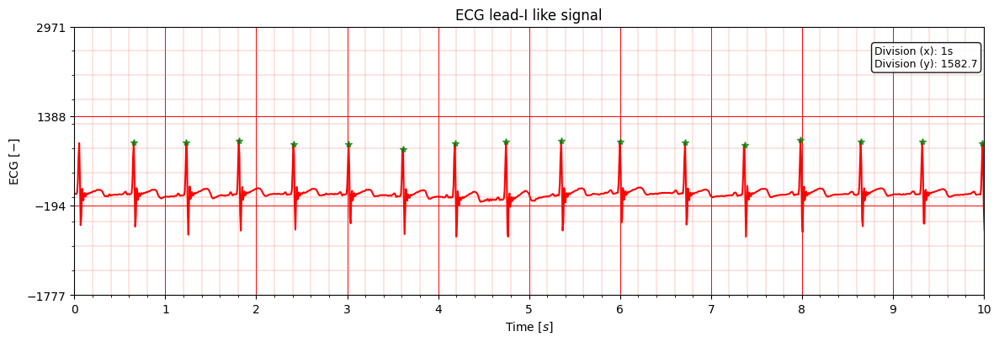

프로토콜: 3.0 MA


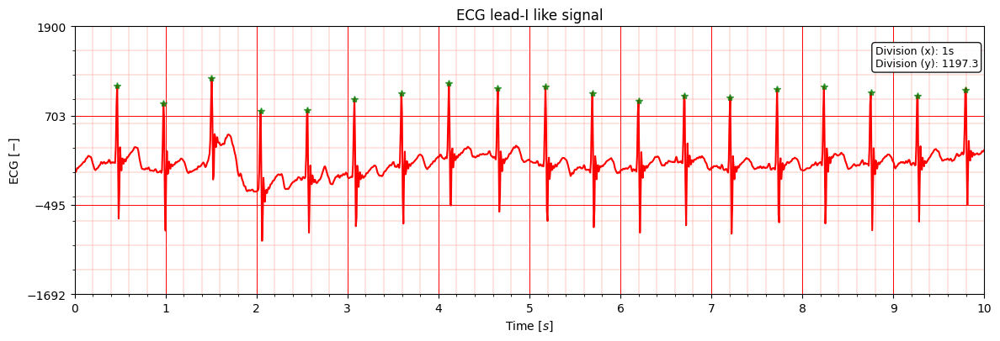

(M)005_20230507_113956_H10.csv
Value is nan
프로토콜: 1.0 BASELINE


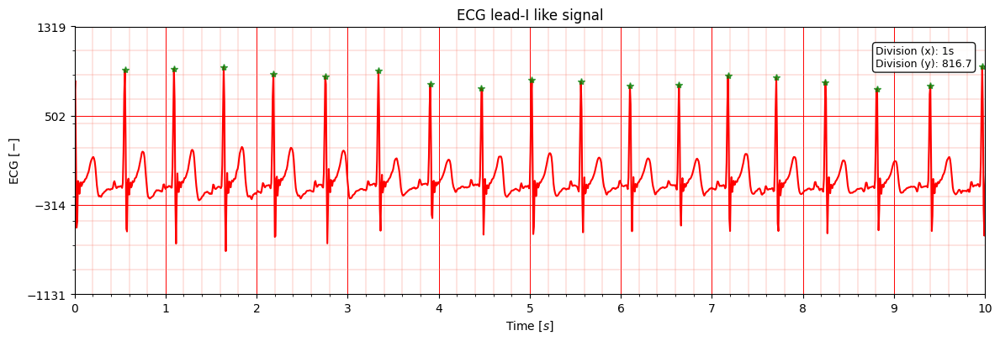

프로토콜: 2.0 HIT


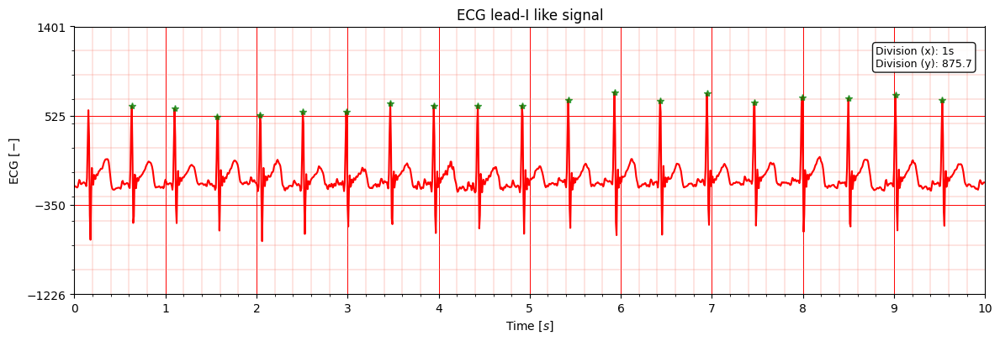

프로토콜: 3.0 MA


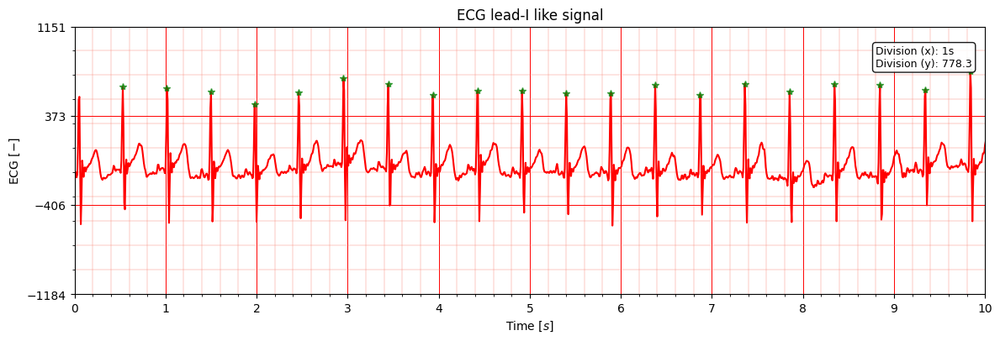

(M)006_20230507_110506_H10.csv
Value is nan
프로토콜: 1.0 BASELINE


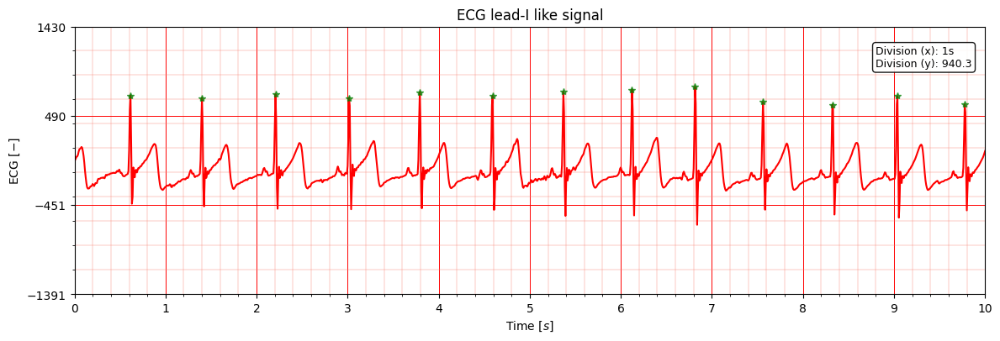

프로토콜: 2.0 HIT


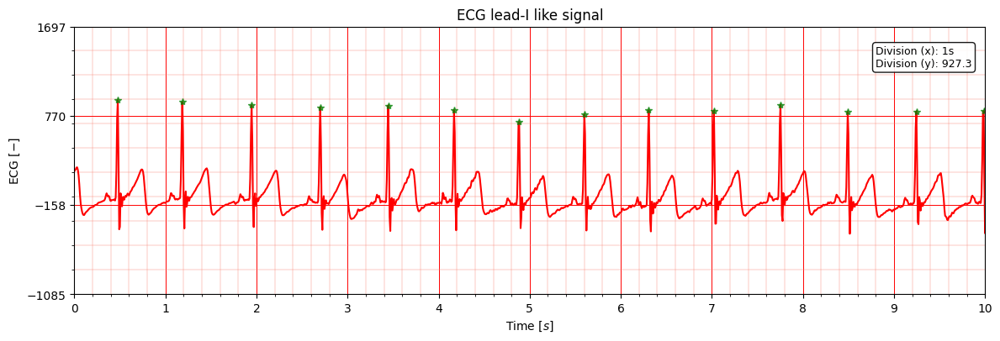

프로토콜: 3.0 MA


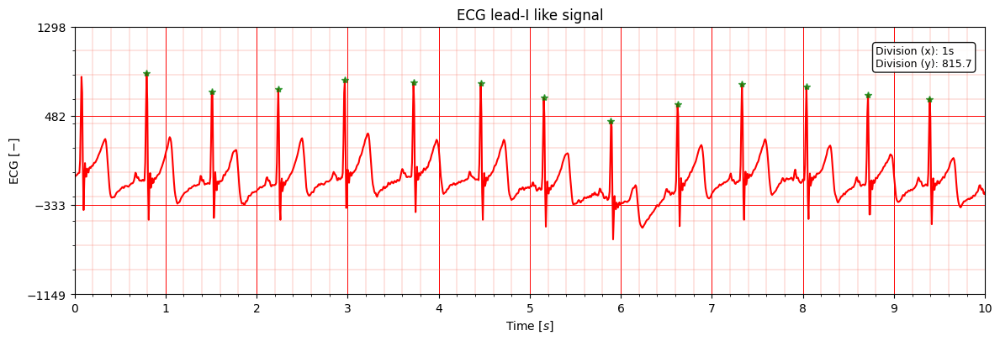

(M)007_20230507_110503_H10.csv
Value is nan
프로토콜: 1.0 BASELINE


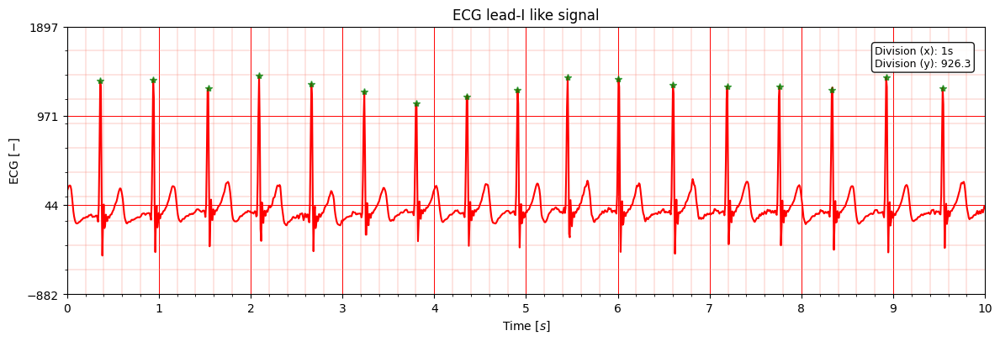

프로토콜: 2.0 HIT


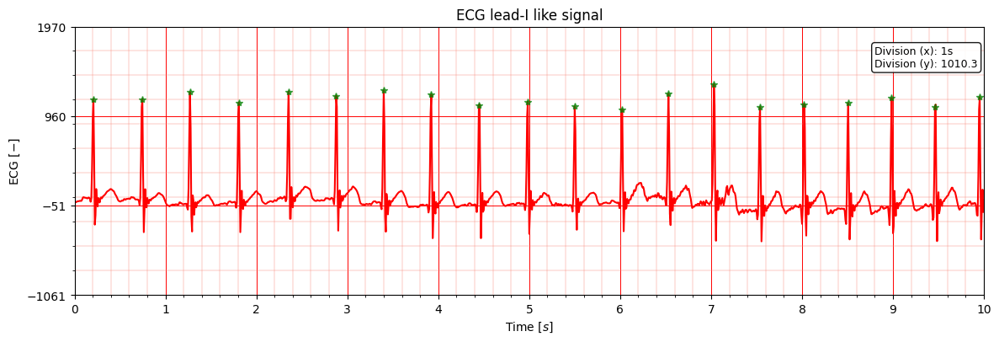

프로토콜: 3.0 MA


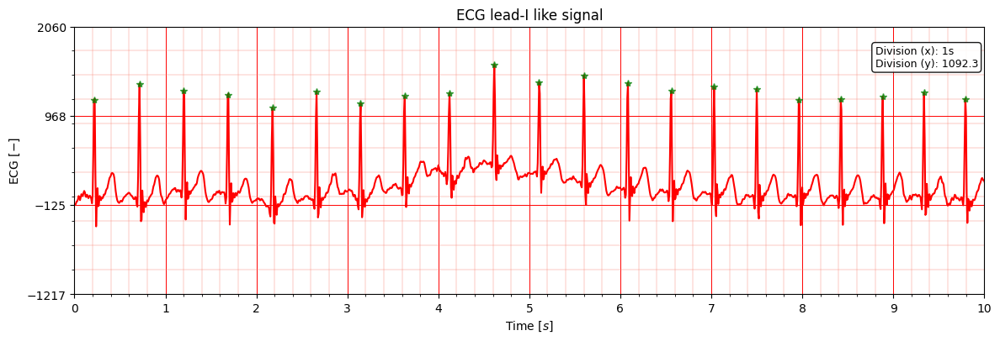

(M)008_20230507_113824_H10.csv
Value is nan
프로토콜: 1.0 BASELINE


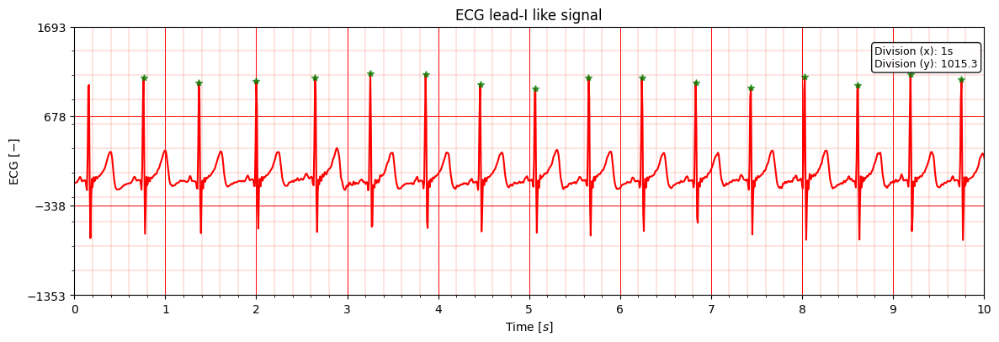

프로토콜: 2.0 HIT


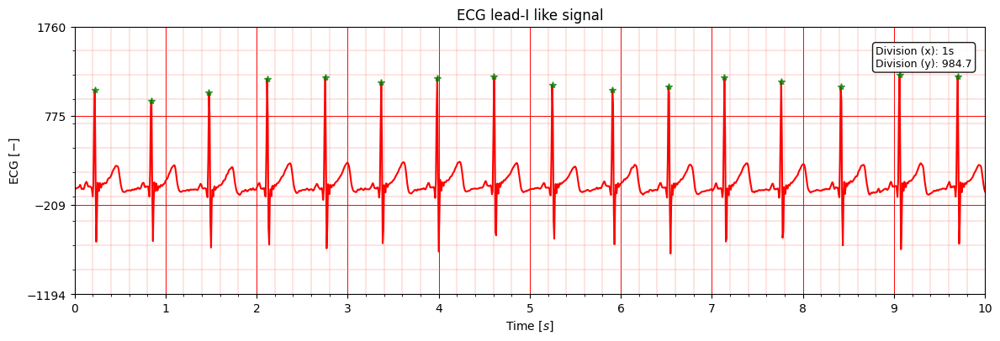

프로토콜: 3.0 MA


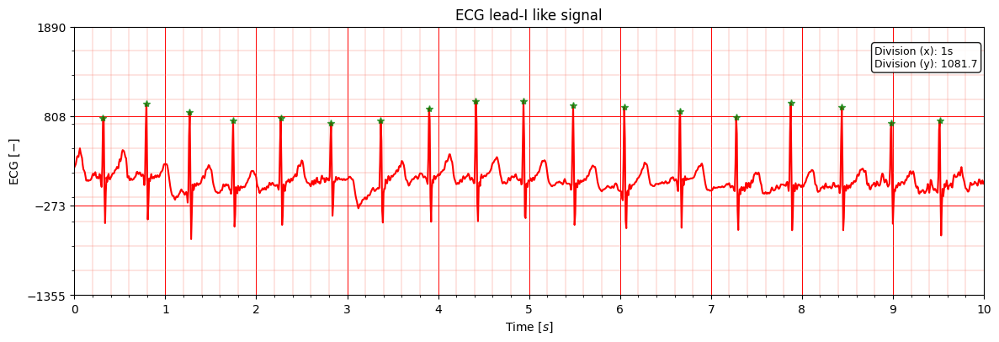

(M)009_20230507_095758_H10.csv
Value is nan
프로토콜: 1.0 BASELINE
 VALUE ERROR
------------------------------
프로토콜: 2.0 HIT


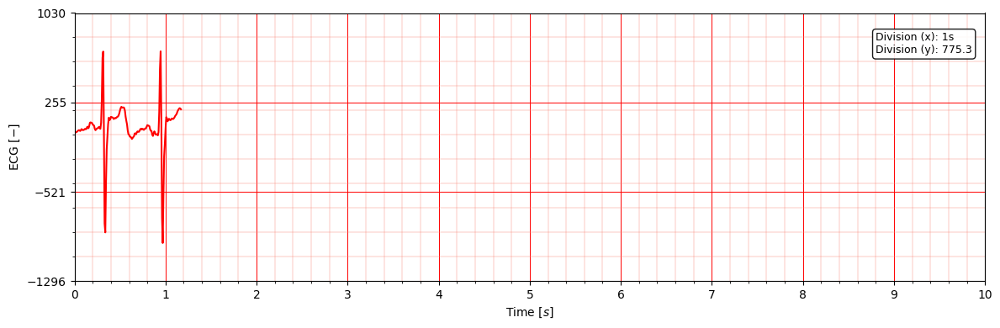

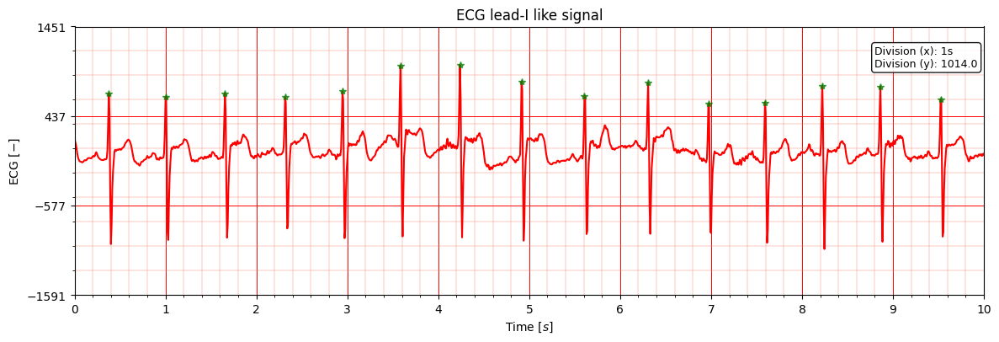

프로토콜: 3.0 MA


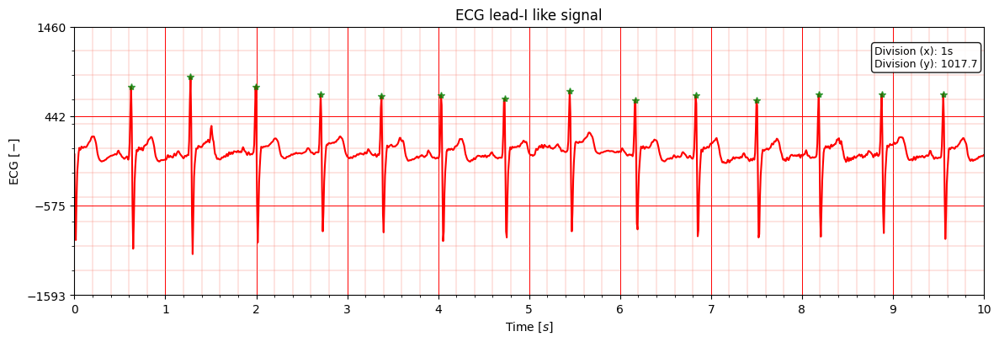

(M)010_20230507_103416_H10.csv
Value is nan
프로토콜: 1.0 BASELINE


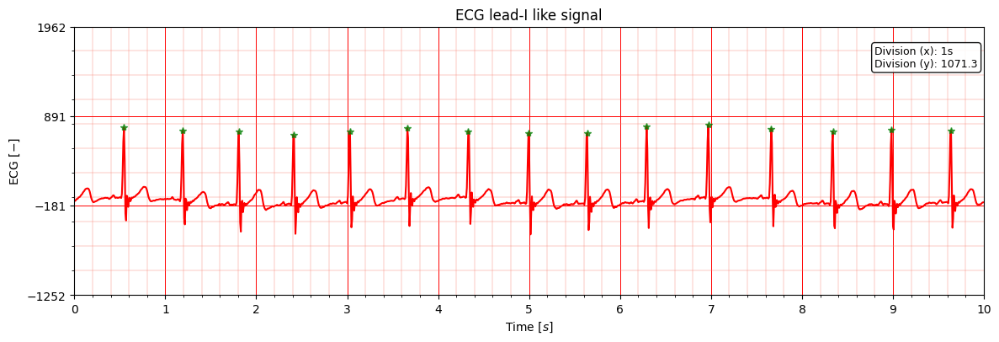

프로토콜: 2.0 HIT


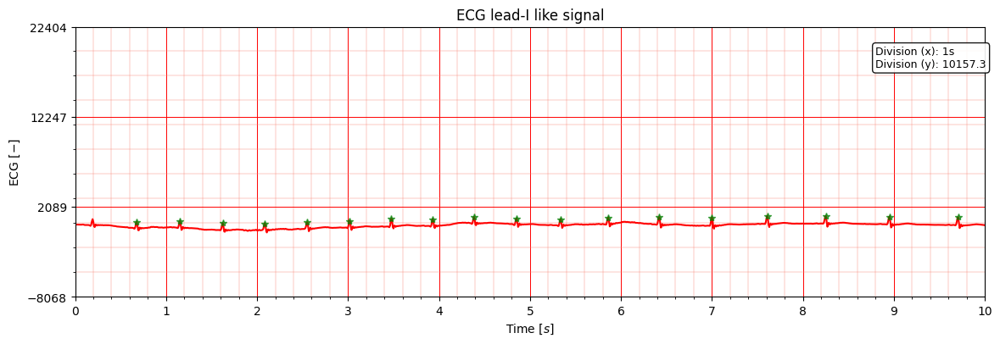

프로토콜: 3.0 MA


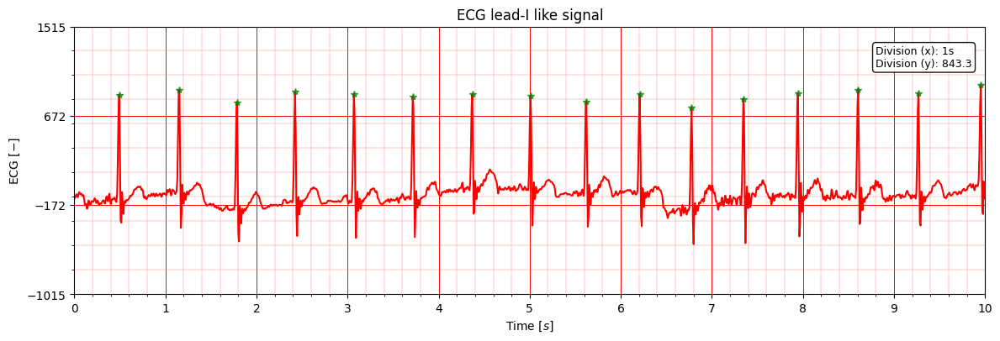

(M)011_20230507_120541_H10.csv
Value is nan
프로토콜: 1.0 BASELINE


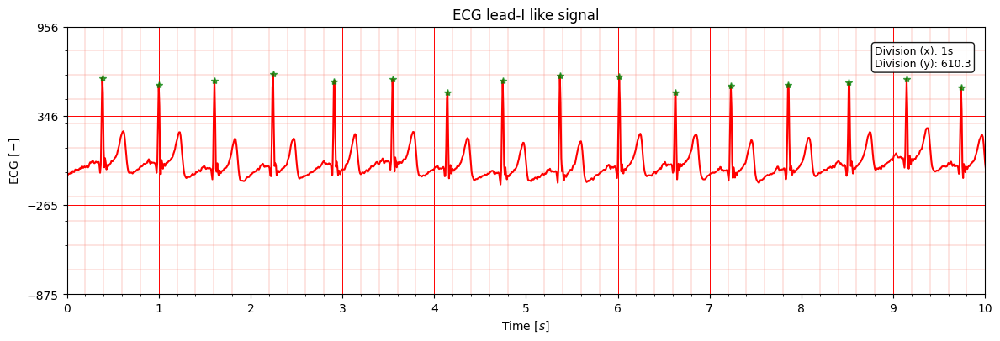

프로토콜: 2.0 HIT


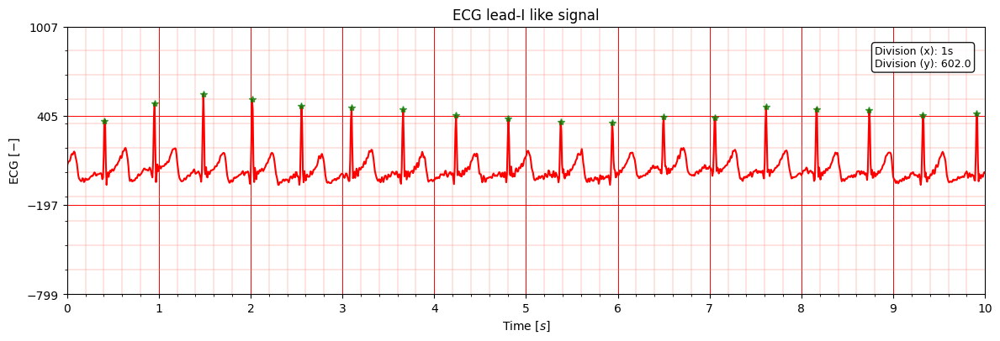

프로토콜: 3.0 MA


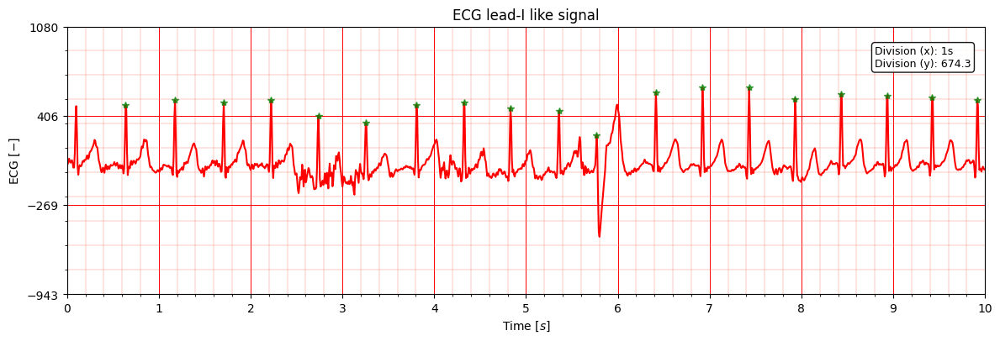

(M)012_20230507_093010_H10.csv
Value is nan
프로토콜: 1.0 BASELINE


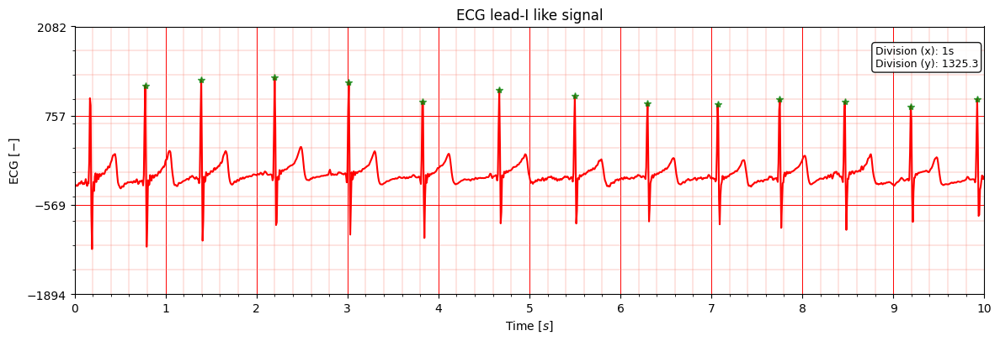

프로토콜: 2.0 HIT


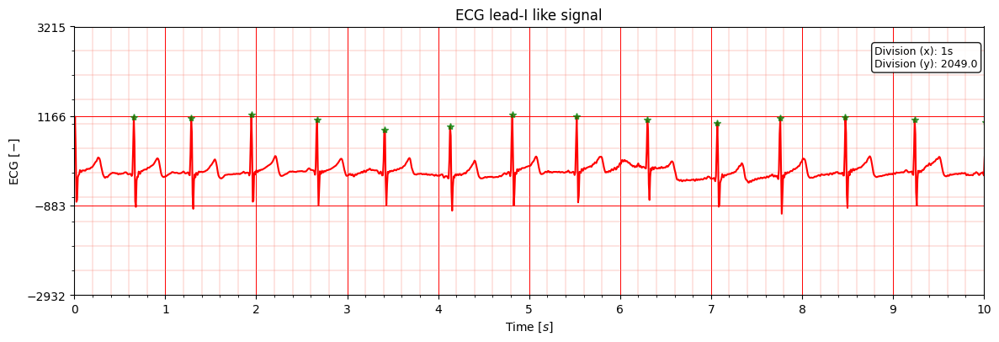

프로토콜: 3.0 MA


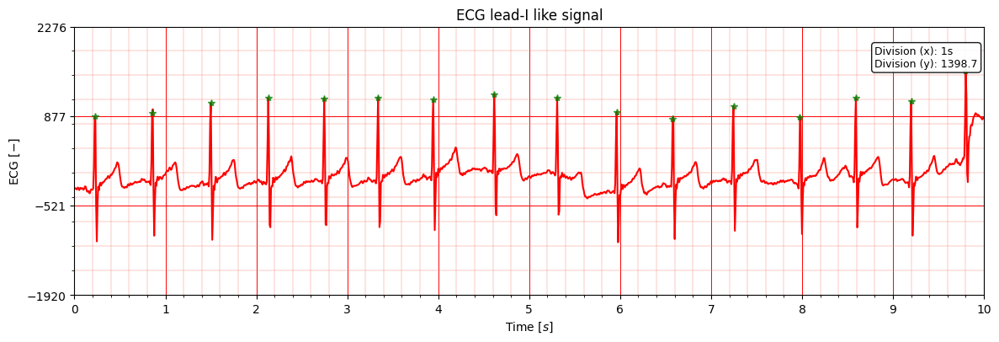

(M)013_20230507_113448_H10.csv
Value is nan
프로토콜: 1.0 BASELINE


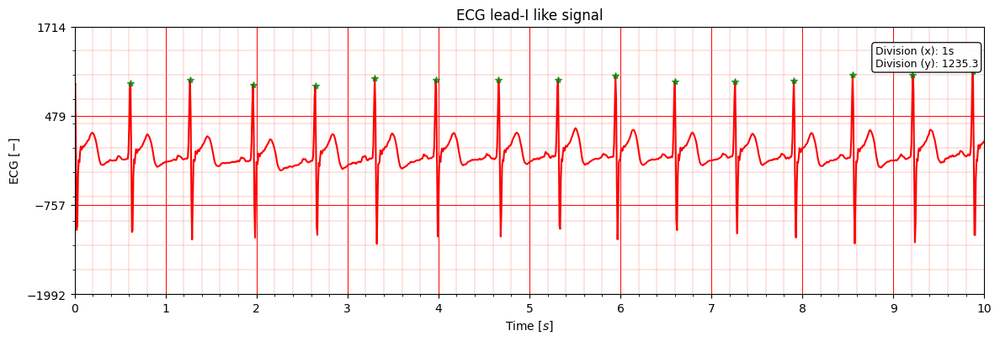

프로토콜: 2.0 HIT


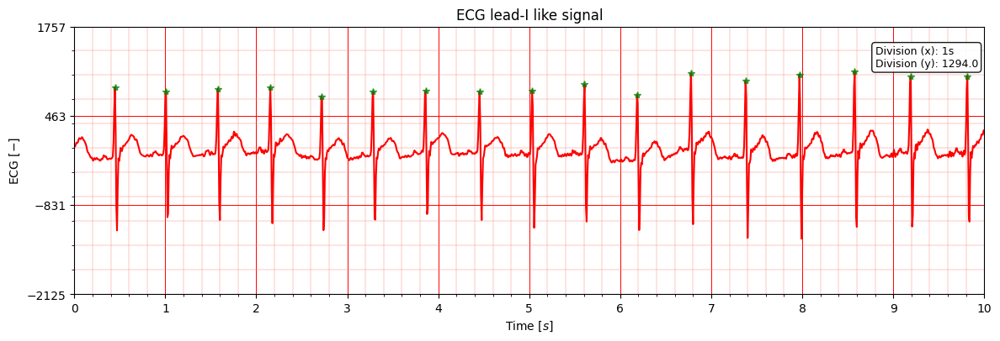

프로토콜: 3.0 MA


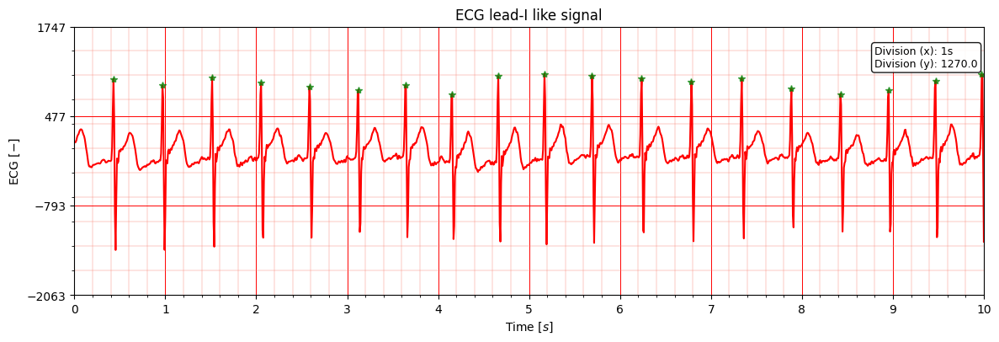

(M)014_20230507_095721_H10.csv
Value is nan
(M)016_20230507_085913_H10.csv
Value is nan
프로토콜: 1.0 BASELINE


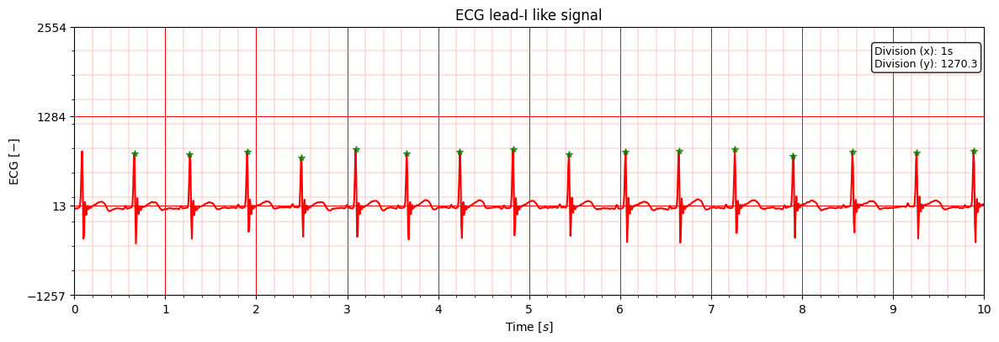

프로토콜: 2.0 HIT


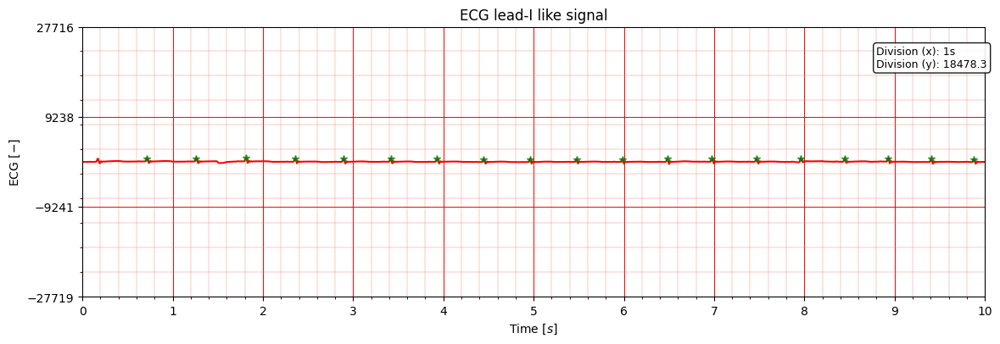

프로토콜: 3.0 MA


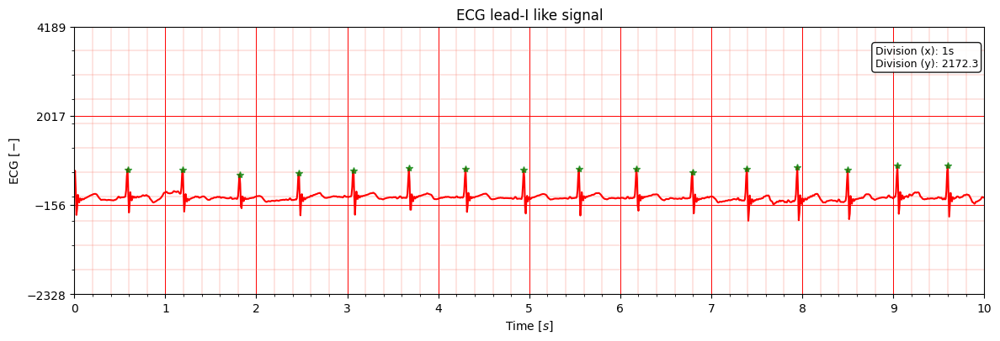

(M)017_20230507_110427_H10.csv
Value is nan
프로토콜: 1.0 BASELINE


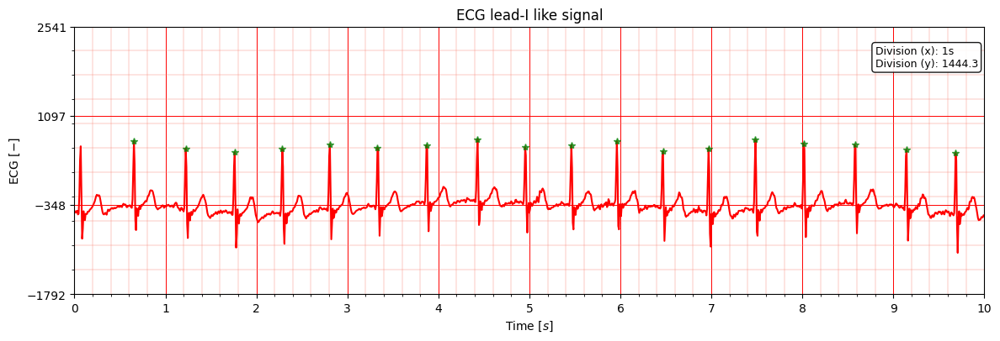

프로토콜: 2.0 HIT


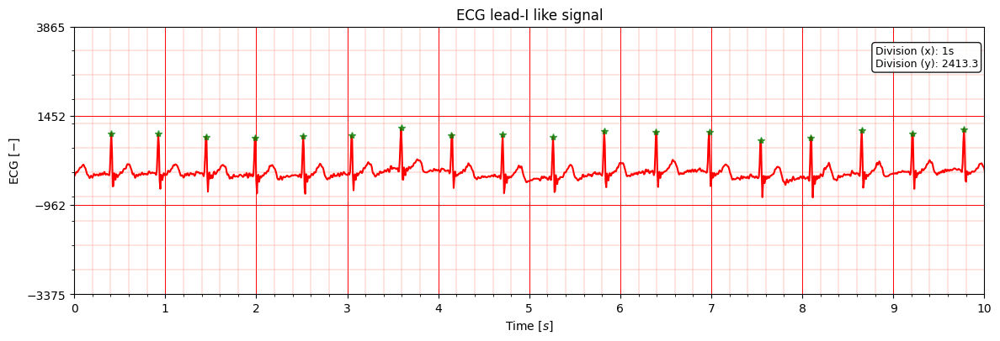

프로토콜: 3.0 MA


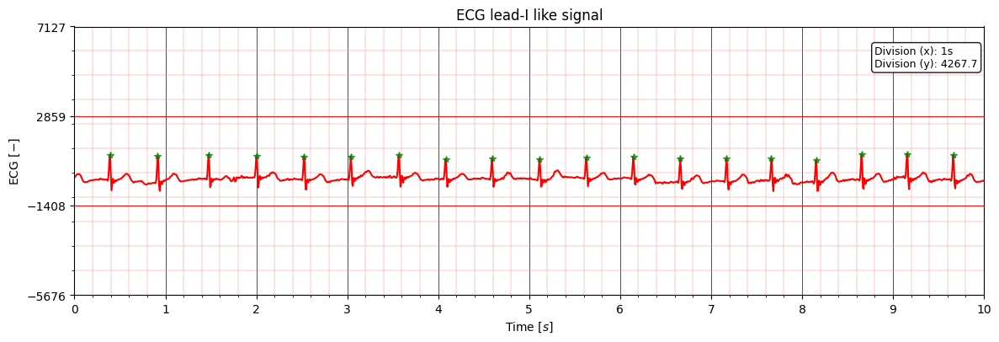

(M)018_20230507_100932_H10.csv
Value is nan
프로토콜: 1.0 BASELINE


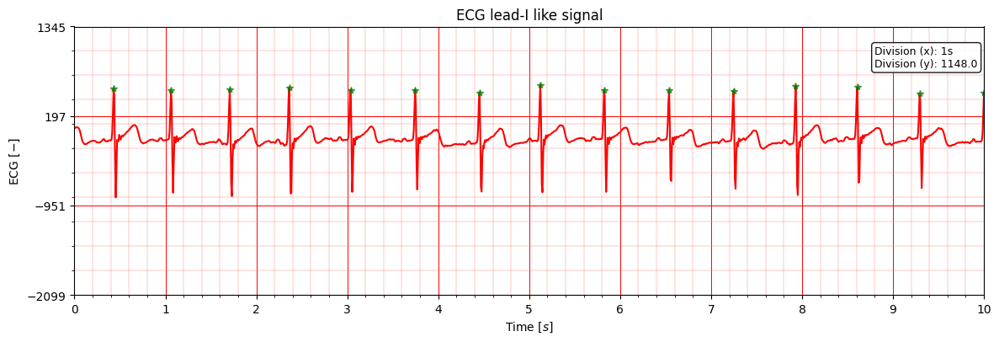

프로토콜: 2.0 HIT


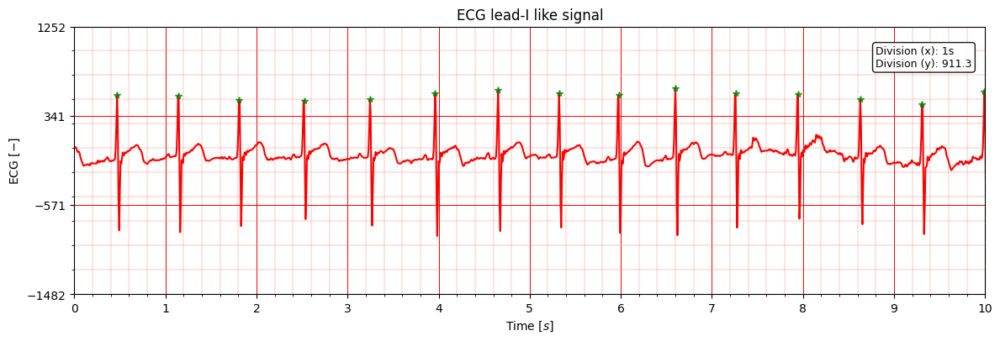

프로토콜: 3.0 MA


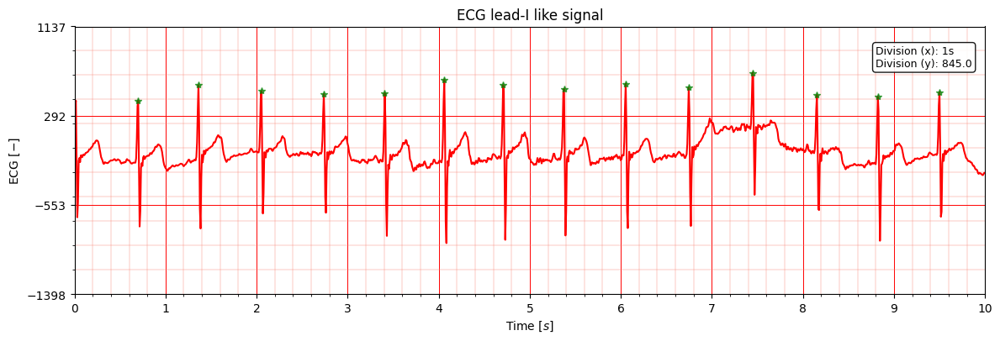

(M)019_20230507_101420_H10.csv
Value is nan
프로토콜: 1.0 BASELINE


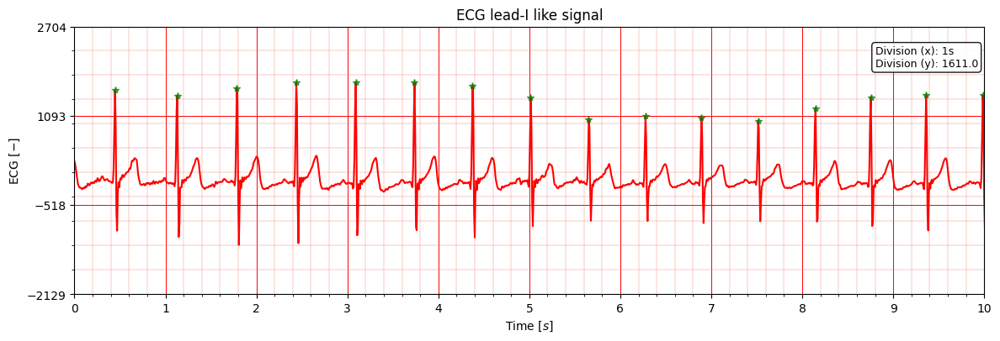

프로토콜: 2.0 HIT


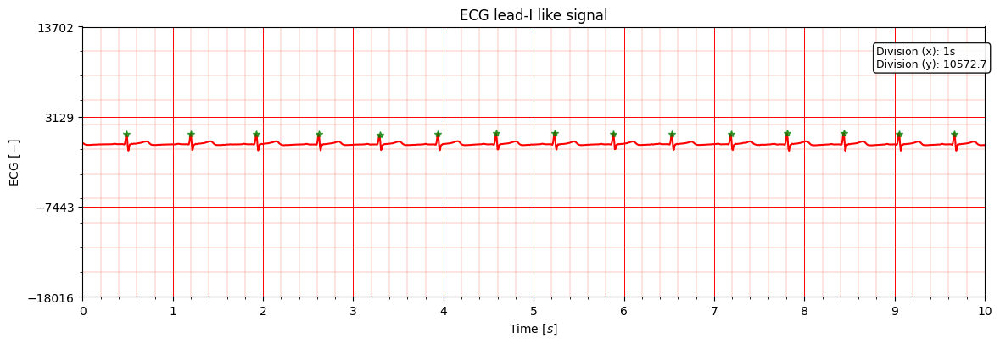

프로토콜: 3.0 MA


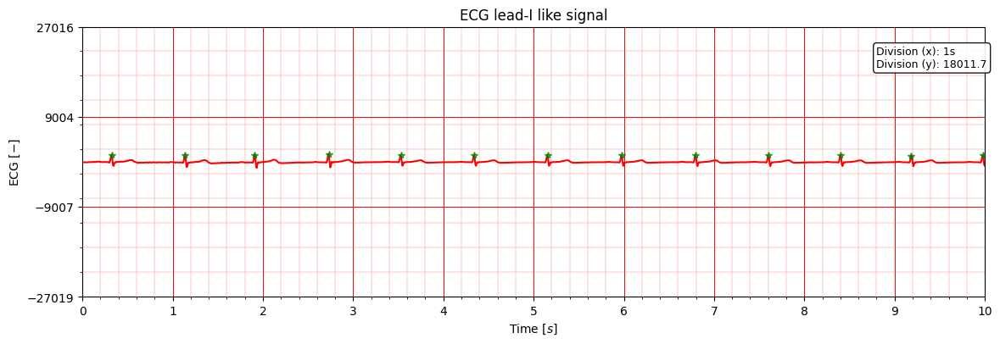

(M)020_20230507_122941_H10.csv
Value is nan
프로토콜: 1.0 BASELINE


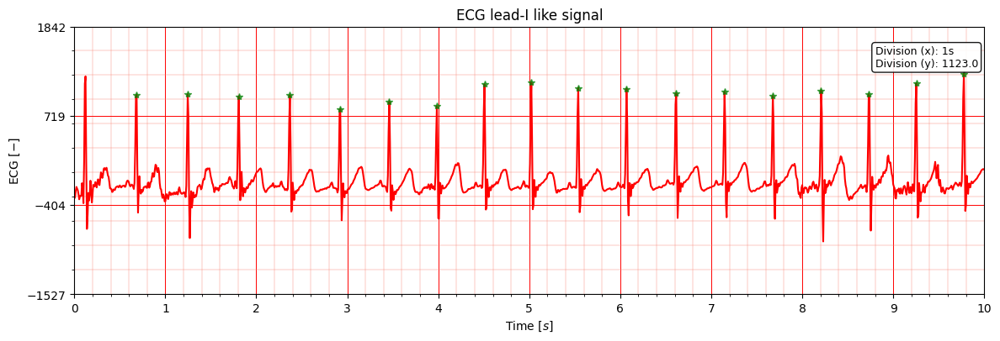

프로토콜: 2.0 HIT


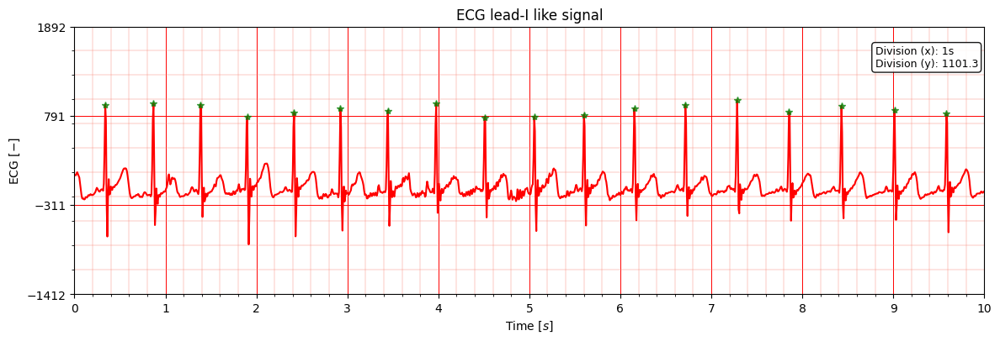

프로토콜: 3.0 MA


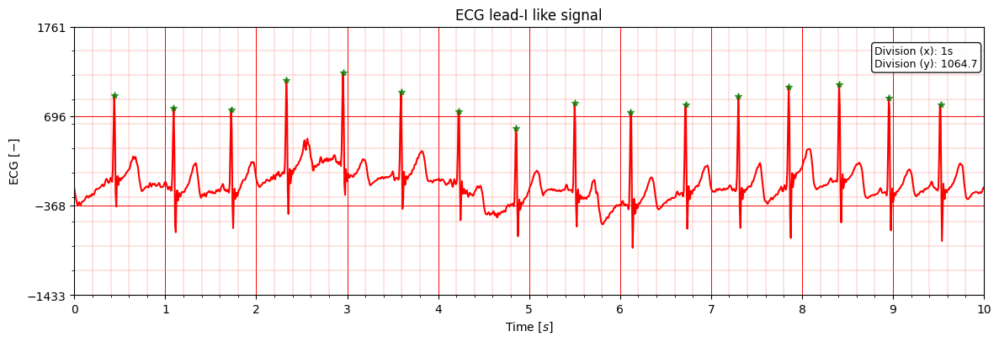

In [71]:
for i in mast_h10_dict:
    print(i)
    for p in mast_h10_dict[i]['proc'].unique():
        if np.isnan(p):
            print('Value is nan')
            continue
        else:
            print('프로토콜:', p, MAST_PROTOCOL_NAME[p])
            signal = mast_h10_dict[i][mast_h10_dict[i]['proc'] == p]['sensor']
            try:
                fig = tools.plot_ecg(signal = signal, sampling_rate = 130)
            except:
                print(' VALUE ERROR')
                print('-'*30)
                pass

(M)001_20230507_093641_H10.csv
Value is nan
(M)001_20230507_094057_H10.csv
Value is nan
프로토콜: 1.0 BASELINE


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/tools.py:375: UserWarning: Interval limits out of boundaries. Interval set to: [0, 38.817]
  interval = pyhrv.utils.check_interval(interval, limits=[0, t[-1]], default=[0, 10])


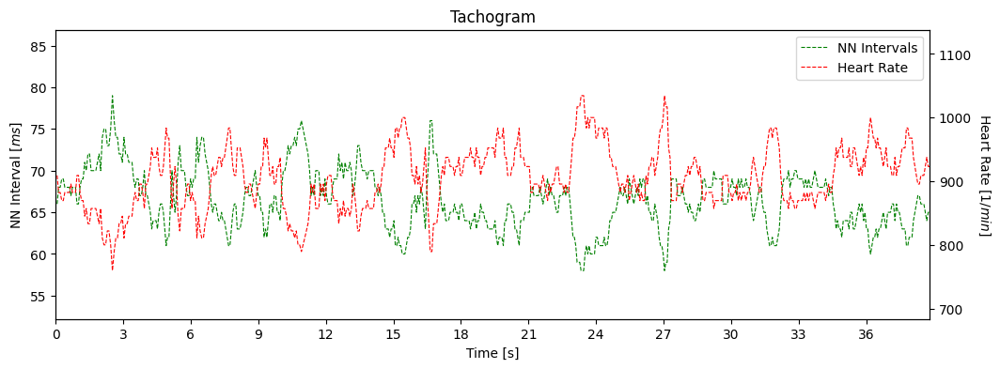

프로토콜: 2.0 HIT


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/tools.py:375: UserWarning: Interval limits out of boundaries. Interval set to: [0, 46.665]
  interval = pyhrv.utils.check_interval(interval, limits=[0, t[-1]], default=[0, 10])


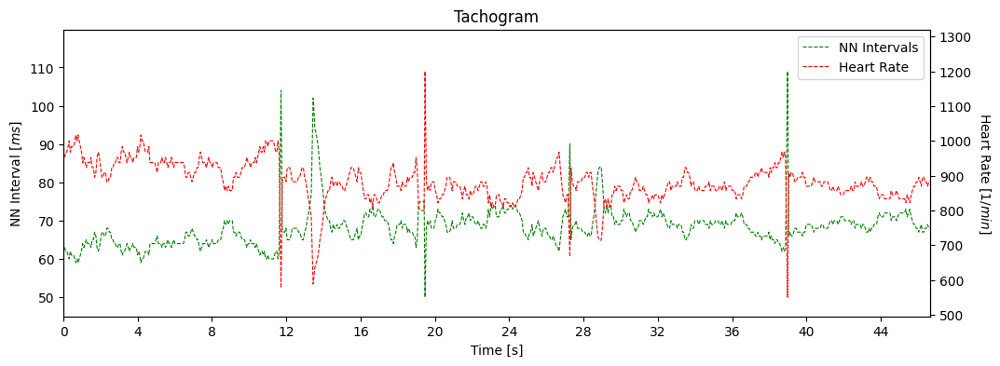

프로토콜: 3.0 MA


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/tools.py:375: UserWarning: Interval limits out of boundaries. Interval set to: [0, 31.015]
  interval = pyhrv.utils.check_interval(interval, limits=[0, t[-1]], default=[0, 10])


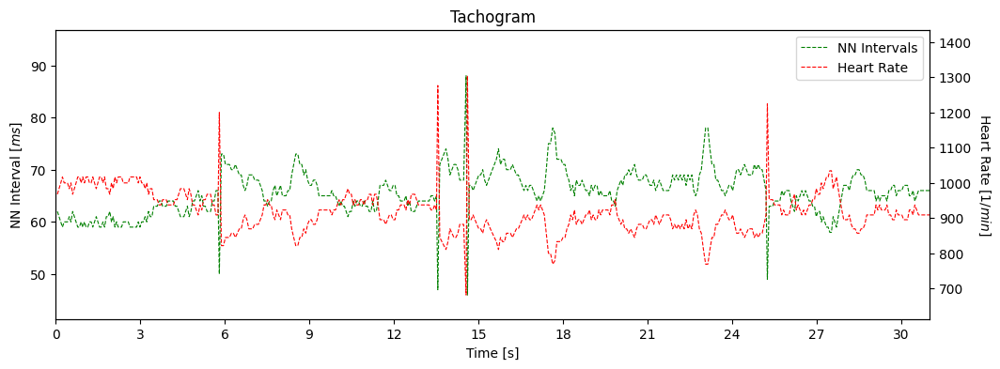

(M)002_20230507_103326_H10.csv
Value is nan
프로토콜: 1.0 BASELINE


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/tools.py:375: UserWarning: Interval limits out of boundaries. Interval set to: [0, 38.881]
  interval = pyhrv.utils.check_interval(interval, limits=[0, t[-1]], default=[0, 10])


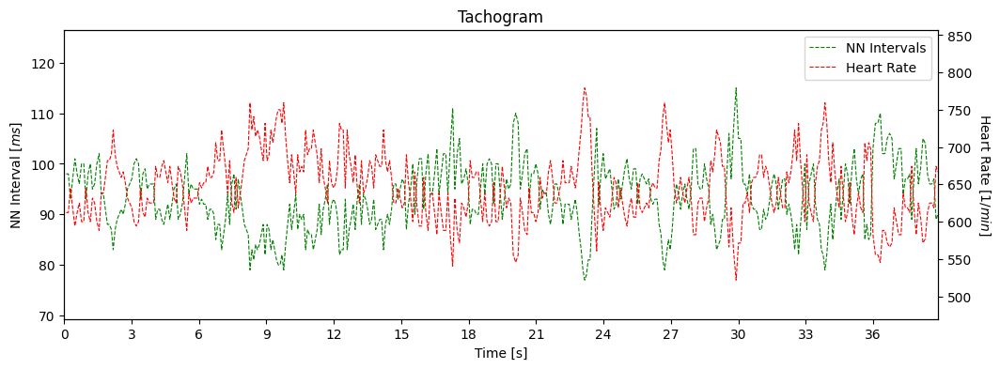

프로토콜: 2.0 HIT


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/tools.py:375: UserWarning: Interval limits out of boundaries. Interval set to: [0, 46.666]
  interval = pyhrv.utils.check_interval(interval, limits=[0, t[-1]], default=[0, 10])


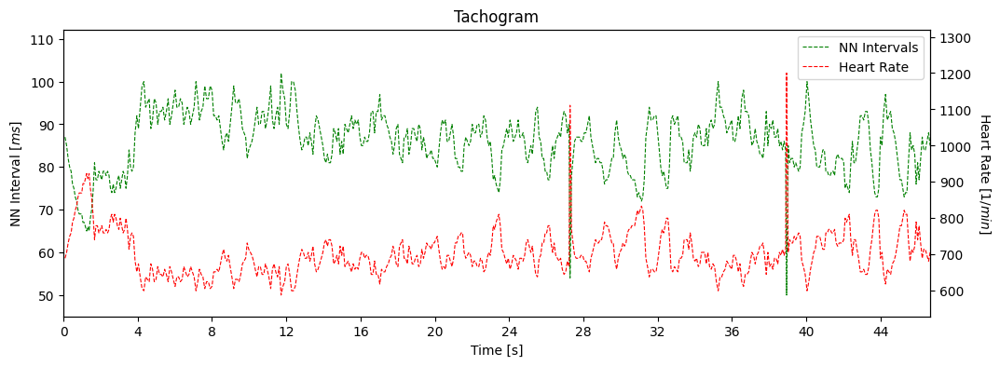

프로토콜: 3.0 MA


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/tools.py:375: UserWarning: Interval limits out of boundaries. Interval set to: [0, 31.04]
  interval = pyhrv.utils.check_interval(interval, limits=[0, t[-1]], default=[0, 10])


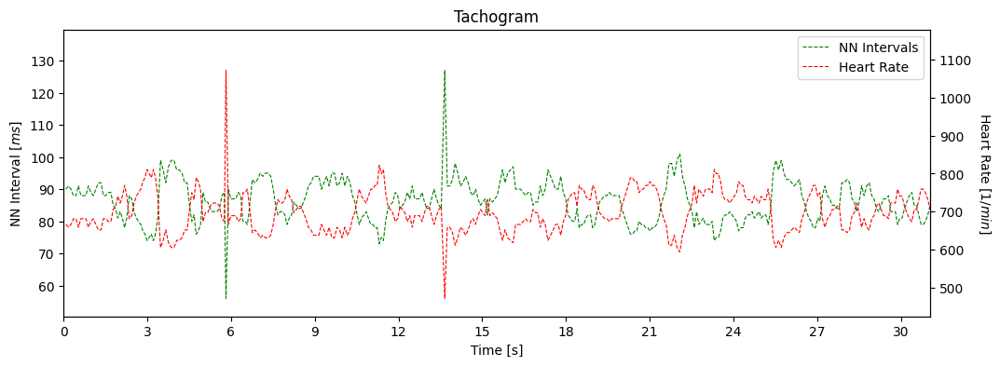

(M)003_20230507_090129_H10.csv
Value is nan
프로토콜: 1.0 BASELINE


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/tools.py:375: UserWarning: Interval limits out of boundaries. Interval set to: [0, 38.795]
  interval = pyhrv.utils.check_interval(interval, limits=[0, t[-1]], default=[0, 10])


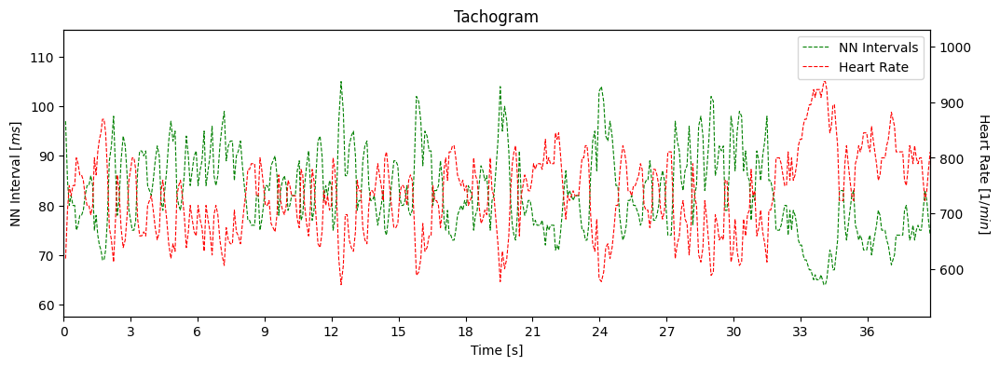

프로토콜: 2.0 HIT


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/tools.py:375: UserWarning: Interval limits out of boundaries. Interval set to: [0, 46.626]
  interval = pyhrv.utils.check_interval(interval, limits=[0, t[-1]], default=[0, 10])


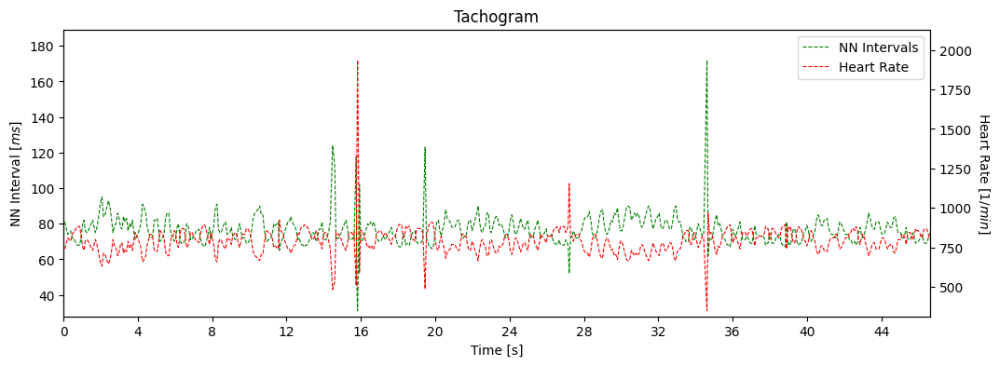

프로토콜: 3.0 MA


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/tools.py:375: UserWarning: Interval limits out of boundaries. Interval set to: [0, 31.026]
  interval = pyhrv.utils.check_interval(interval, limits=[0, t[-1]], default=[0, 10])


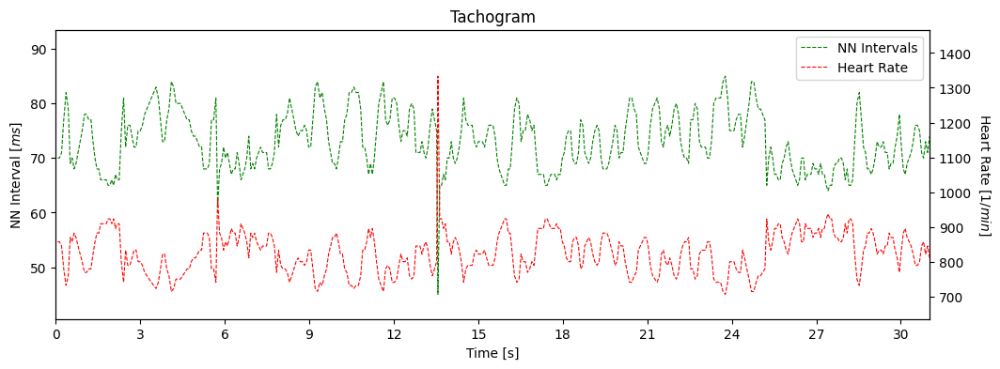

(M)004_20230507_093440_H10.csv
Value is nan
프로토콜: 1.0 BASELINE


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/tools.py:375: UserWarning: Interval limits out of boundaries. Interval set to: [0, 38.855]
  interval = pyhrv.utils.check_interval(interval, limits=[0, t[-1]], default=[0, 10])


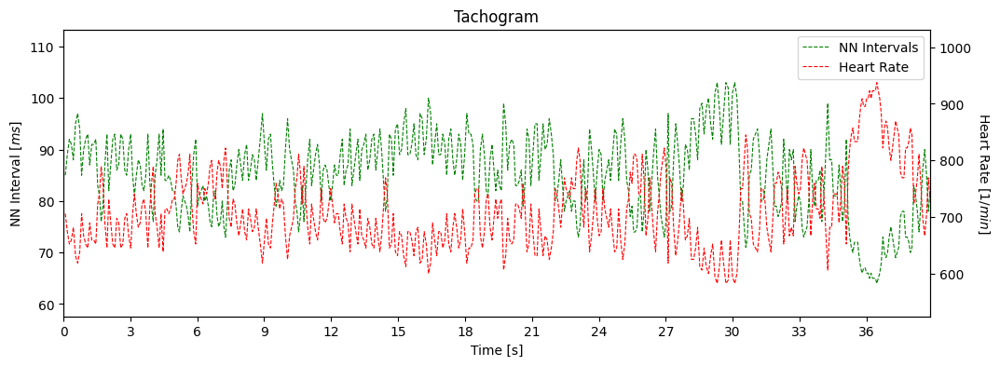

프로토콜: 2.0 HIT


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/tools.py:375: UserWarning: Interval limits out of boundaries. Interval set to: [0, 46.608]
  interval = pyhrv.utils.check_interval(interval, limits=[0, t[-1]], default=[0, 10])


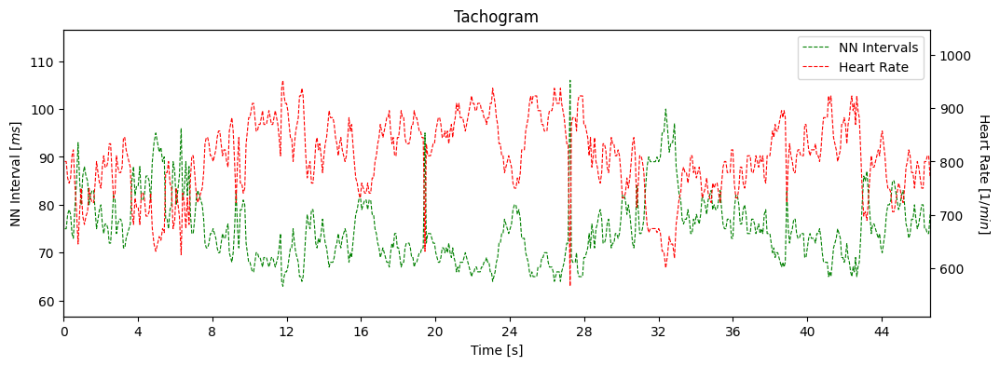

프로토콜: 3.0 MA


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/tools.py:375: UserWarning: Interval limits out of boundaries. Interval set to: [0, 31.052]
  interval = pyhrv.utils.check_interval(interval, limits=[0, t[-1]], default=[0, 10])


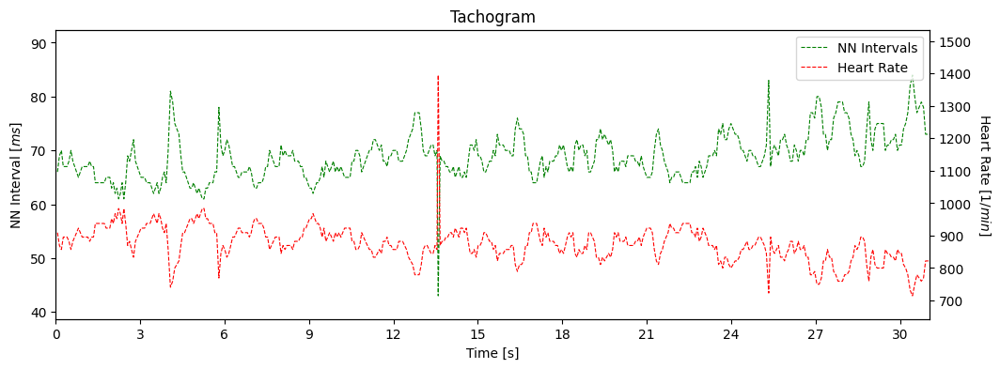

(M)005_20230507_113956_H10.csv
Value is nan
프로토콜: 1.0 BASELINE


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/tools.py:375: UserWarning: Interval limits out of boundaries. Interval set to: [0, 38.791]
  interval = pyhrv.utils.check_interval(interval, limits=[0, t[-1]], default=[0, 10])


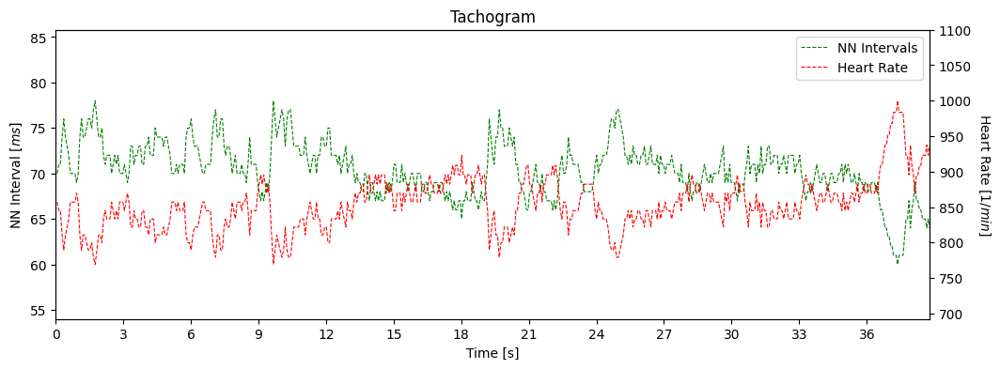

프로토콜: 2.0 HIT


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/tools.py:375: UserWarning: Interval limits out of boundaries. Interval set to: [0, 46.574]
  interval = pyhrv.utils.check_interval(interval, limits=[0, t[-1]], default=[0, 10])


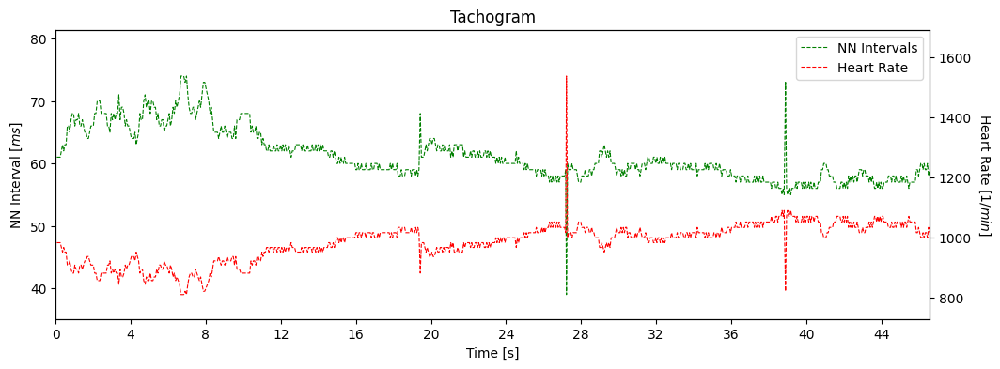

프로토콜: 3.0 MA


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/tools.py:375: UserWarning: Interval limits out of boundaries. Interval set to: [0, 31.004]
  interval = pyhrv.utils.check_interval(interval, limits=[0, t[-1]], default=[0, 10])


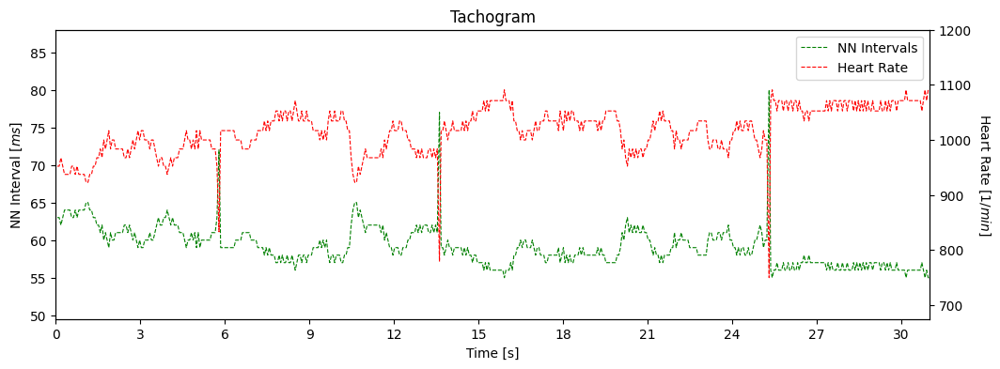

(M)006_20230507_110506_H10.csv
Value is nan
프로토콜: 1.0 BASELINE


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/tools.py:375: UserWarning: Interval limits out of boundaries. Interval set to: [0, 38.765]
  interval = pyhrv.utils.check_interval(interval, limits=[0, t[-1]], default=[0, 10])


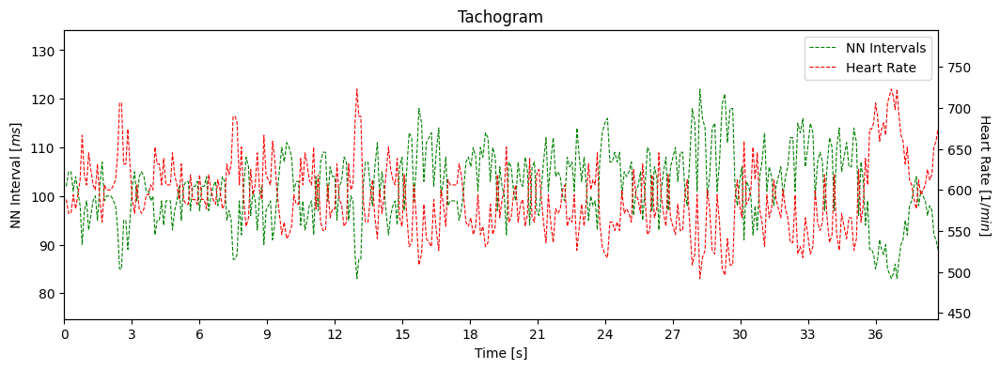

프로토콜: 2.0 HIT


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/tools.py:375: UserWarning: Interval limits out of boundaries. Interval set to: [0, 46.585]
  interval = pyhrv.utils.check_interval(interval, limits=[0, t[-1]], default=[0, 10])


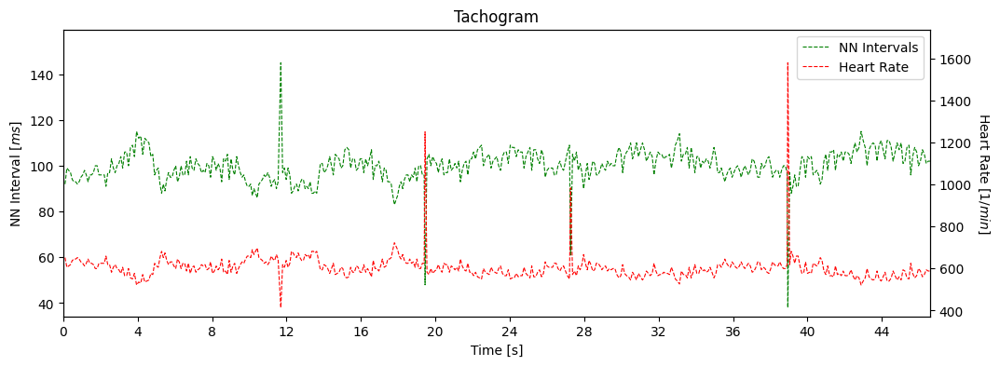

프로토콜: 3.0 MA


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/tools.py:375: UserWarning: Interval limits out of boundaries. Interval set to: [0, 31.006]
  interval = pyhrv.utils.check_interval(interval, limits=[0, t[-1]], default=[0, 10])


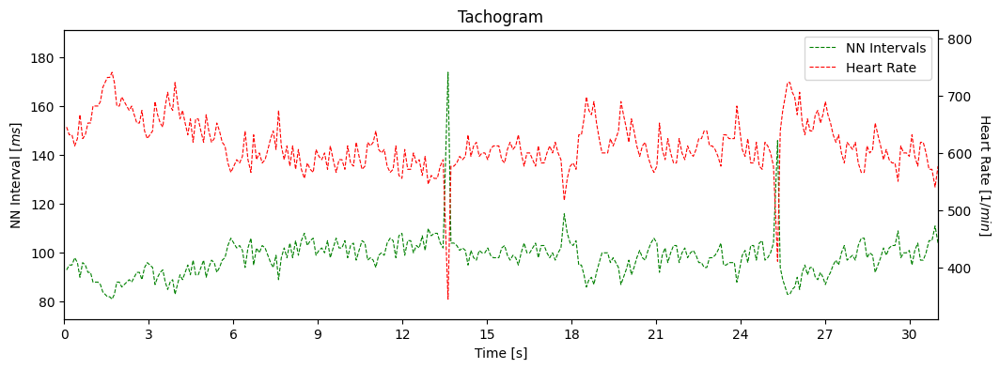

(M)007_20230507_110503_H10.csv
Value is nan
프로토콜: 1.0 BASELINE


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/tools.py:375: UserWarning: Interval limits out of boundaries. Interval set to: [0, 38.804]
  interval = pyhrv.utils.check_interval(interval, limits=[0, t[-1]], default=[0, 10])


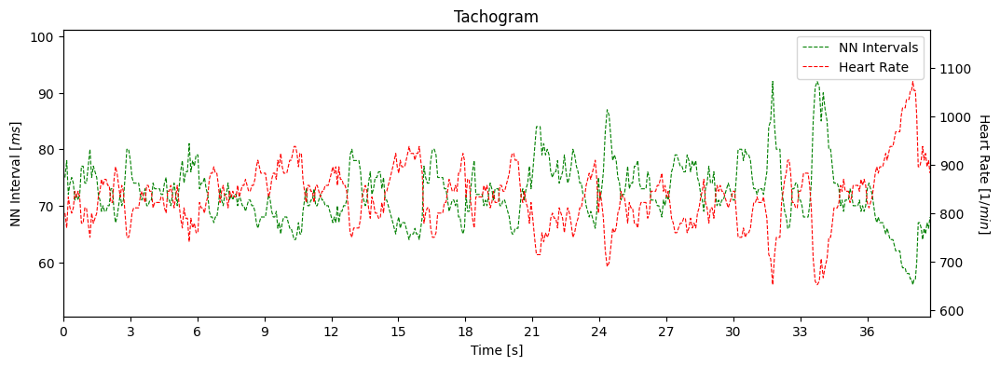

프로토콜: 2.0 HIT


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/tools.py:375: UserWarning: Interval limits out of boundaries. Interval set to: [0, 46.644]
  interval = pyhrv.utils.check_interval(interval, limits=[0, t[-1]], default=[0, 10])


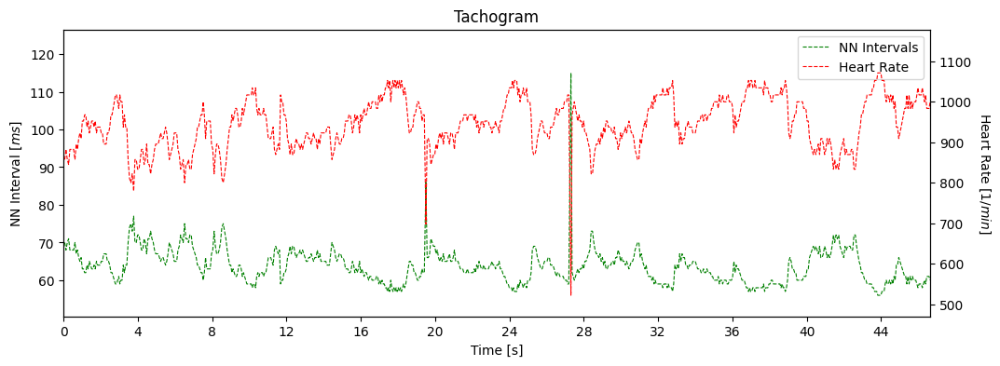

프로토콜: 3.0 MA


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/tools.py:375: UserWarning: Interval limits out of boundaries. Interval set to: [0, 31.043]
  interval = pyhrv.utils.check_interval(interval, limits=[0, t[-1]], default=[0, 10])


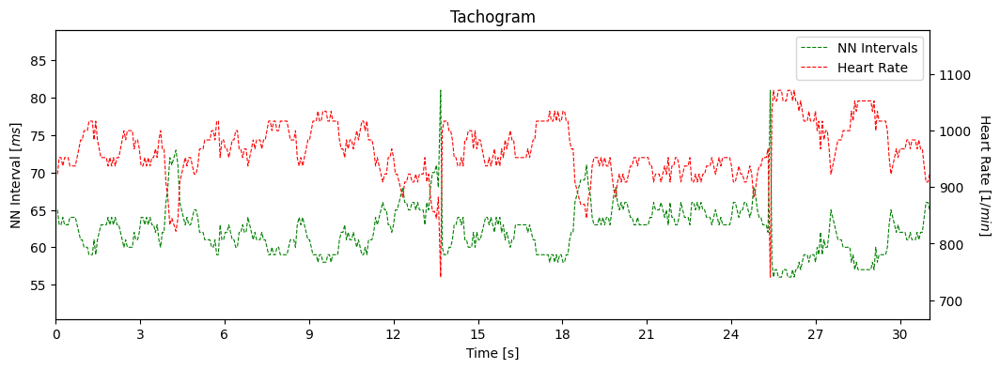

(M)008_20230507_113824_H10.csv
Value is nan
프로토콜: 1.0 BASELINE


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/tools.py:375: UserWarning: Interval limits out of boundaries. Interval set to: [0, 38.754]
  interval = pyhrv.utils.check_interval(interval, limits=[0, t[-1]], default=[0, 10])


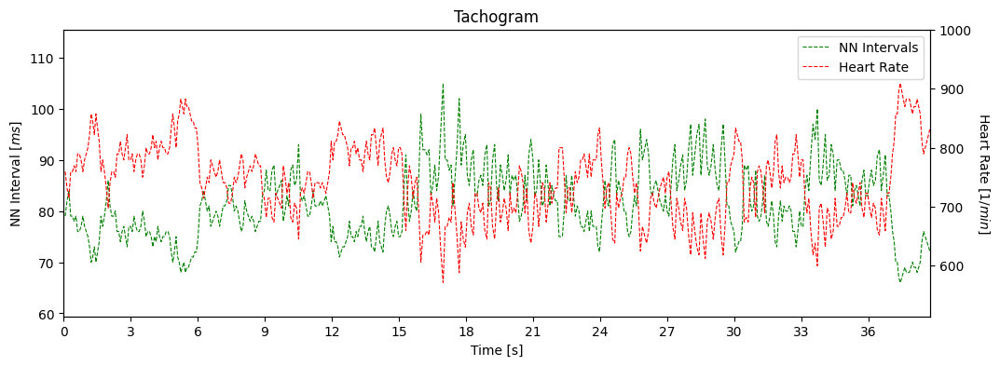

프로토콜: 2.0 HIT


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/tools.py:375: UserWarning: Interval limits out of boundaries. Interval set to: [0, 46.656]
  interval = pyhrv.utils.check_interval(interval, limits=[0, t[-1]], default=[0, 10])


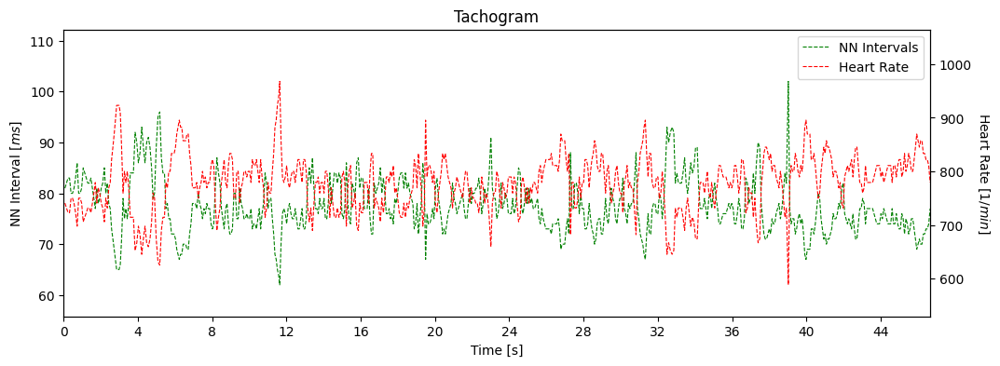

프로토콜: 3.0 MA


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/tools.py:375: UserWarning: Interval limits out of boundaries. Interval set to: [0, 31.068]
  interval = pyhrv.utils.check_interval(interval, limits=[0, t[-1]], default=[0, 10])


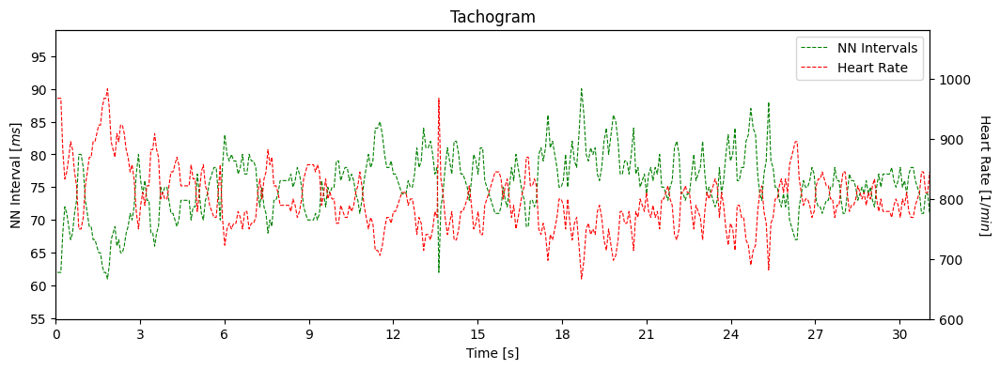

(M)009_20230507_095758_H10.csv
Value is nan
프로토콜: 1.0 BASELINE
 VALUE ERROR
------------------------------
프로토콜: 2.0 HIT


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/tools.py:375: UserWarning: Interval limits out of boundaries. Interval set to: [0, 46.674]
  interval = pyhrv.utils.check_interval(interval, limits=[0, t[-1]], default=[0, 10])


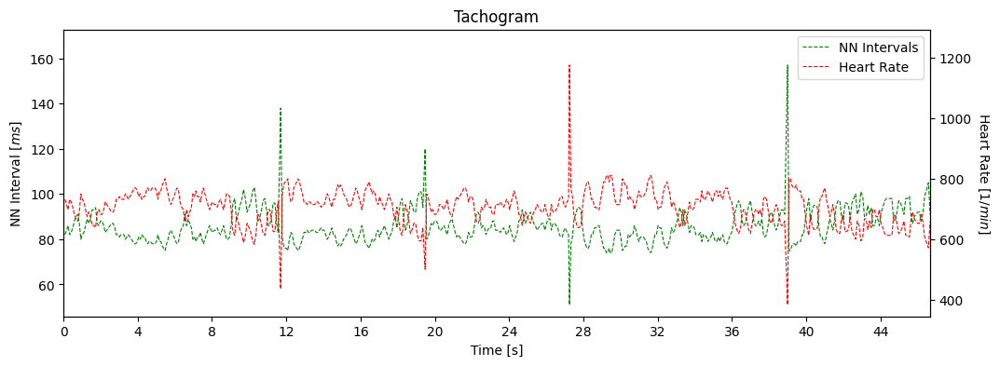

프로토콜: 3.0 MA


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/tools.py:375: UserWarning: Interval limits out of boundaries. Interval set to: [0, 31.018]
  interval = pyhrv.utils.check_interval(interval, limits=[0, t[-1]], default=[0, 10])


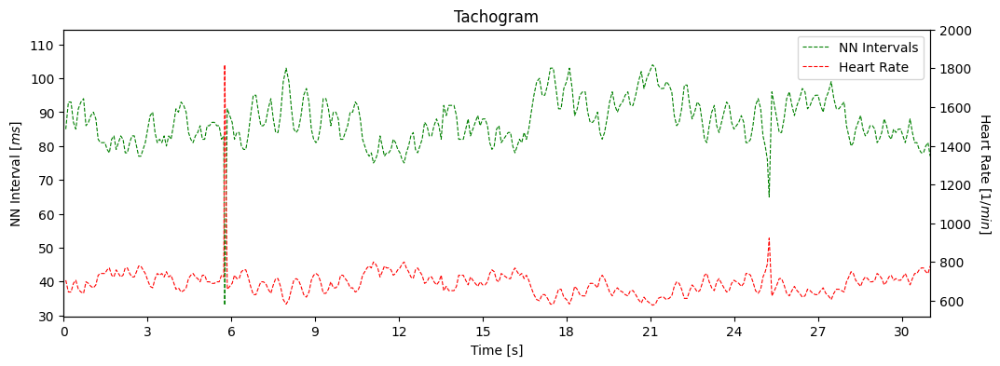

(M)010_20230507_103416_H10.csv
Value is nan
프로토콜: 1.0 BASELINE


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/tools.py:375: UserWarning: Interval limits out of boundaries. Interval set to: [0, 38.803]
  interval = pyhrv.utils.check_interval(interval, limits=[0, t[-1]], default=[0, 10])


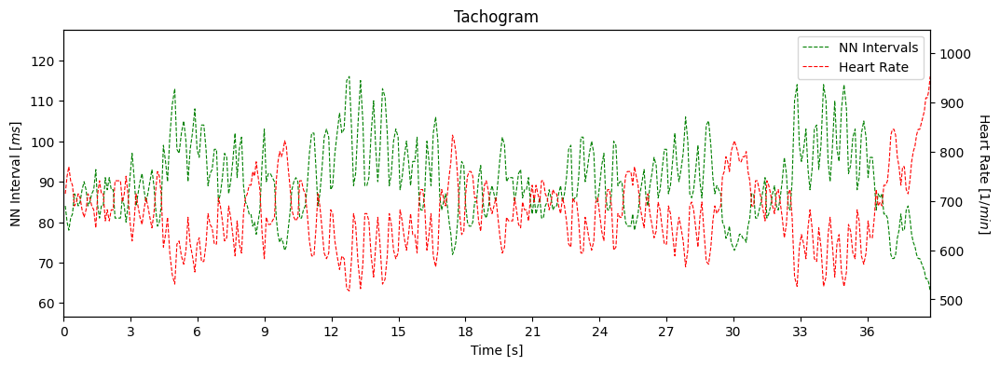

프로토콜: 2.0 HIT


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/tools.py:375: UserWarning: Interval limits out of boundaries. Interval set to: [0, 46.561]
  interval = pyhrv.utils.check_interval(interval, limits=[0, t[-1]], default=[0, 10])


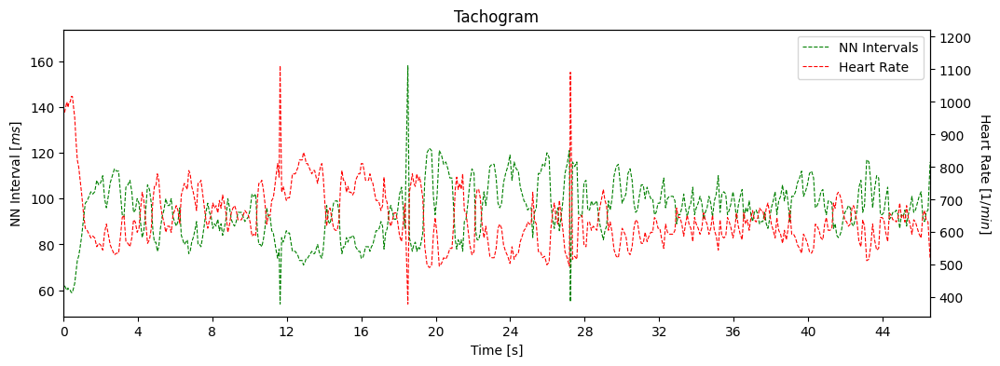

프로토콜: 3.0 MA


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/tools.py:375: UserWarning: Interval limits out of boundaries. Interval set to: [0, 30.986]
  interval = pyhrv.utils.check_interval(interval, limits=[0, t[-1]], default=[0, 10])


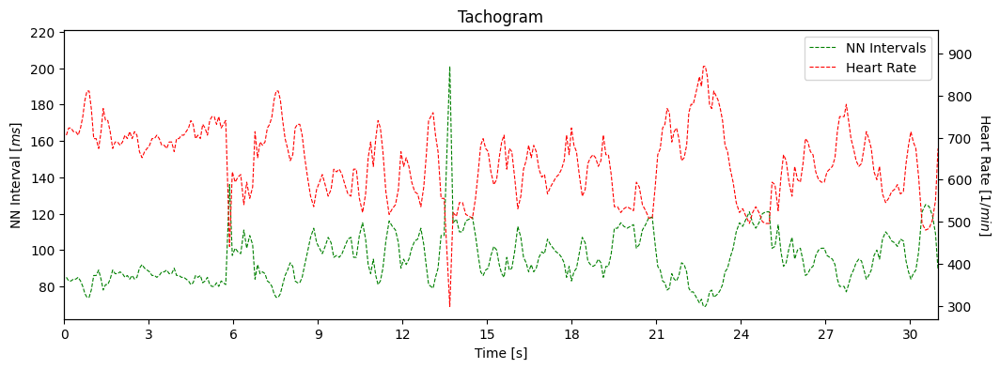

(M)011_20230507_120541_H10.csv
Value is nan
프로토콜: 1.0 BASELINE


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/tools.py:375: UserWarning: Interval limits out of boundaries. Interval set to: [0, 38.836]
  interval = pyhrv.utils.check_interval(interval, limits=[0, t[-1]], default=[0, 10])


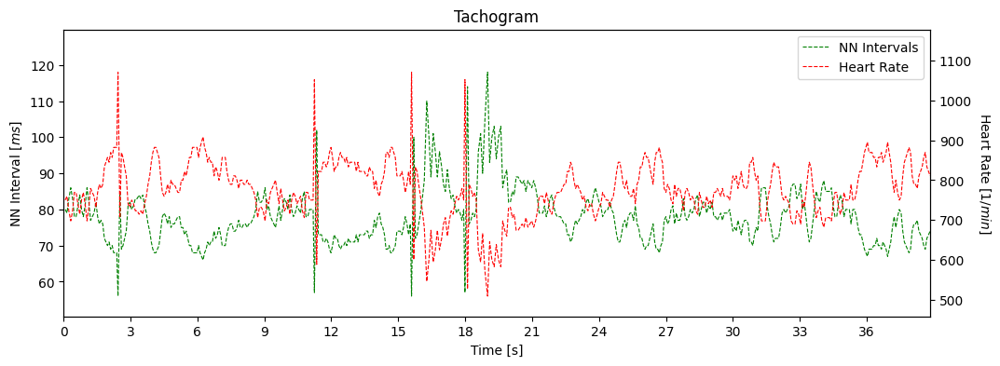

프로토콜: 2.0 HIT


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/tools.py:375: UserWarning: Interval limits out of boundaries. Interval set to: [0, 46.642]
  interval = pyhrv.utils.check_interval(interval, limits=[0, t[-1]], default=[0, 10])


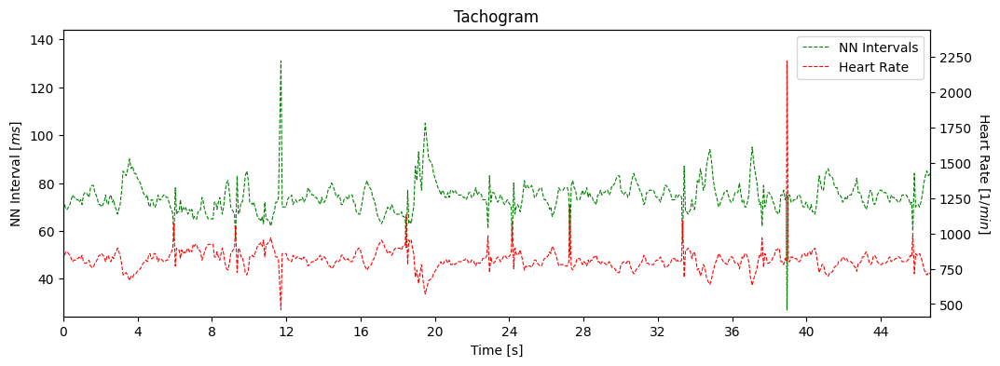

프로토콜: 3.0 MA


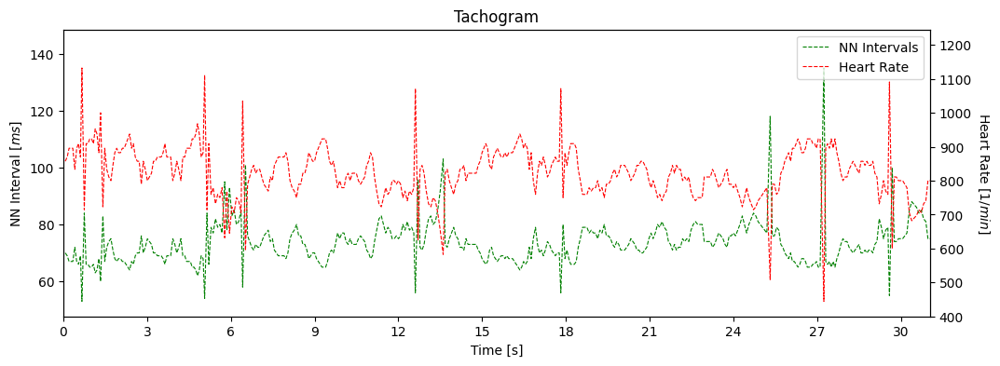

(M)012_20230507_093010_H10.csv
Value is nan
프로토콜: 1.0 BASELINE


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/tools.py:375: UserWarning: Interval limits out of boundaries. Interval set to: [0, 38.786]
  interval = pyhrv.utils.check_interval(interval, limits=[0, t[-1]], default=[0, 10])


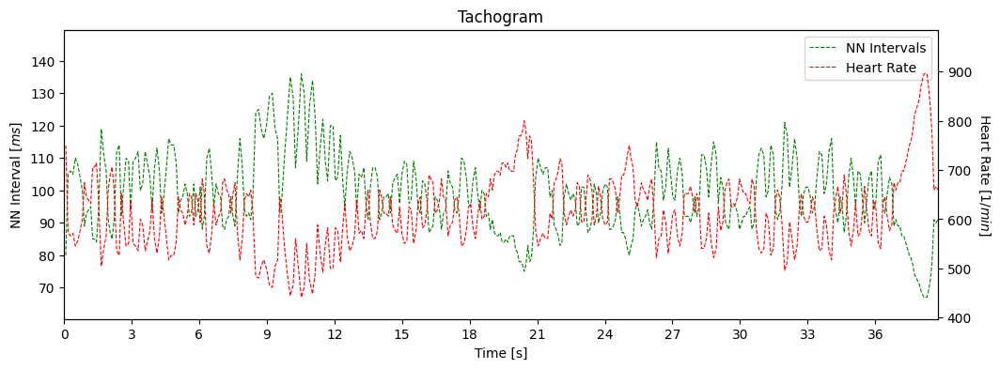

프로토콜: 2.0 HIT


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/tools.py:375: UserWarning: Interval limits out of boundaries. Interval set to: [0, 46.633]
  interval = pyhrv.utils.check_interval(interval, limits=[0, t[-1]], default=[0, 10])


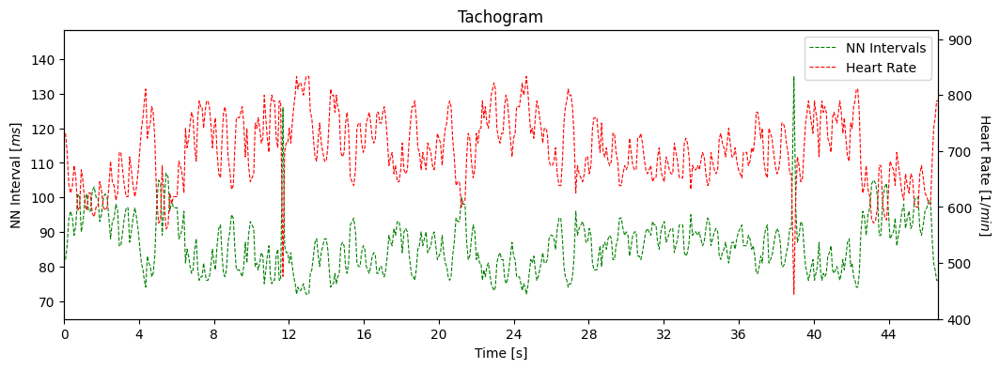

프로토콜: 3.0 MA


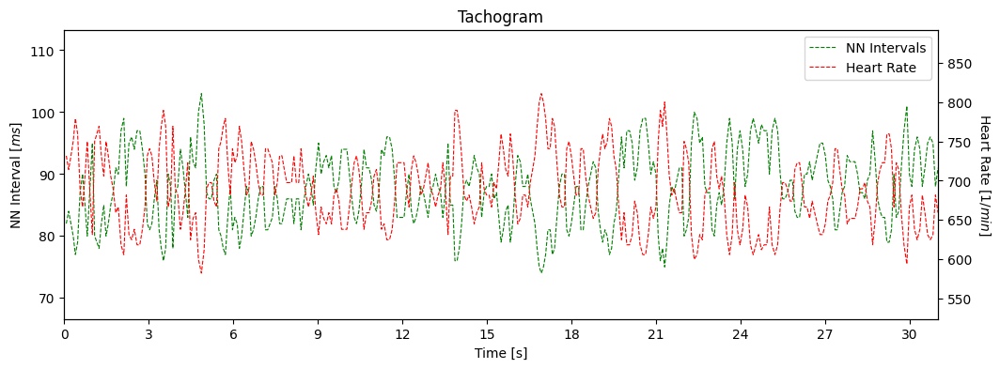

(M)013_20230507_113448_H10.csv
Value is nan
프로토콜: 1.0 BASELINE


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/tools.py:375: UserWarning: Interval limits out of boundaries. Interval set to: [0, 38.807]
  interval = pyhrv.utils.check_interval(interval, limits=[0, t[-1]], default=[0, 10])


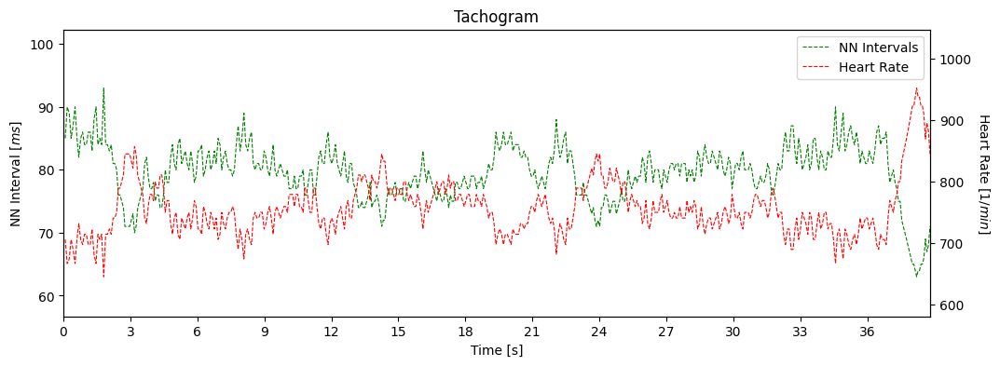

프로토콜: 2.0 HIT


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/tools.py:375: UserWarning: Interval limits out of boundaries. Interval set to: [0, 46.631]
  interval = pyhrv.utils.check_interval(interval, limits=[0, t[-1]], default=[0, 10])


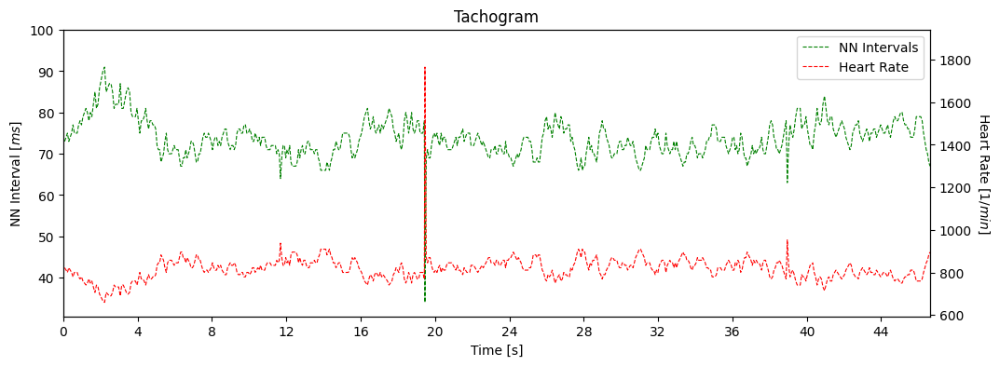

프로토콜: 3.0 MA


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/tools.py:375: UserWarning: Interval limits out of boundaries. Interval set to: [0, 31.017]
  interval = pyhrv.utils.check_interval(interval, limits=[0, t[-1]], default=[0, 10])


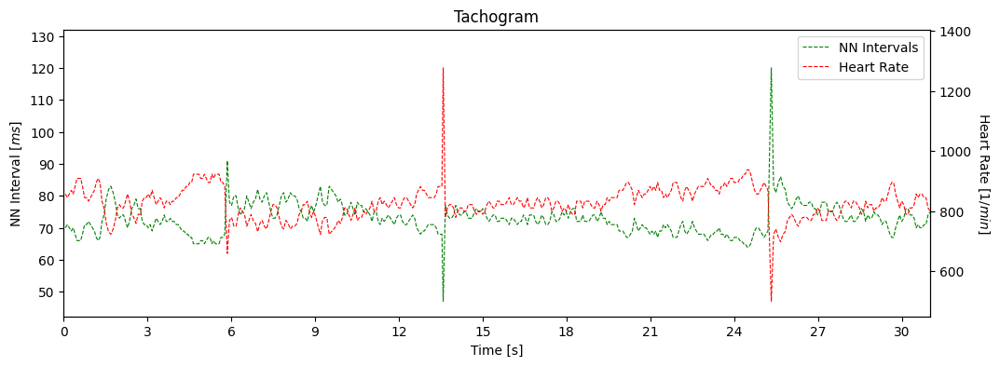

(M)014_20230507_095721_H10.csv
Value is nan
(M)016_20230507_085913_H10.csv
Value is nan
프로토콜: 1.0 BASELINE


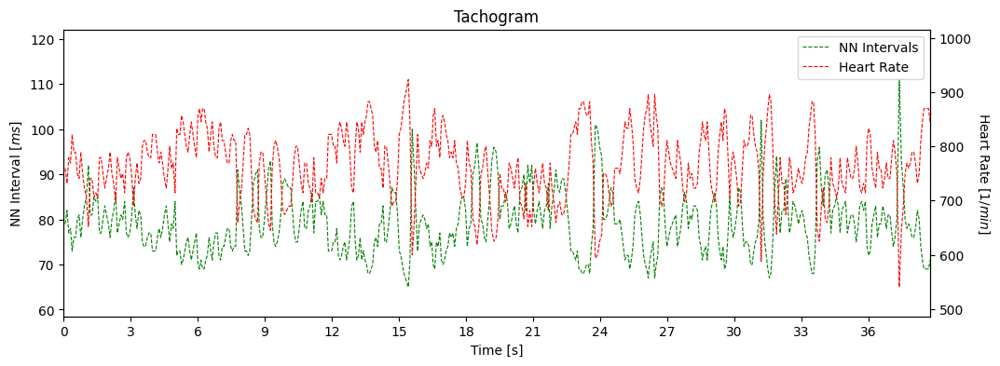

프로토콜: 2.0 HIT


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/tools.py:375: UserWarning: Interval limits out of boundaries. Interval set to: [0, 46.568]
  interval = pyhrv.utils.check_interval(interval, limits=[0, t[-1]], default=[0, 10])


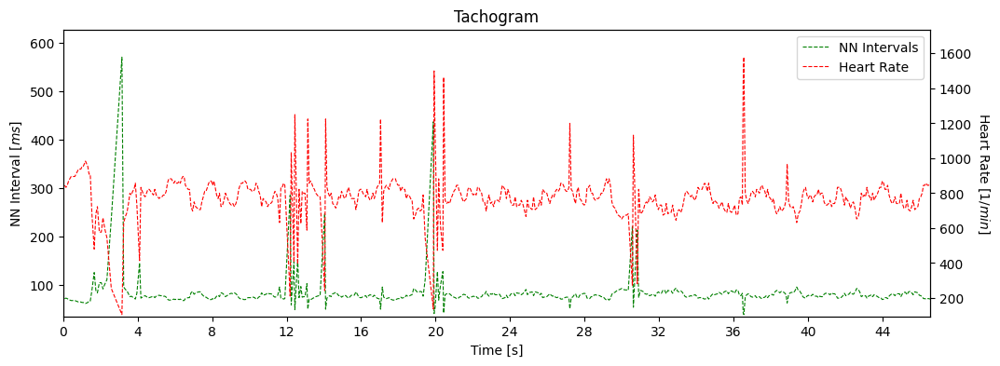

프로토콜: 3.0 MA


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/tools.py:375: UserWarning: Interval limits out of boundaries. Interval set to: [0, 31.037]
  interval = pyhrv.utils.check_interval(interval, limits=[0, t[-1]], default=[0, 10])


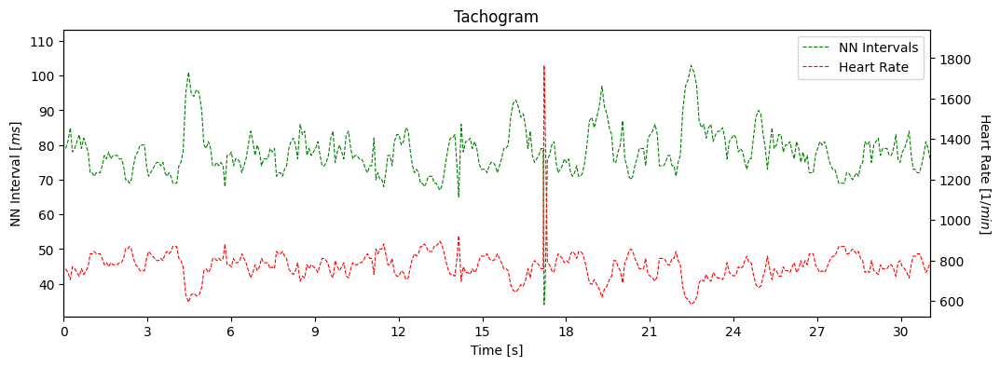

(M)017_20230507_110427_H10.csv
Value is nan
프로토콜: 1.0 BASELINE


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/tools.py:375: UserWarning: Interval limits out of boundaries. Interval set to: [0, 38.814]
  interval = pyhrv.utils.check_interval(interval, limits=[0, t[-1]], default=[0, 10])


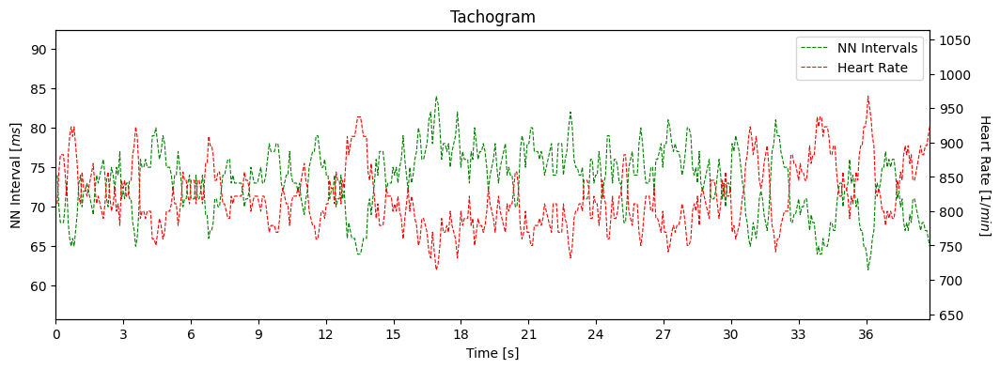

프로토콜: 2.0 HIT


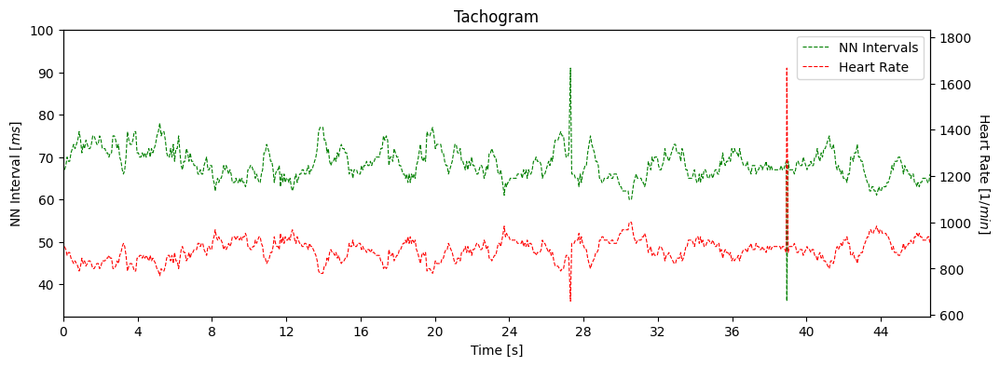

프로토콜: 3.0 MA


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/tools.py:375: UserWarning: Interval limits out of boundaries. Interval set to: [0, 31.075]
  interval = pyhrv.utils.check_interval(interval, limits=[0, t[-1]], default=[0, 10])


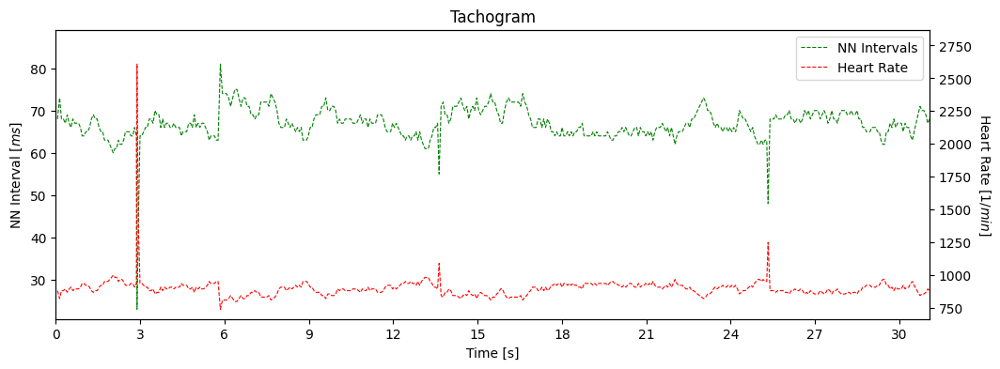

(M)018_20230507_100932_H10.csv
Value is nan
프로토콜: 1.0 BASELINE


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/tools.py:375: UserWarning: Interval limits out of boundaries. Interval set to: [0, 38.799]
  interval = pyhrv.utils.check_interval(interval, limits=[0, t[-1]], default=[0, 10])


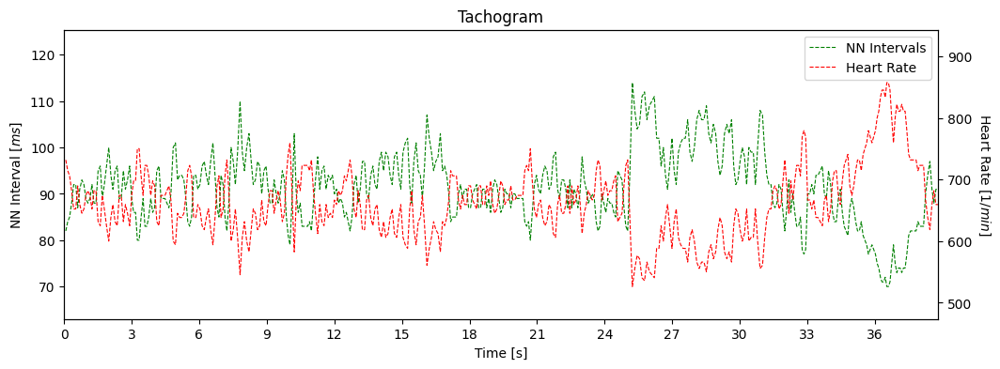

프로토콜: 2.0 HIT


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/tools.py:375: UserWarning: Interval limits out of boundaries. Interval set to: [0, 46.569]
  interval = pyhrv.utils.check_interval(interval, limits=[0, t[-1]], default=[0, 10])


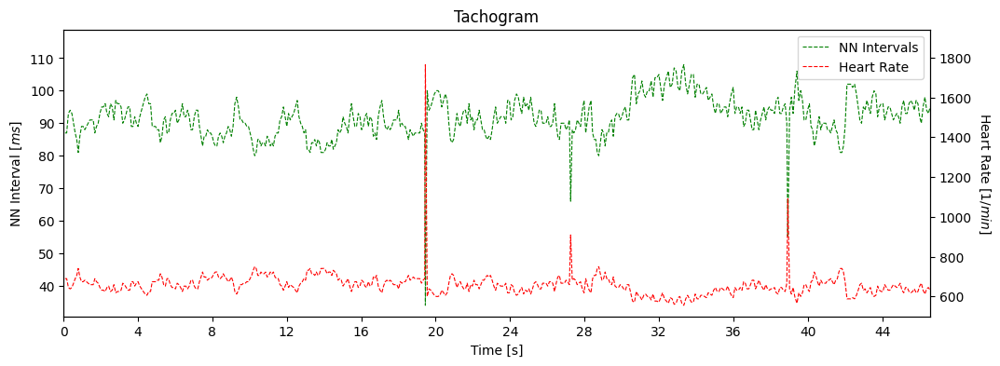

프로토콜: 3.0 MA


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/tools.py:375: UserWarning: Interval limits out of boundaries. Interval set to: [0, 31.009]
  interval = pyhrv.utils.check_interval(interval, limits=[0, t[-1]], default=[0, 10])


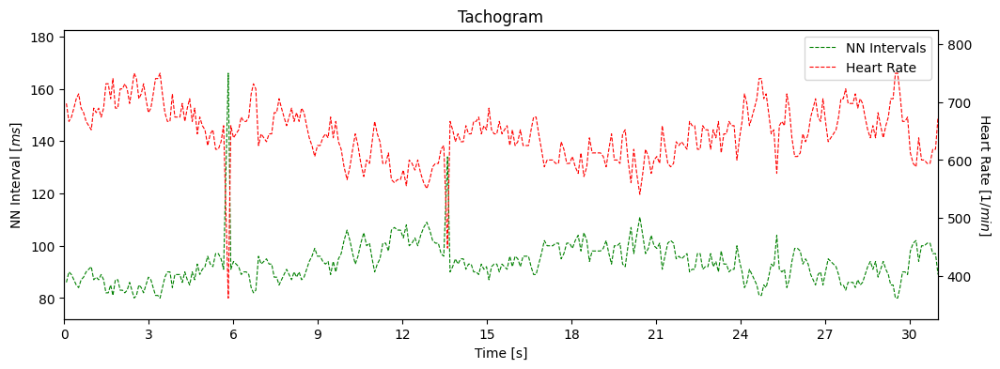

(M)019_20230507_101420_H10.csv
Value is nan
프로토콜: 1.0 BASELINE


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/tools.py:375: UserWarning: Interval limits out of boundaries. Interval set to: [0, 20.508]
  interval = pyhrv.utils.check_interval(interval, limits=[0, t[-1]], default=[0, 10])


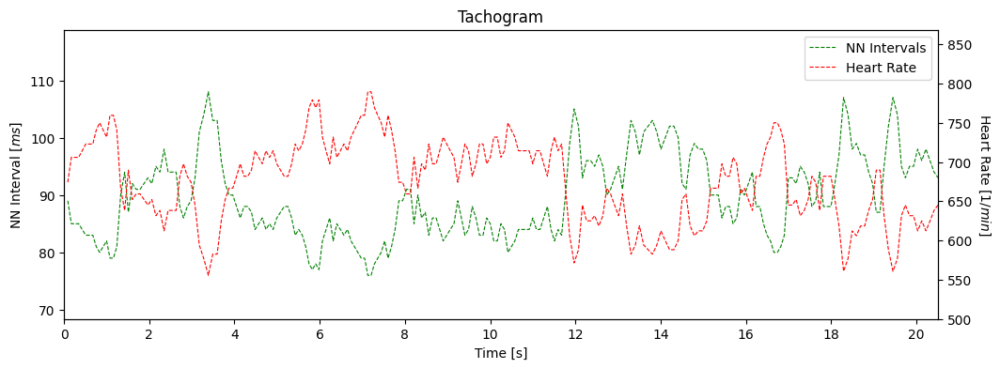

프로토콜: 2.0 HIT


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/tools.py:375: UserWarning: Interval limits out of boundaries. Interval set to: [0, 34.936]
  interval = pyhrv.utils.check_interval(interval, limits=[0, t[-1]], default=[0, 10])


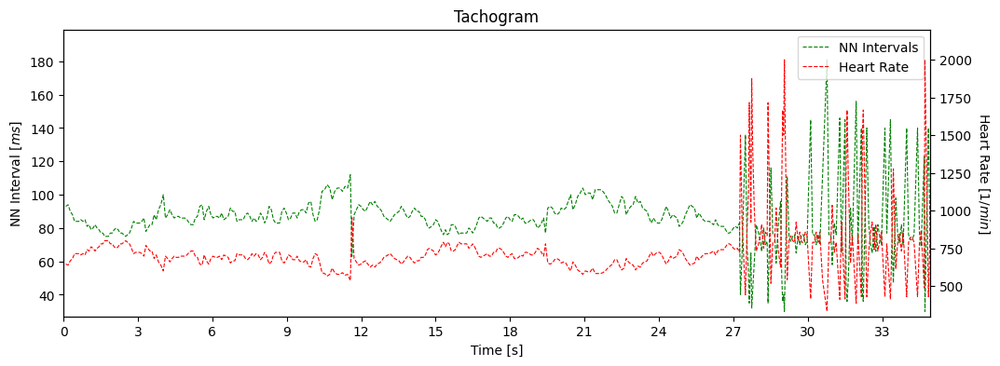

프로토콜: 3.0 MA


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/tools.py:375: UserWarning: Interval limits out of boundaries. Interval set to: [0, 25.189]
  interval = pyhrv.utils.check_interval(interval, limits=[0, t[-1]], default=[0, 10])


fail
(M)020_20230507_122941_H10.csv
Value is nan
프로토콜: 1.0 BASELINE


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/tools.py:375: UserWarning: Interval limits out of boundaries. Interval set to: [0, 38.782]
  interval = pyhrv.utils.check_interval(interval, limits=[0, t[-1]], default=[0, 10])


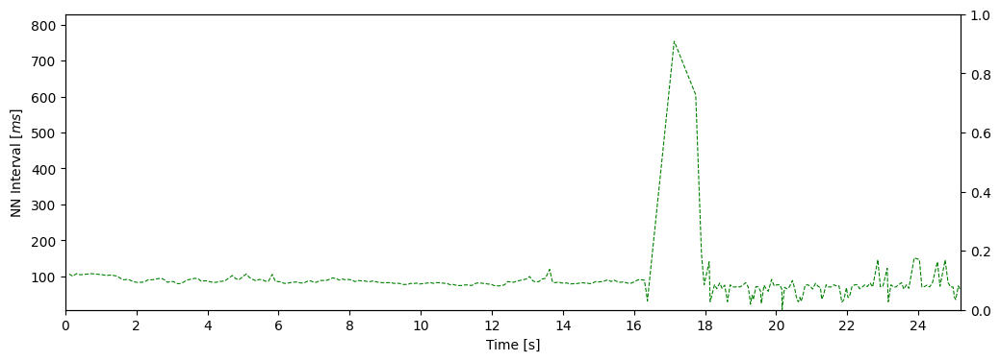

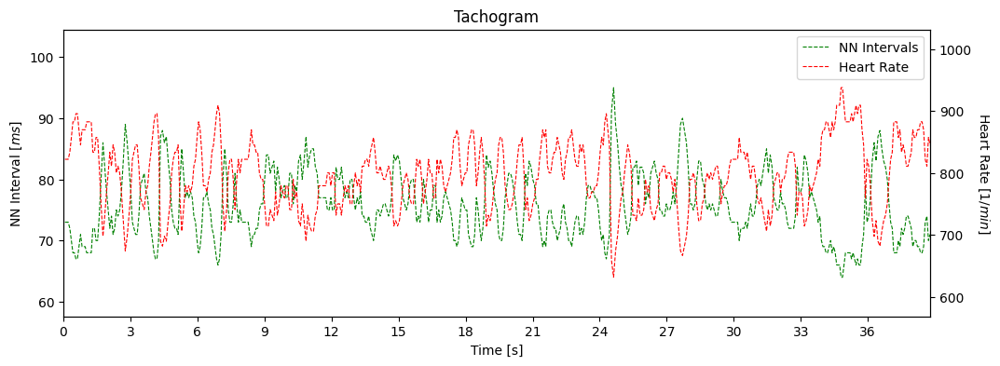

프로토콜: 2.0 HIT


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/tools.py:375: UserWarning: Interval limits out of boundaries. Interval set to: [0, 46.632]
  interval = pyhrv.utils.check_interval(interval, limits=[0, t[-1]], default=[0, 10])


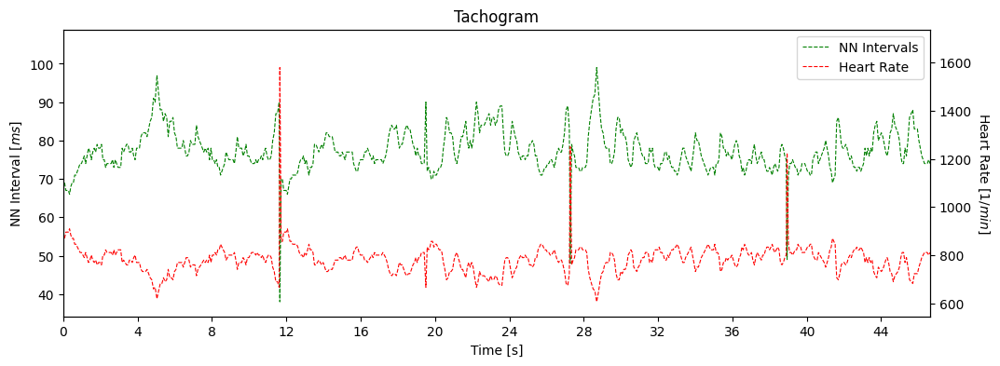

프로토콜: 3.0 MA


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/tools.py:375: UserWarning: Interval limits out of boundaries. Interval set to: [0, 31.066]
  interval = pyhrv.utils.check_interval(interval, limits=[0, t[-1]], default=[0, 10])


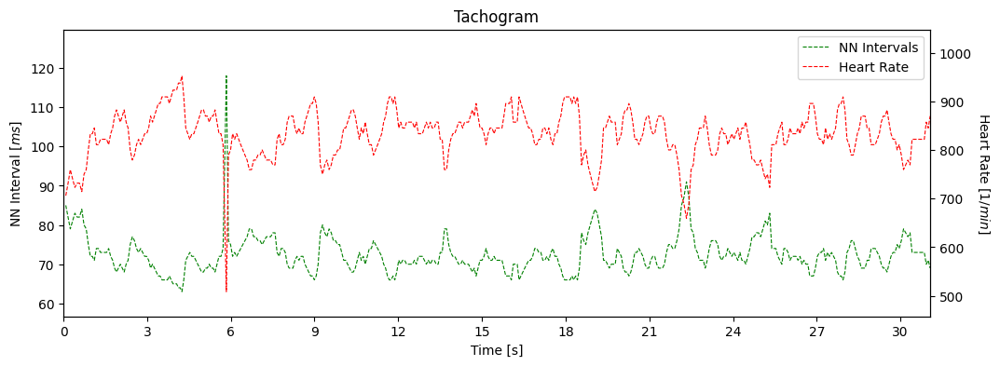

In [72]:
for i in mast_h10_dict:
    print(i)
    for p in mast_h10_dict[i]['proc'].unique():
        if np.isnan(p):
            print('Value is nan')
            continue
        else:
            print('프로토콜:', p, MAST_PROTOCOL_NAME[p])
            signal = mast_h10_dict[i][mast_h10_dict[i]['proc'] == p]['sensor']
            try:
                signal, rpeaks = biosppy.signals.ecg.ecg(signal= signal, sampling_rate = 130, show=False)[1:3]
                nni = tools.nn_intervals(rpeaks)
                try:
                    tools.tachogram(signal = signal, 
                                nni = nni, 
                                rpeaks = rpeaks, 
                                sampling_rate = 130,
                                interval=[0, 1500]
                               )
                except:
                    print('fail')
            except:
                print(' VALUE ERROR')
                print('-'*30)
                pass


(M)001_20230507_093641_H10.csv
Value is nan
(M)001_20230507_094057_H10.csv
Value is nan
프로토콜: 1.0 BASELINE


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/utils.py:367: UserWarning: Signal duration is to short for segmentation into 300000s. Input data will be returned.
  warnings.warn("Signal duration is to short for segmentation into %is. Input data will be returned." % duration)
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:303: UserWarning: Signal duration too short for SDANN computation.
  warnings.warn("Signal duration too short for SDANN computation.")
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:576: UserWarning: CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a malfunction of the function. This function will be reviewed over the next updates to solve this issue
  warnings.warn('CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a '


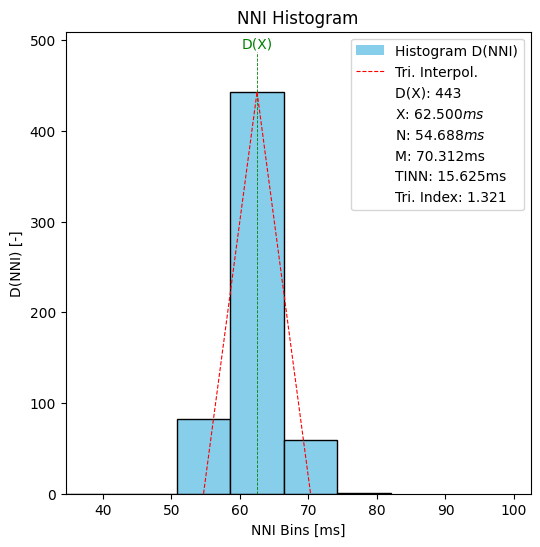

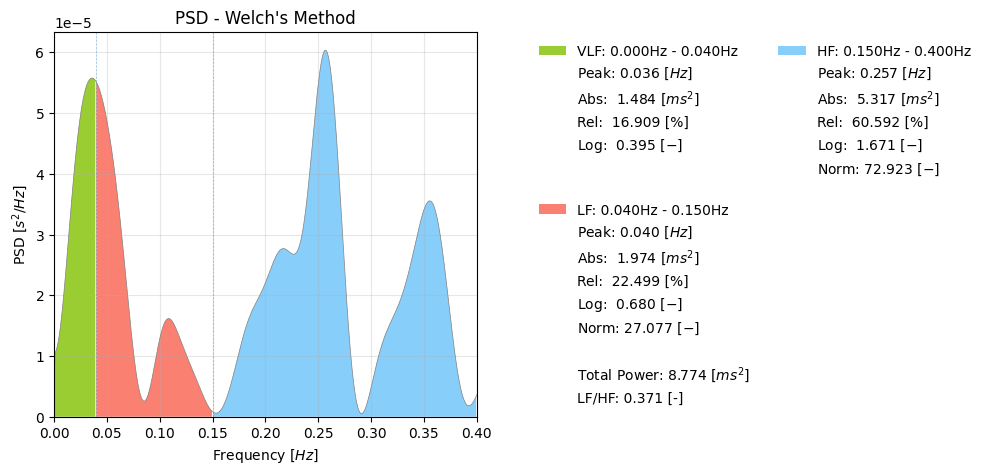

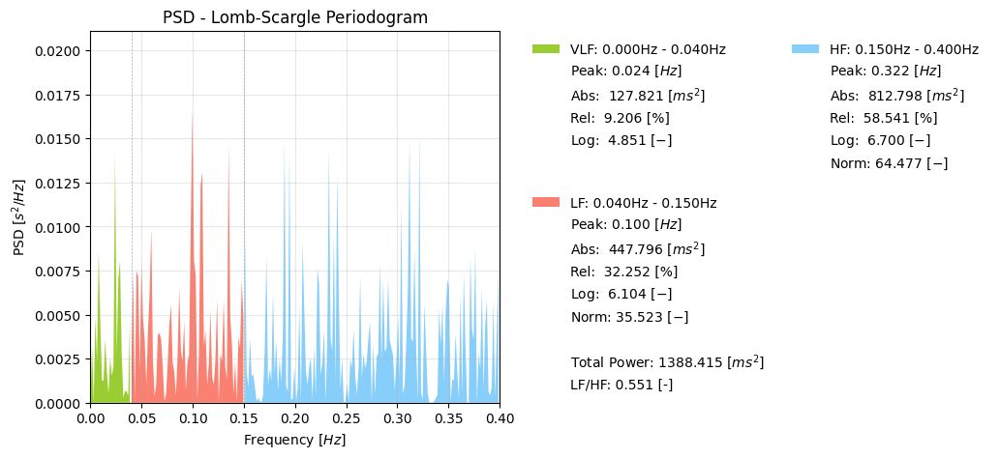

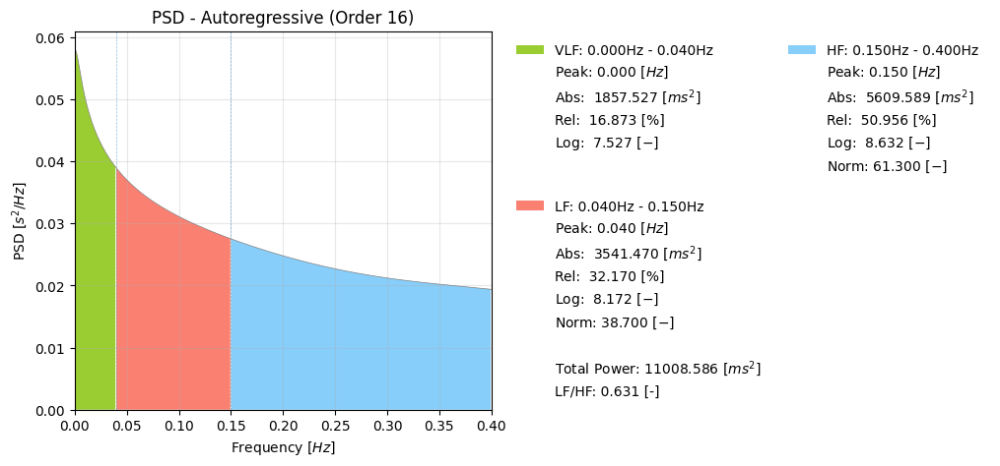

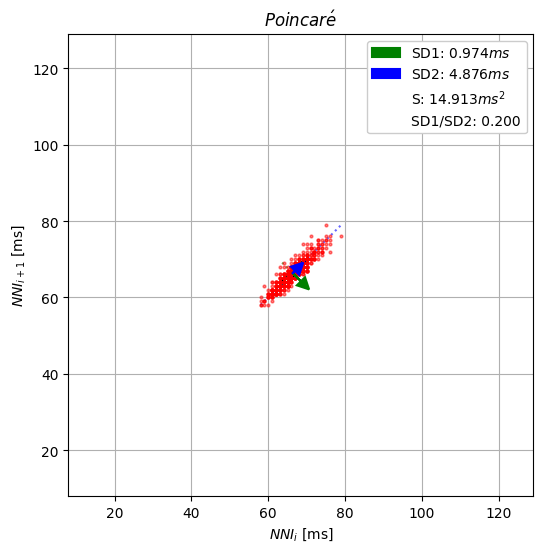

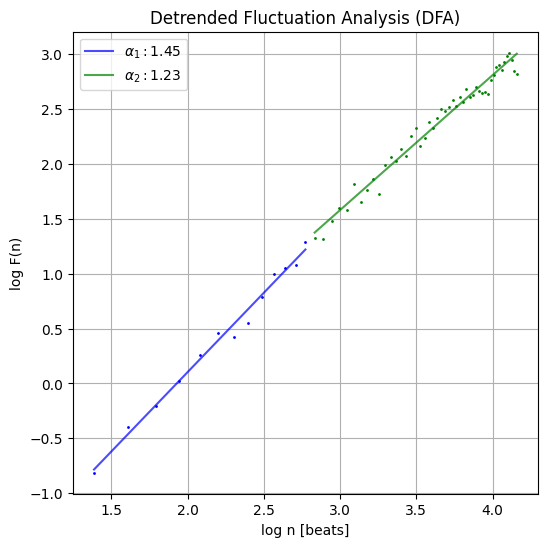

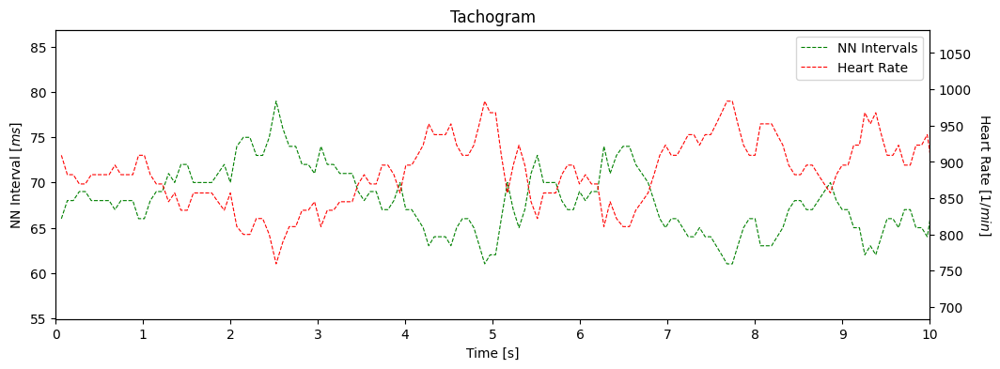

프로토콜: 2.0 HIT


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/utils.py:367: UserWarning: Signal duration is to short for segmentation into 300000s. Input data will be returned.
  warnings.warn("Signal duration is to short for segmentation into %is. Input data will be returned." % duration)
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:303: UserWarning: Signal duration too short for SDANN computation.
  warnings.warn("Signal duration too short for SDANN computation.")
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:576: UserWarning: CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a malfunction of the function. This function will be reviewed over the next updates to solve this issue
  warnings.warn('CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a '


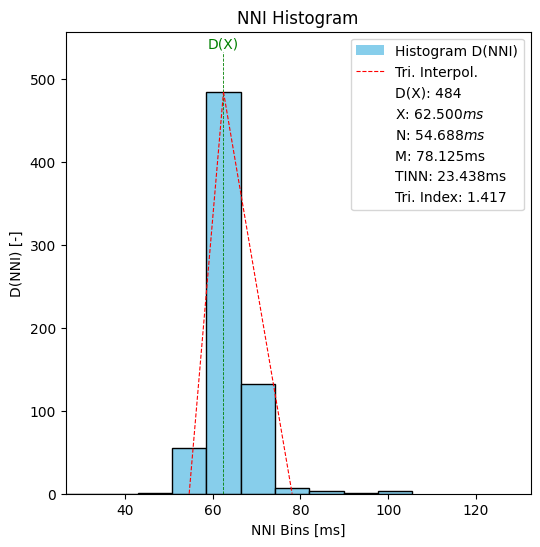

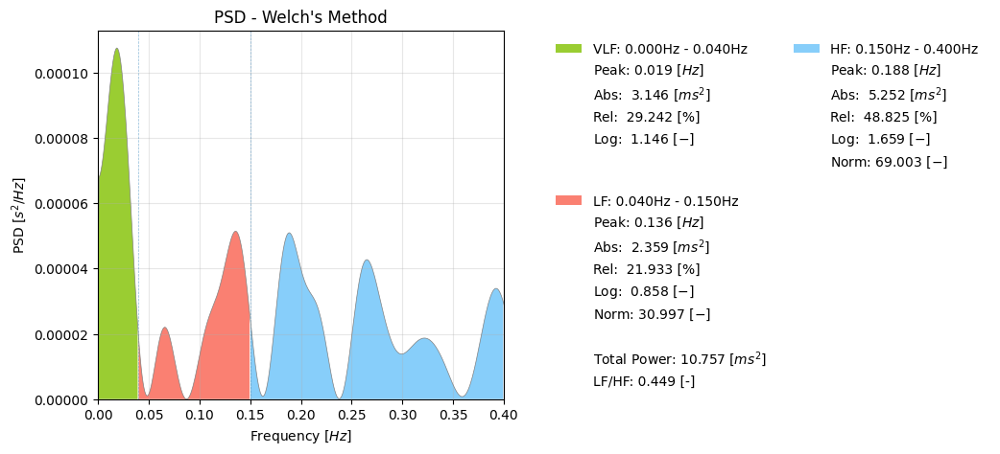

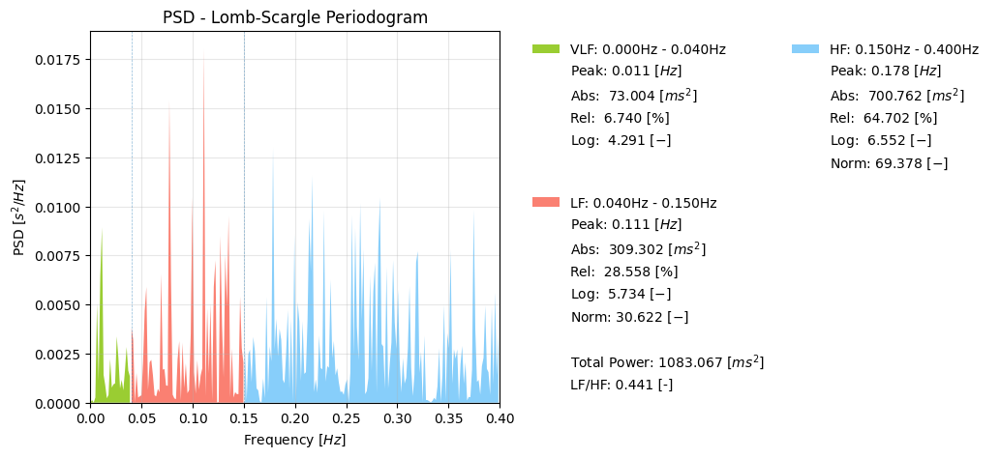

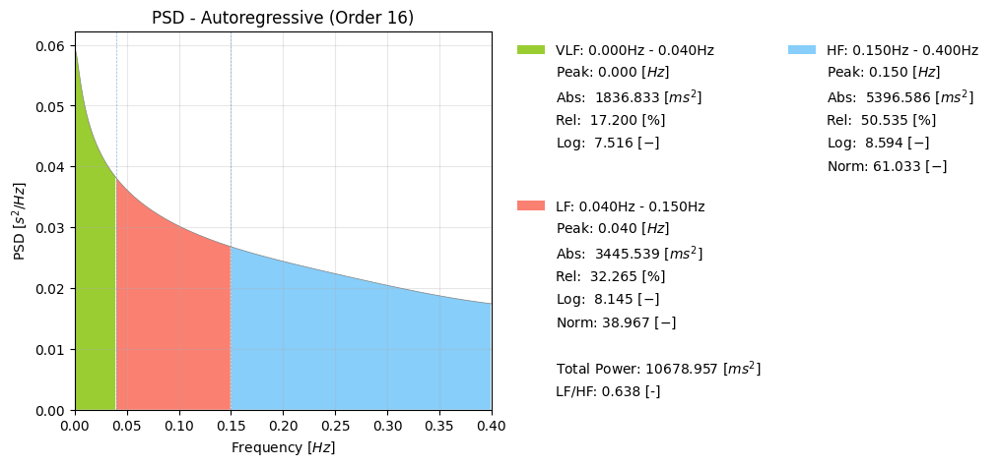

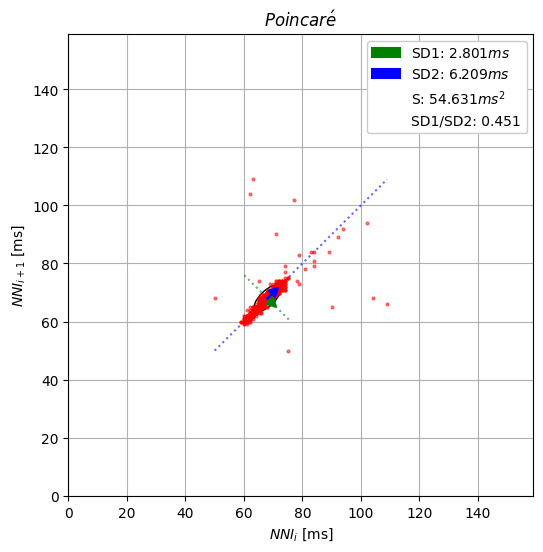

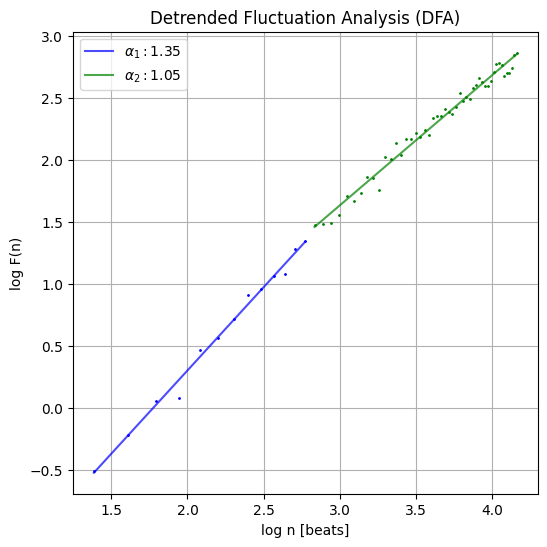

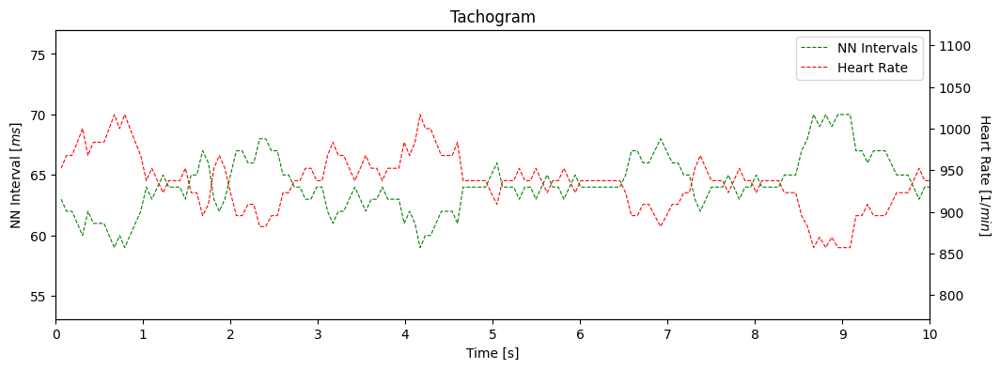

프로토콜: 3.0 MA


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/utils.py:367: UserWarning: Signal duration is to short for segmentation into 300000s. Input data will be returned.
  warnings.warn("Signal duration is to short for segmentation into %is. Input data will be returned." % duration)
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:303: UserWarning: Signal duration too short for SDANN computation.
  warnings.warn("Signal duration too short for SDANN computation.")
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:576: UserWarning: CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a malfunction of the function. This function will be reviewed over the next updates to solve this issue
  warnings.warn('CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a '


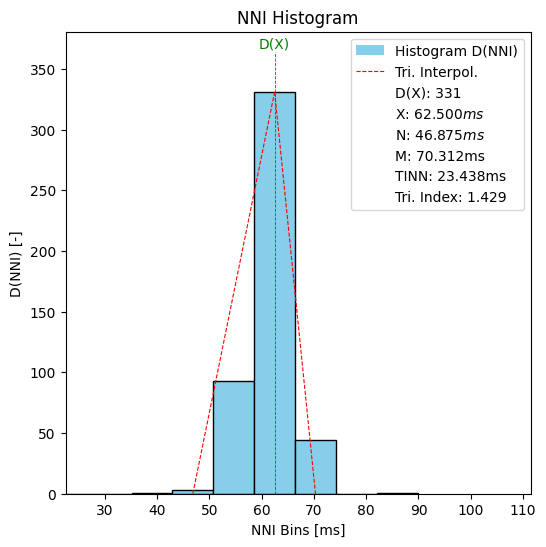

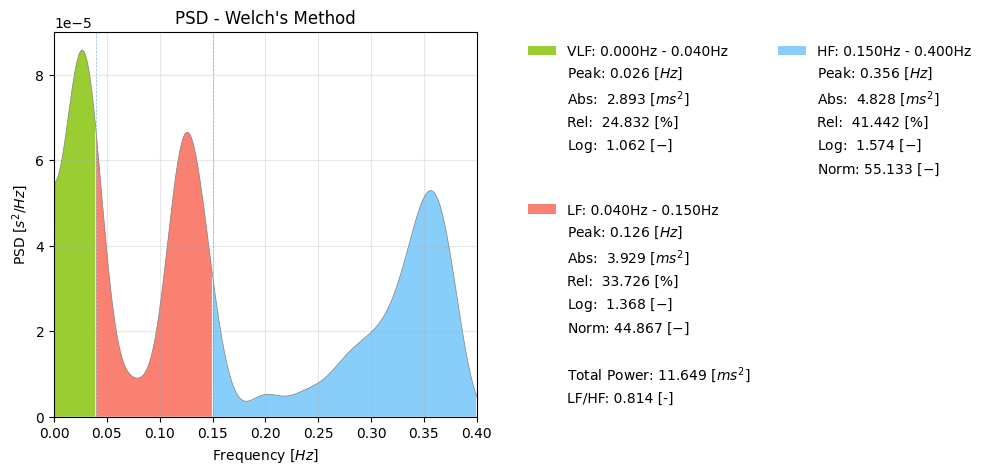

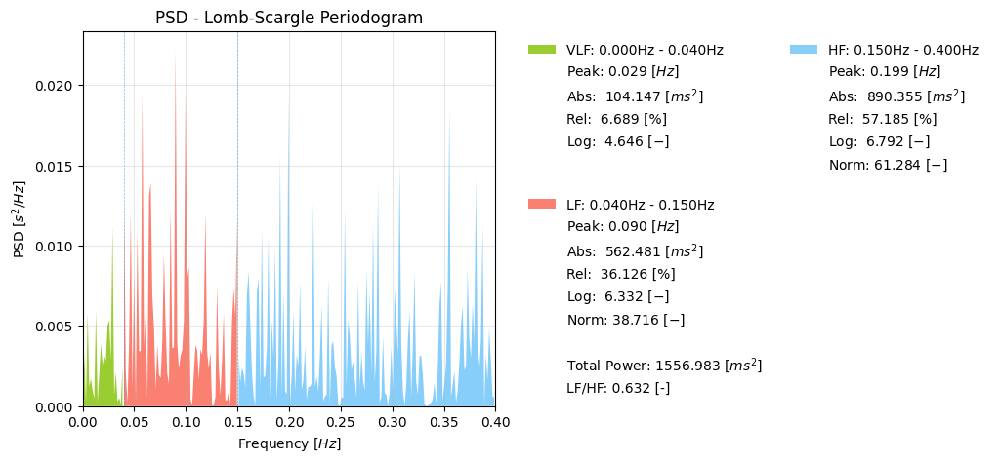

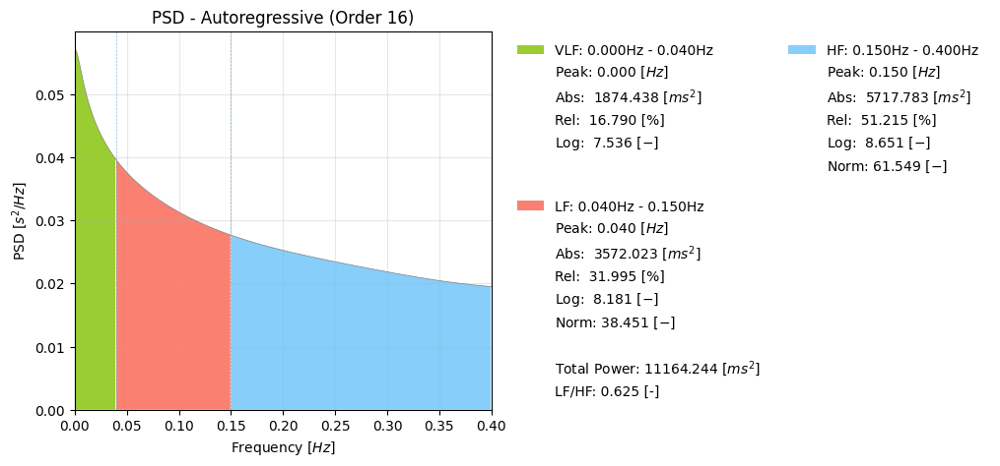

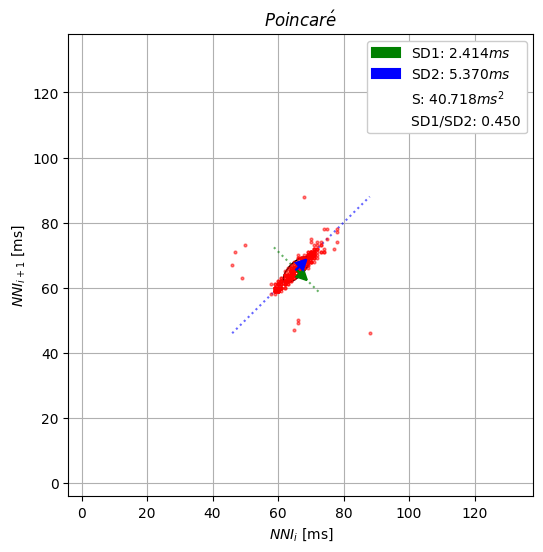

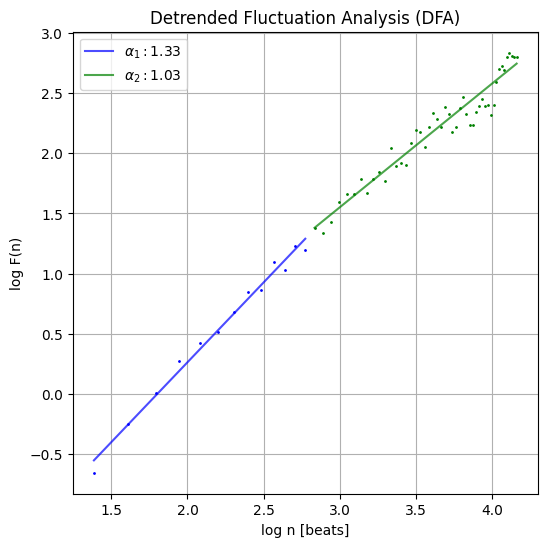

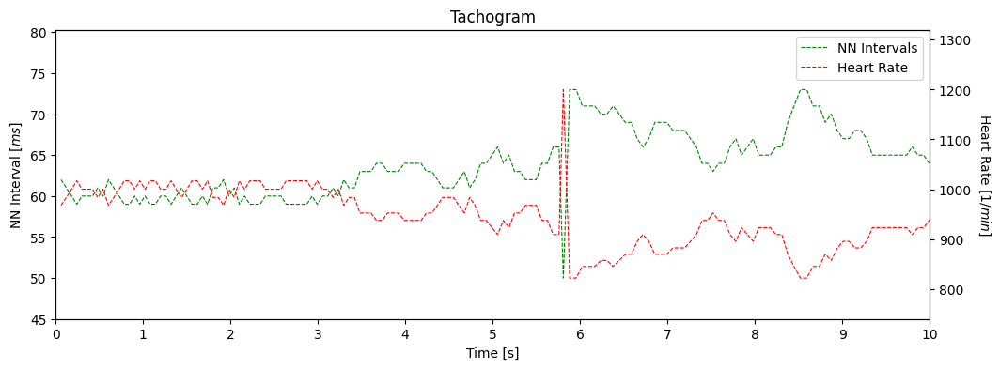

(M)002_20230507_103326_H10.csv
Value is nan
프로토콜: 1.0 BASELINE


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/utils.py:367: UserWarning: Signal duration is to short for segmentation into 300000s. Input data will be returned.
  warnings.warn("Signal duration is to short for segmentation into %is. Input data will be returned." % duration)
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:303: UserWarning: Signal duration too short for SDANN computation.
  warnings.warn("Signal duration too short for SDANN computation.")
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:576: UserWarning: CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a malfunction of the function. This function will be reviewed over the next updates to solve this issue
  warnings.warn('CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a '


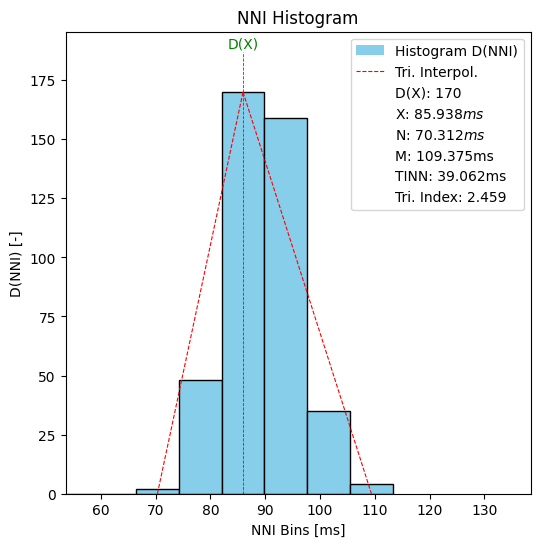

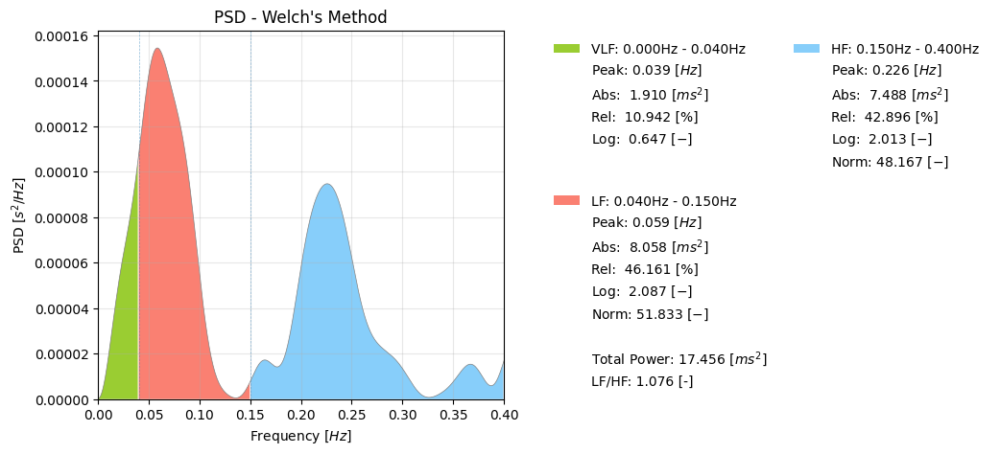

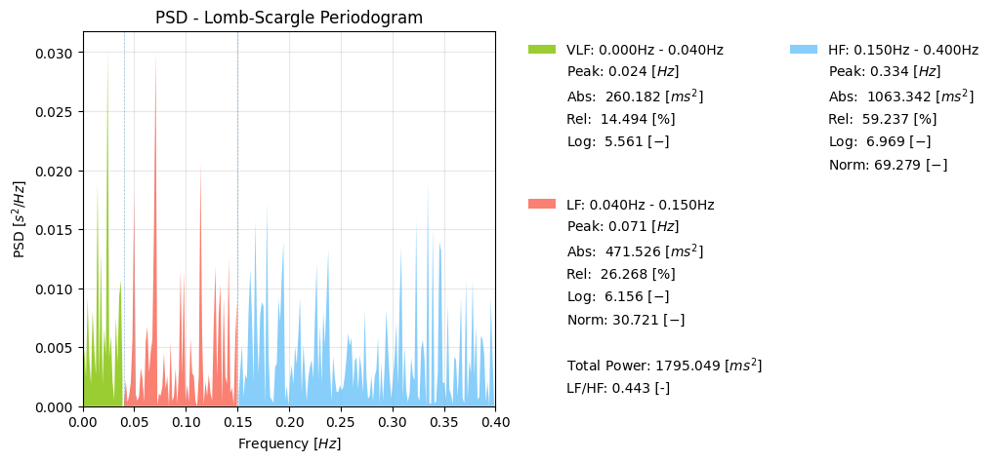

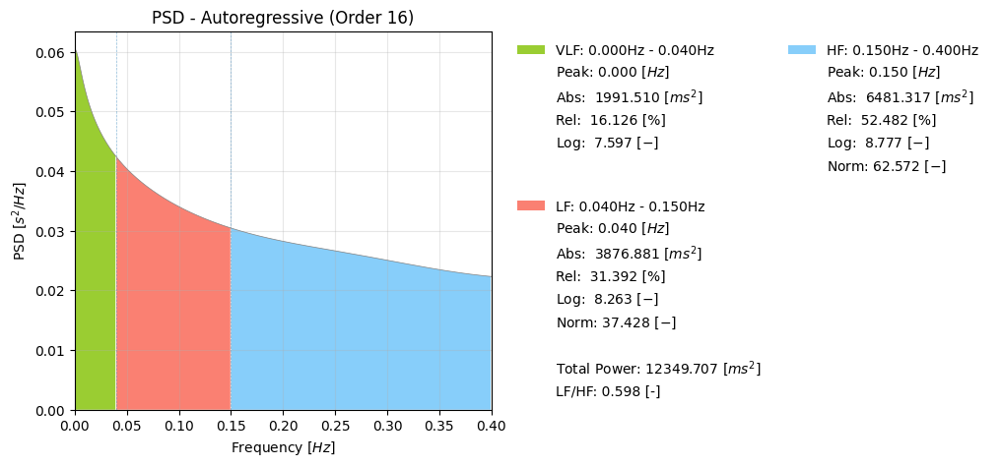

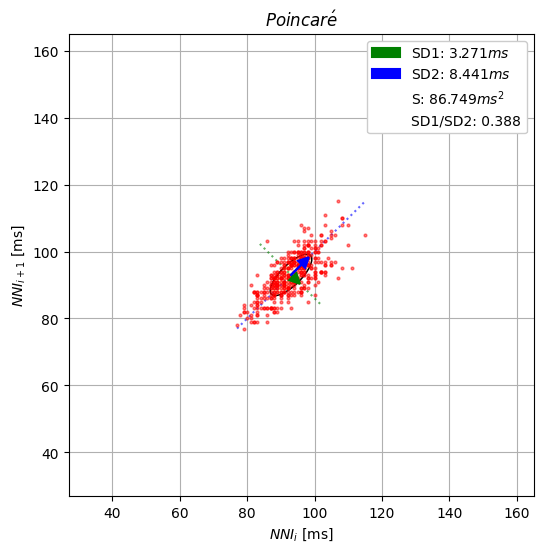

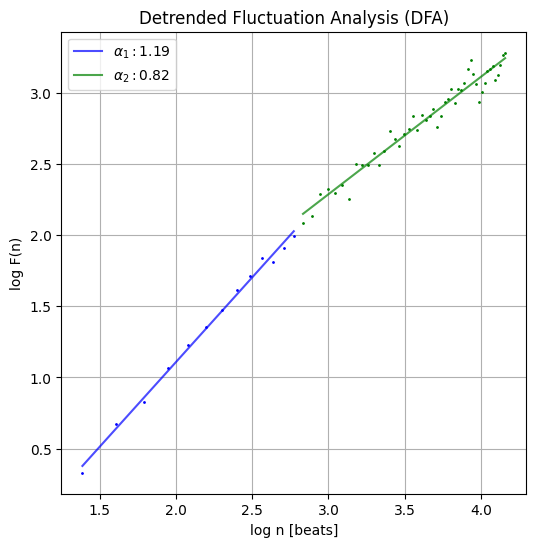

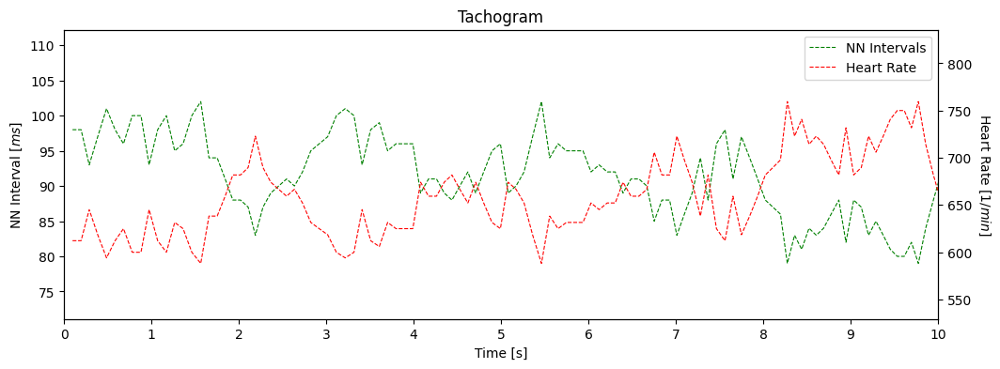

프로토콜: 2.0 HIT


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/utils.py:367: UserWarning: Signal duration is to short for segmentation into 300000s. Input data will be returned.
  warnings.warn("Signal duration is to short for segmentation into %is. Input data will be returned." % duration)
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:303: UserWarning: Signal duration too short for SDANN computation.
  warnings.warn("Signal duration too short for SDANN computation.")
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:576: UserWarning: CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a malfunction of the function. This function will be reviewed over the next updates to solve this issue
  warnings.warn('CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a '


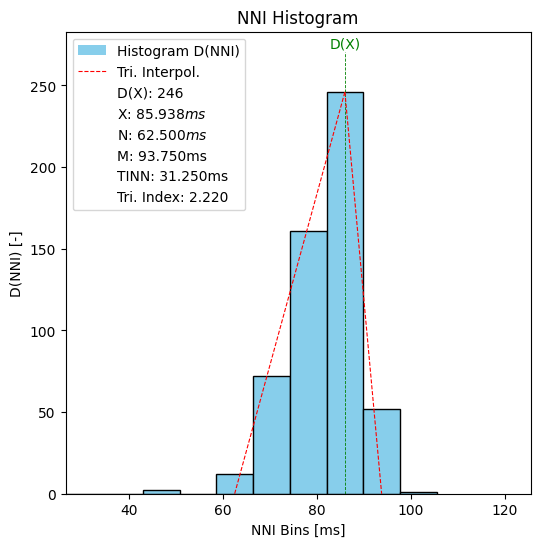

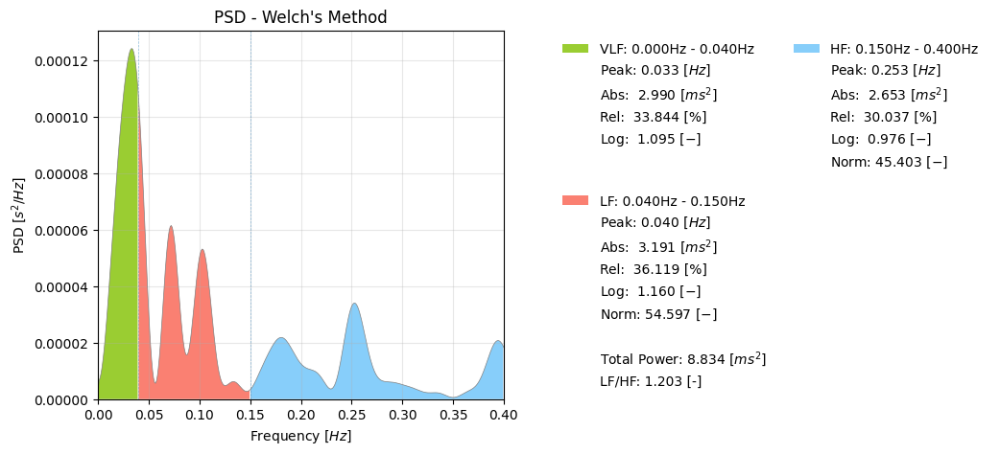

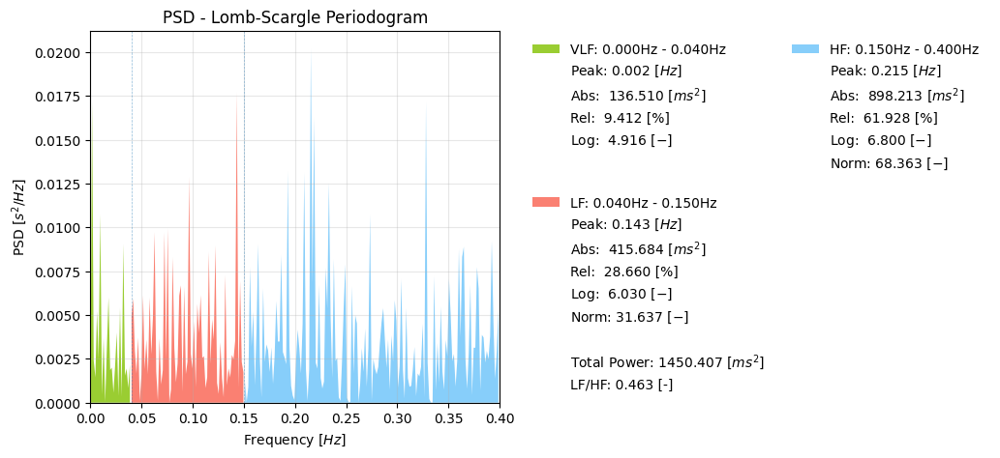

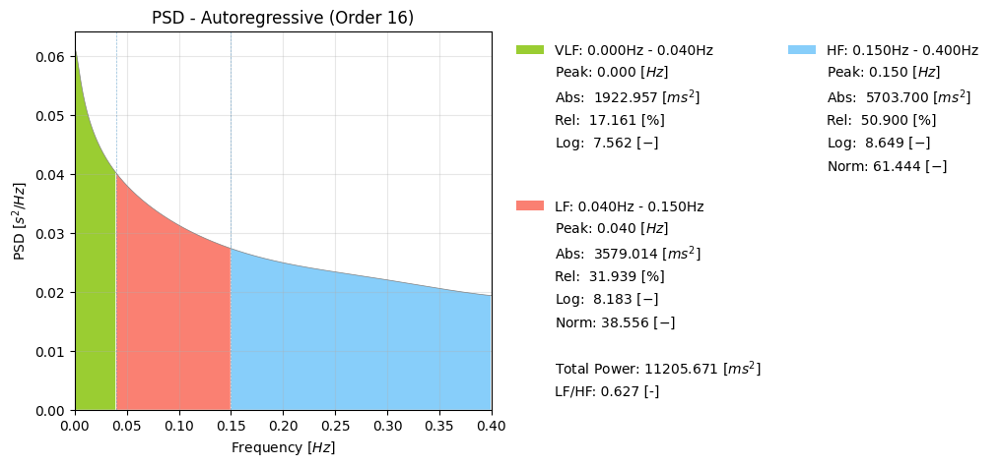

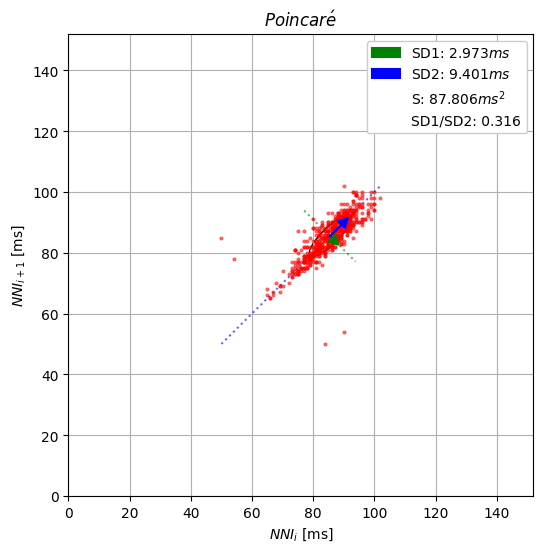

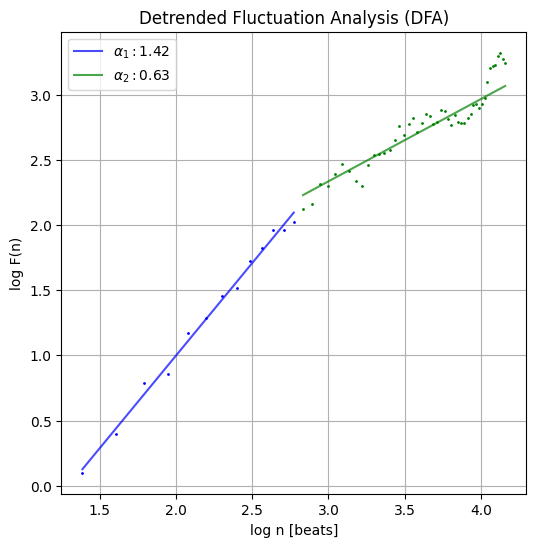

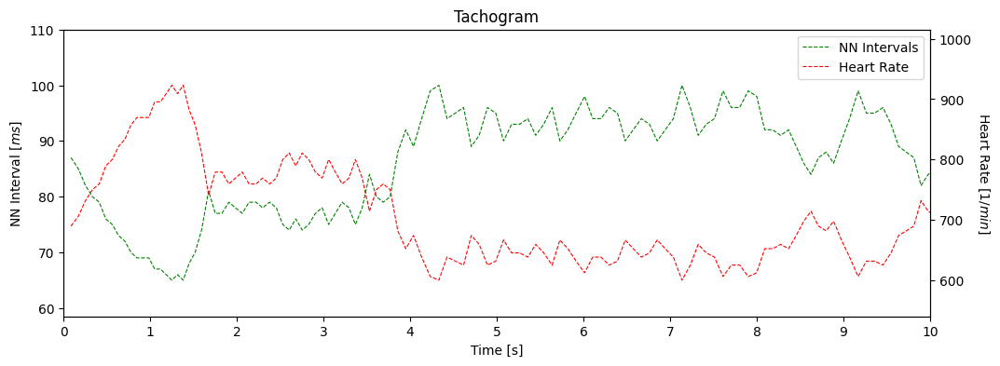

프로토콜: 3.0 MA


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/utils.py:367: UserWarning: Signal duration is to short for segmentation into 300000s. Input data will be returned.
  warnings.warn("Signal duration is to short for segmentation into %is. Input data will be returned." % duration)
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:303: UserWarning: Signal duration too short for SDANN computation.
  warnings.warn("Signal duration too short for SDANN computation.")
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:576: UserWarning: CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a malfunction of the function. This function will be reviewed over the next updates to solve this issue
  warnings.warn('CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a '


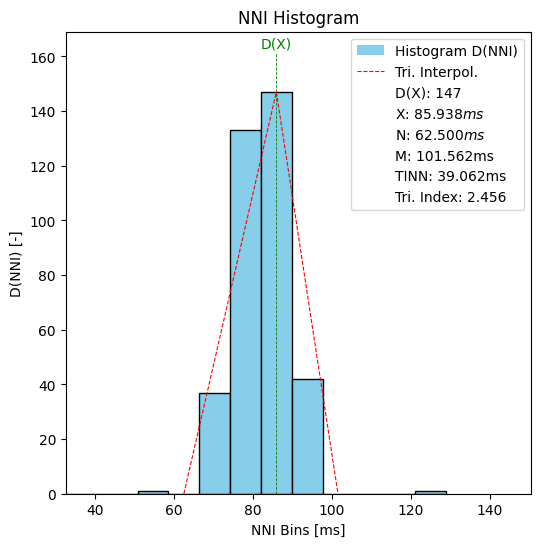

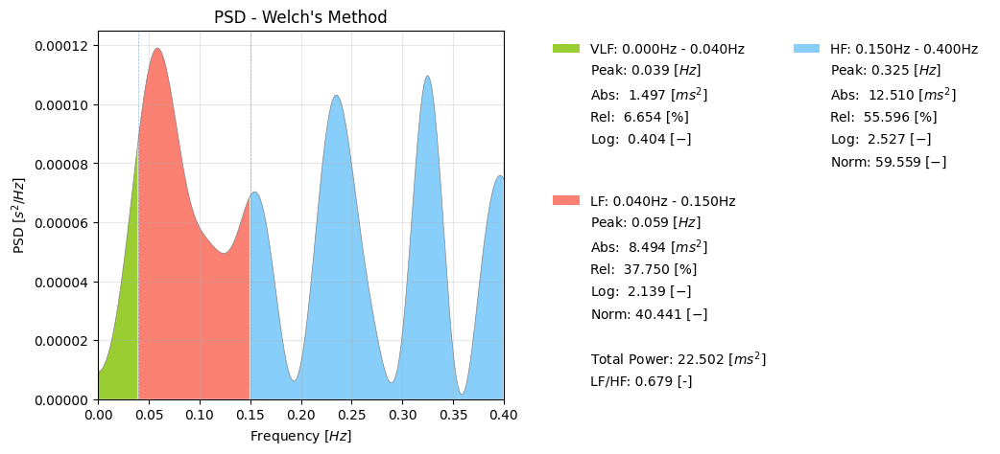

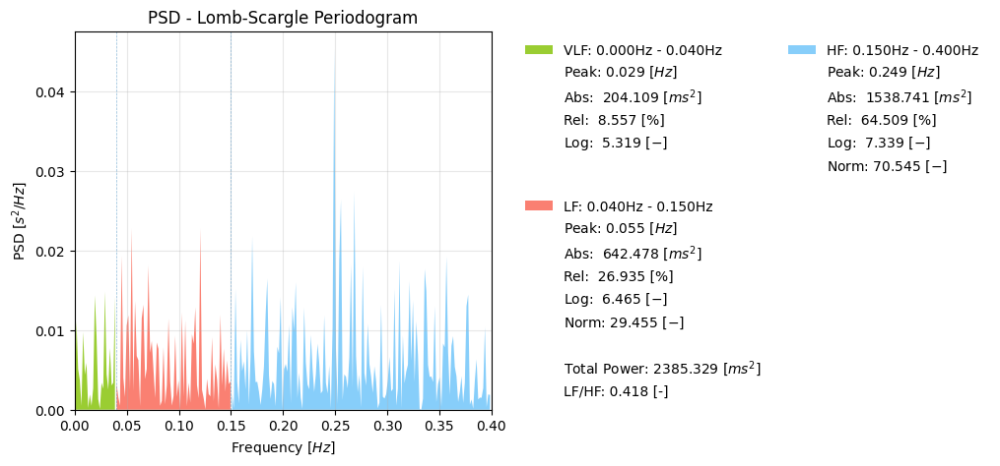

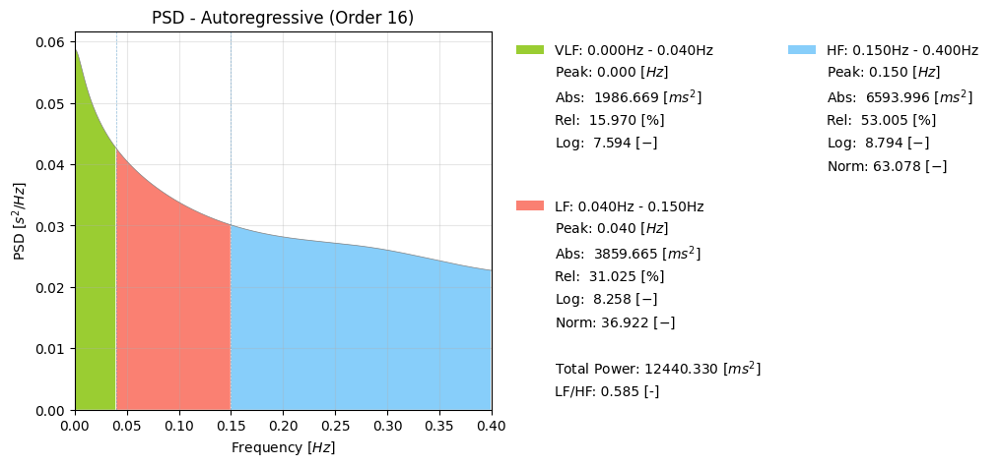

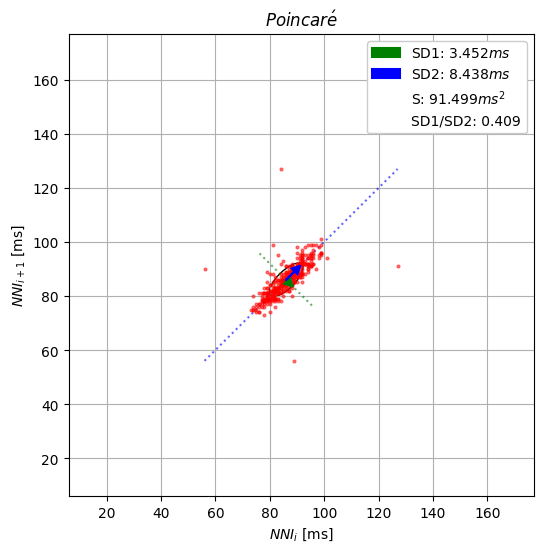

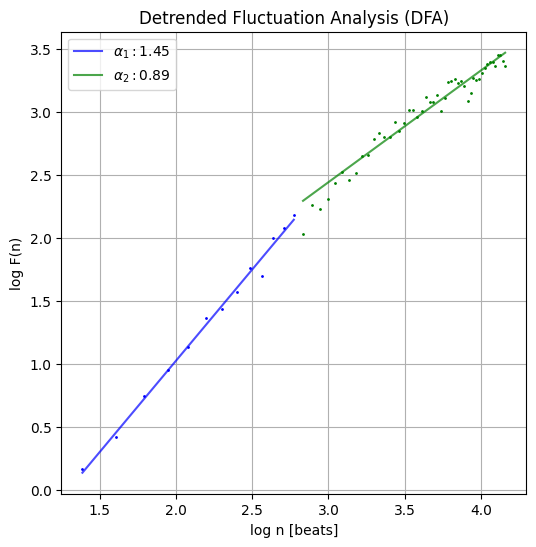

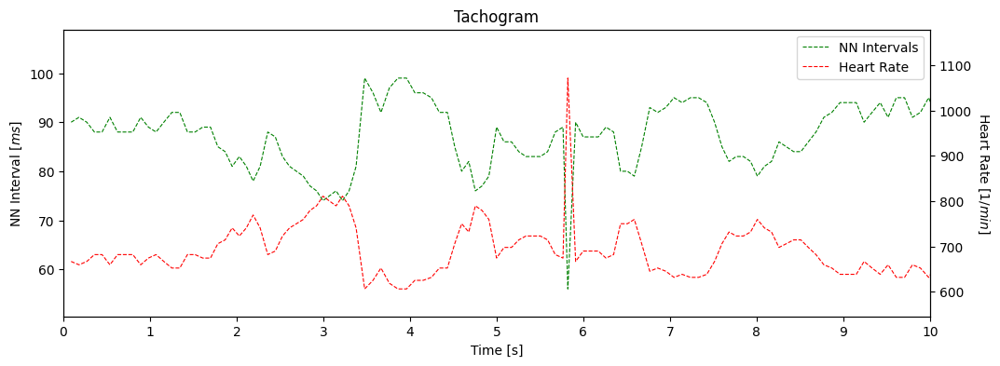

(M)003_20230507_090129_H10.csv
Value is nan
프로토콜: 1.0 BASELINE


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/utils.py:367: UserWarning: Signal duration is to short for segmentation into 300000s. Input data will be returned.
  warnings.warn("Signal duration is to short for segmentation into %is. Input data will be returned." % duration)
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:303: UserWarning: Signal duration too short for SDANN computation.
  warnings.warn("Signal duration too short for SDANN computation.")
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:576: UserWarning: CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a malfunction of the function. This function will be reviewed over the next updates to solve this issue
  warnings.warn('CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a '


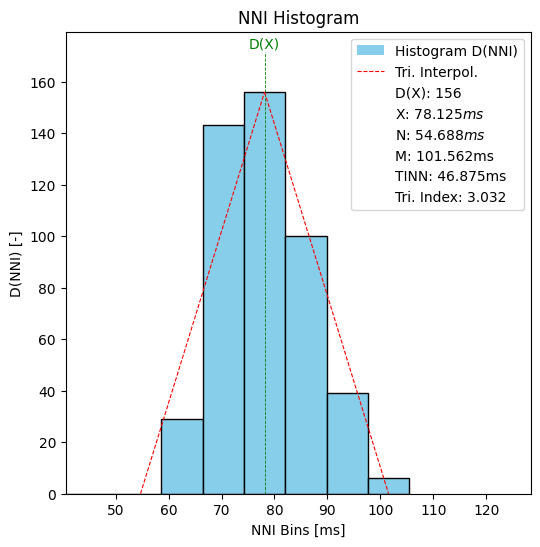

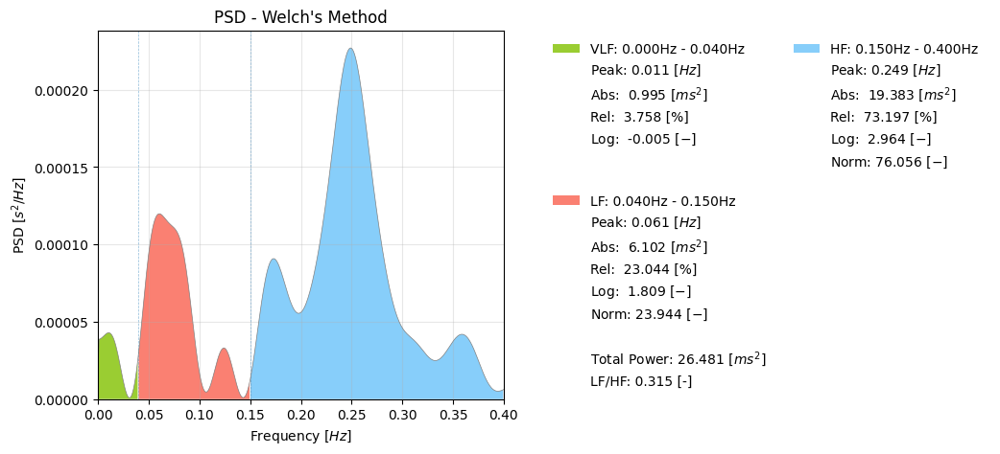

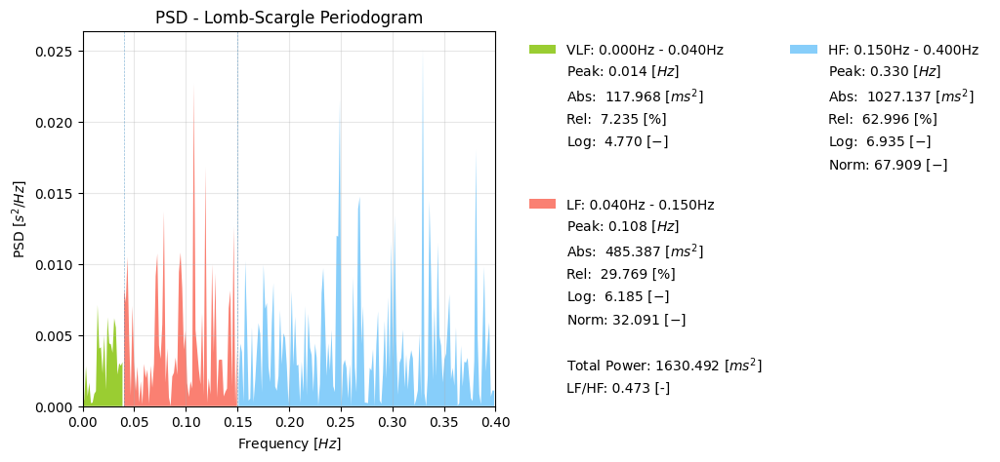

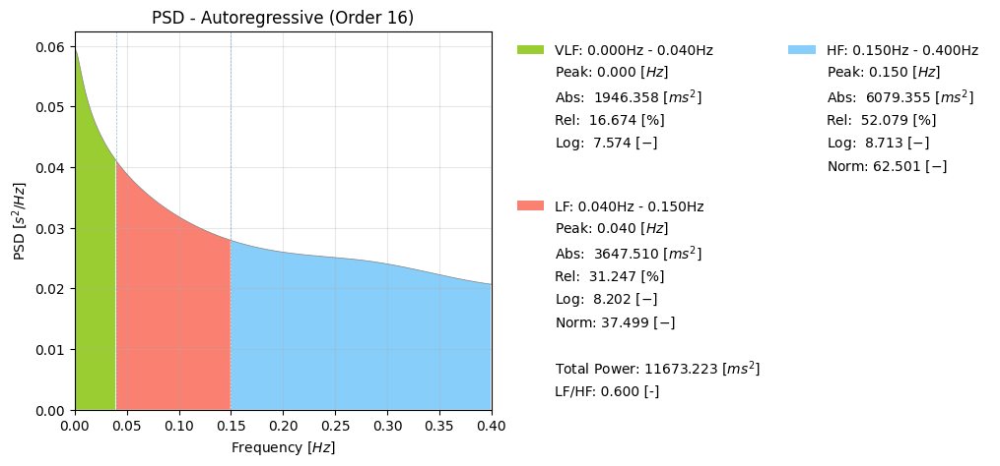

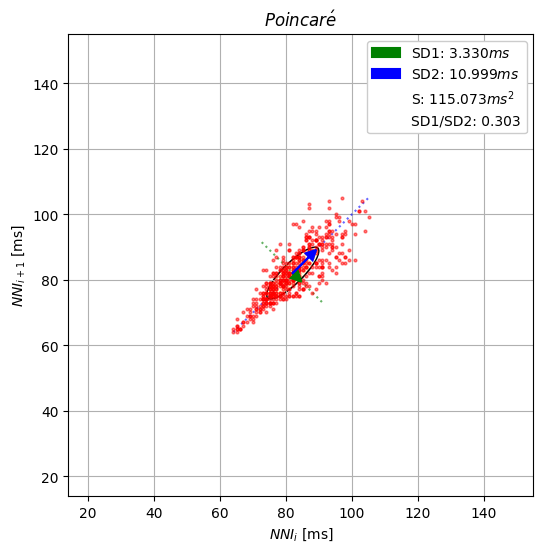

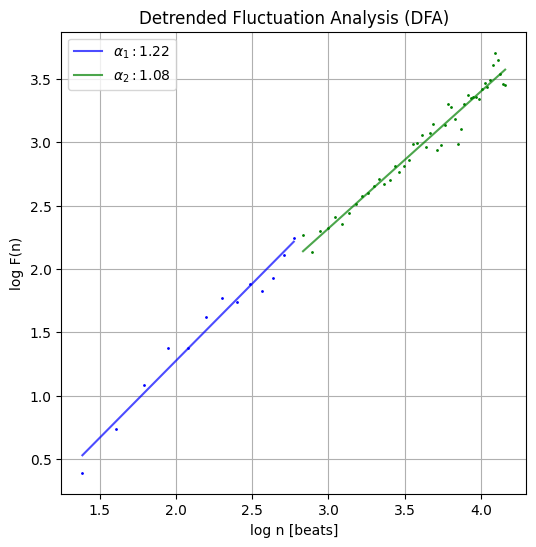

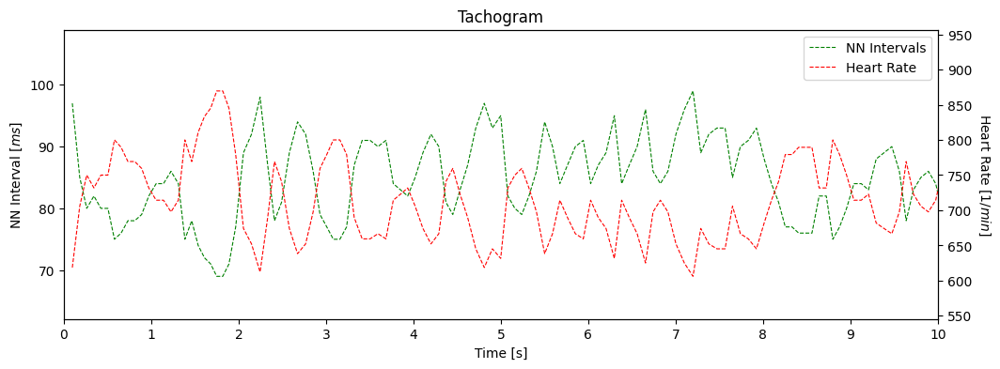

프로토콜: 2.0 HIT


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/utils.py:367: UserWarning: Signal duration is to short for segmentation into 300000s. Input data will be returned.
  warnings.warn("Signal duration is to short for segmentation into %is. Input data will be returned." % duration)
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:303: UserWarning: Signal duration too short for SDANN computation.
  warnings.warn("Signal duration too short for SDANN computation.")
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:576: UserWarning: CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a malfunction of the function. This function will be reviewed over the next updates to solve this issue
  warnings.warn('CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a '


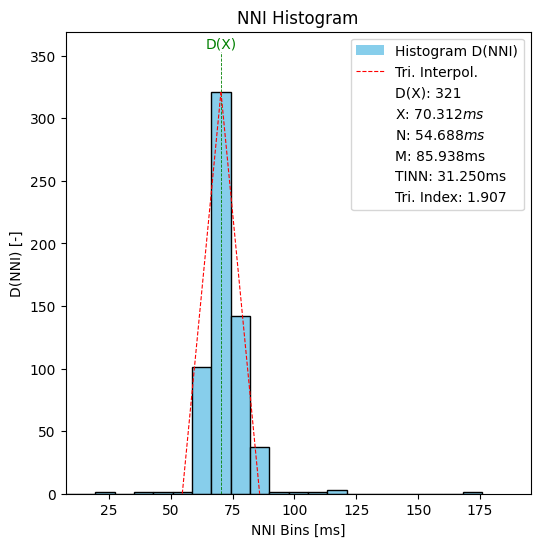

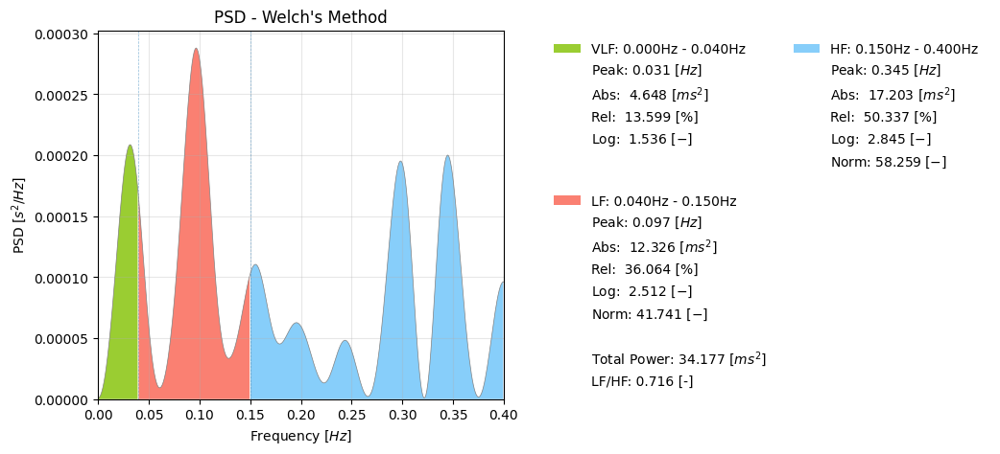

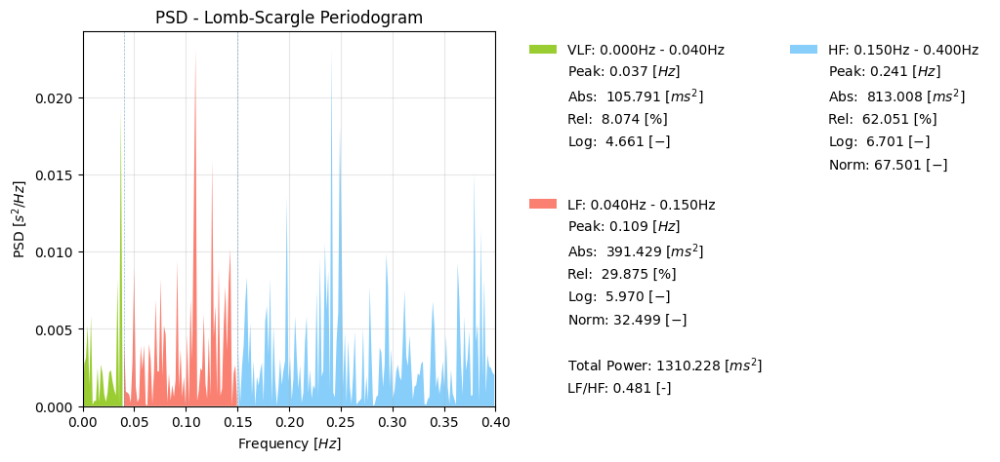

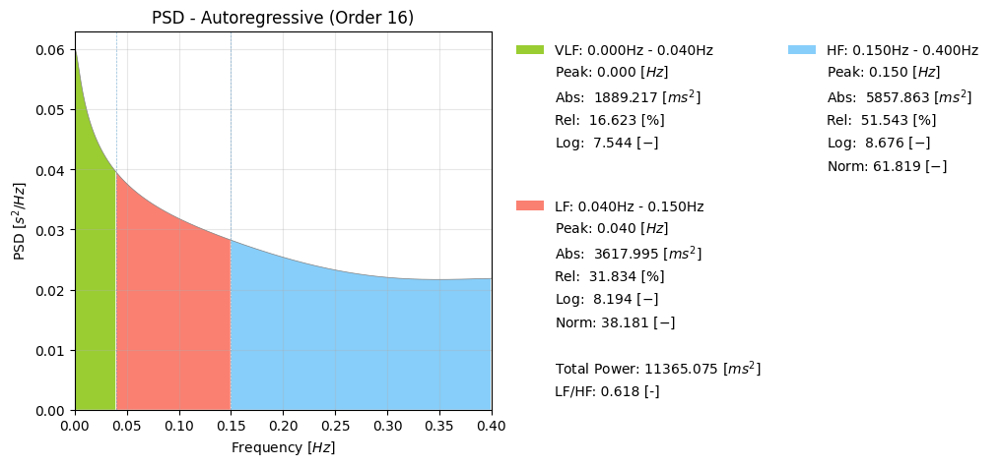

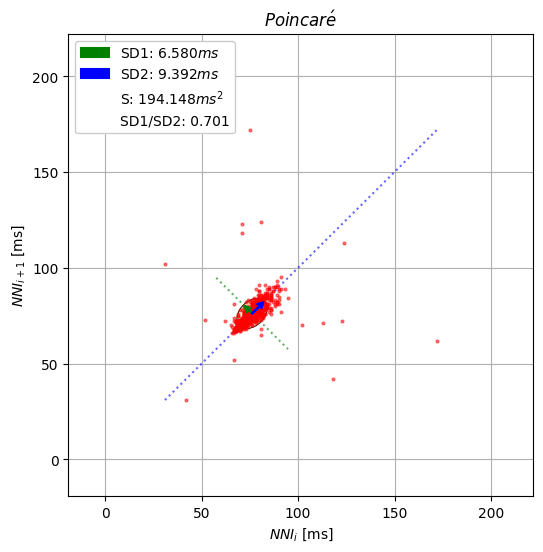

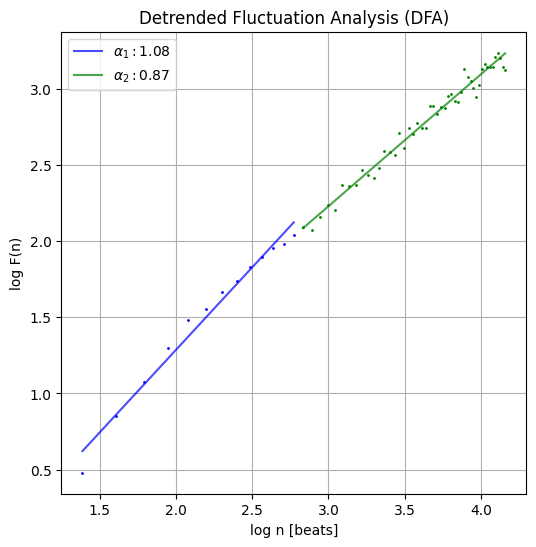

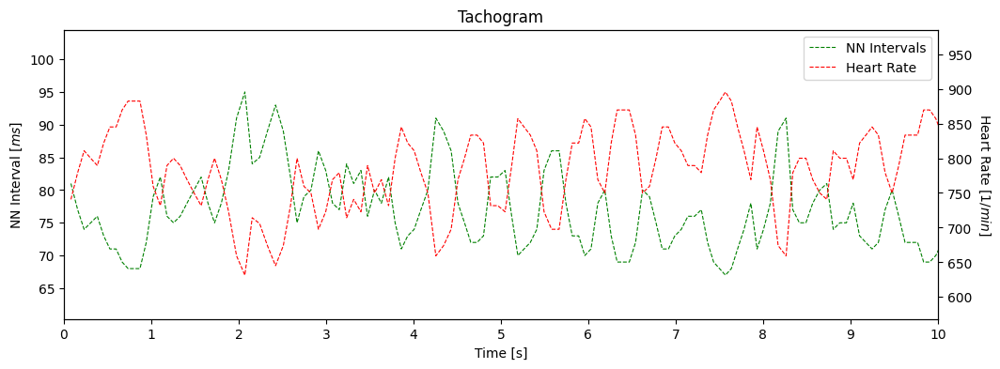

프로토콜: 3.0 MA


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/utils.py:367: UserWarning: Signal duration is to short for segmentation into 300000s. Input data will be returned.
  warnings.warn("Signal duration is to short for segmentation into %is. Input data will be returned." % duration)
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:303: UserWarning: Signal duration too short for SDANN computation.
  warnings.warn("Signal duration too short for SDANN computation.")
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:576: UserWarning: CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a malfunction of the function. This function will be reviewed over the next updates to solve this issue
  warnings.warn('CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a '


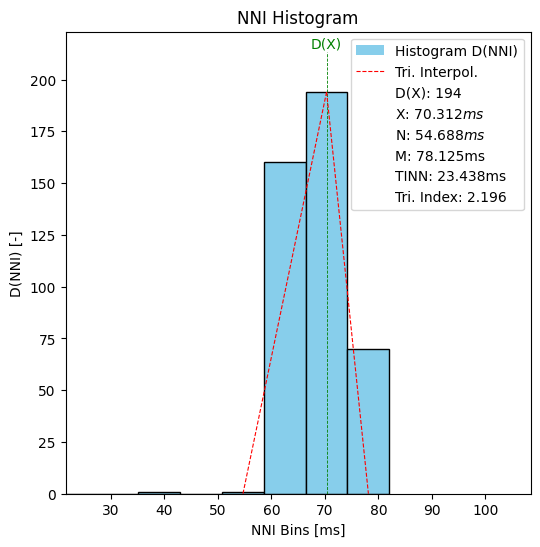

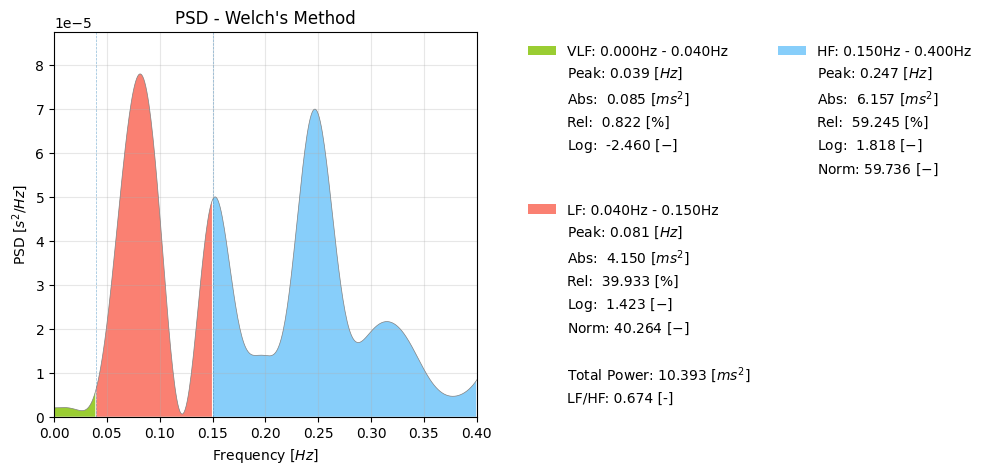

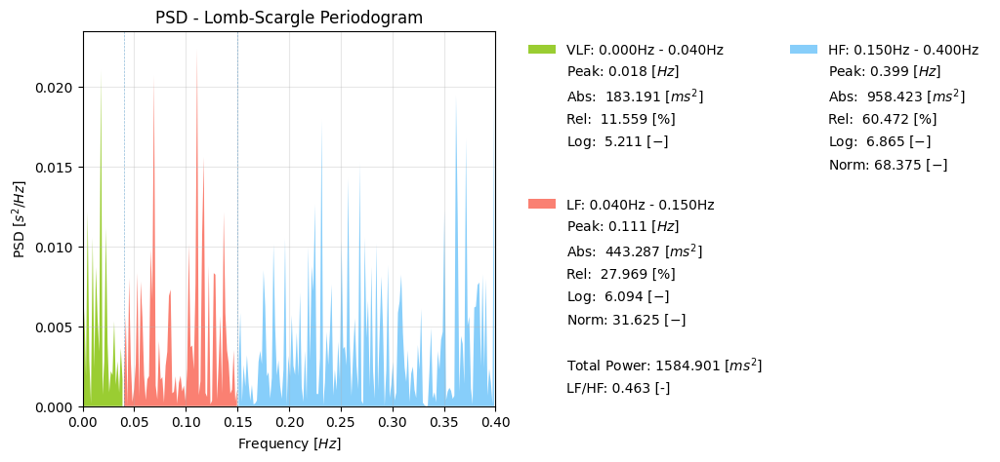

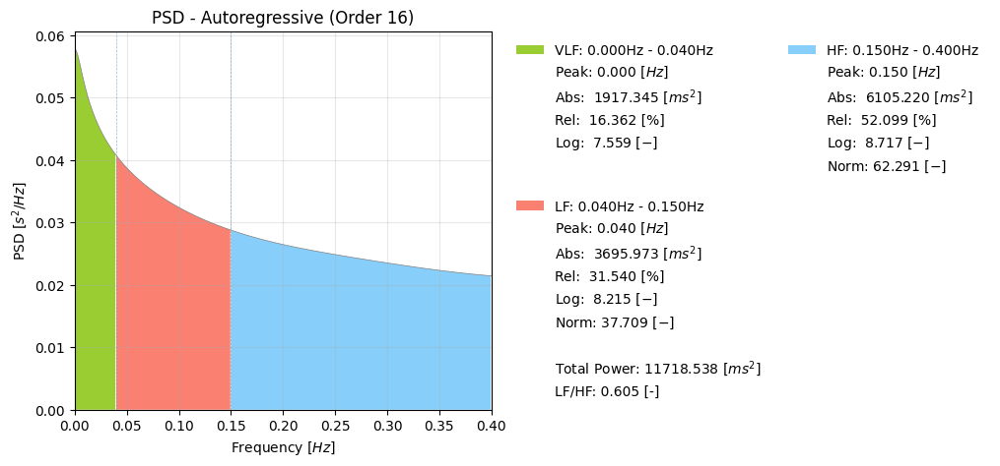

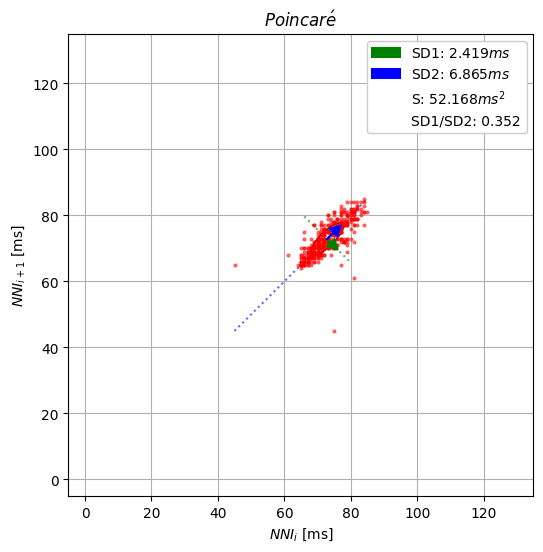

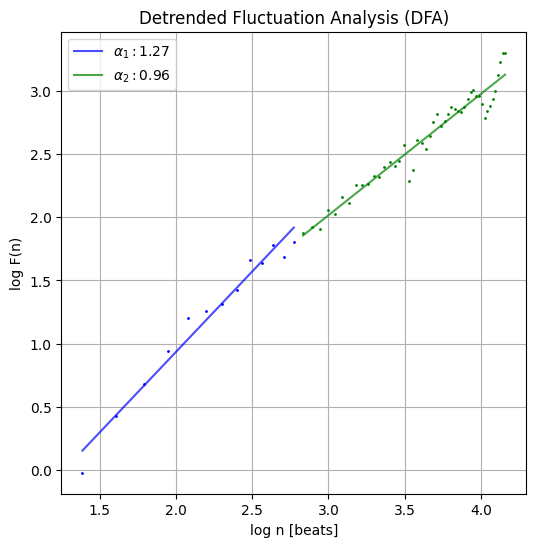

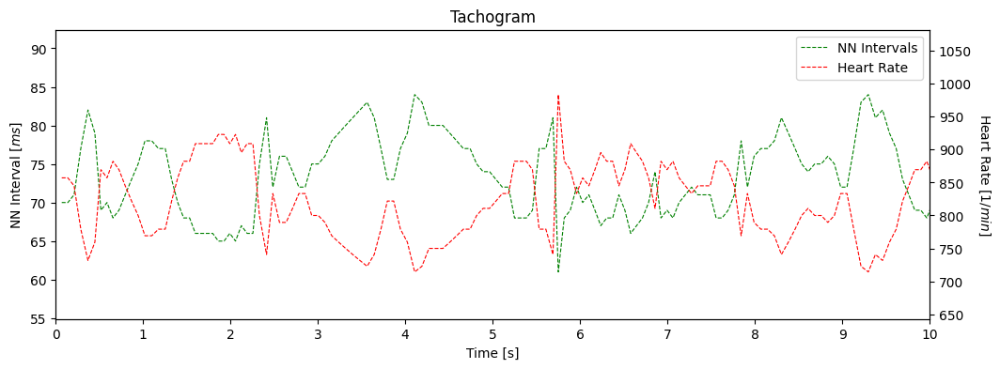

(M)004_20230507_093440_H10.csv
Value is nan
프로토콜: 1.0 BASELINE


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/utils.py:367: UserWarning: Signal duration is to short for segmentation into 300000s. Input data will be returned.
  warnings.warn("Signal duration is to short for segmentation into %is. Input data will be returned." % duration)
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:303: UserWarning: Signal duration too short for SDANN computation.
  warnings.warn("Signal duration too short for SDANN computation.")
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:576: UserWarning: CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a malfunction of the function. This function will be reviewed over the next updates to solve this issue
  warnings.warn('CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a '


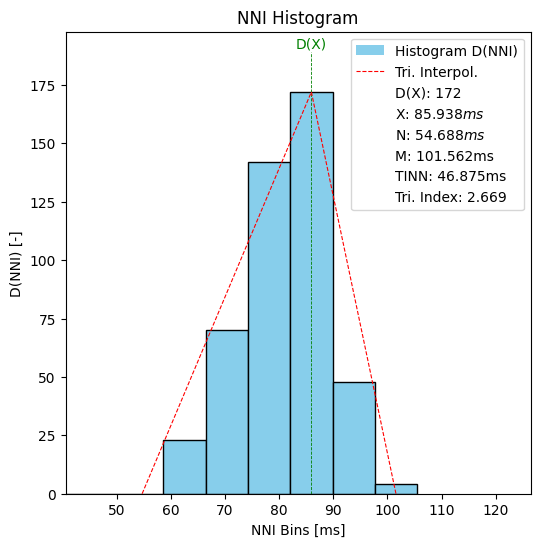

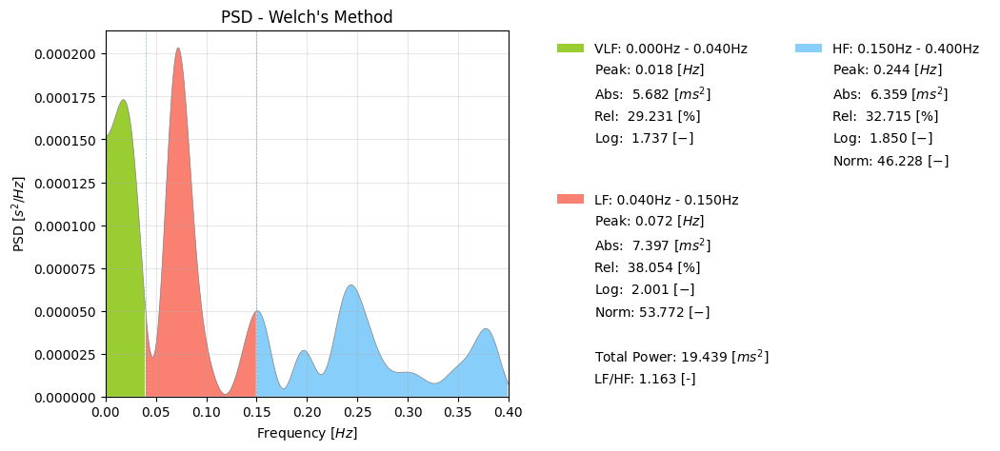

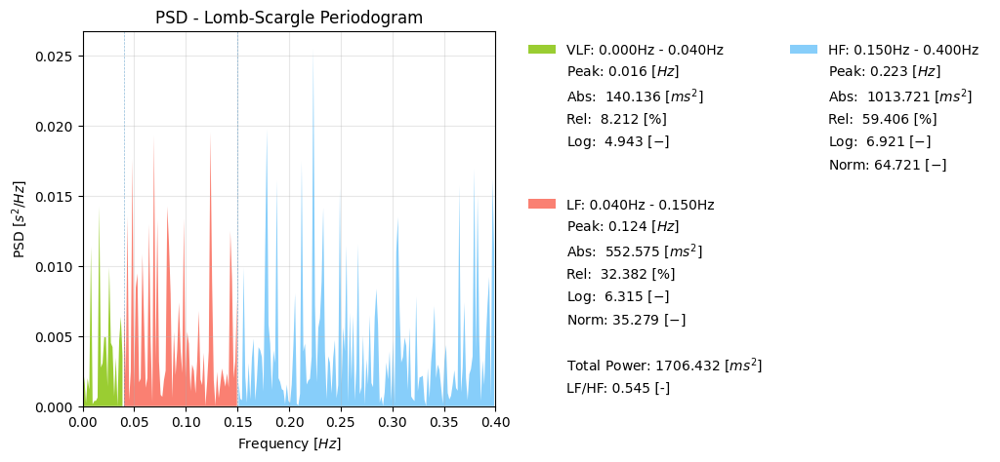

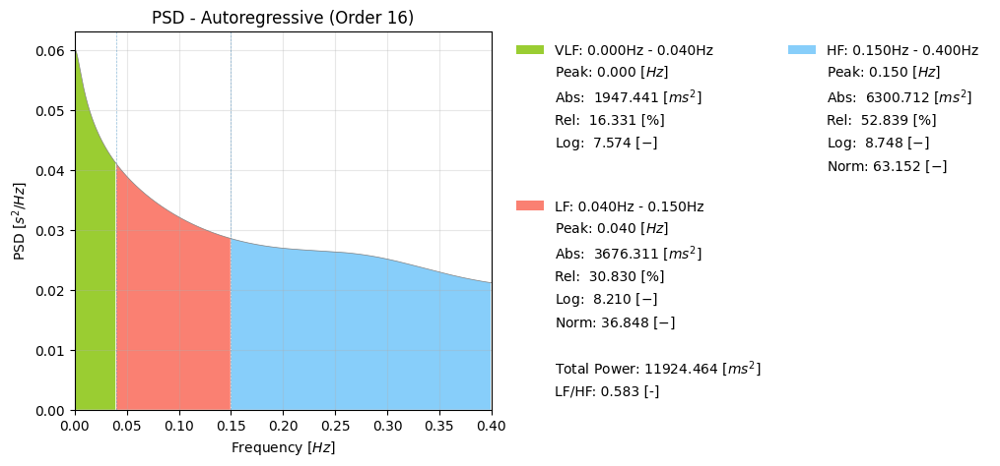

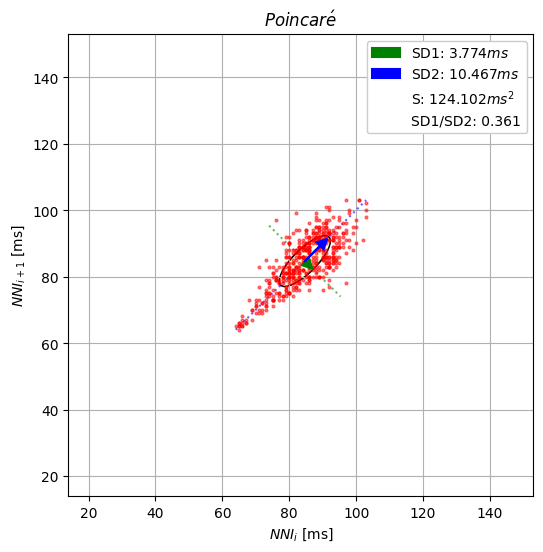

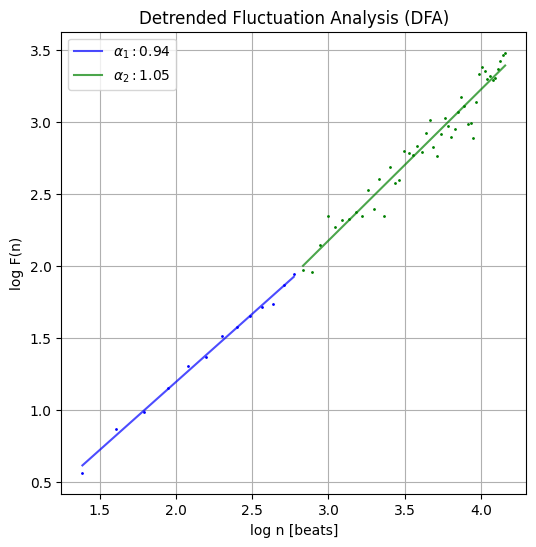

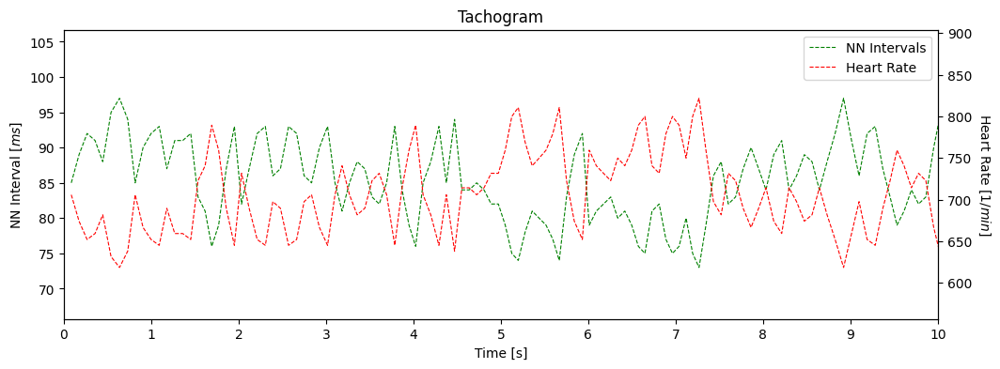

프로토콜: 2.0 HIT


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/utils.py:367: UserWarning: Signal duration is to short for segmentation into 300000s. Input data will be returned.
  warnings.warn("Signal duration is to short for segmentation into %is. Input data will be returned." % duration)
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:303: UserWarning: Signal duration too short for SDANN computation.
  warnings.warn("Signal duration too short for SDANN computation.")
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:576: UserWarning: CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a malfunction of the function. This function will be reviewed over the next updates to solve this issue
  warnings.warn('CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a '


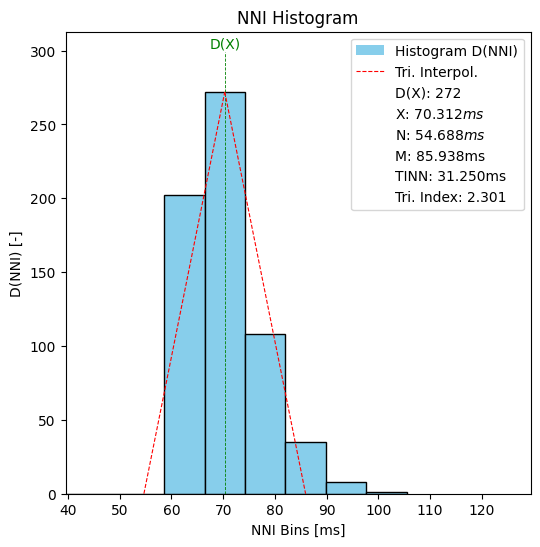

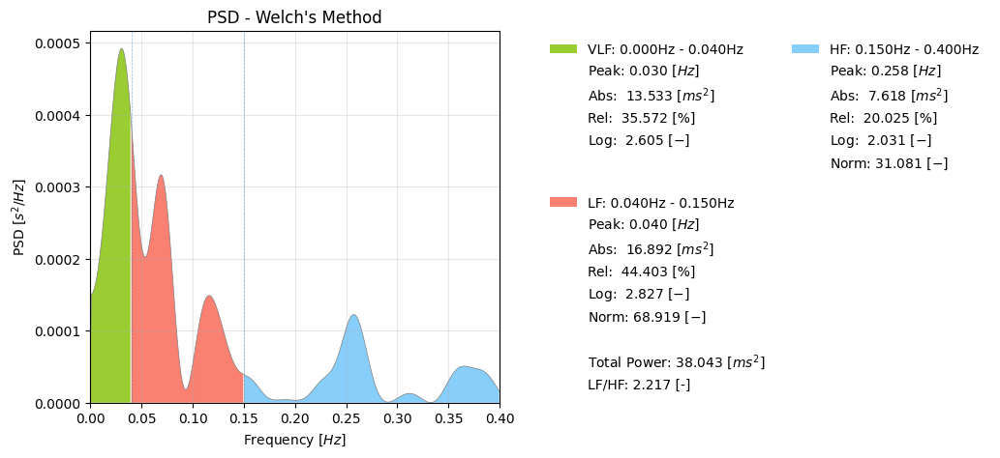

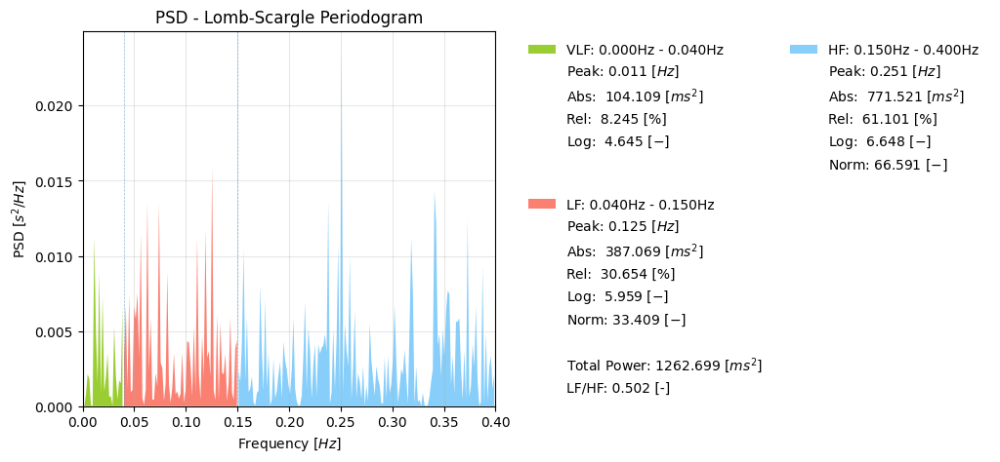

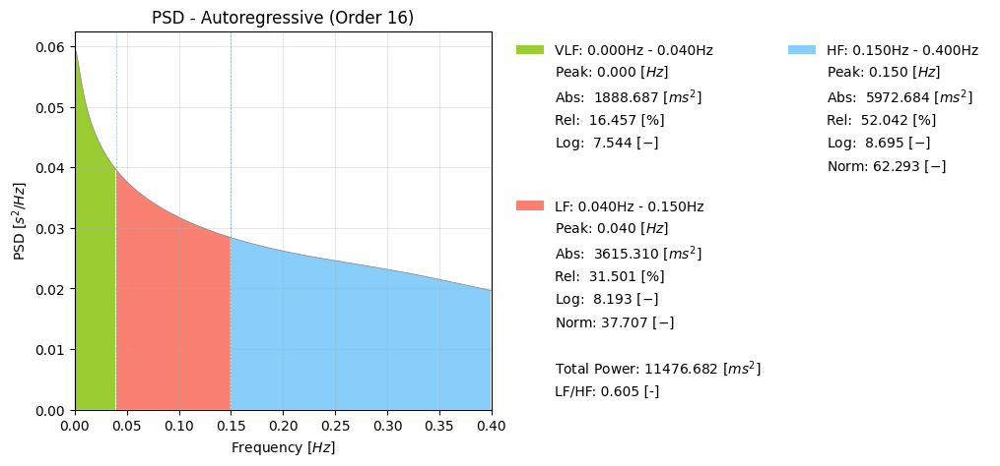

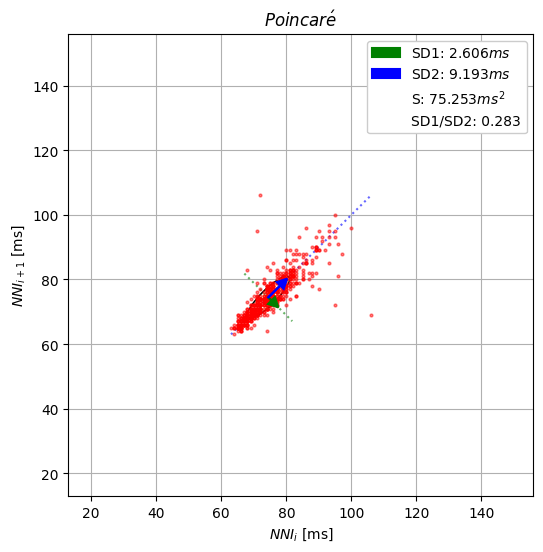

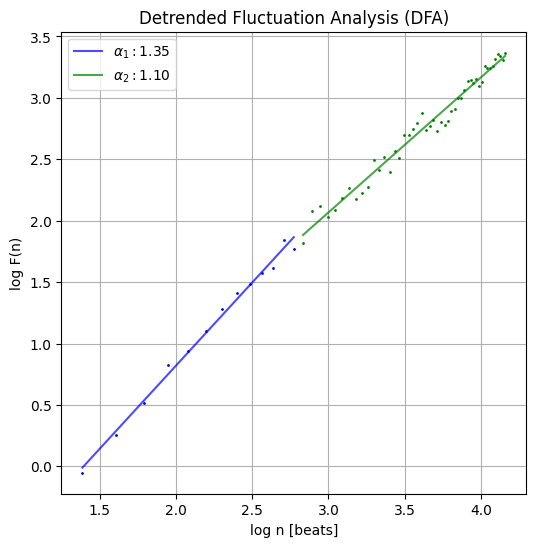

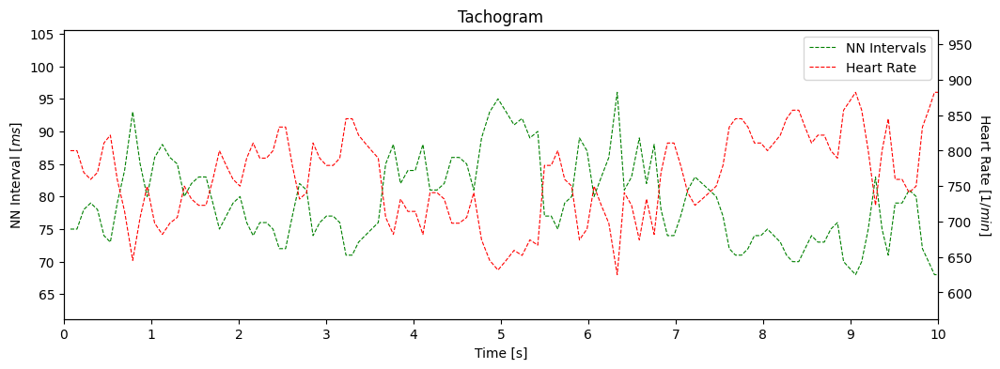

프로토콜: 3.0 MA


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/utils.py:367: UserWarning: Signal duration is to short for segmentation into 300000s. Input data will be returned.
  warnings.warn("Signal duration is to short for segmentation into %is. Input data will be returned." % duration)
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:303: UserWarning: Signal duration too short for SDANN computation.
  warnings.warn("Signal duration too short for SDANN computation.")
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:576: UserWarning: CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a malfunction of the function. This function will be reviewed over the next updates to solve this issue
  warnings.warn('CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a '


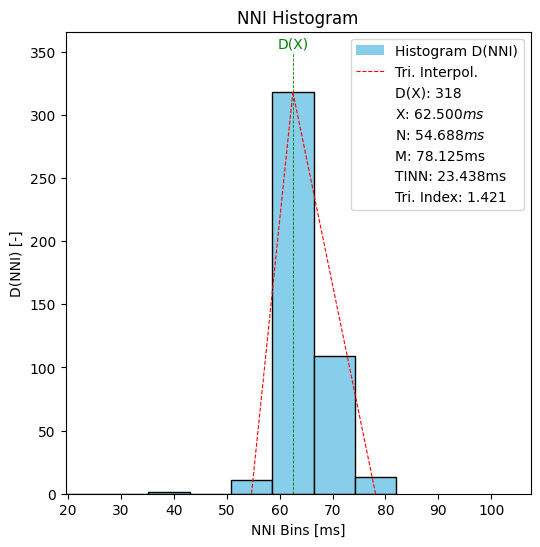

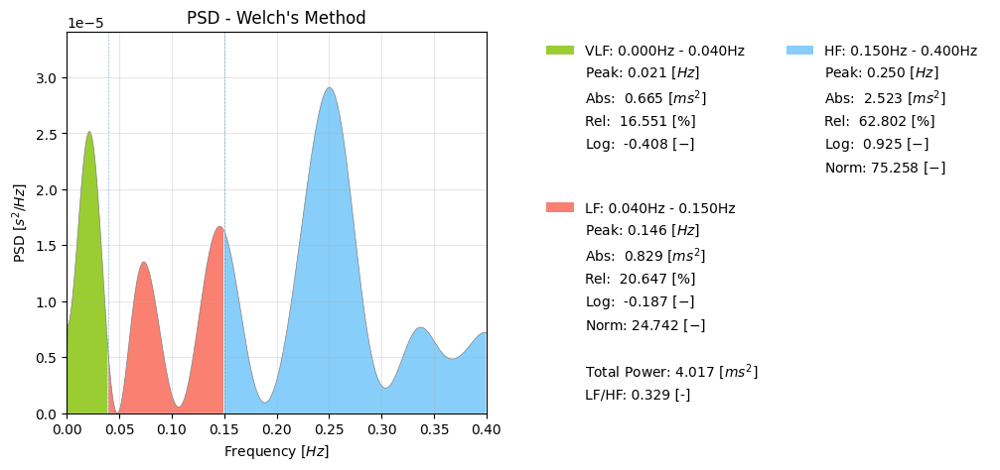

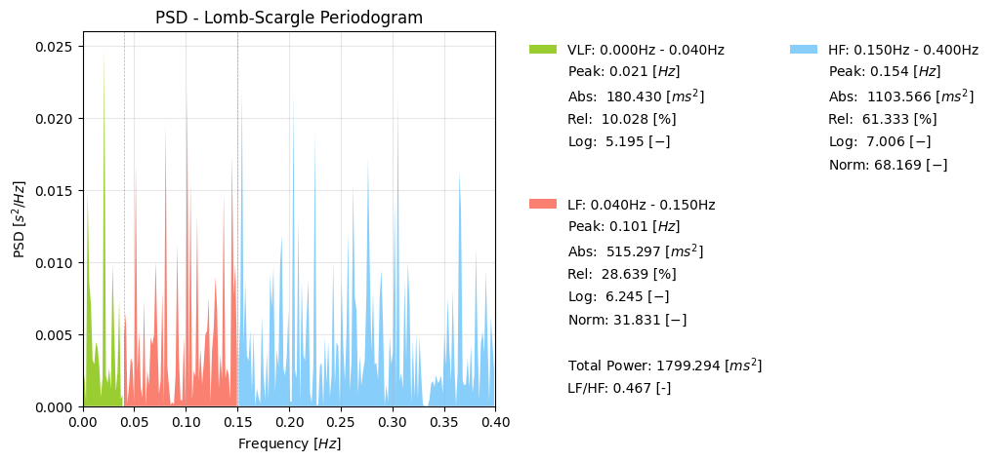

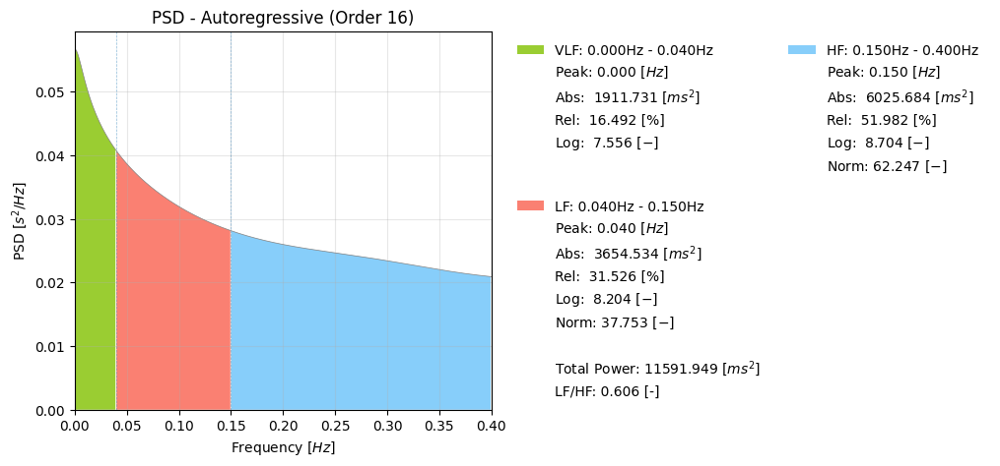

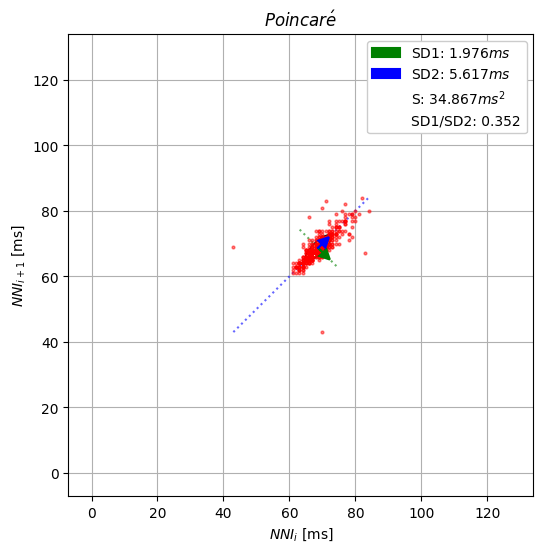

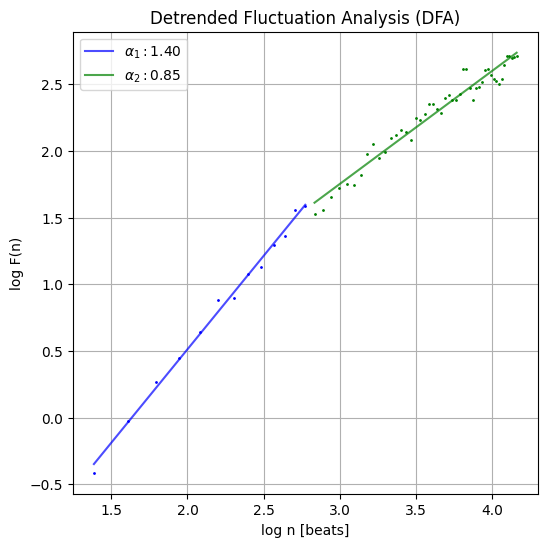

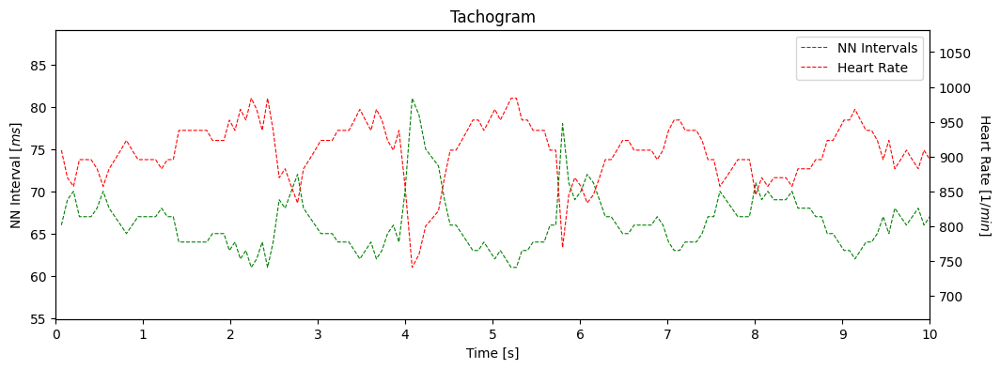

(M)005_20230507_113956_H10.csv
Value is nan
프로토콜: 1.0 BASELINE


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/utils.py:367: UserWarning: Signal duration is to short for segmentation into 300000s. Input data will be returned.
  warnings.warn("Signal duration is to short for segmentation into %is. Input data will be returned." % duration)
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:303: UserWarning: Signal duration too short for SDANN computation.
  warnings.warn("Signal duration too short for SDANN computation.")
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:576: UserWarning: CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a malfunction of the function. This function will be reviewed over the next updates to solve this issue
  warnings.warn('CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a '


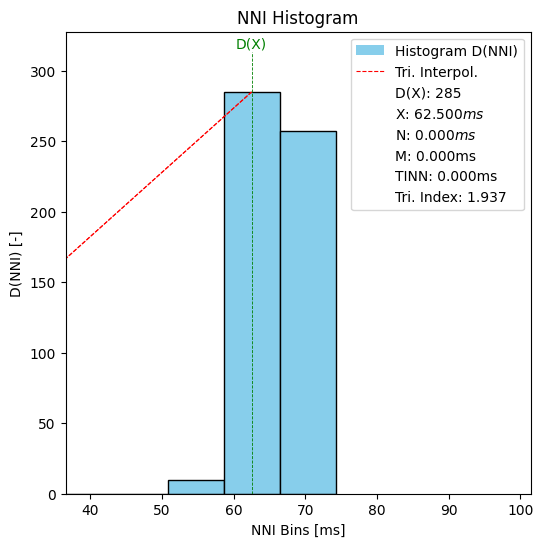

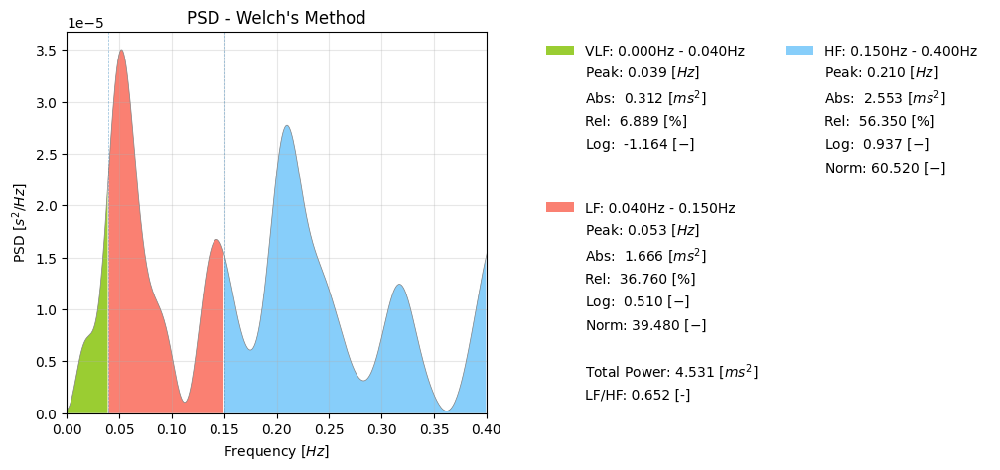

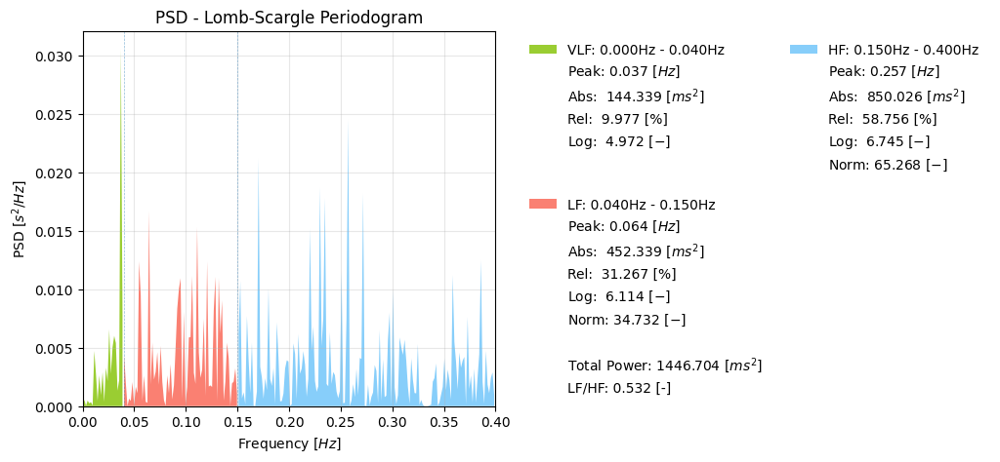

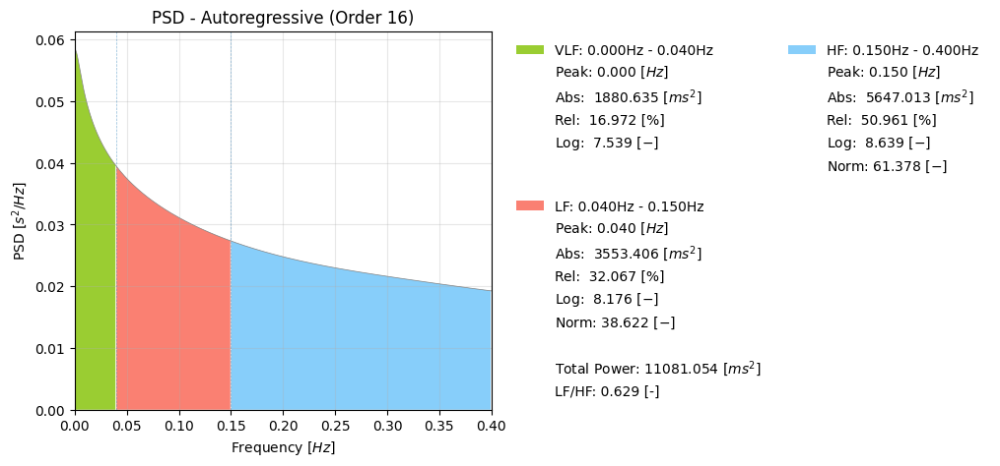

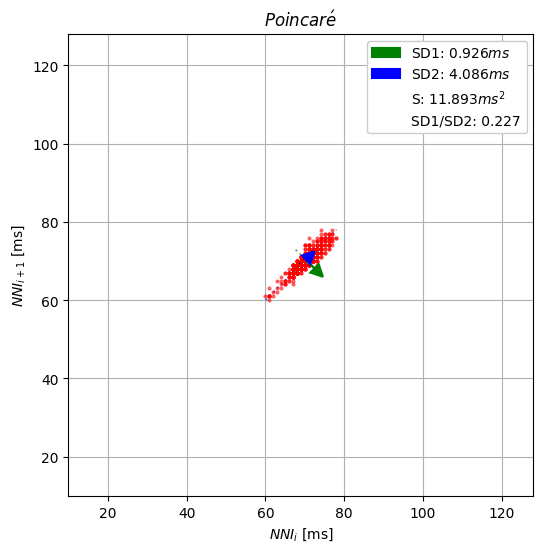

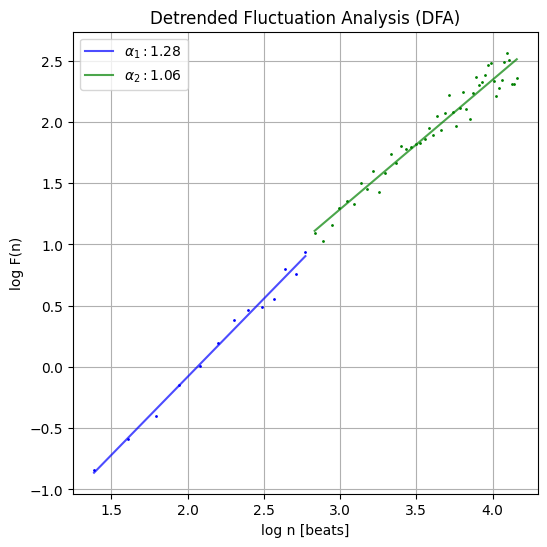

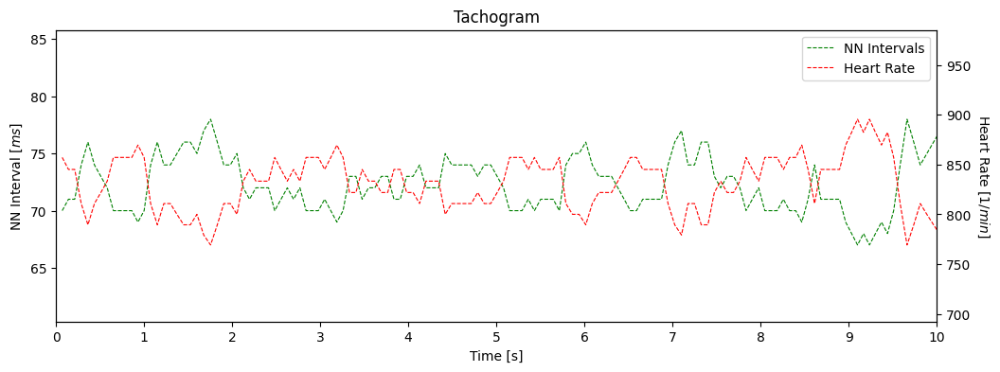

프로토콜: 2.0 HIT


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/utils.py:367: UserWarning: Signal duration is to short for segmentation into 300000s. Input data will be returned.
  warnings.warn("Signal duration is to short for segmentation into %is. Input data will be returned." % duration)
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:303: UserWarning: Signal duration too short for SDANN computation.
  warnings.warn("Signal duration too short for SDANN computation.")
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:576: UserWarning: CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a malfunction of the function. This function will be reviewed over the next updates to solve this issue
  warnings.warn('CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a '


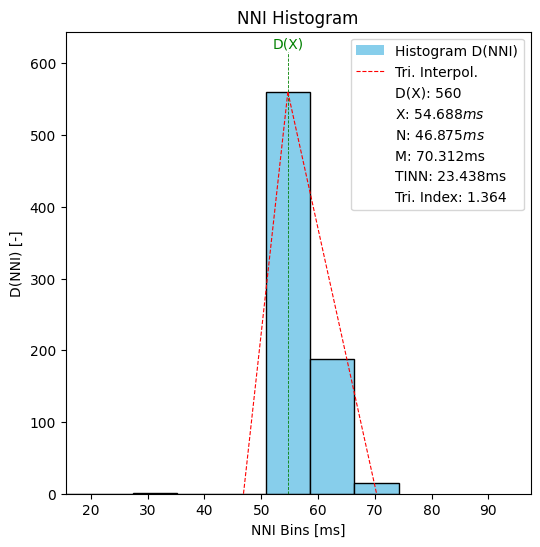

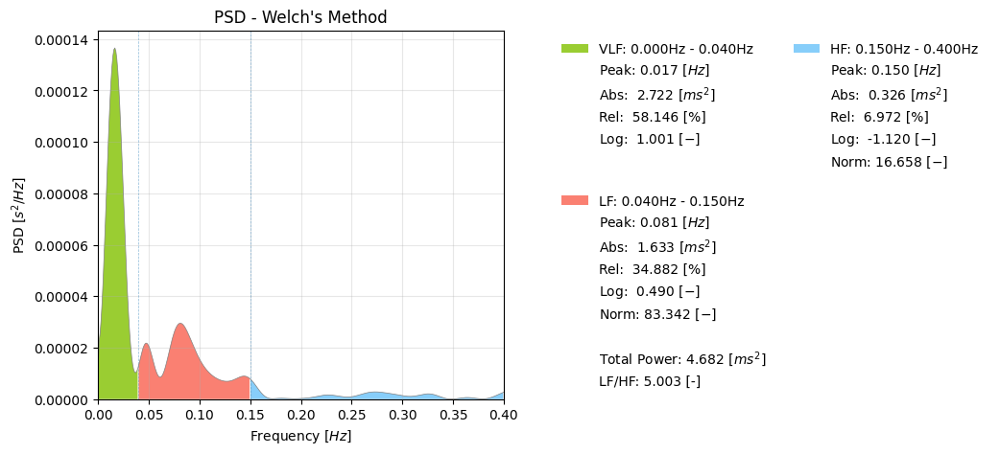

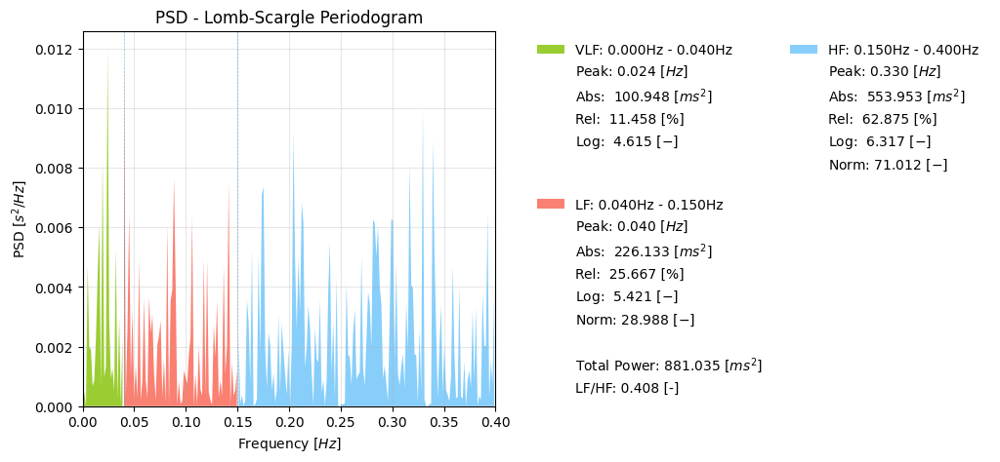

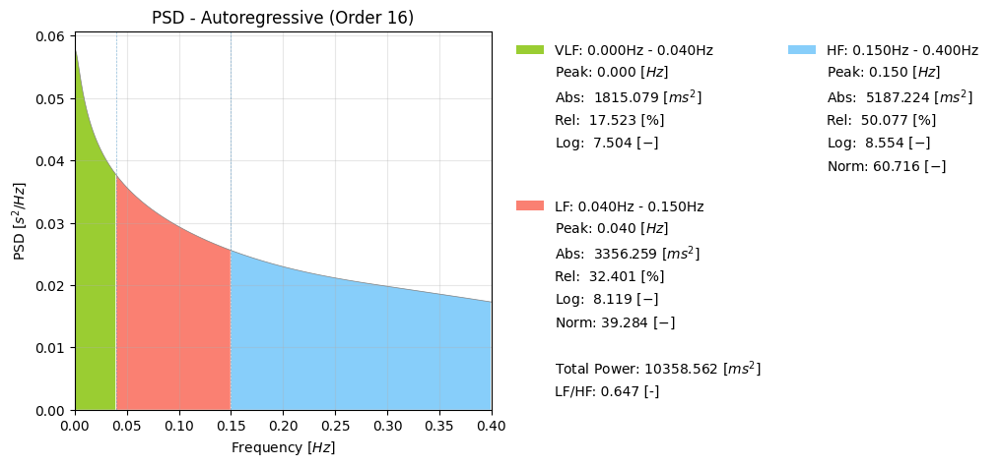

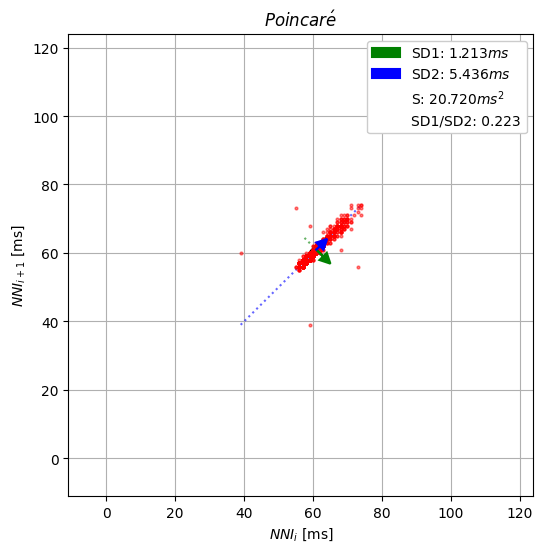

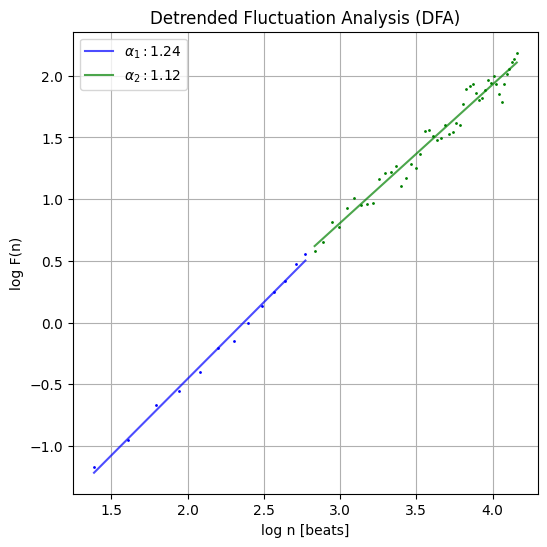

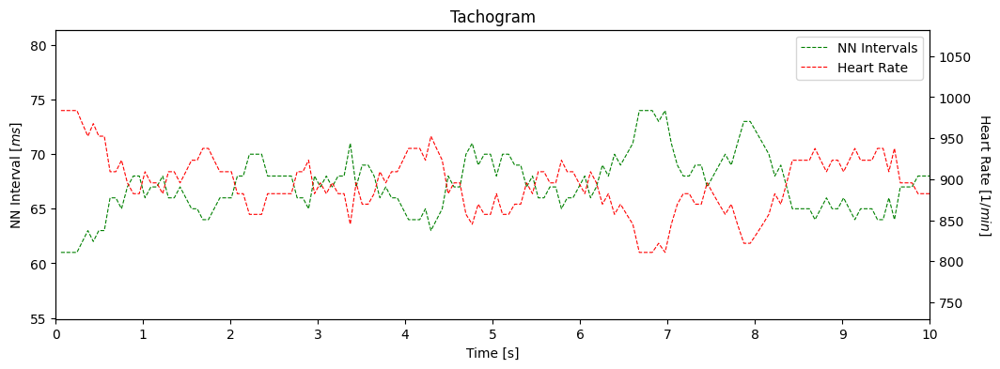

프로토콜: 3.0 MA


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/utils.py:367: UserWarning: Signal duration is to short for segmentation into 300000s. Input data will be returned.
  warnings.warn("Signal duration is to short for segmentation into %is. Input data will be returned." % duration)
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:303: UserWarning: Signal duration too short for SDANN computation.
  warnings.warn("Signal duration too short for SDANN computation.")
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:576: UserWarning: CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a malfunction of the function. This function will be reviewed over the next updates to solve this issue
  warnings.warn('CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a '


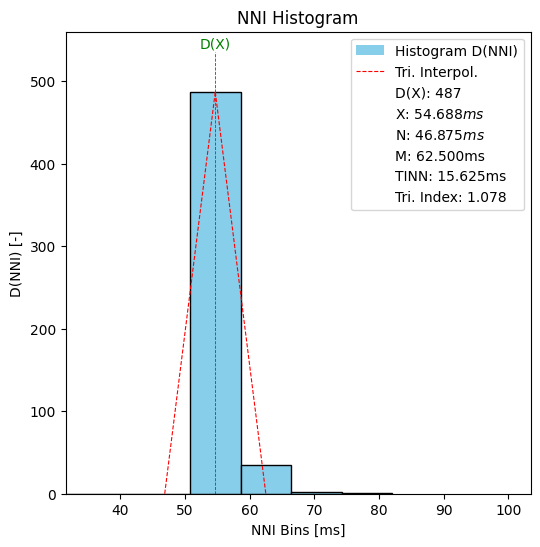

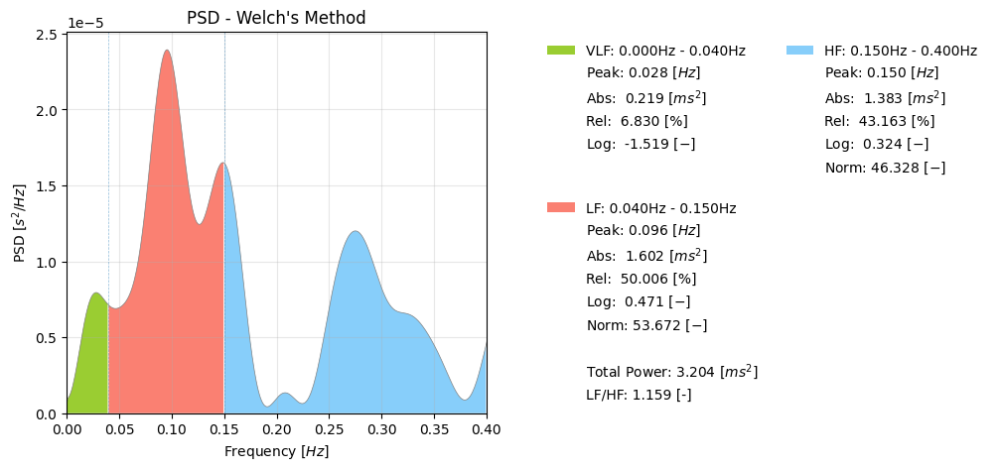

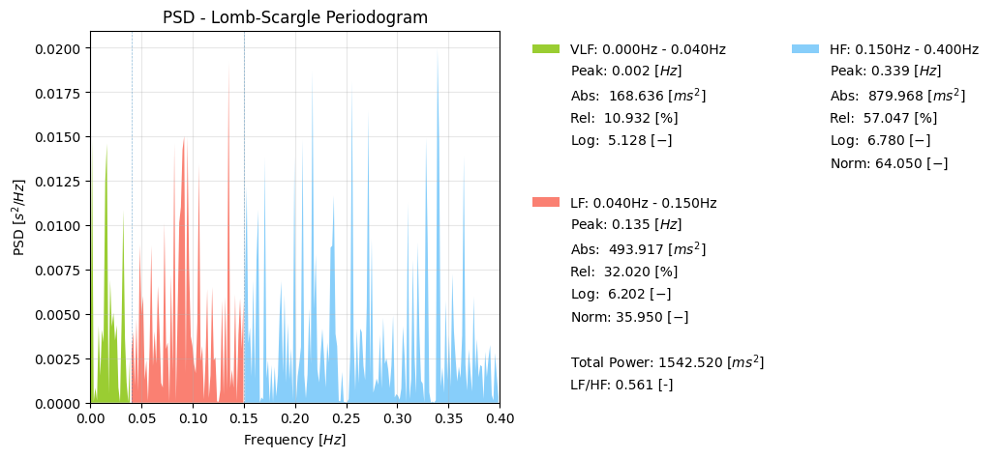

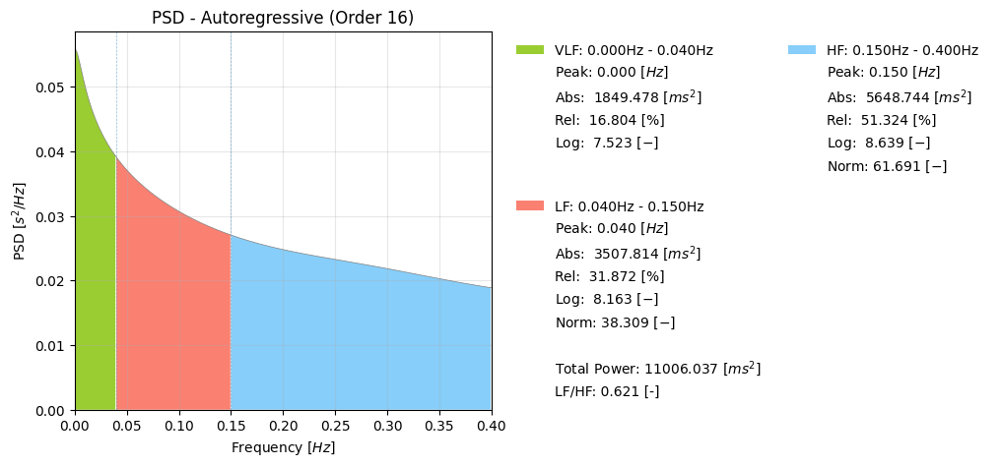

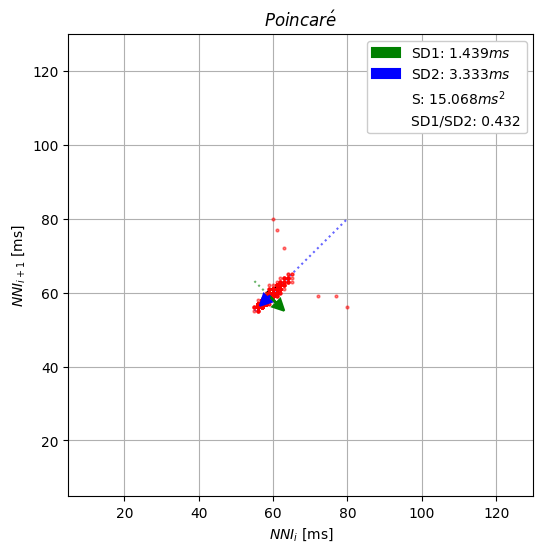

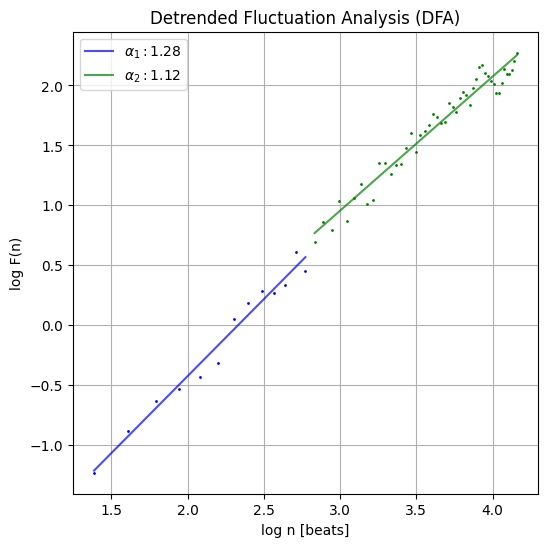

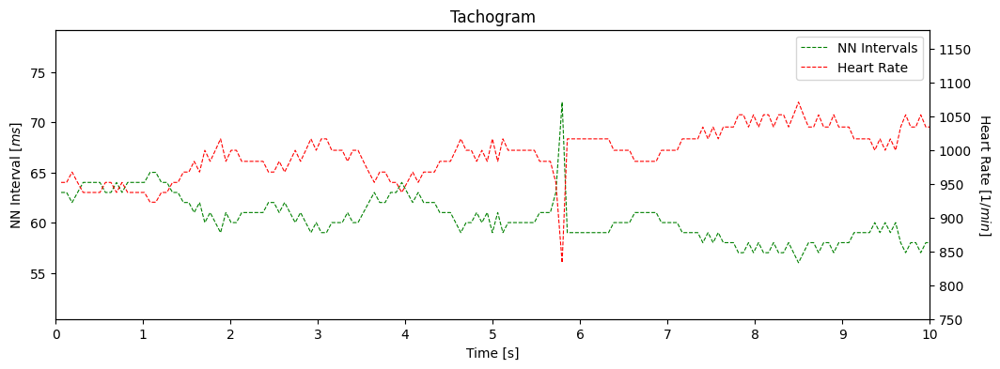

(M)006_20230507_110506_H10.csv
Value is nan
프로토콜: 1.0 BASELINE


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/utils.py:367: UserWarning: Signal duration is to short for segmentation into 300000s. Input data will be returned.
  warnings.warn("Signal duration is to short for segmentation into %is. Input data will be returned." % duration)
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:303: UserWarning: Signal duration too short for SDANN computation.
  warnings.warn("Signal duration too short for SDANN computation.")
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:576: UserWarning: CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a malfunction of the function. This function will be reviewed over the next updates to solve this issue
  warnings.warn('CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a '


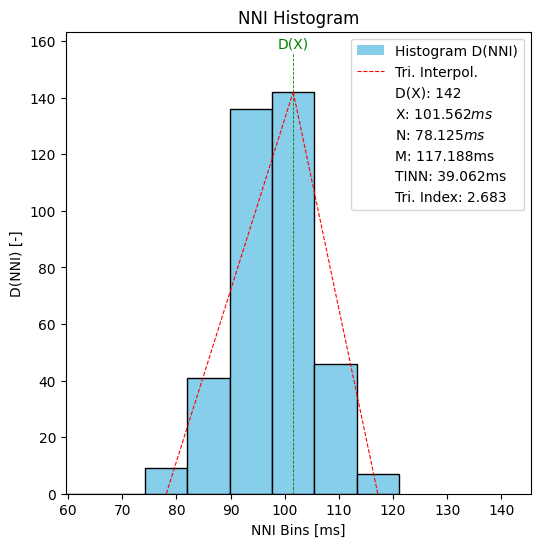

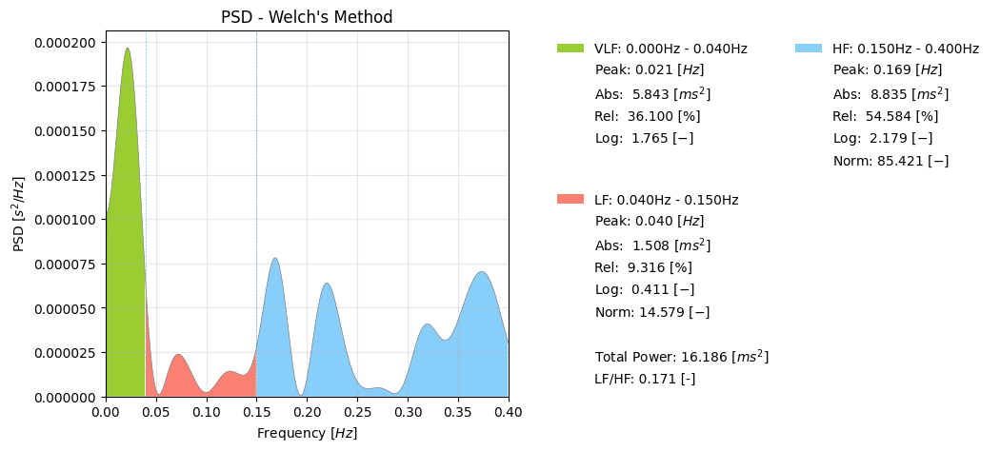

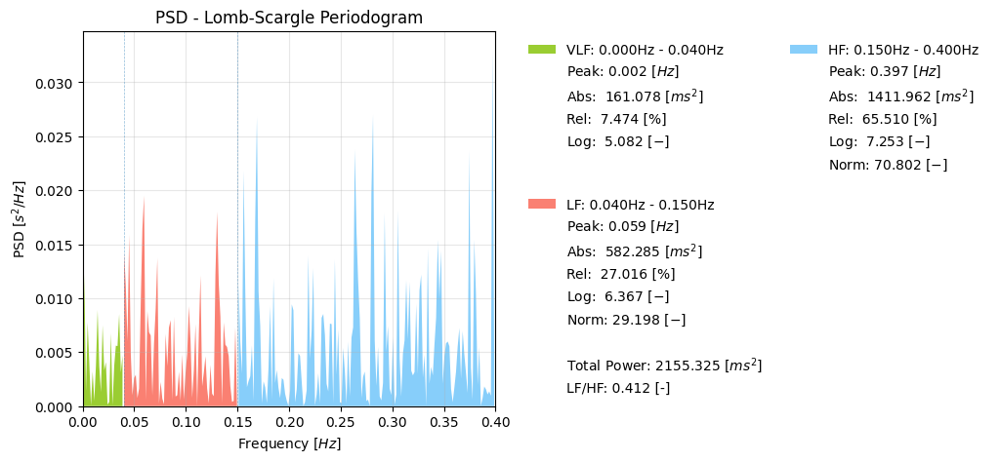

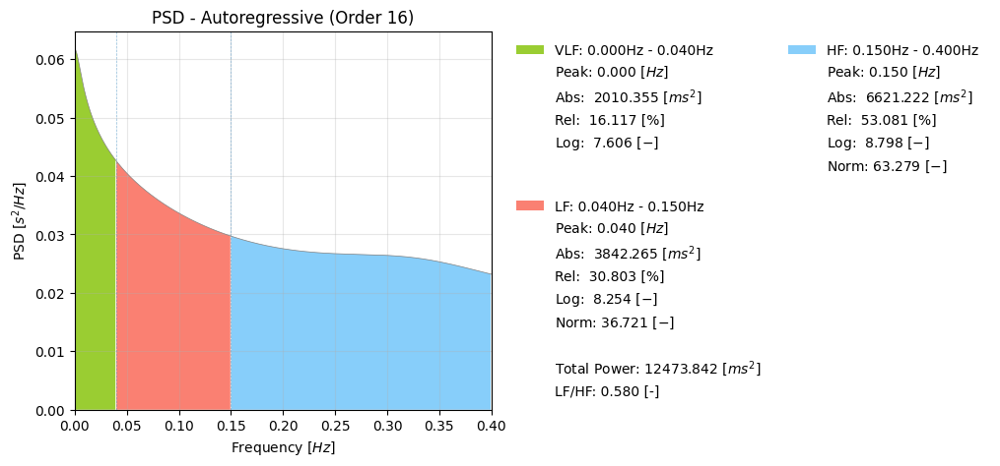

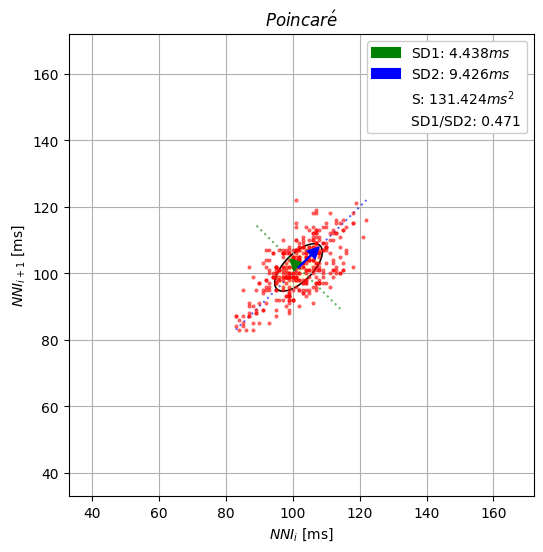

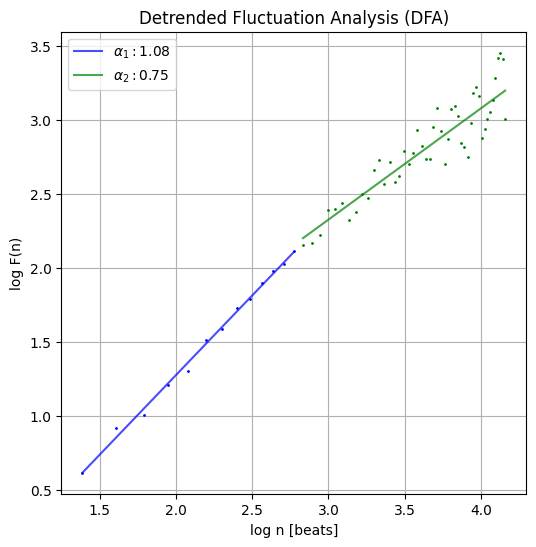

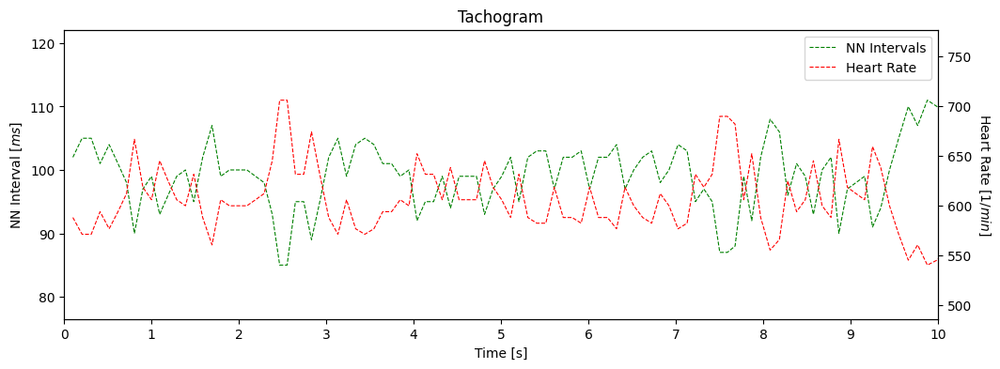

프로토콜: 2.0 HIT


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/utils.py:367: UserWarning: Signal duration is to short for segmentation into 300000s. Input data will be returned.
  warnings.warn("Signal duration is to short for segmentation into %is. Input data will be returned." % duration)
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:303: UserWarning: Signal duration too short for SDANN computation.
  warnings.warn("Signal duration too short for SDANN computation.")
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:576: UserWarning: CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a malfunction of the function. This function will be reviewed over the next updates to solve this issue
  warnings.warn('CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a '


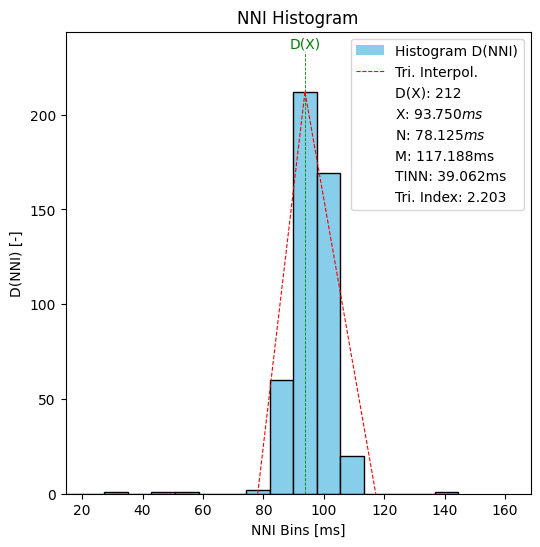

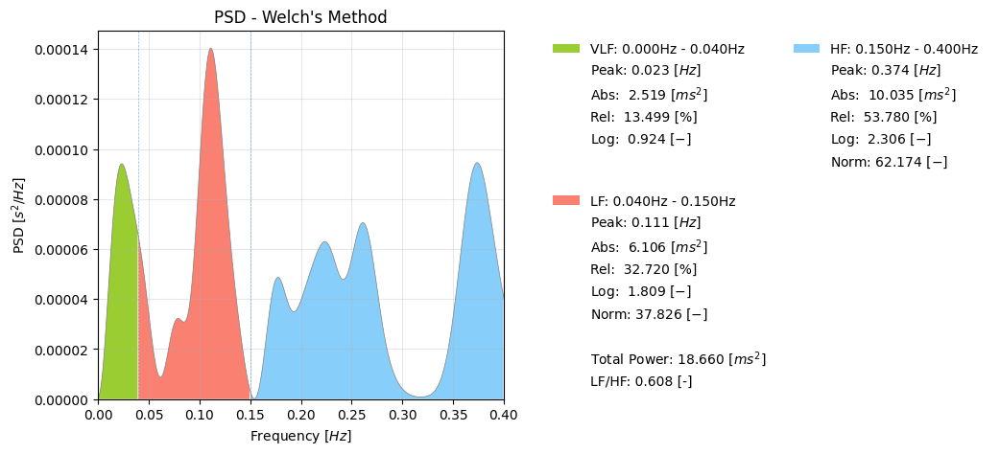

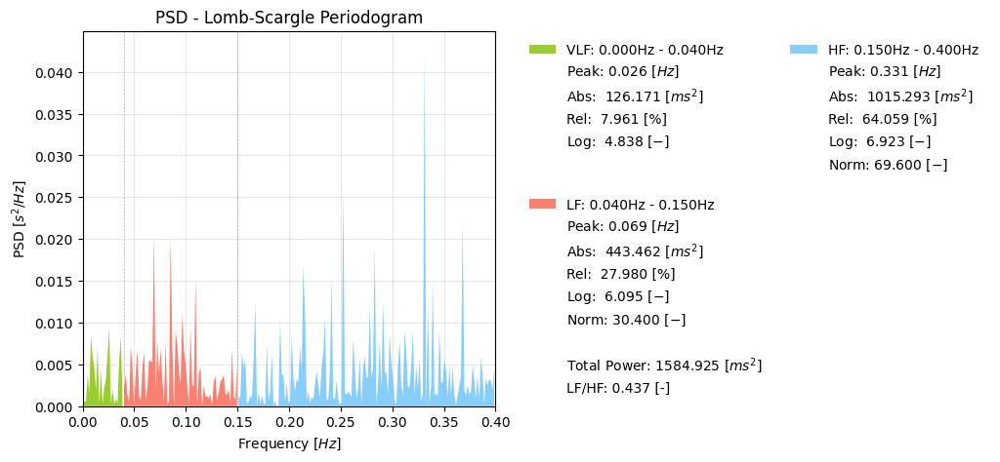

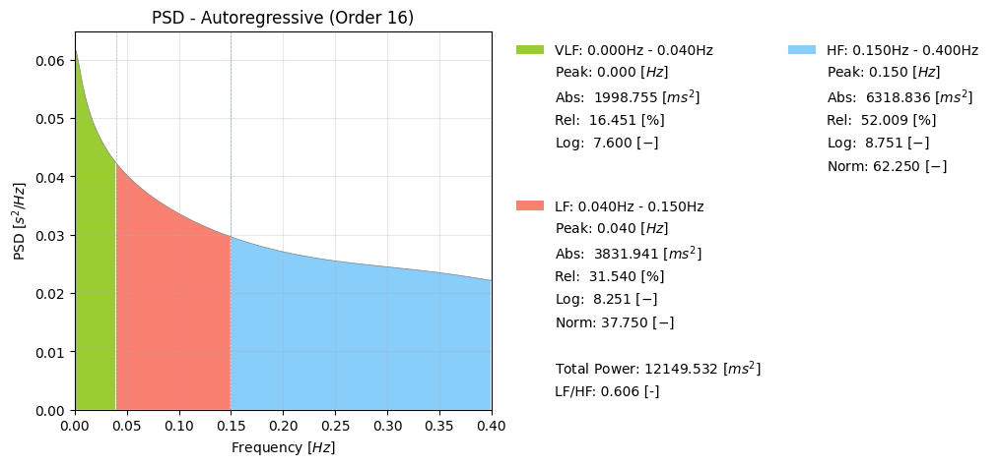

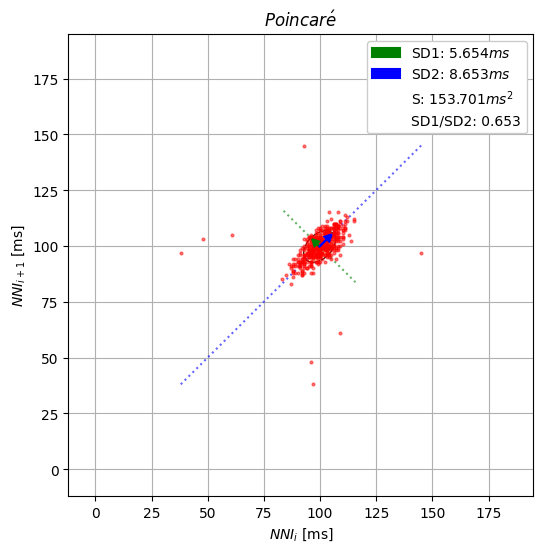

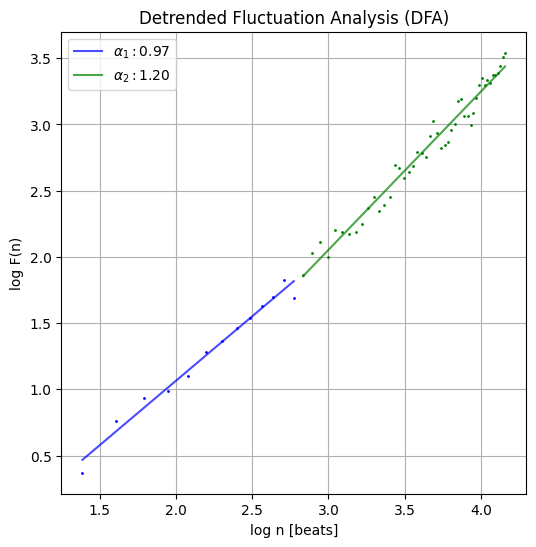

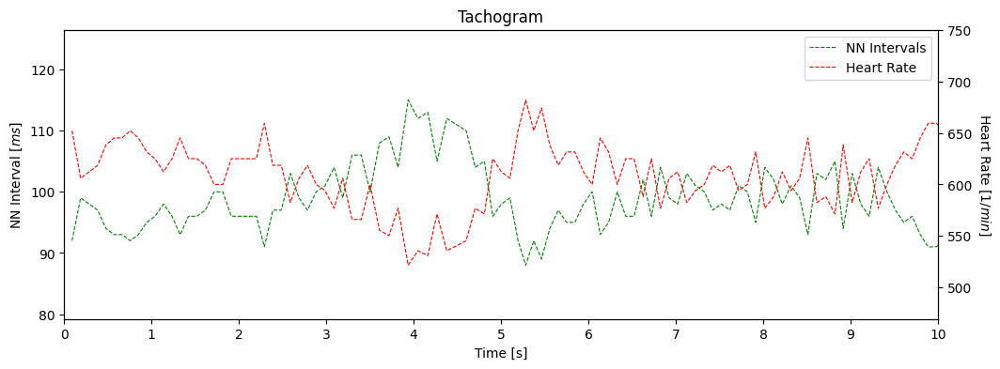

프로토콜: 3.0 MA


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/utils.py:367: UserWarning: Signal duration is to short for segmentation into 300000s. Input data will be returned.
  warnings.warn("Signal duration is to short for segmentation into %is. Input data will be returned." % duration)
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:303: UserWarning: Signal duration too short for SDANN computation.
  warnings.warn("Signal duration too short for SDANN computation.")
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:576: UserWarning: CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a malfunction of the function. This function will be reviewed over the next updates to solve this issue
  warnings.warn('CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a '


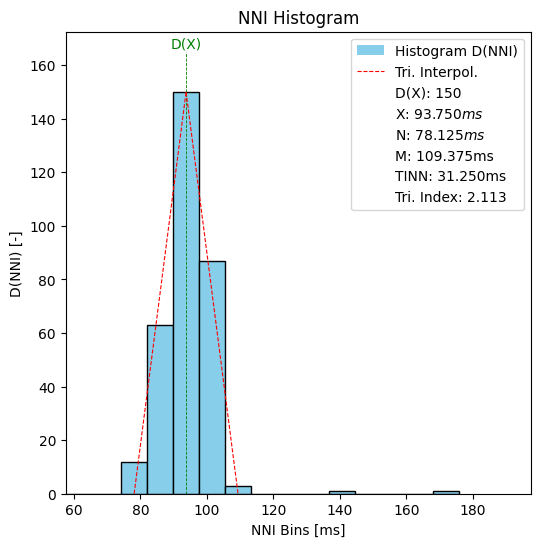

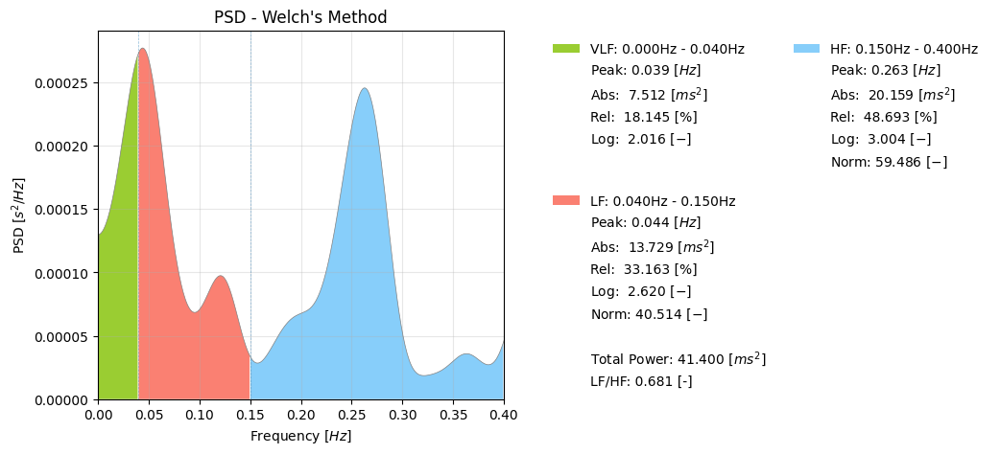

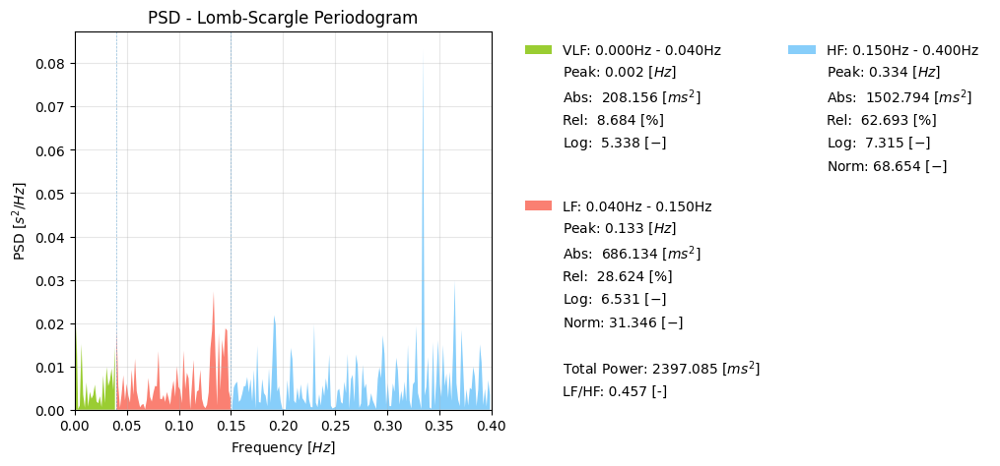

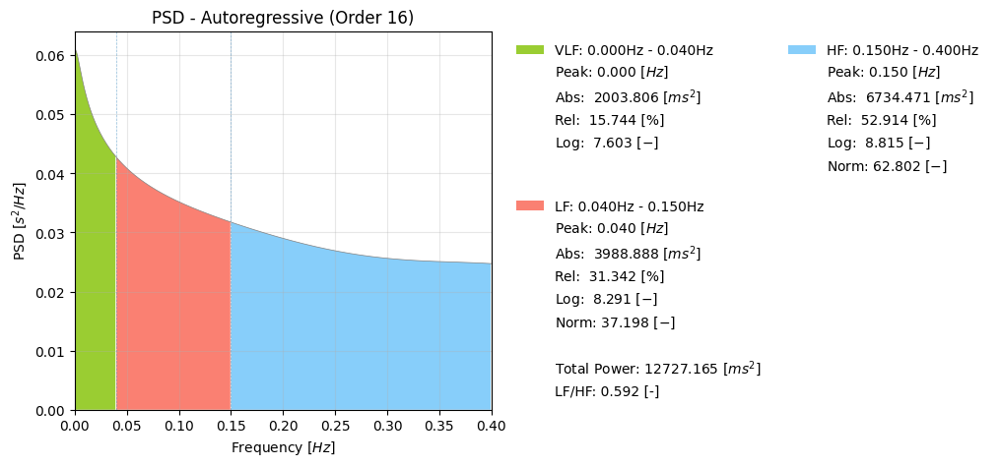

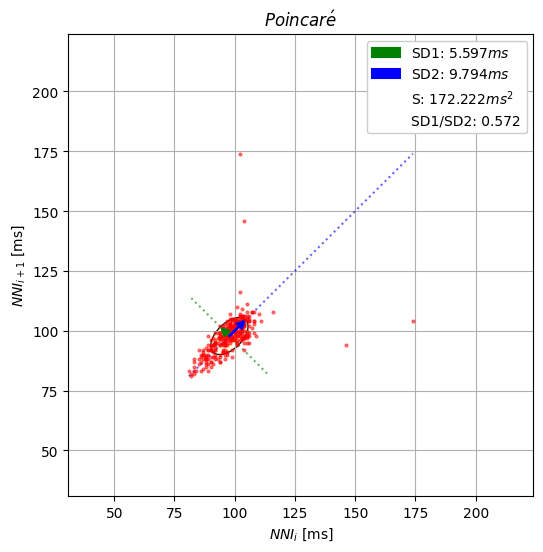

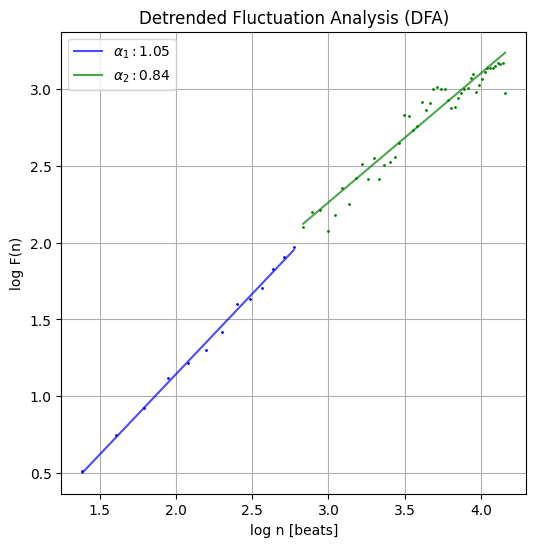

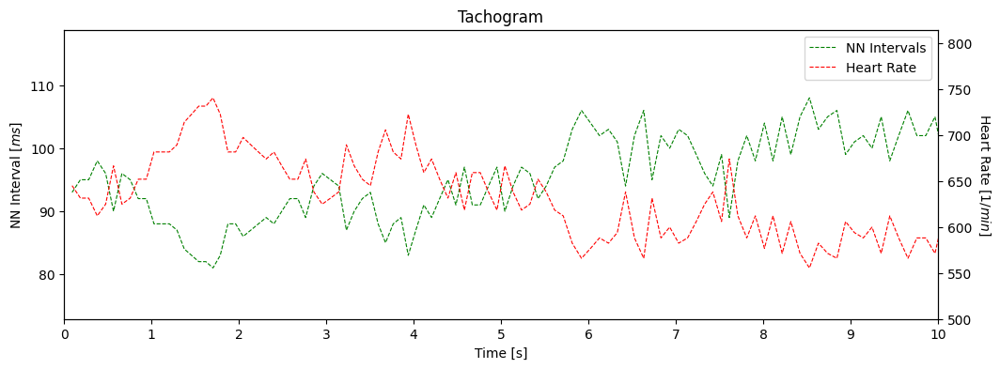

(M)007_20230507_110503_H10.csv
Value is nan
프로토콜: 1.0 BASELINE


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/utils.py:367: UserWarning: Signal duration is to short for segmentation into 300000s. Input data will be returned.
  warnings.warn("Signal duration is to short for segmentation into %is. Input data will be returned." % duration)
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:303: UserWarning: Signal duration too short for SDANN computation.
  warnings.warn("Signal duration too short for SDANN computation.")
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:576: UserWarning: CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a malfunction of the function. This function will be reviewed over the next updates to solve this issue
  warnings.warn('CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a '


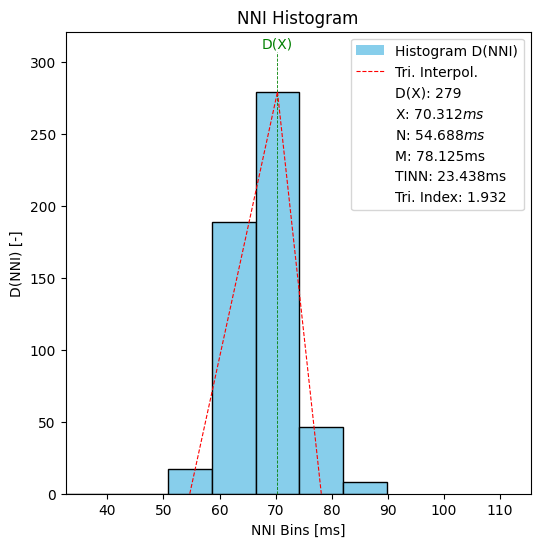

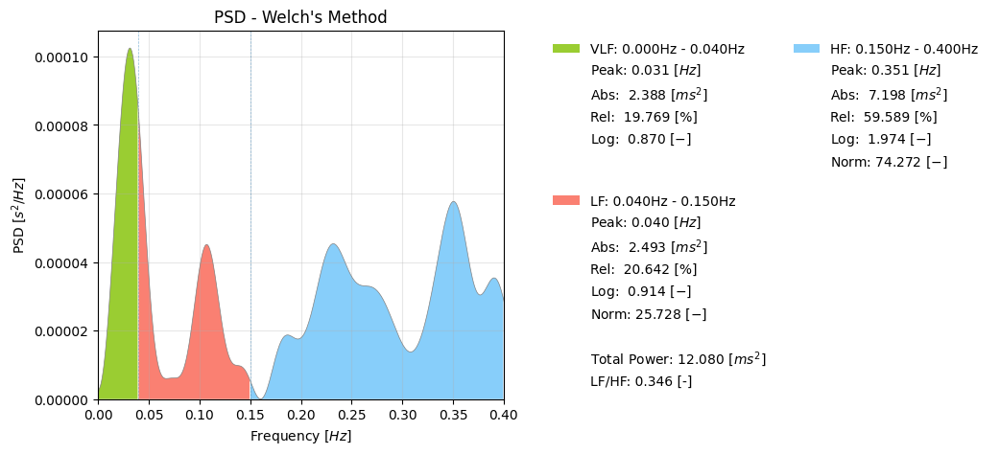

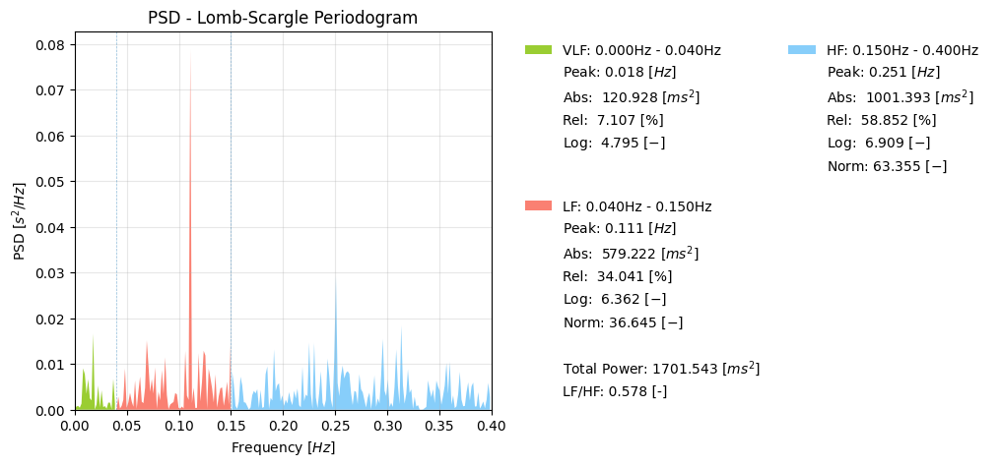

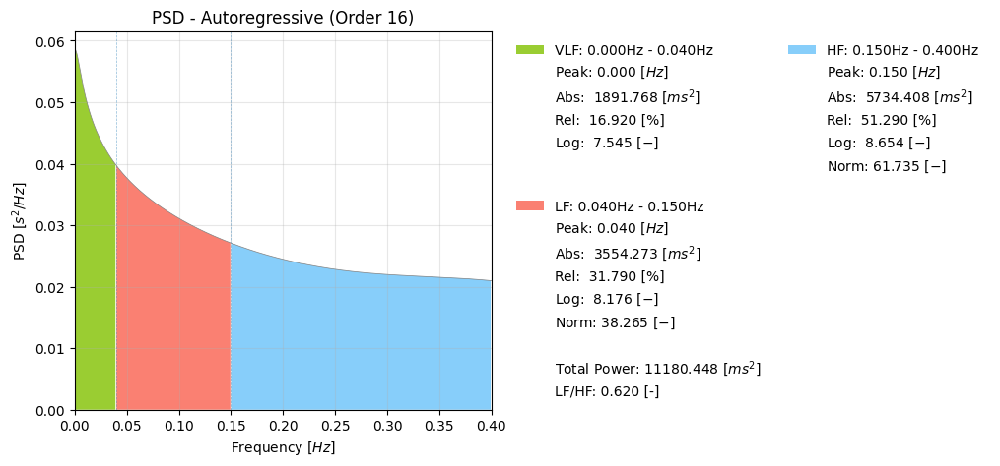

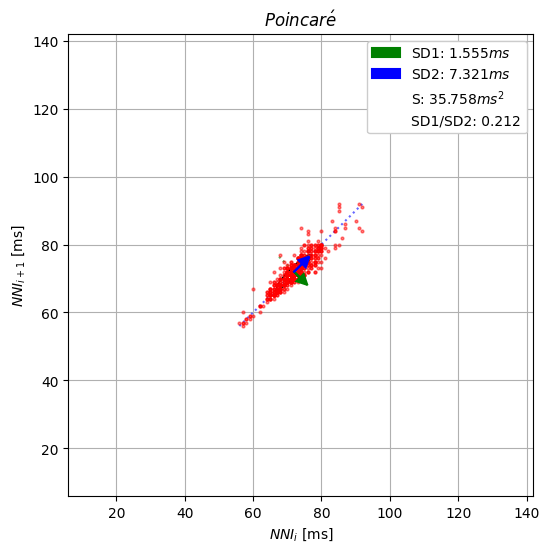

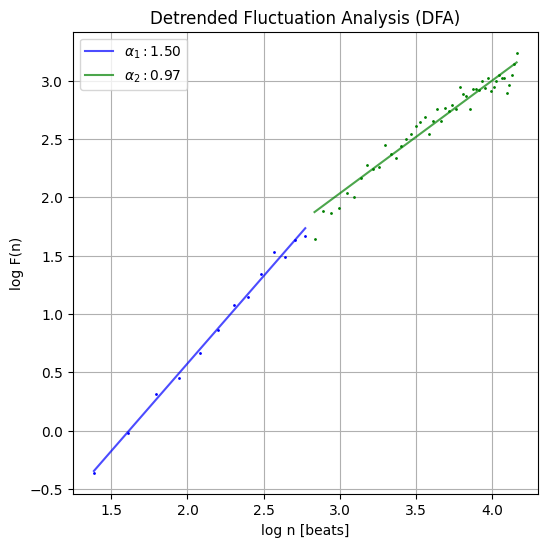

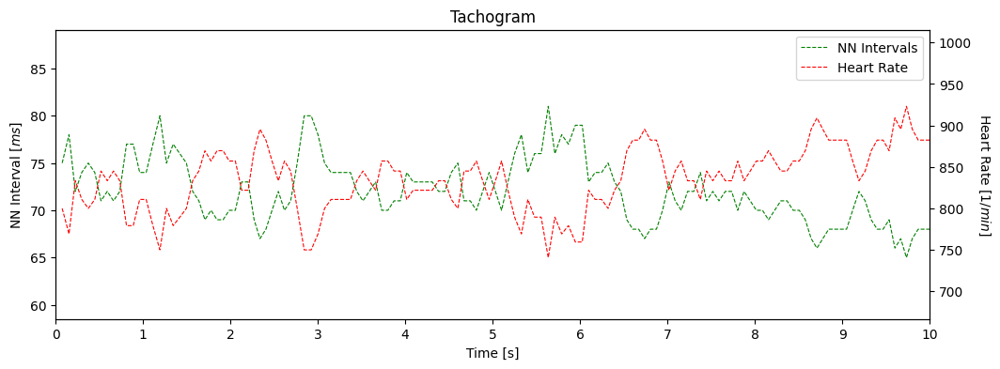

프로토콜: 2.0 HIT


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/utils.py:367: UserWarning: Signal duration is to short for segmentation into 300000s. Input data will be returned.
  warnings.warn("Signal duration is to short for segmentation into %is. Input data will be returned." % duration)
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:303: UserWarning: Signal duration too short for SDANN computation.
  warnings.warn("Signal duration too short for SDANN computation.")
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:576: UserWarning: CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a malfunction of the function. This function will be reviewed over the next updates to solve this issue
  warnings.warn('CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a '


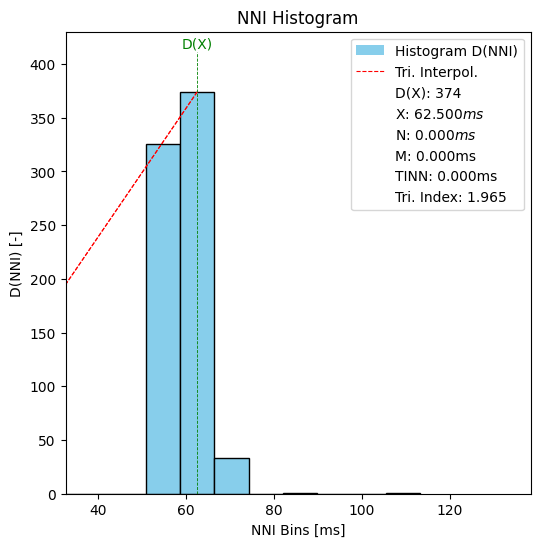

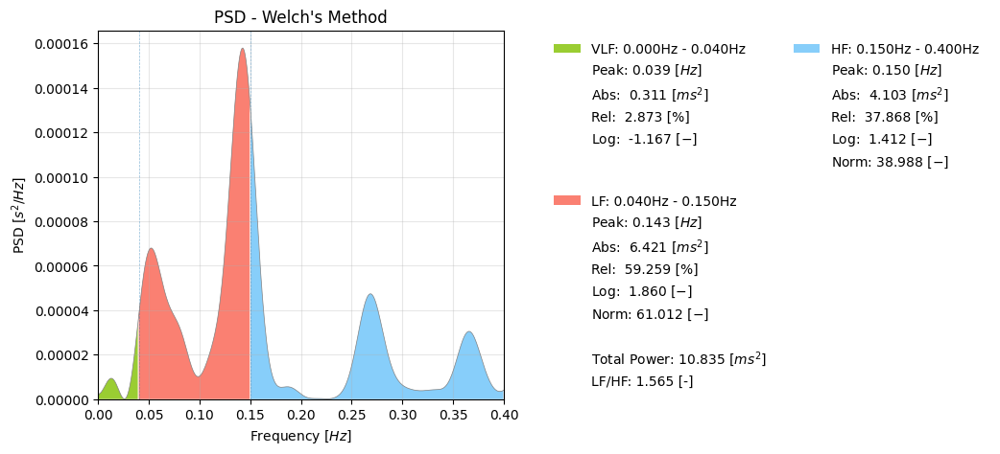

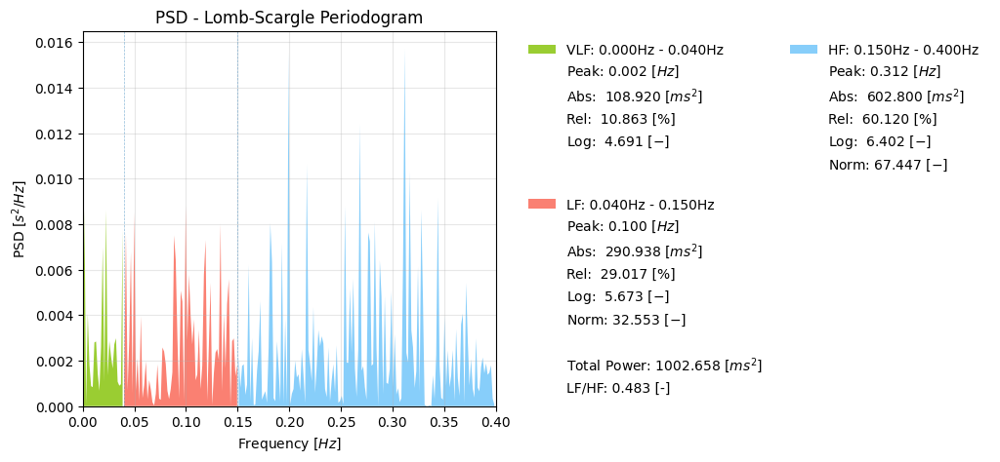

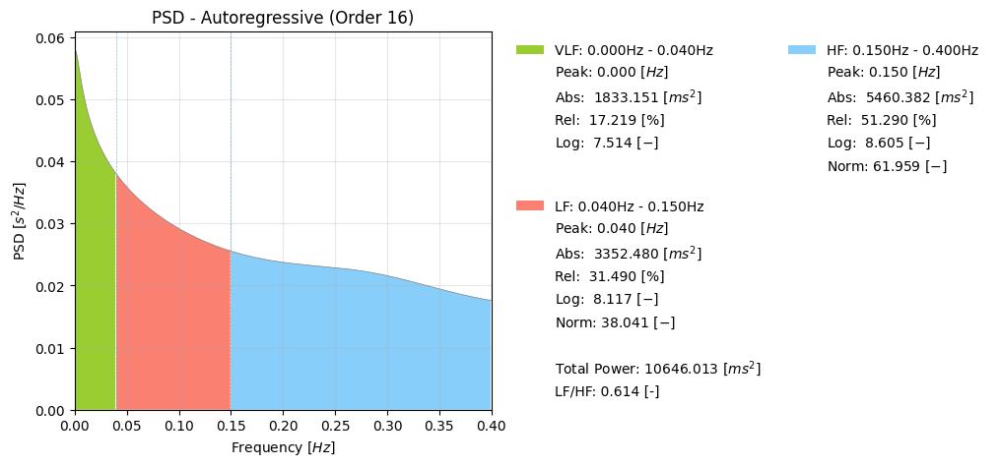

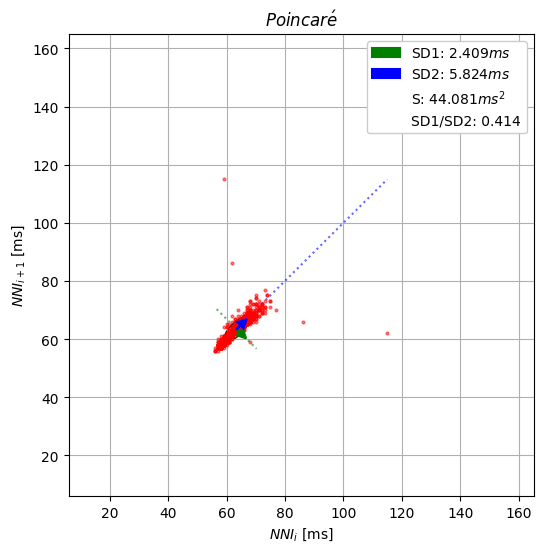

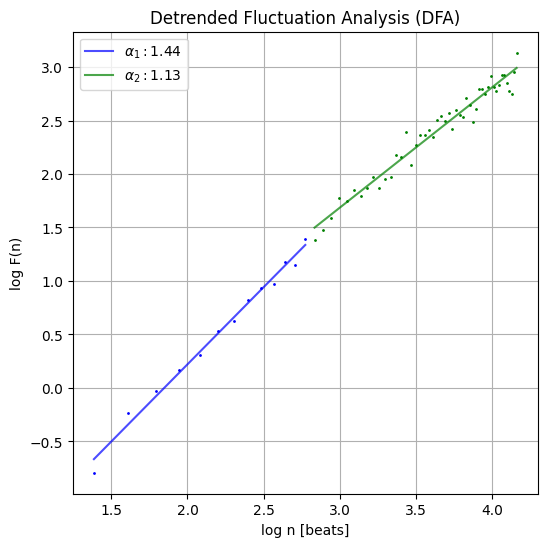

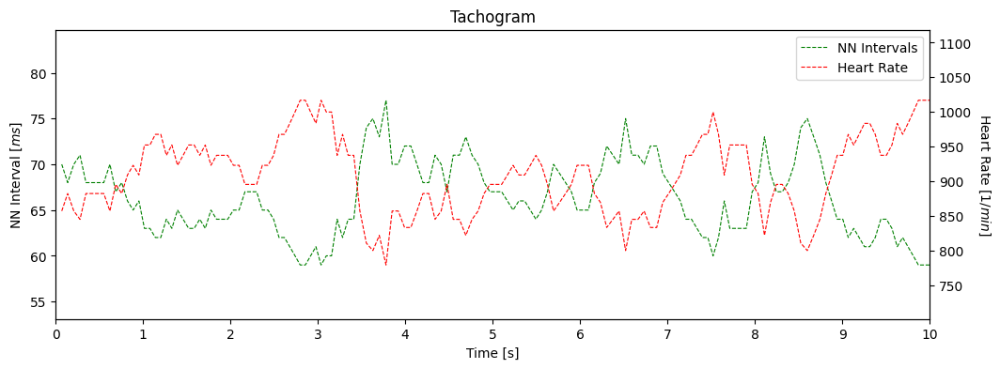

프로토콜: 3.0 MA


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/utils.py:367: UserWarning: Signal duration is to short for segmentation into 300000s. Input data will be returned.
  warnings.warn("Signal duration is to short for segmentation into %is. Input data will be returned." % duration)
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:303: UserWarning: Signal duration too short for SDANN computation.
  warnings.warn("Signal duration too short for SDANN computation.")
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:576: UserWarning: CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a malfunction of the function. This function will be reviewed over the next updates to solve this issue
  warnings.warn('CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a '


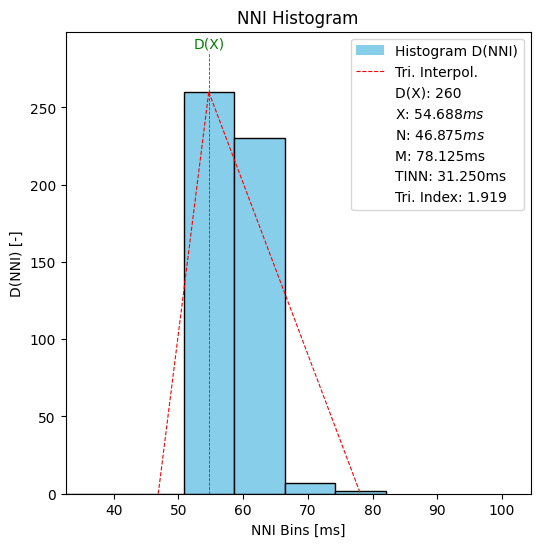

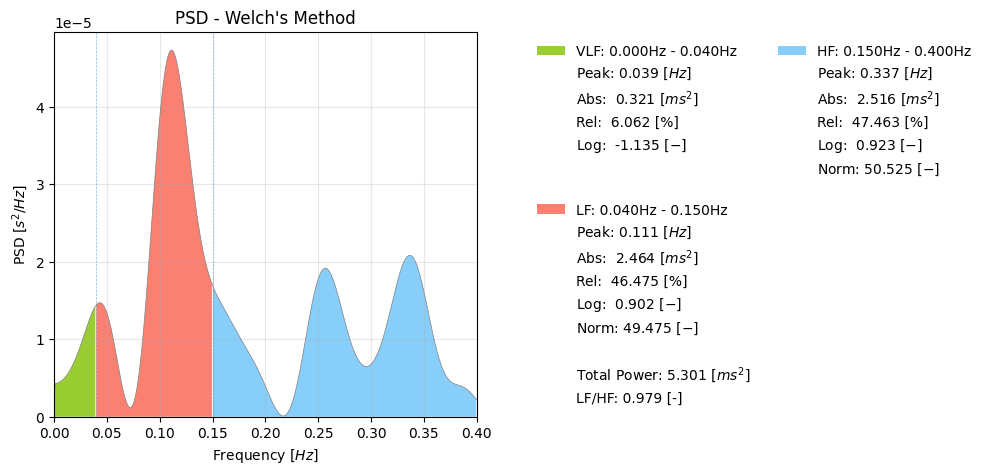

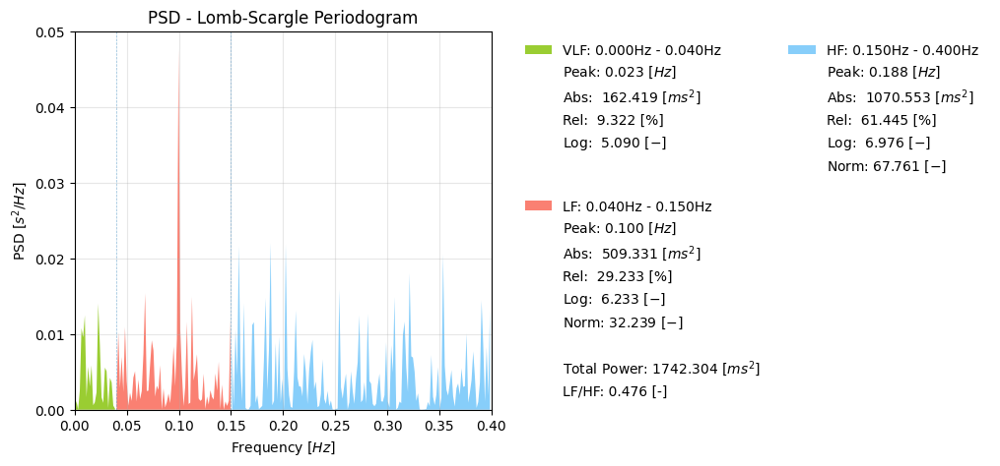

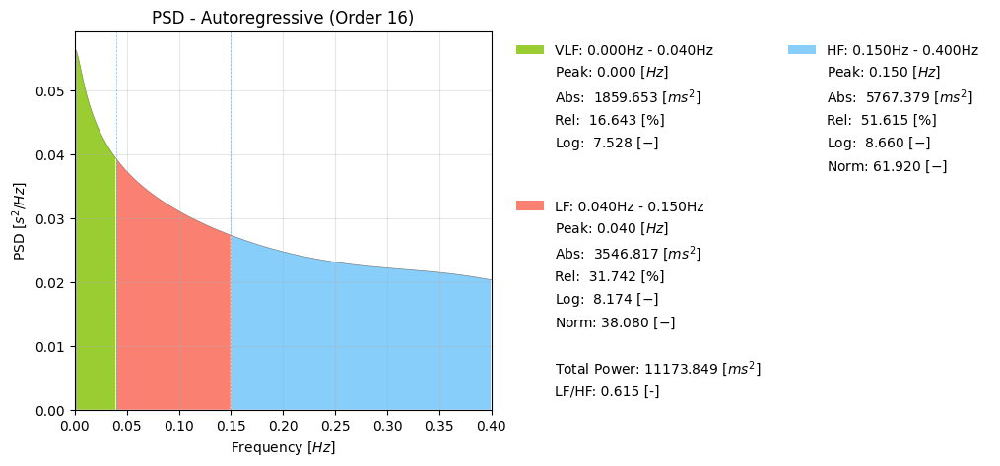

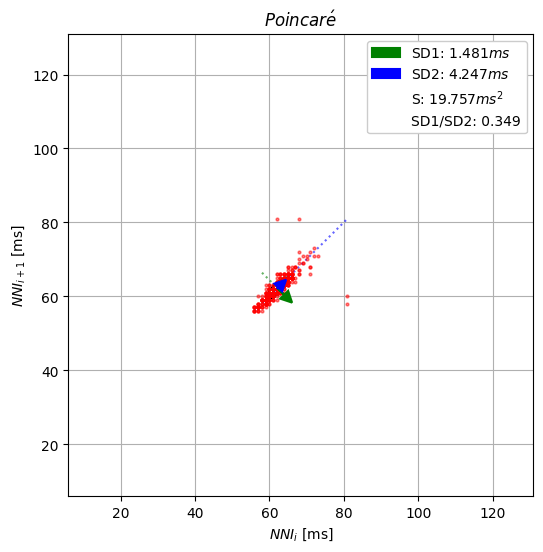

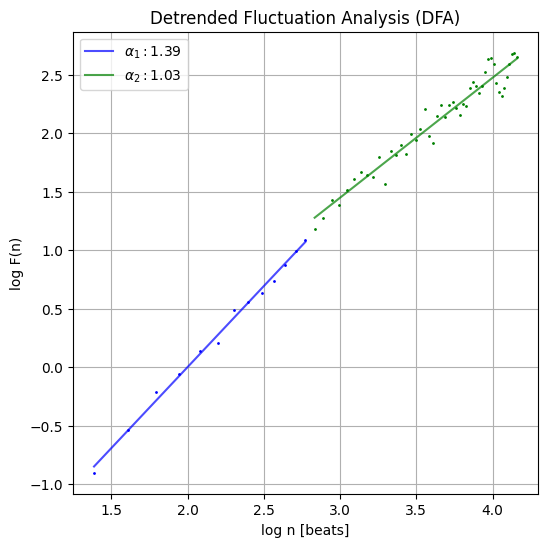

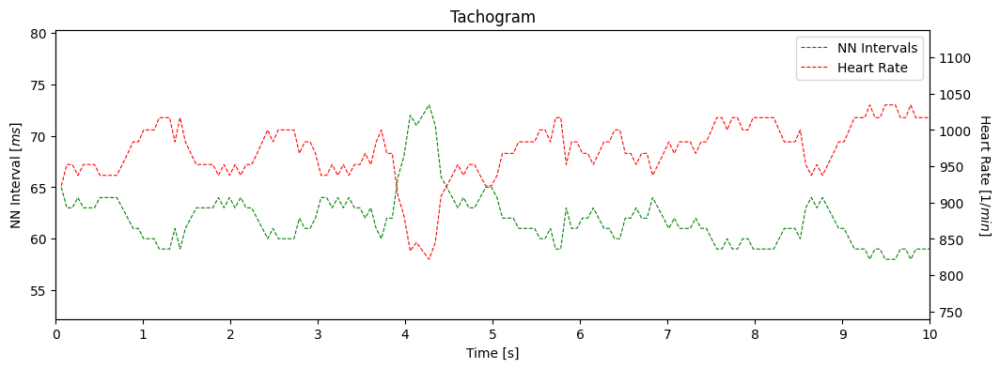

(M)008_20230507_113824_H10.csv
Value is nan
프로토콜: 1.0 BASELINE


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/utils.py:367: UserWarning: Signal duration is to short for segmentation into 300000s. Input data will be returned.
  warnings.warn("Signal duration is to short for segmentation into %is. Input data will be returned." % duration)
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:303: UserWarning: Signal duration too short for SDANN computation.
  warnings.warn("Signal duration too short for SDANN computation.")
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:576: UserWarning: CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a malfunction of the function. This function will be reviewed over the next updates to solve this issue
  warnings.warn('CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a '


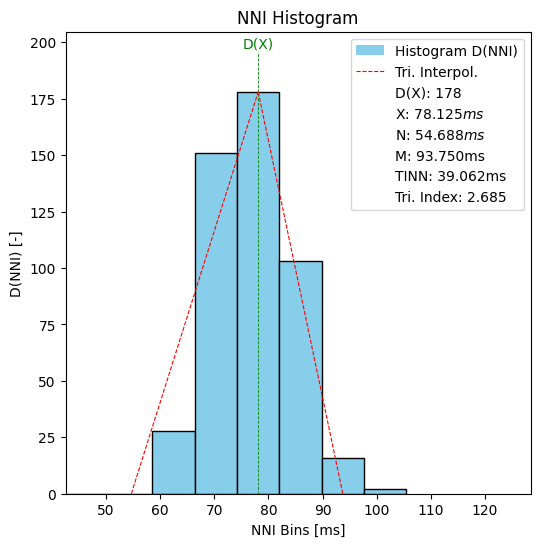

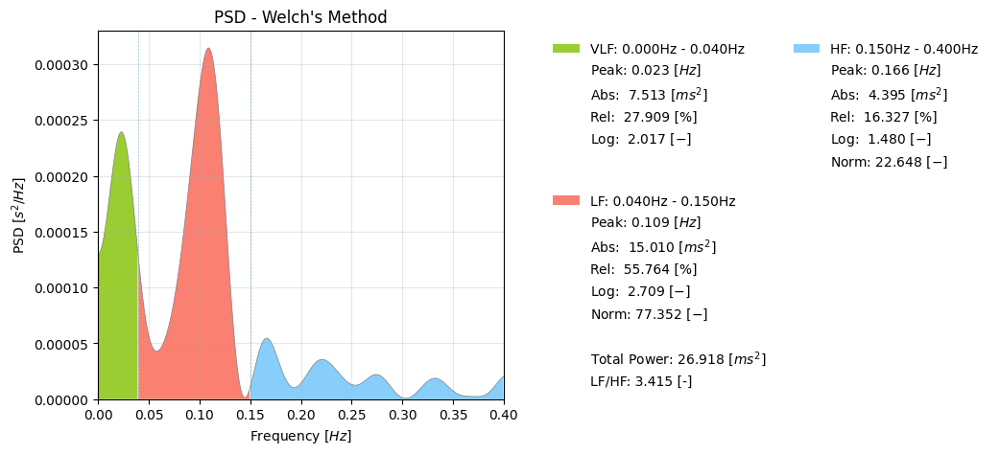

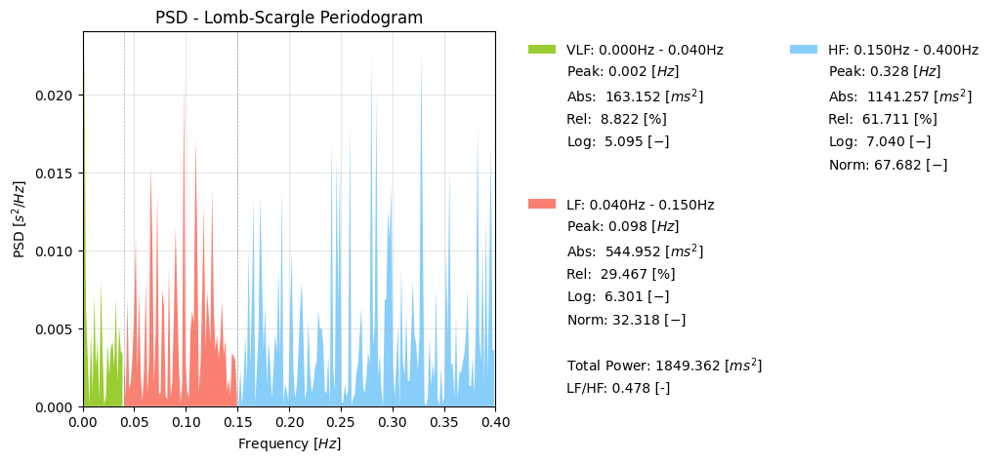

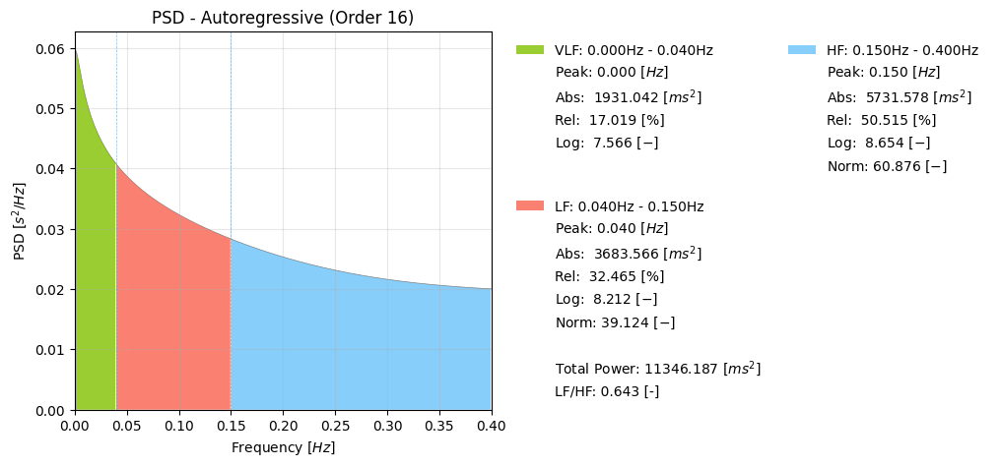

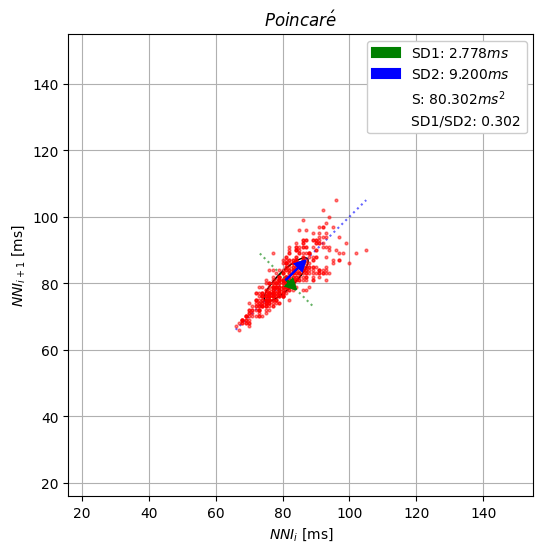

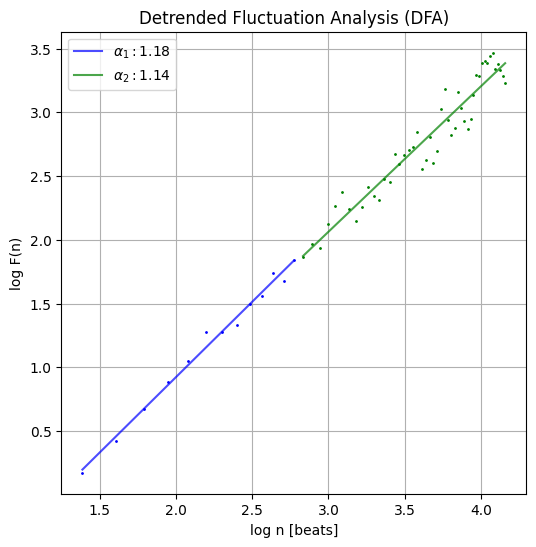

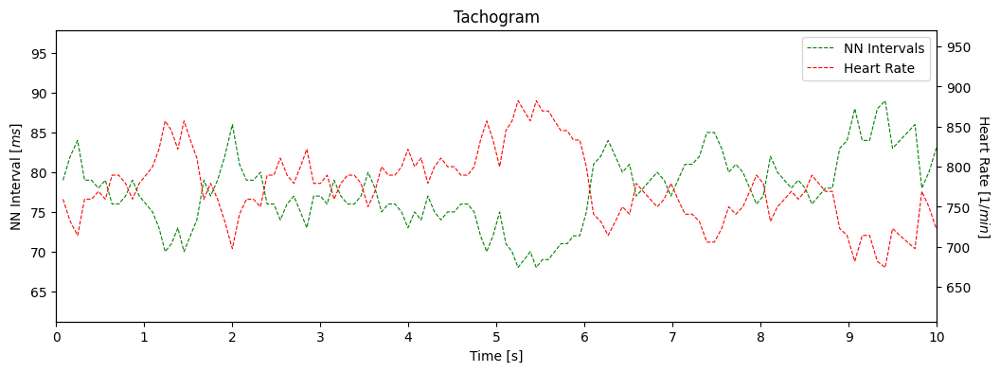

프로토콜: 2.0 HIT


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/utils.py:367: UserWarning: Signal duration is to short for segmentation into 300000s. Input data will be returned.
  warnings.warn("Signal duration is to short for segmentation into %is. Input data will be returned." % duration)
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:303: UserWarning: Signal duration too short for SDANN computation.
  warnings.warn("Signal duration too short for SDANN computation.")
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:576: UserWarning: CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a malfunction of the function. This function will be reviewed over the next updates to solve this issue
  warnings.warn('CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a '


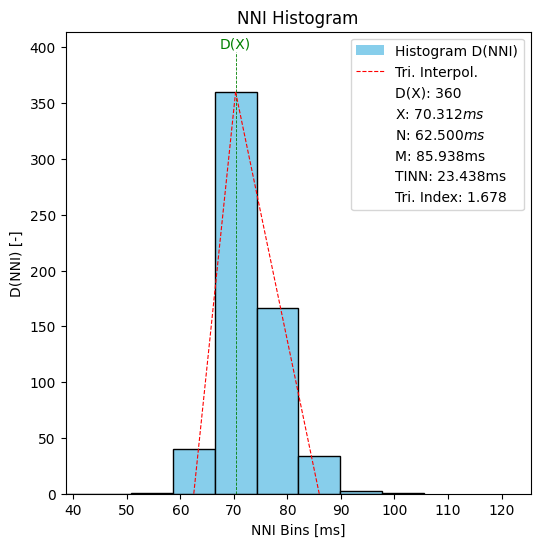

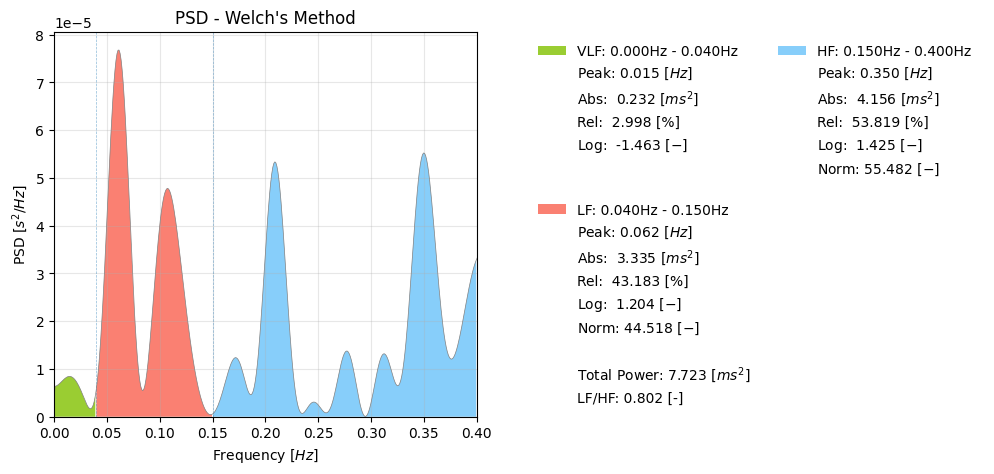

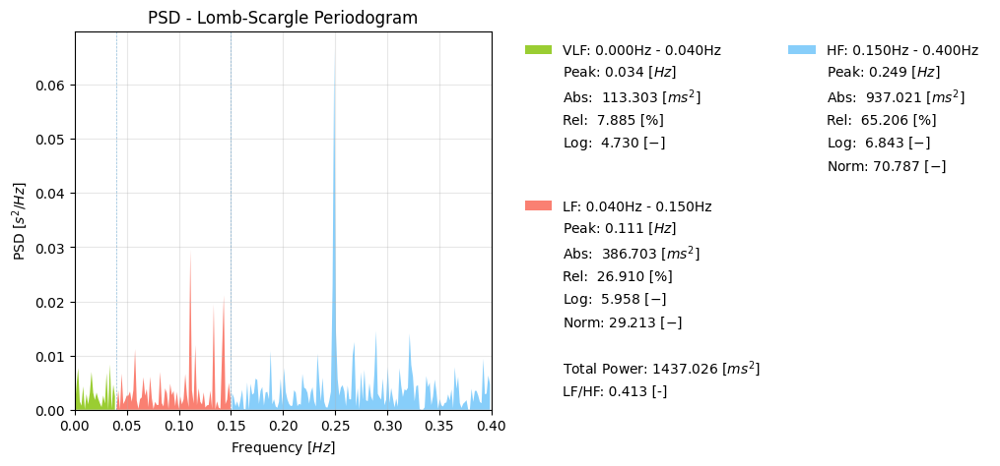

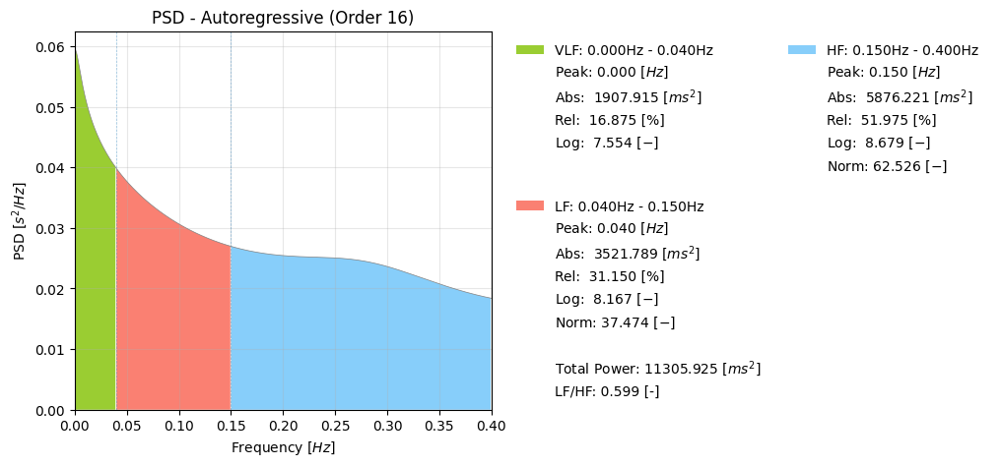

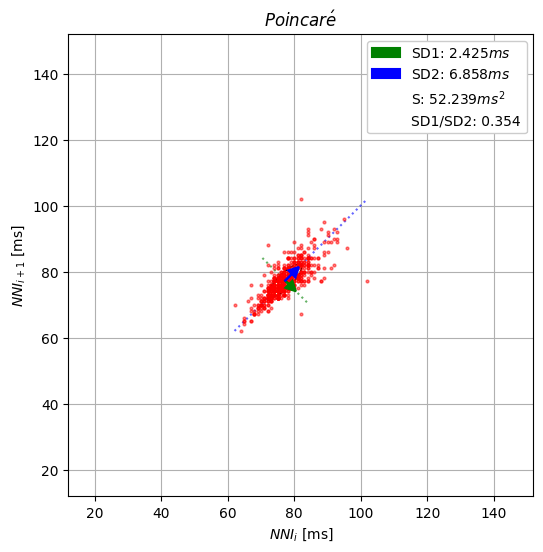

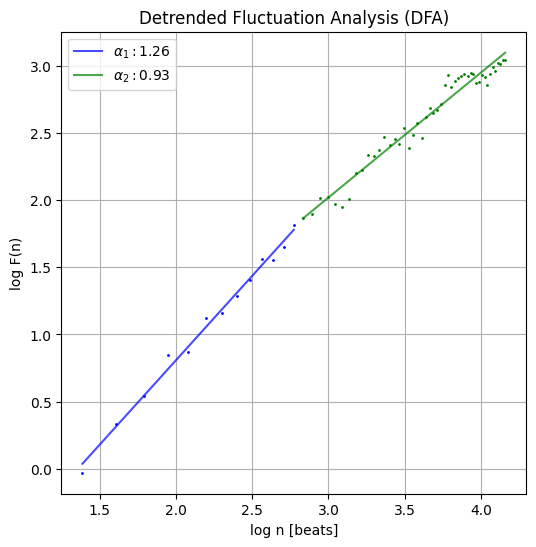

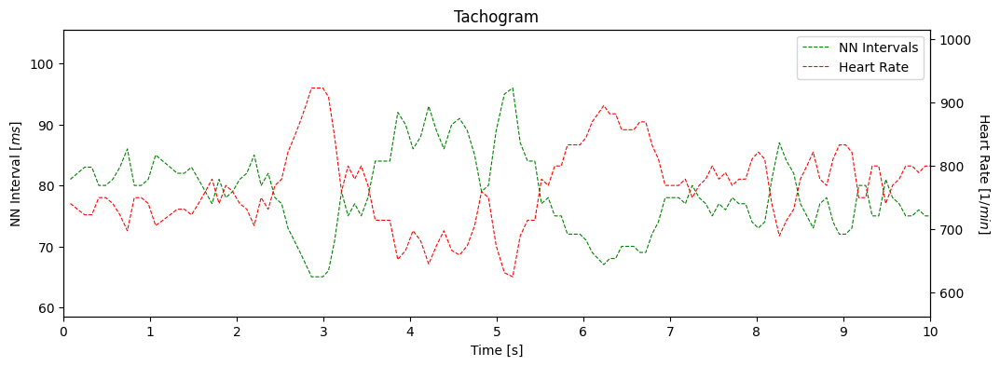

프로토콜: 3.0 MA


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/utils.py:367: UserWarning: Signal duration is to short for segmentation into 300000s. Input data will be returned.
  warnings.warn("Signal duration is to short for segmentation into %is. Input data will be returned." % duration)
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:303: UserWarning: Signal duration too short for SDANN computation.
  warnings.warn("Signal duration too short for SDANN computation.")
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:576: UserWarning: CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a malfunction of the function. This function will be reviewed over the next updates to solve this issue
  warnings.warn('CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a '


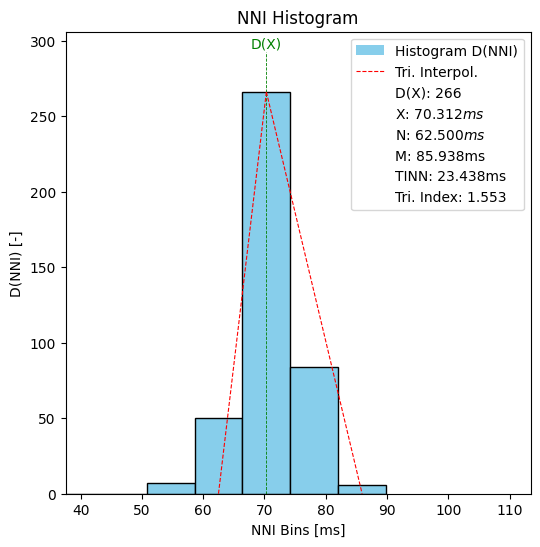

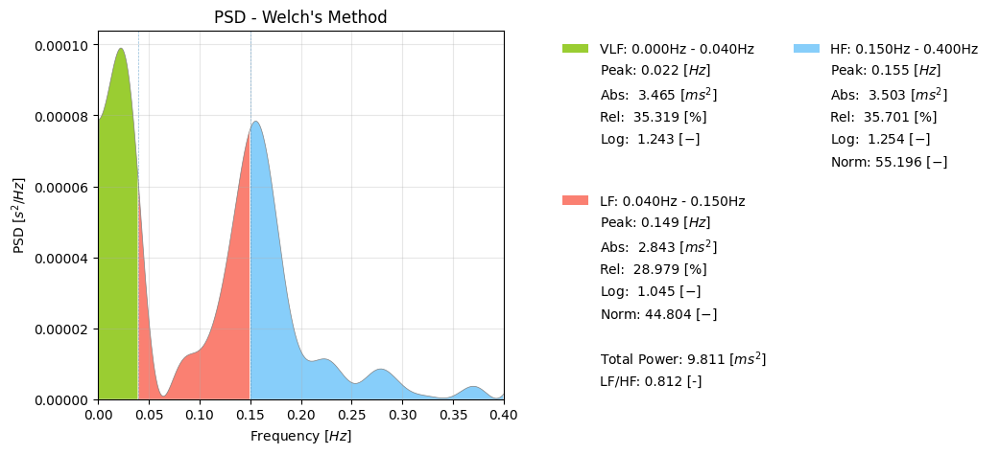

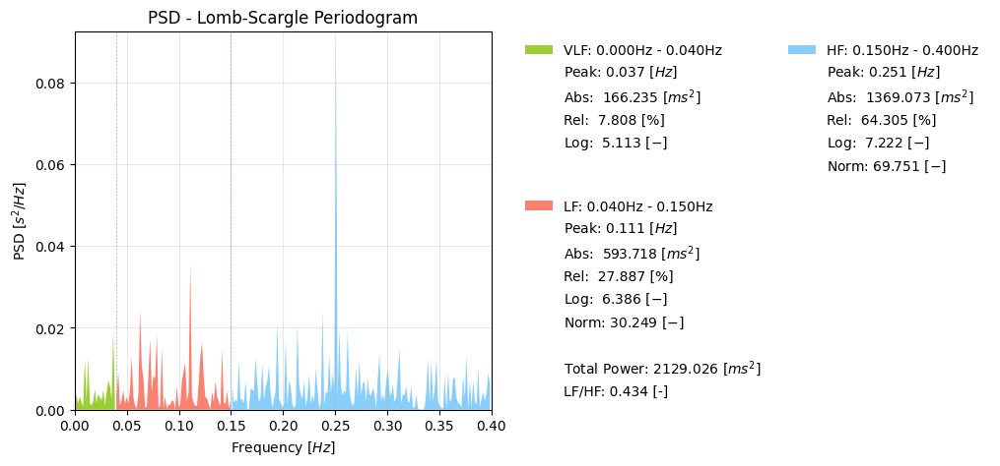

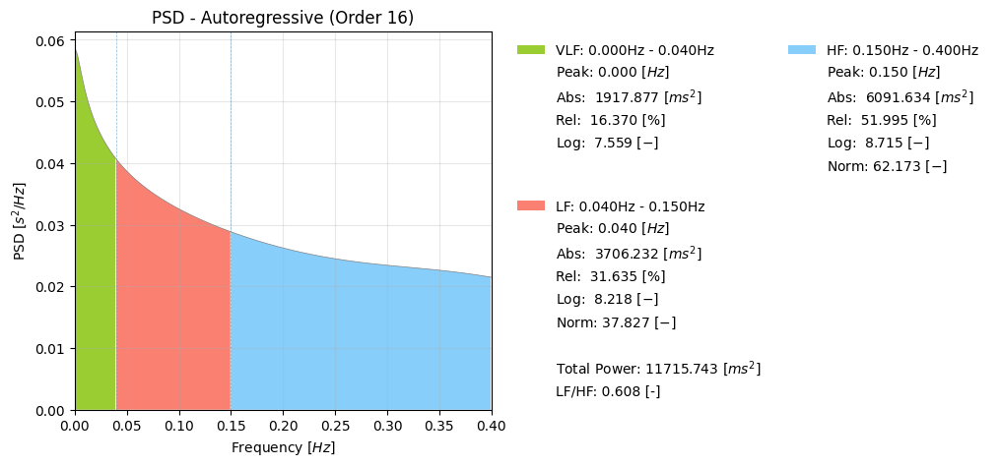

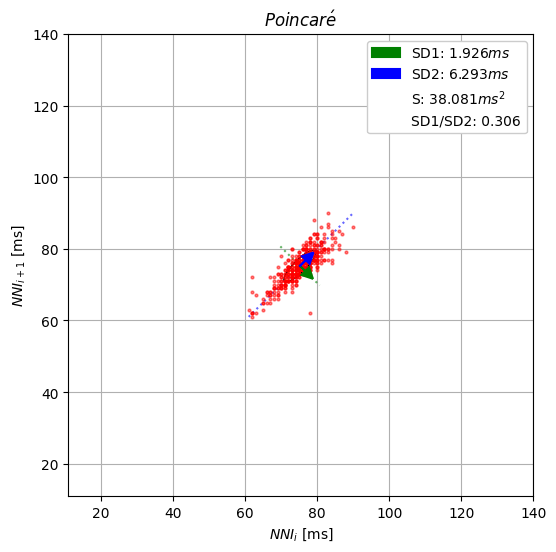

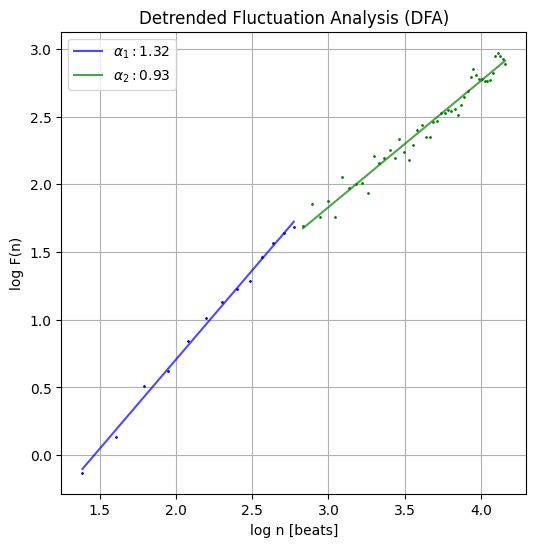

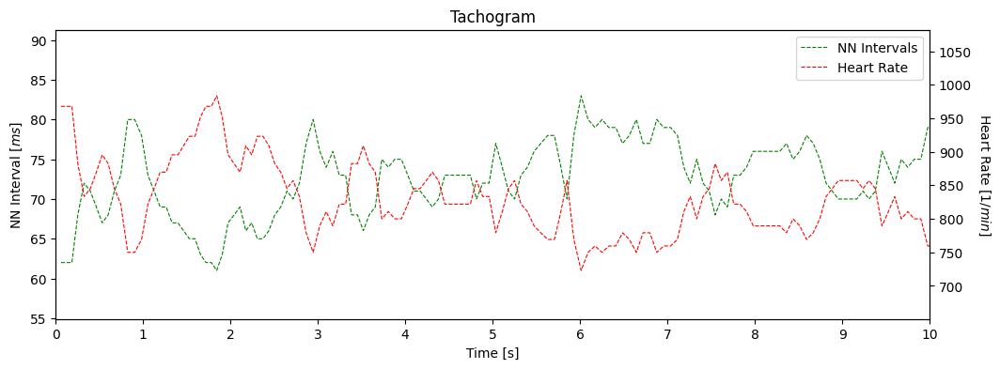

(M)009_20230507_095758_H10.csv
Value is nan
프로토콜: 1.0 BASELINE
 VALUE ERROR
------------------------------
프로토콜: 2.0 HIT


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/utils.py:367: UserWarning: Signal duration is to short for segmentation into 300000s. Input data will be returned.
  warnings.warn("Signal duration is to short for segmentation into %is. Input data will be returned." % duration)
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:303: UserWarning: Signal duration too short for SDANN computation.
  warnings.warn("Signal duration too short for SDANN computation.")
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:576: UserWarning: CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a malfunction of the function. This function will be reviewed over the next updates to solve this issue
  warnings.warn('CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a '


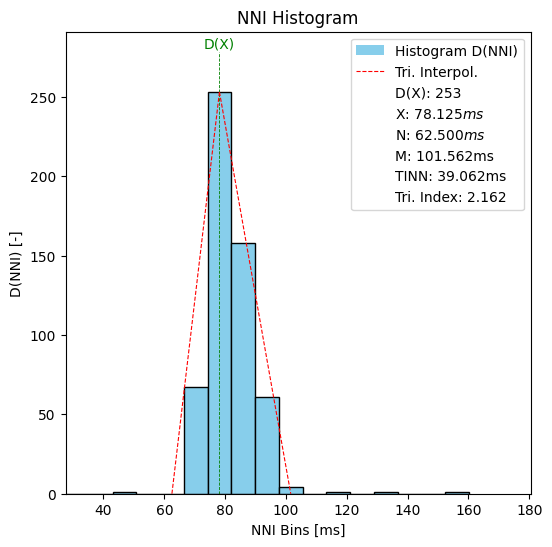

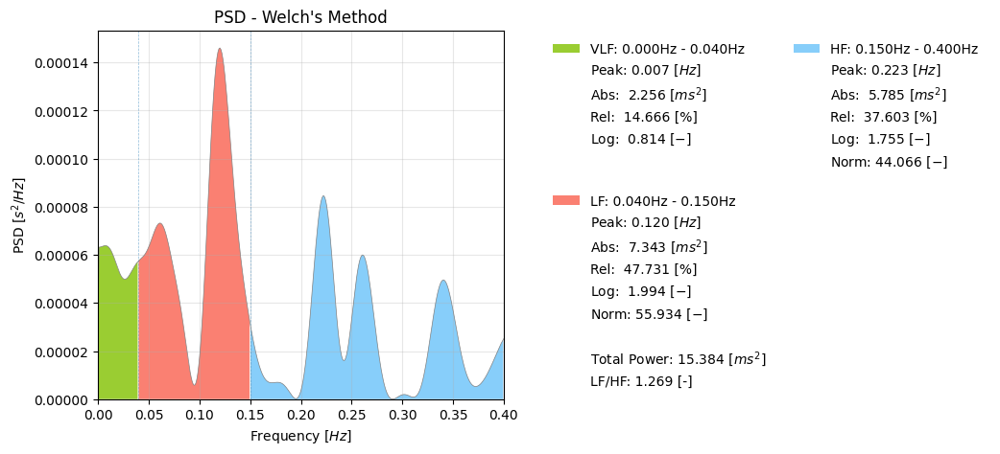

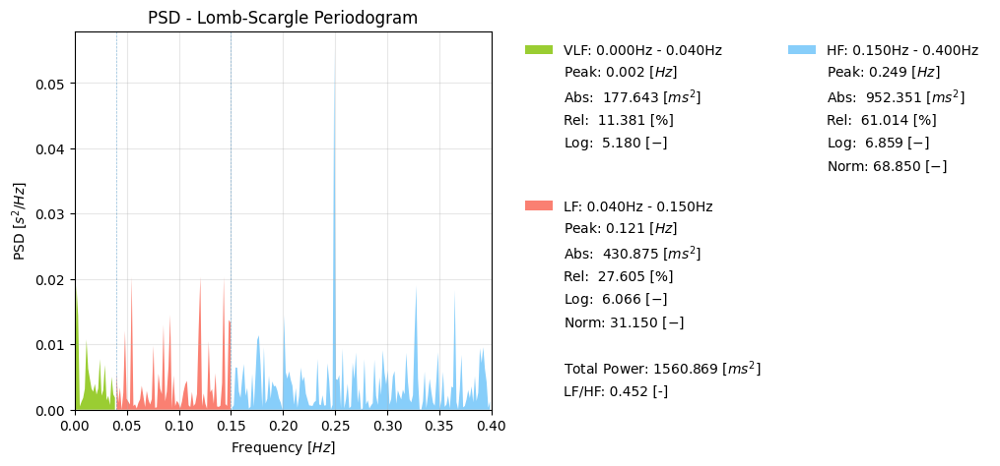

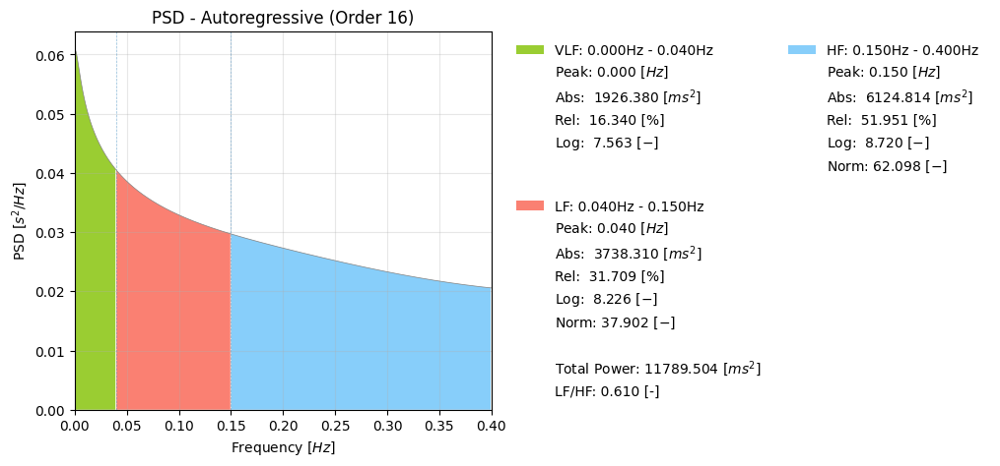

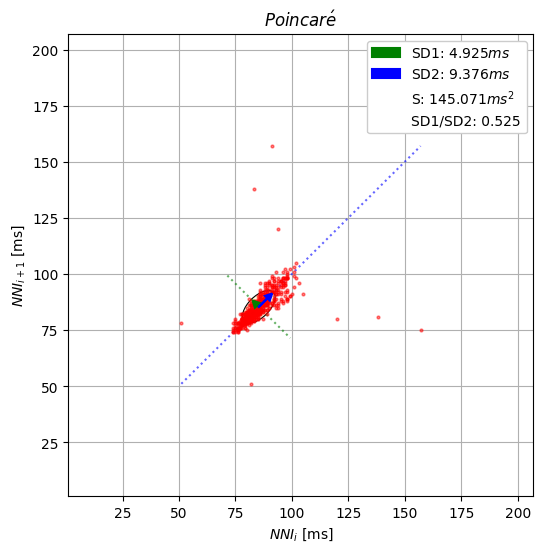

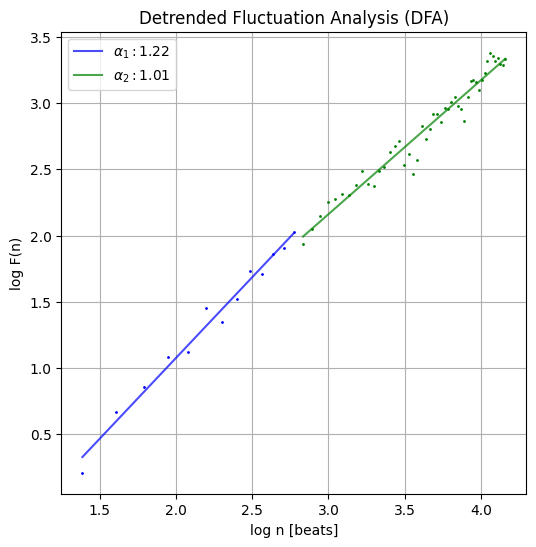

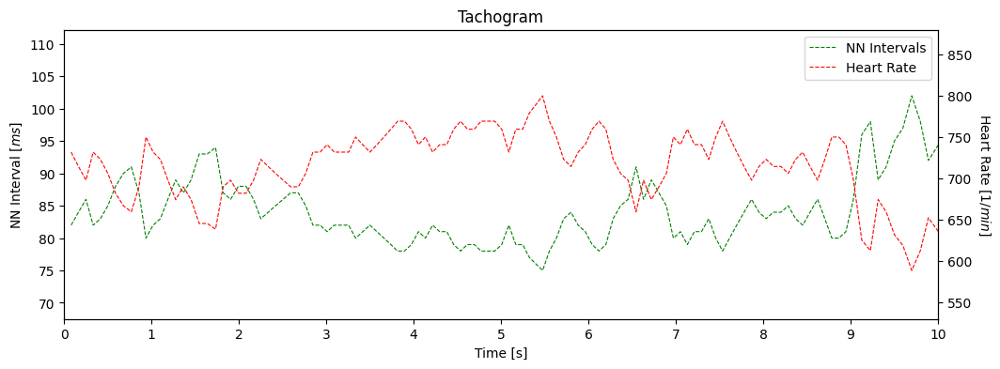

프로토콜: 3.0 MA


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/utils.py:367: UserWarning: Signal duration is to short for segmentation into 300000s. Input data will be returned.
  warnings.warn("Signal duration is to short for segmentation into %is. Input data will be returned." % duration)
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:303: UserWarning: Signal duration too short for SDANN computation.
  warnings.warn("Signal duration too short for SDANN computation.")
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:576: UserWarning: CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a malfunction of the function. This function will be reviewed over the next updates to solve this issue
  warnings.warn('CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a '


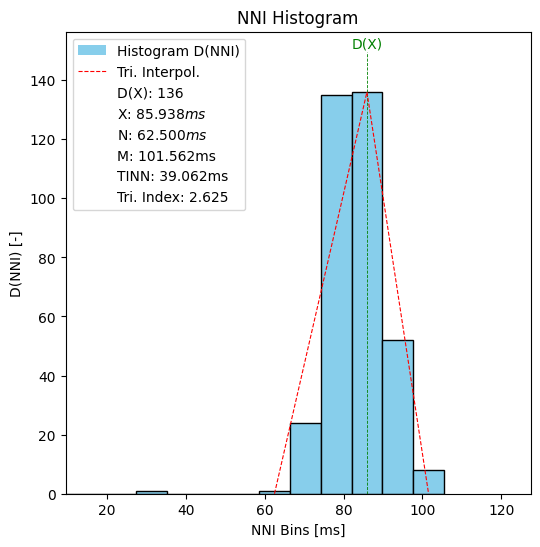

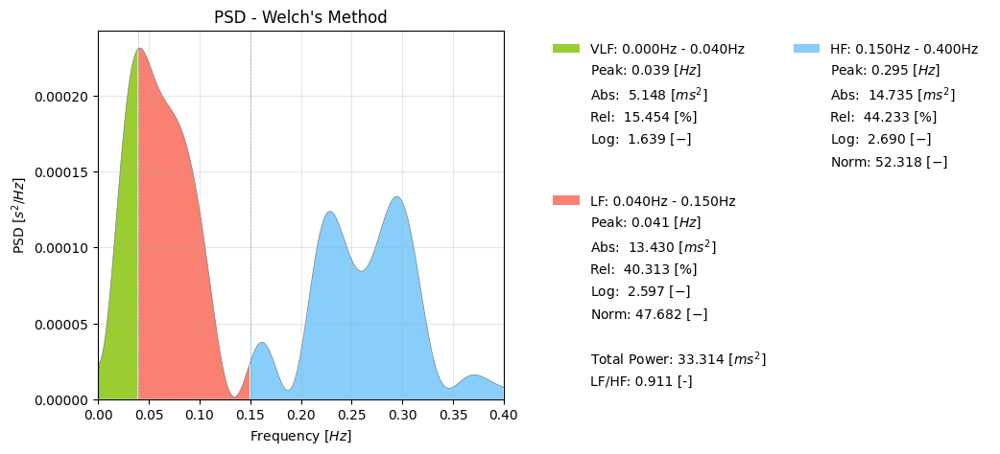

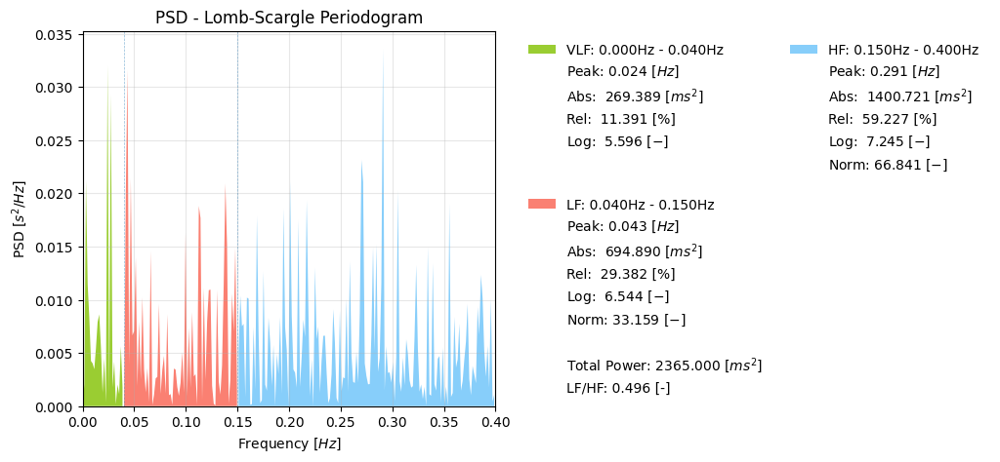

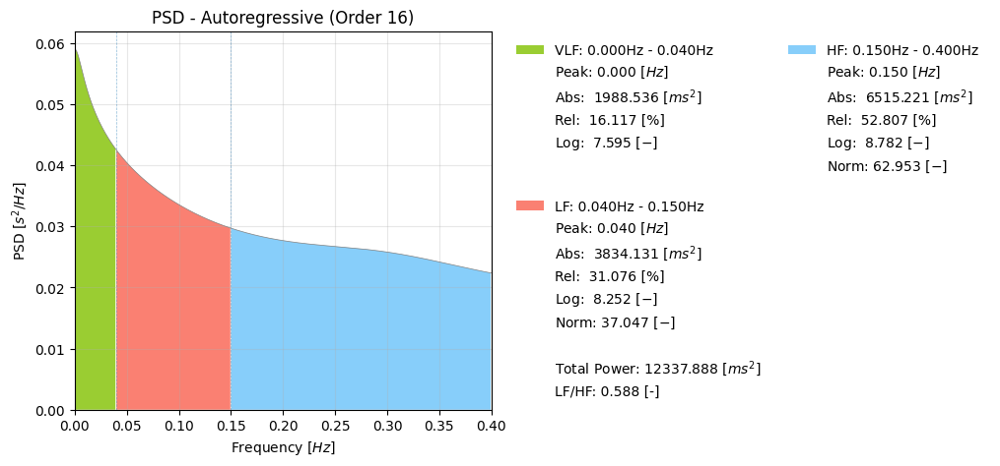

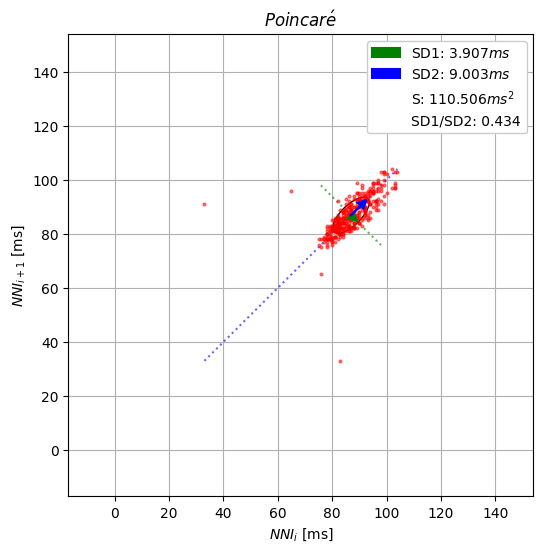

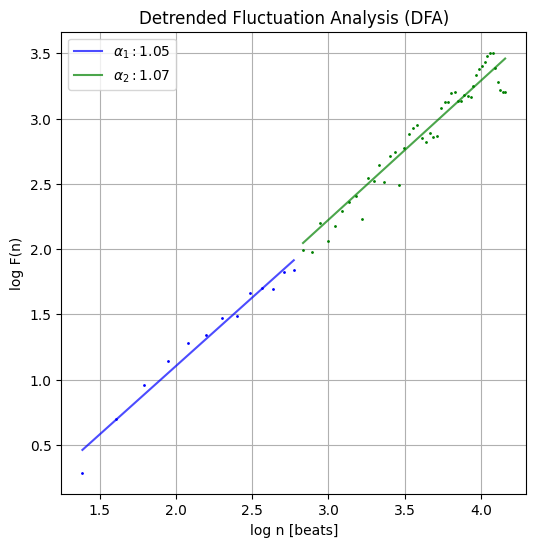

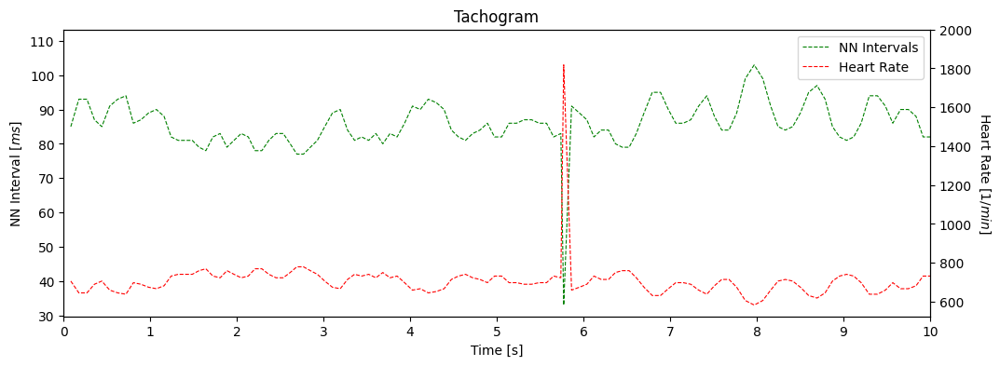

(M)010_20230507_103416_H10.csv
Value is nan
프로토콜: 1.0 BASELINE


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/utils.py:367: UserWarning: Signal duration is to short for segmentation into 300000s. Input data will be returned.
  warnings.warn("Signal duration is to short for segmentation into %is. Input data will be returned." % duration)
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:303: UserWarning: Signal duration too short for SDANN computation.
  warnings.warn("Signal duration too short for SDANN computation.")
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:576: UserWarning: CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a malfunction of the function. This function will be reviewed over the next updates to solve this issue
  warnings.warn('CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a '


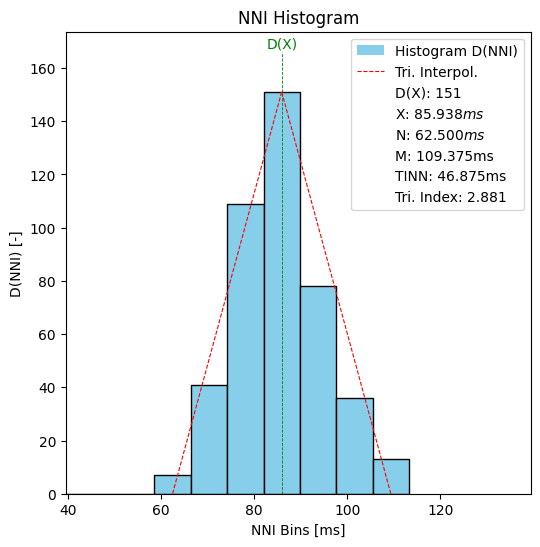

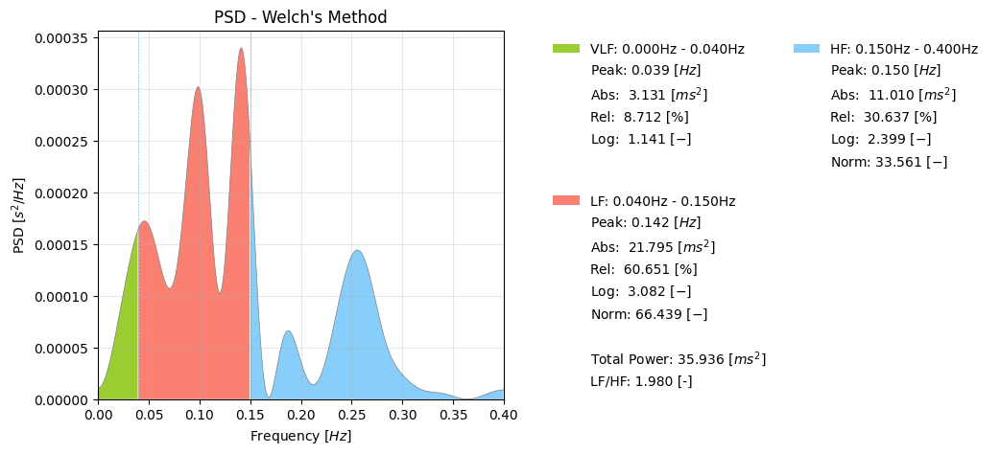

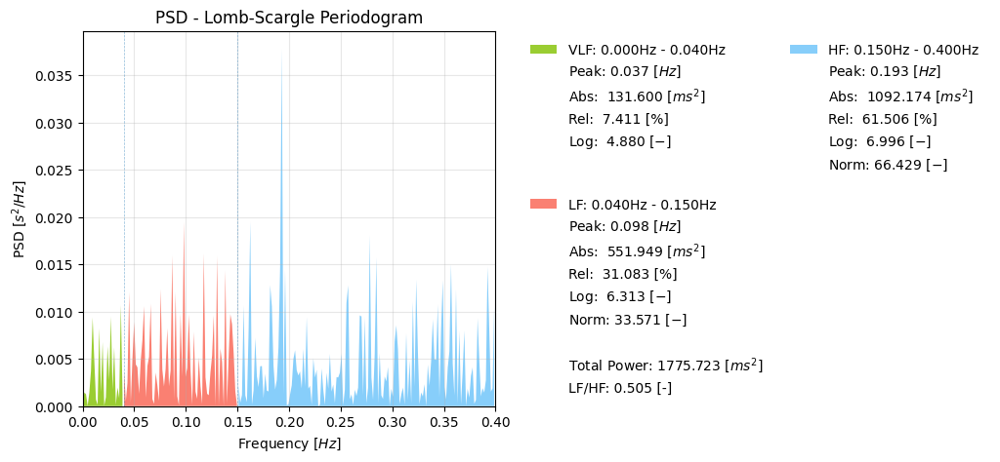

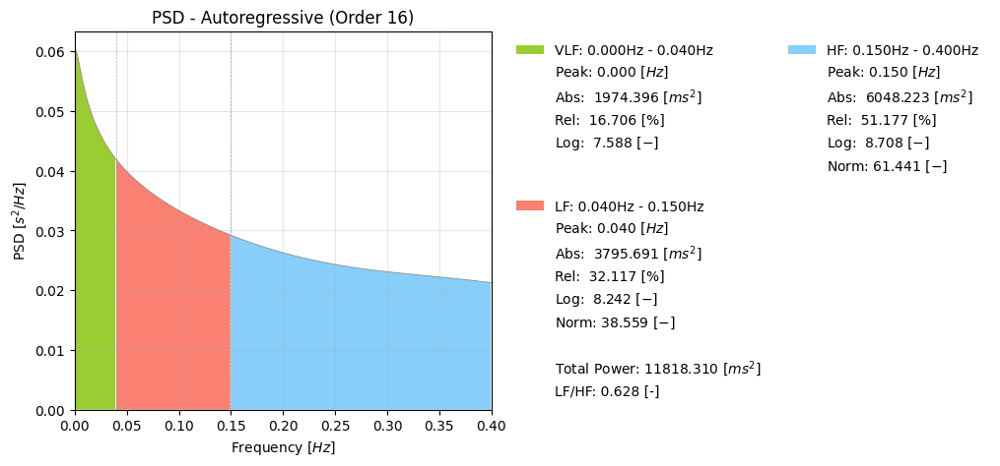

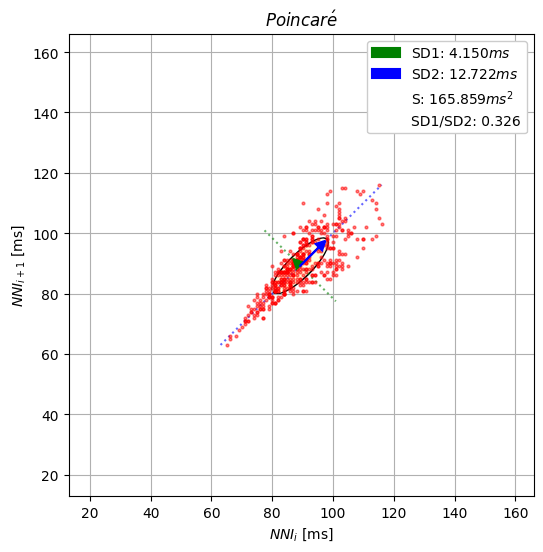

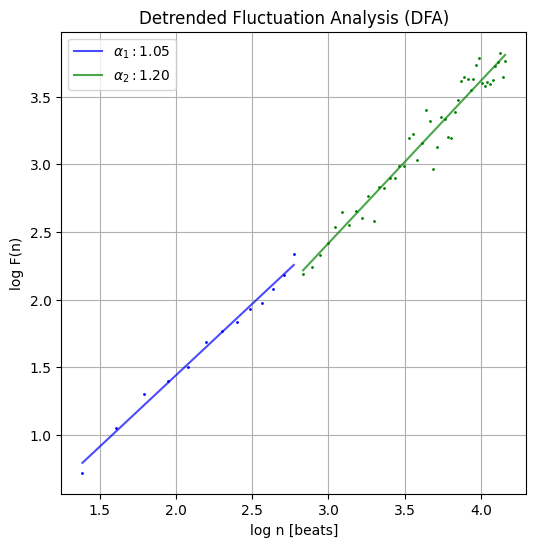

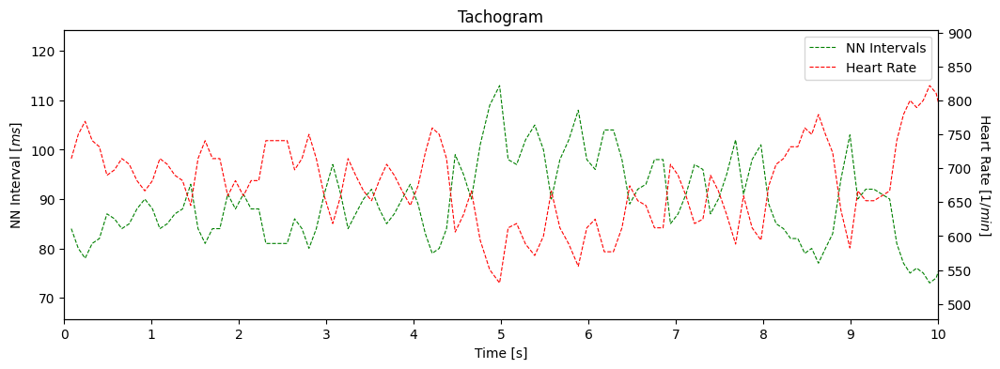

프로토콜: 2.0 HIT


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/utils.py:367: UserWarning: Signal duration is to short for segmentation into 300000s. Input data will be returned.
  warnings.warn("Signal duration is to short for segmentation into %is. Input data will be returned." % duration)
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:303: UserWarning: Signal duration too short for SDANN computation.
  warnings.warn("Signal duration too short for SDANN computation.")
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:576: UserWarning: CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a malfunction of the function. This function will be reviewed over the next updates to solve this issue
  warnings.warn('CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a '


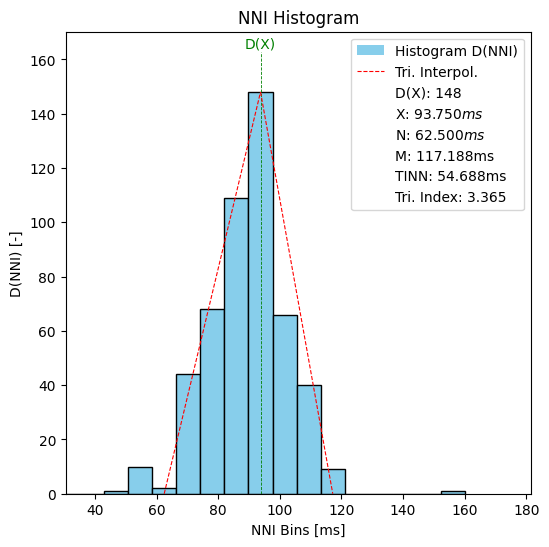

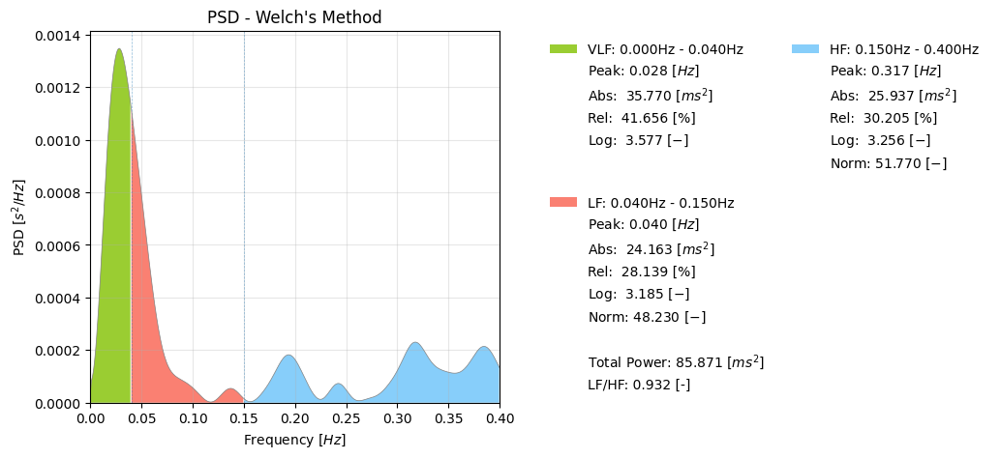

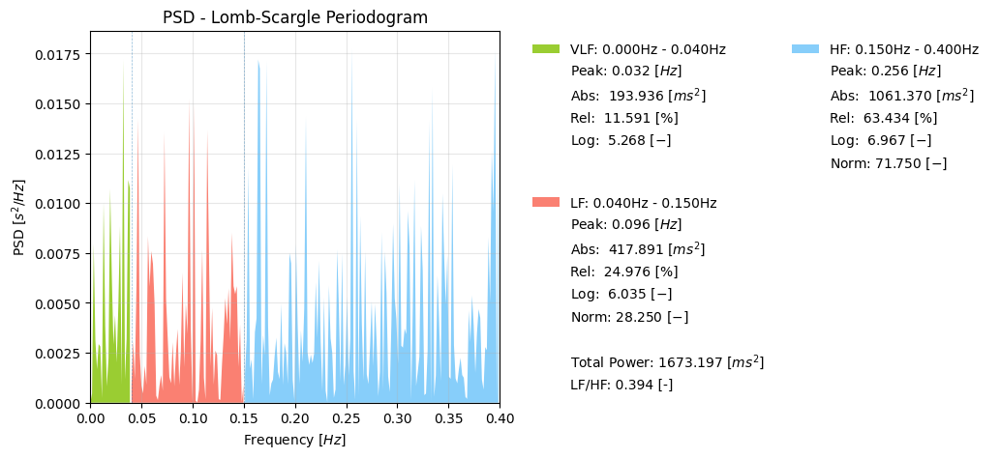

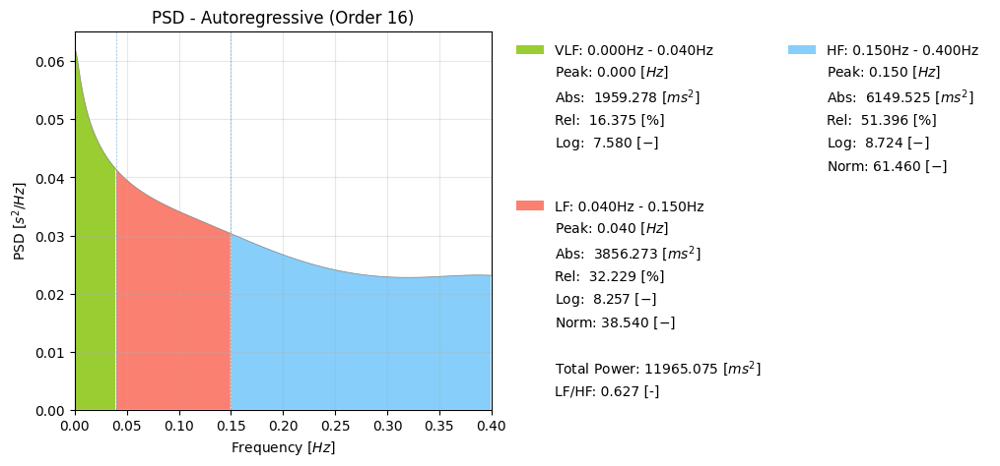

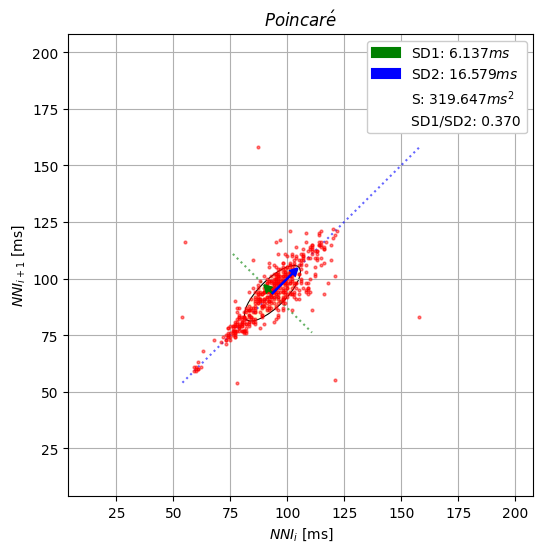

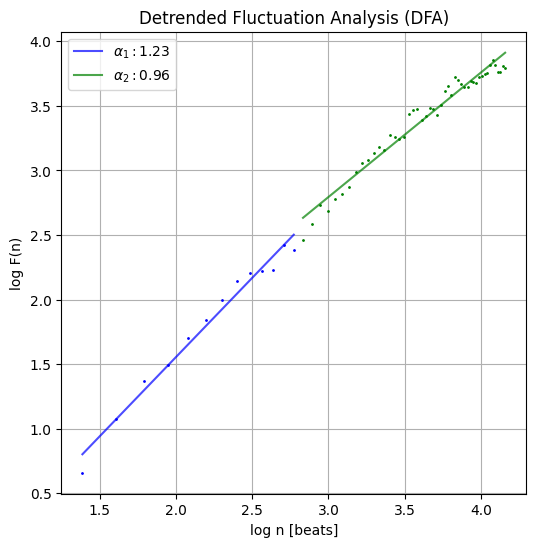

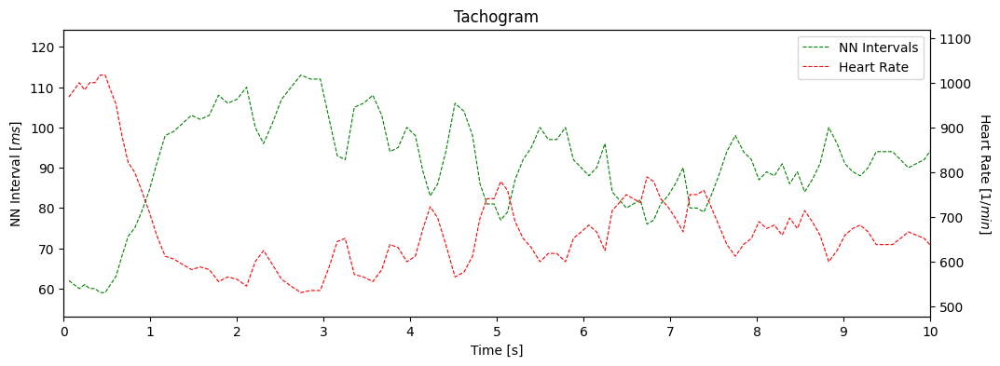

프로토콜: 3.0 MA


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/utils.py:367: UserWarning: Signal duration is to short for segmentation into 300000s. Input data will be returned.
  warnings.warn("Signal duration is to short for segmentation into %is. Input data will be returned." % duration)
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:303: UserWarning: Signal duration too short for SDANN computation.
  warnings.warn("Signal duration too short for SDANN computation.")
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:576: UserWarning: CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a malfunction of the function. This function will be reviewed over the next updates to solve this issue
  warnings.warn('CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a '


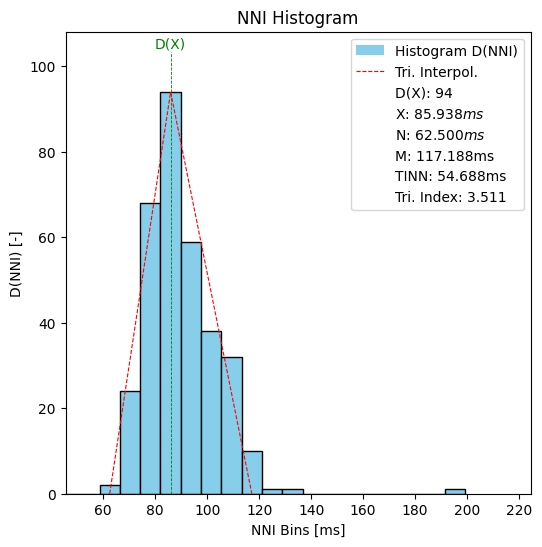

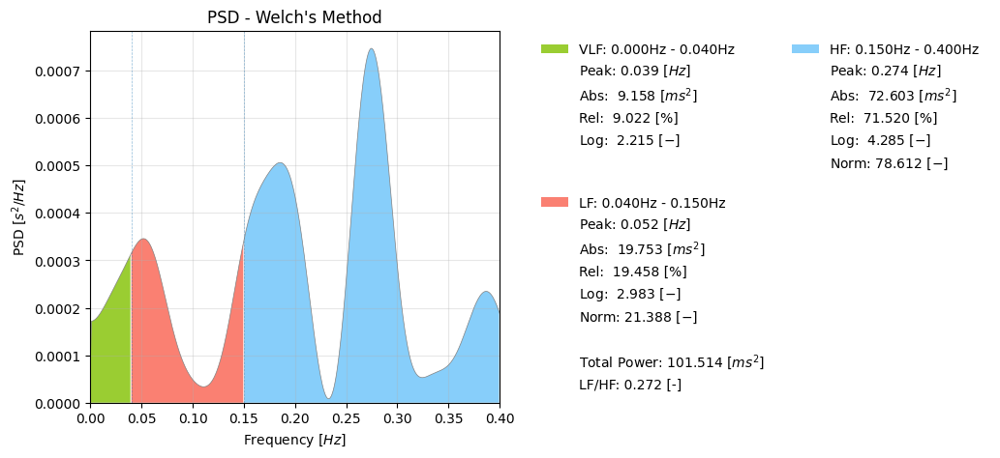

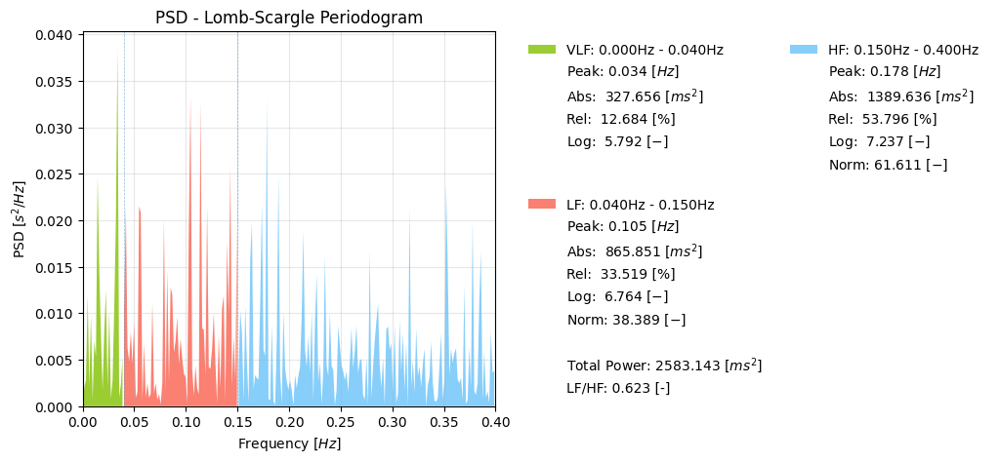

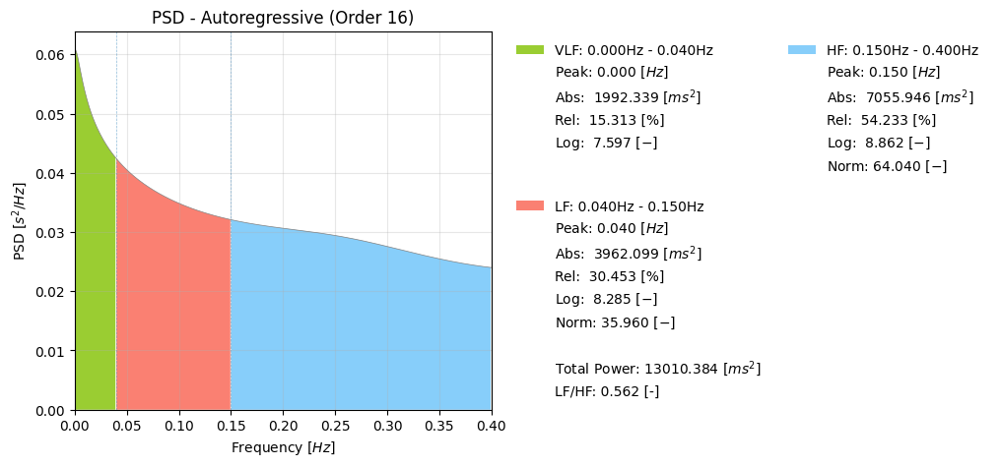

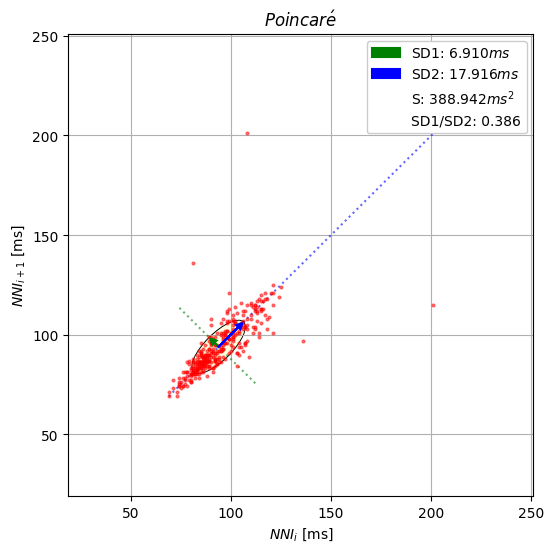

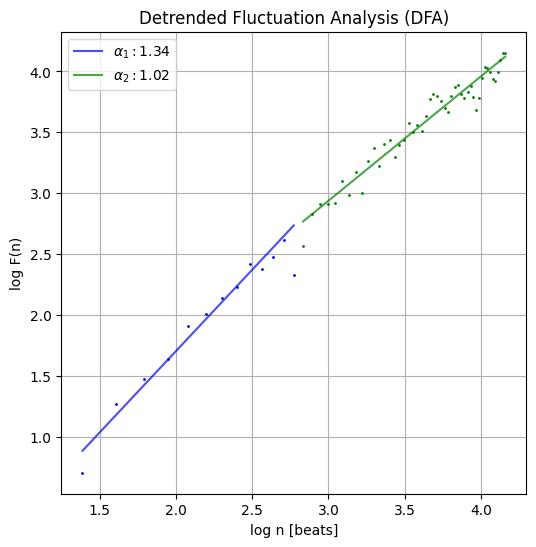

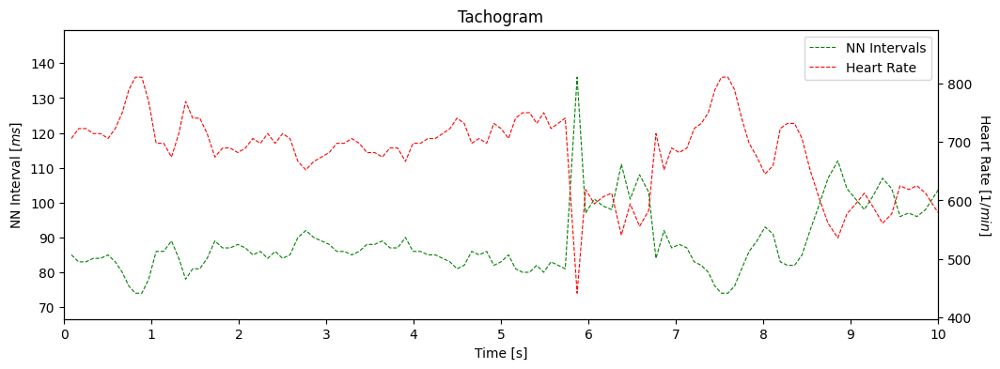

(M)011_20230507_120541_H10.csv
Value is nan
프로토콜: 1.0 BASELINE


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/utils.py:367: UserWarning: Signal duration is to short for segmentation into 300000s. Input data will be returned.
  warnings.warn("Signal duration is to short for segmentation into %is. Input data will be returned." % duration)
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:303: UserWarning: Signal duration too short for SDANN computation.
  warnings.warn("Signal duration too short for SDANN computation.")
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:576: UserWarning: CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a malfunction of the function. This function will be reviewed over the next updates to solve this issue
  warnings.warn('CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a '


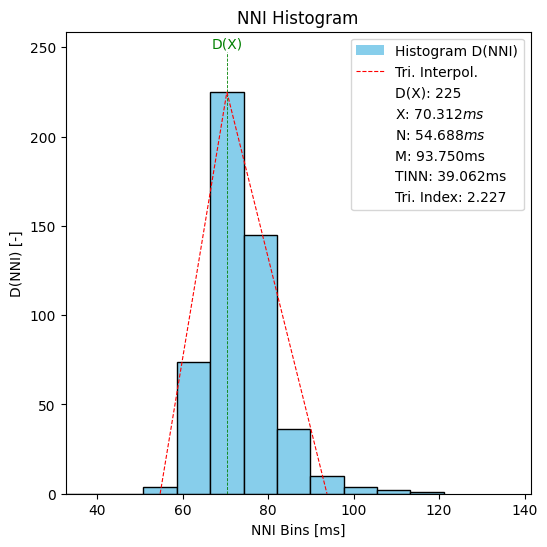

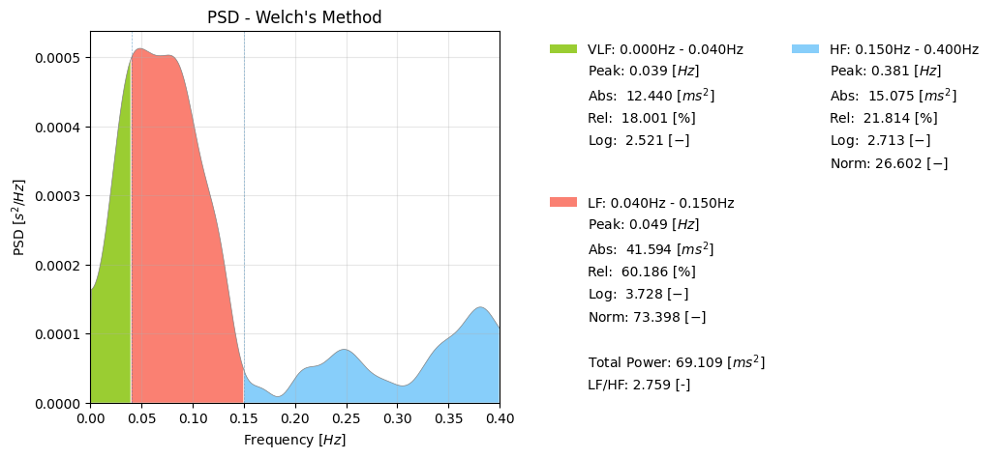

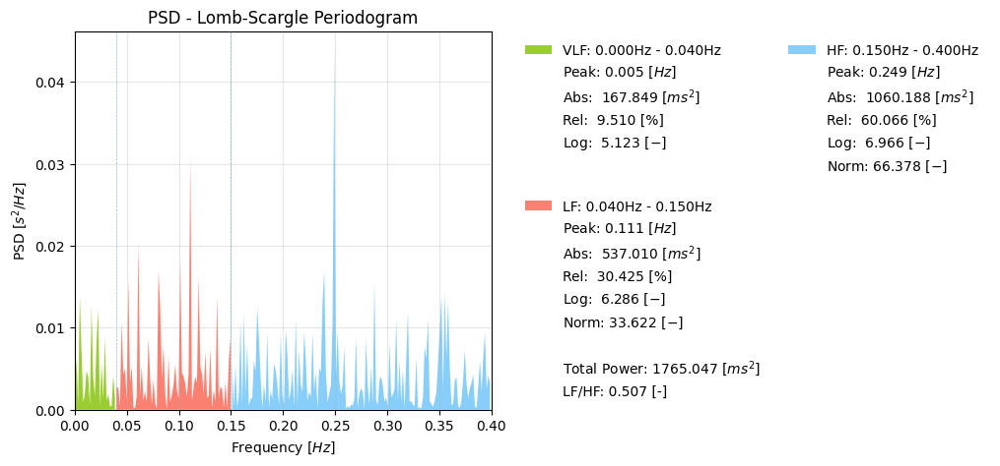

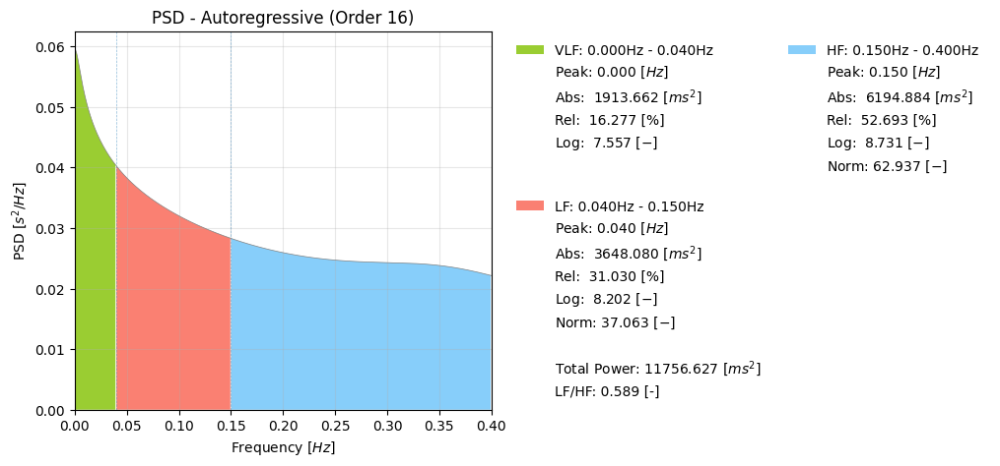

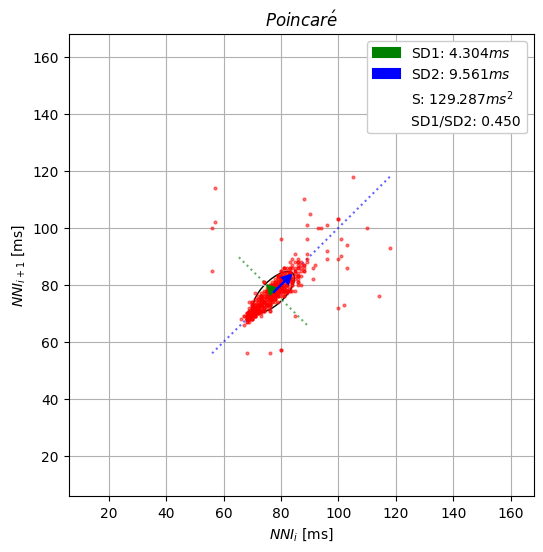

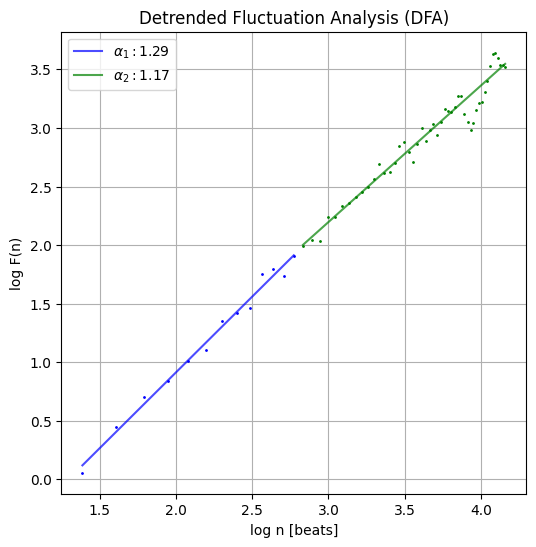

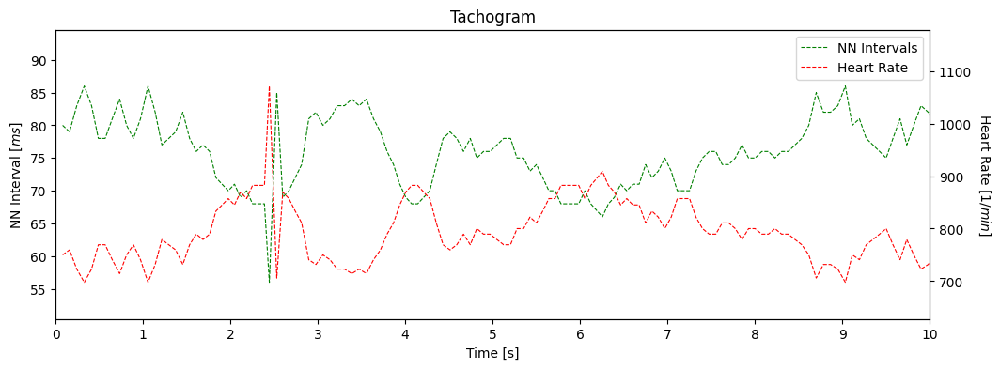

프로토콜: 2.0 HIT


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/utils.py:367: UserWarning: Signal duration is to short for segmentation into 300000s. Input data will be returned.
  warnings.warn("Signal duration is to short for segmentation into %is. Input data will be returned." % duration)
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:303: UserWarning: Signal duration too short for SDANN computation.
  warnings.warn("Signal duration too short for SDANN computation.")
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:576: UserWarning: CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a malfunction of the function. This function will be reviewed over the next updates to solve this issue
  warnings.warn('CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a '


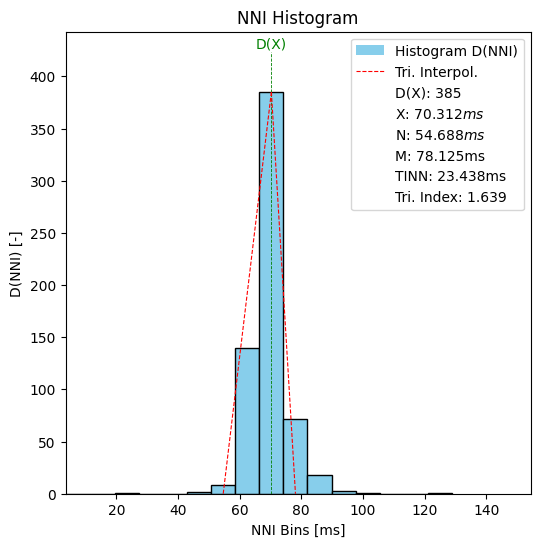

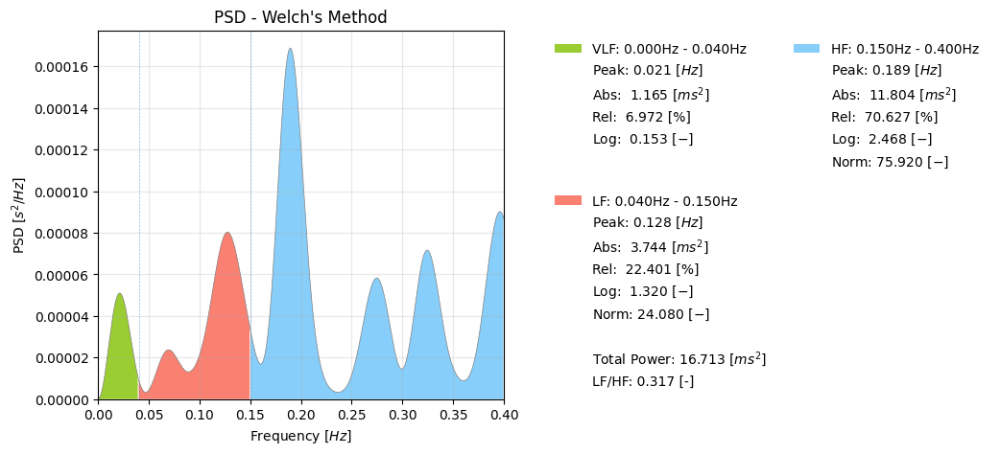

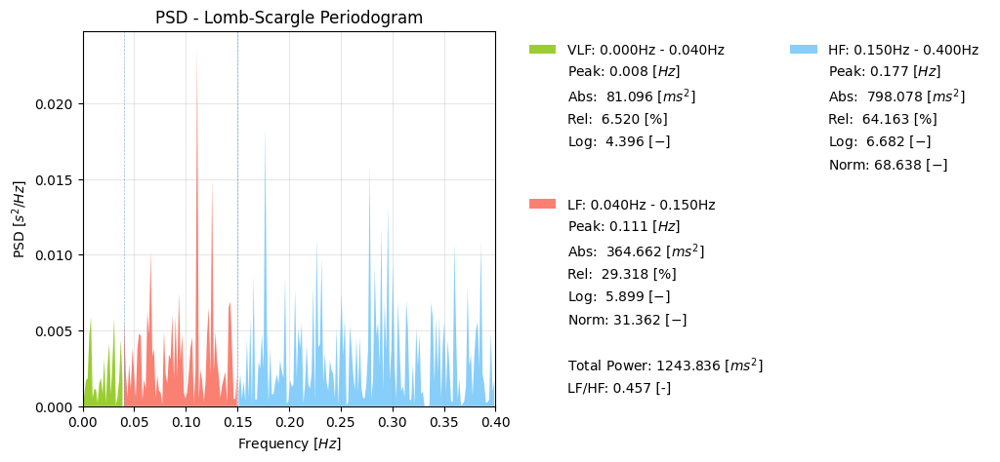

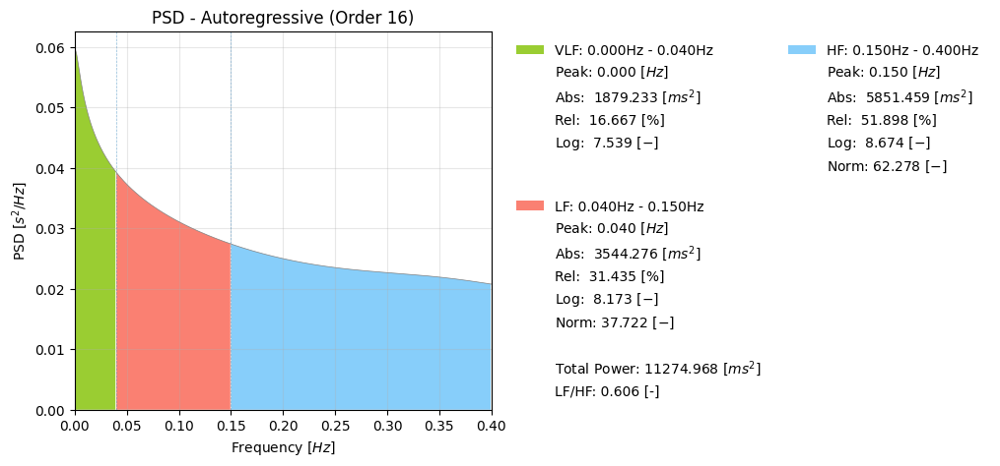

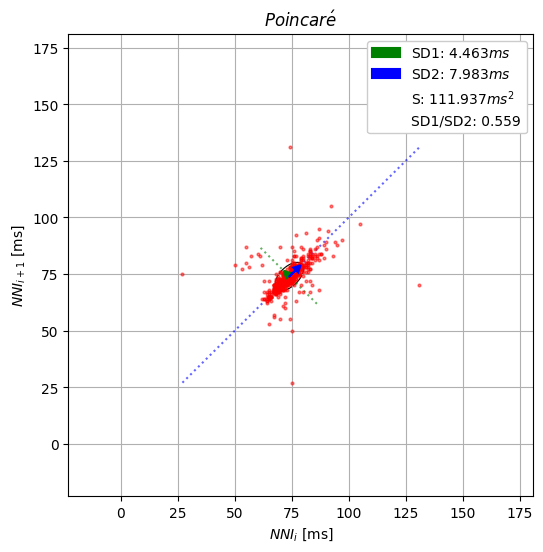

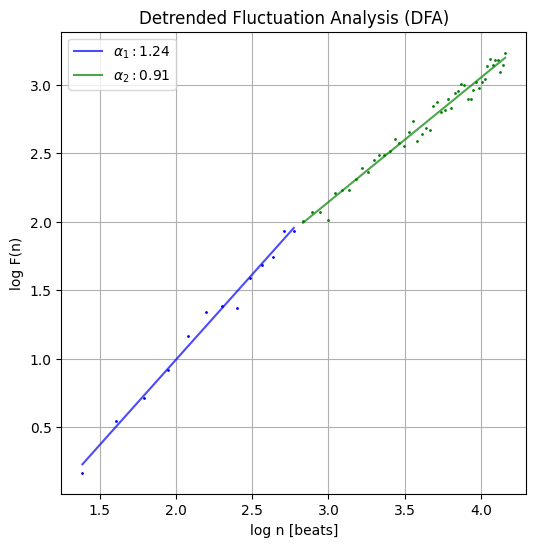

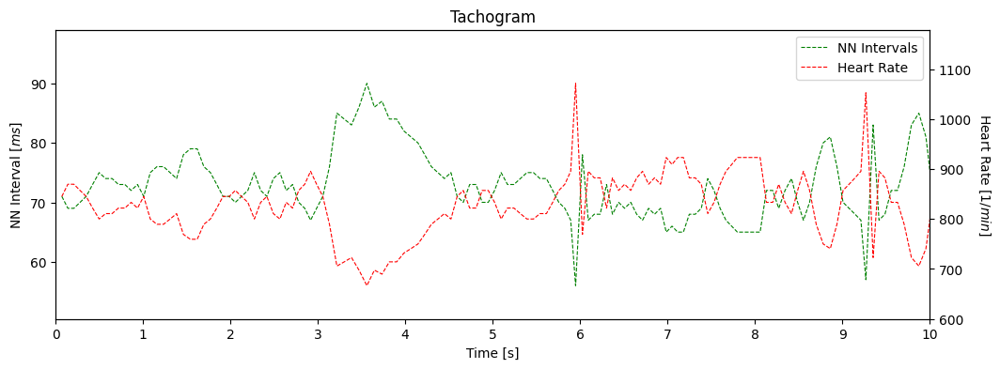

프로토콜: 3.0 MA


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/utils.py:367: UserWarning: Signal duration is to short for segmentation into 300000s. Input data will be returned.
  warnings.warn("Signal duration is to short for segmentation into %is. Input data will be returned." % duration)
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:303: UserWarning: Signal duration too short for SDANN computation.
  warnings.warn("Signal duration too short for SDANN computation.")
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:576: UserWarning: CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a malfunction of the function. This function will be reviewed over the next updates to solve this issue
  warnings.warn('CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a '


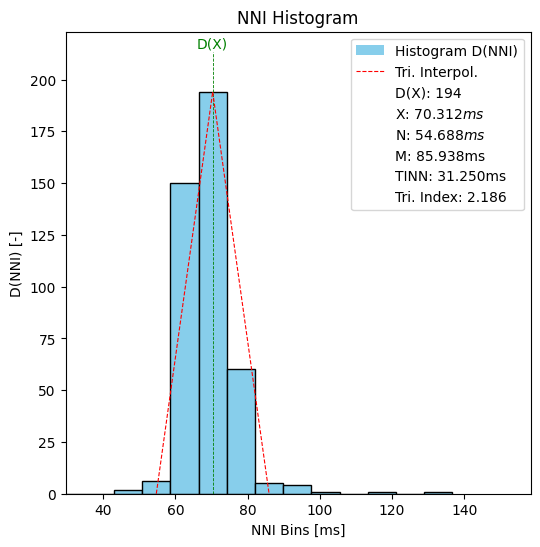

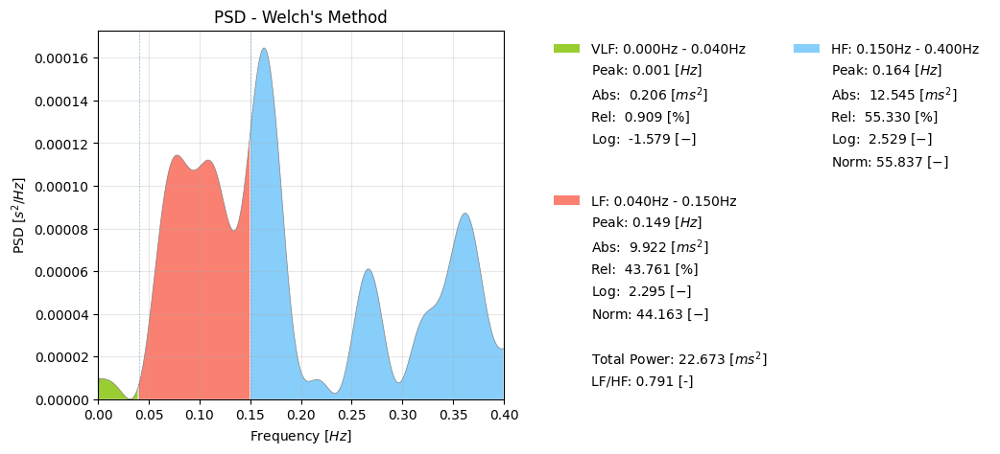

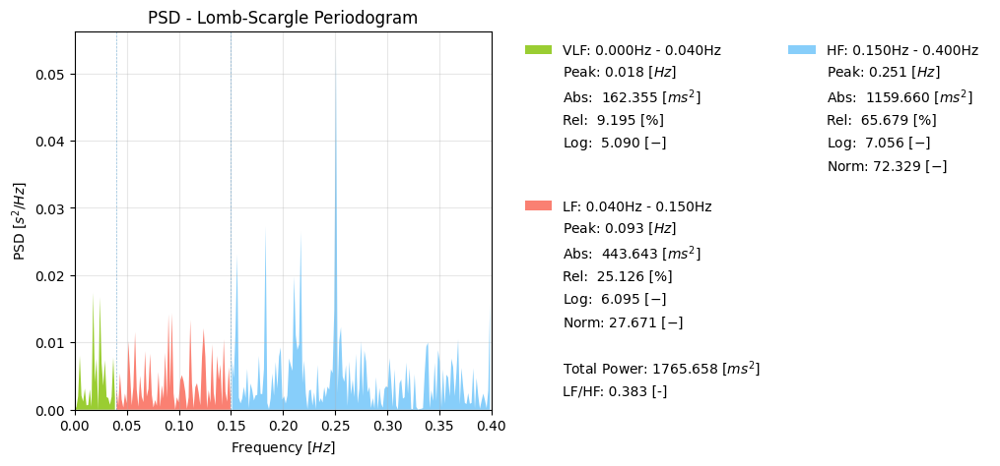

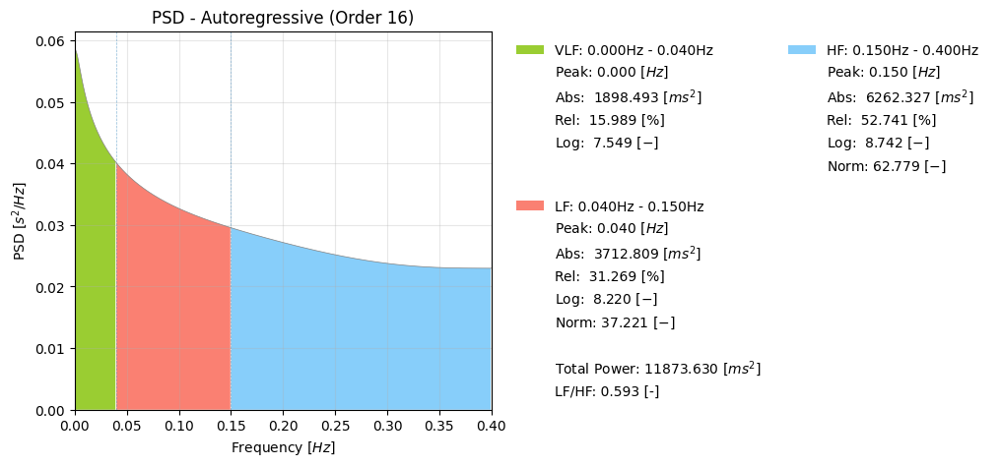

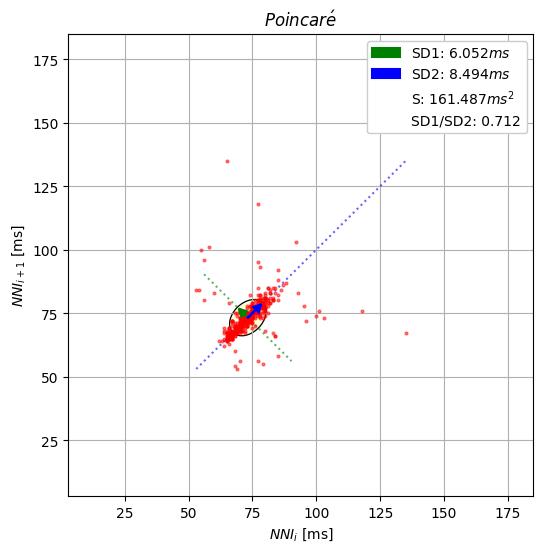

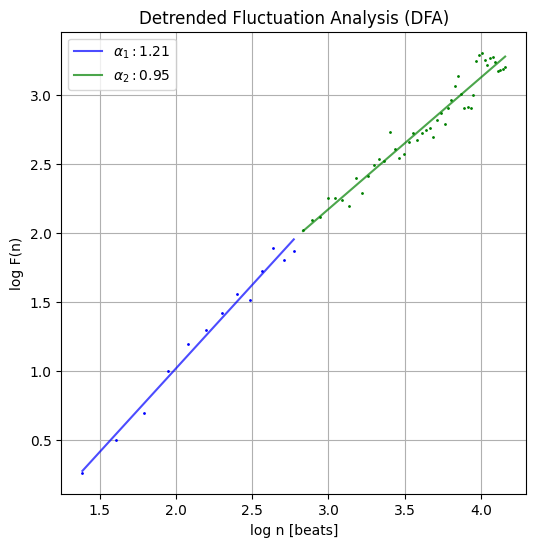

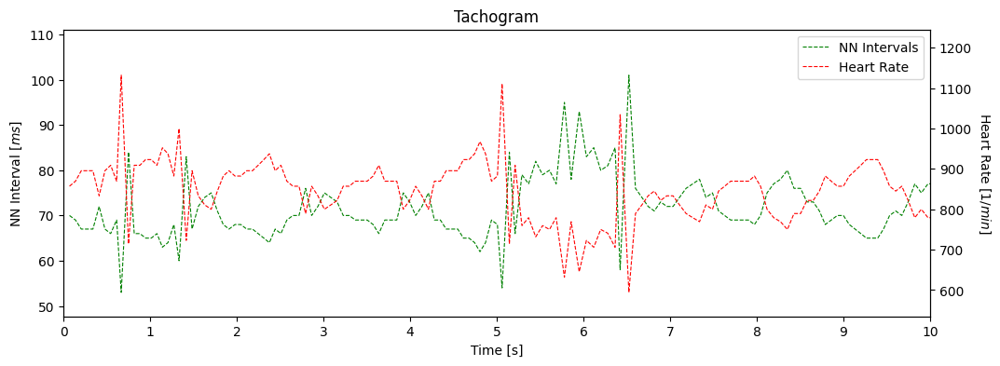

(M)012_20230507_093010_H10.csv
Value is nan
프로토콜: 1.0 BASELINE


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/utils.py:367: UserWarning: Signal duration is to short for segmentation into 300000s. Input data will be returned.
  warnings.warn("Signal duration is to short for segmentation into %is. Input data will be returned." % duration)
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:303: UserWarning: Signal duration too short for SDANN computation.
  warnings.warn("Signal duration too short for SDANN computation.")
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:576: UserWarning: CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a malfunction of the function. This function will be reviewed over the next updates to solve this issue
  warnings.warn('CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a '


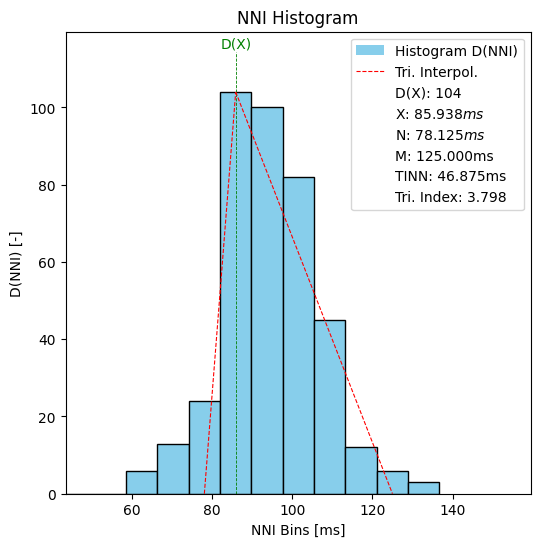

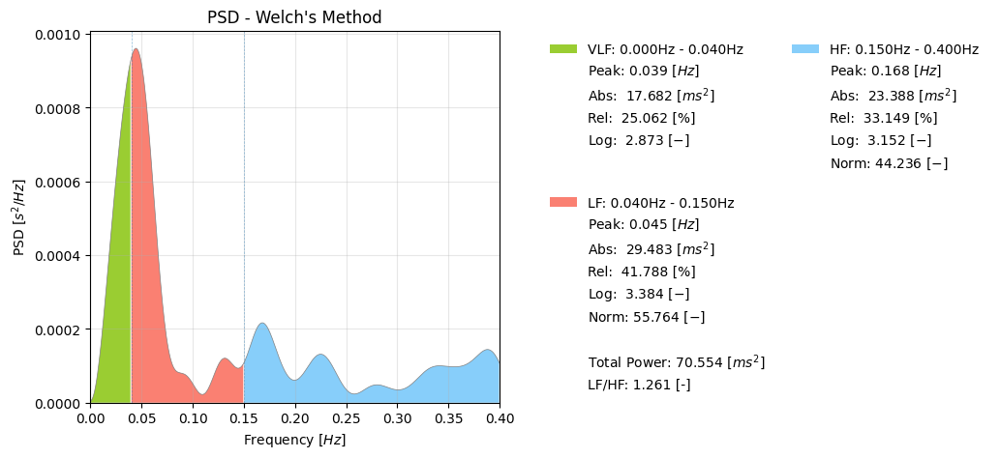

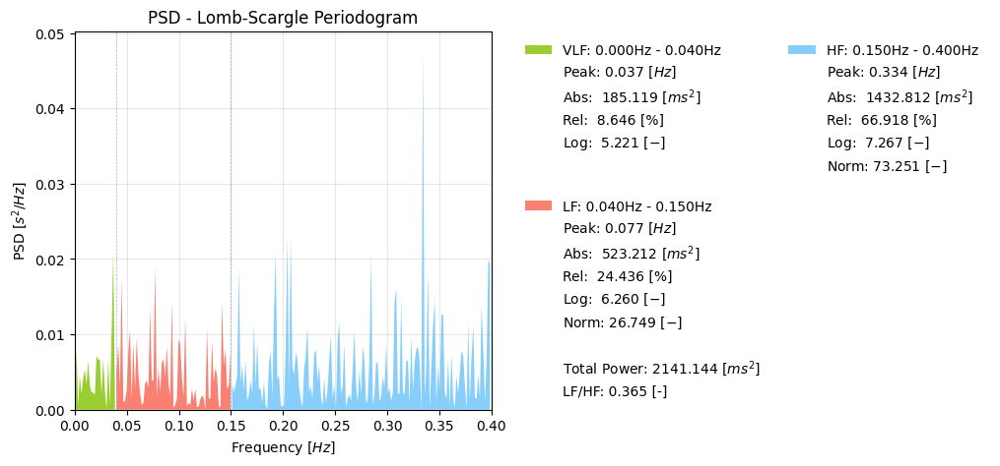

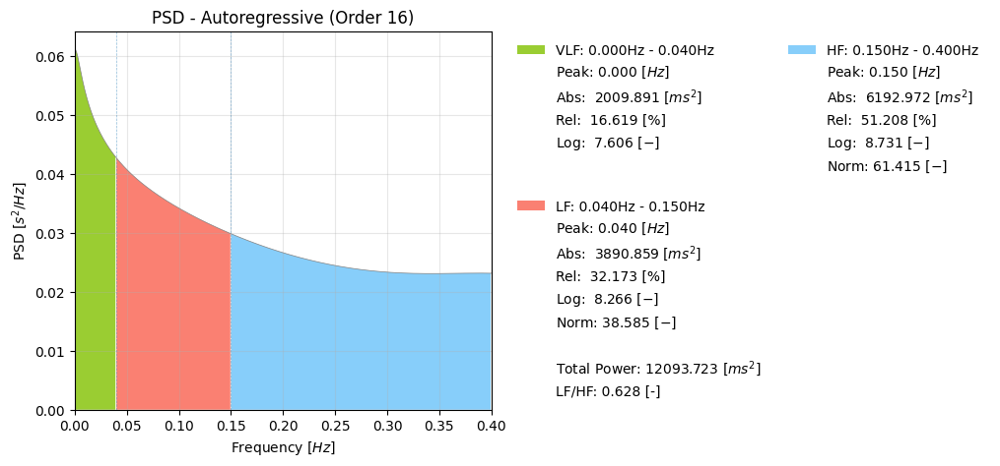

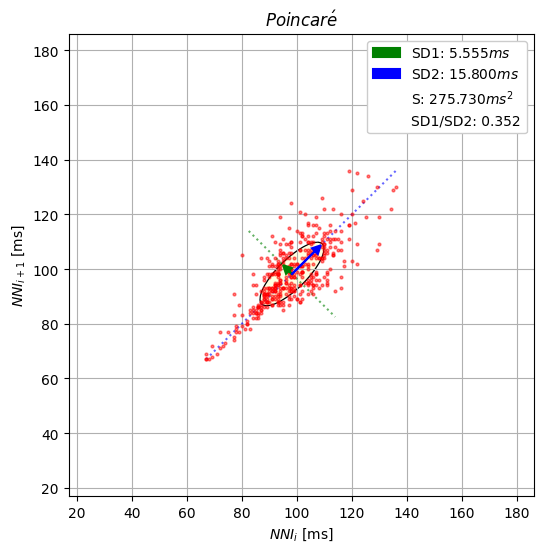

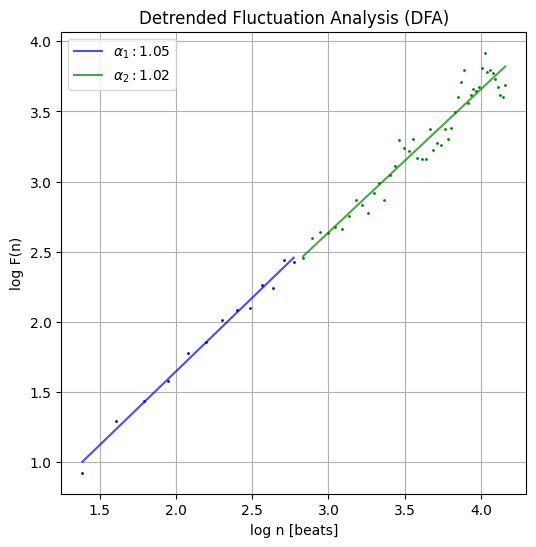

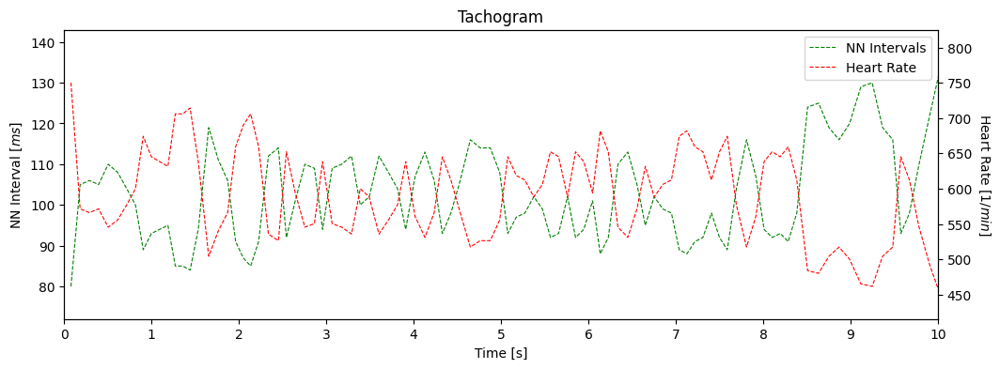

프로토콜: 2.0 HIT


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/utils.py:367: UserWarning: Signal duration is to short for segmentation into 300000s. Input data will be returned.
  warnings.warn("Signal duration is to short for segmentation into %is. Input data will be returned." % duration)
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:303: UserWarning: Signal duration too short for SDANN computation.
  warnings.warn("Signal duration too short for SDANN computation.")
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:576: UserWarning: CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a malfunction of the function. This function will be reviewed over the next updates to solve this issue
  warnings.warn('CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a '


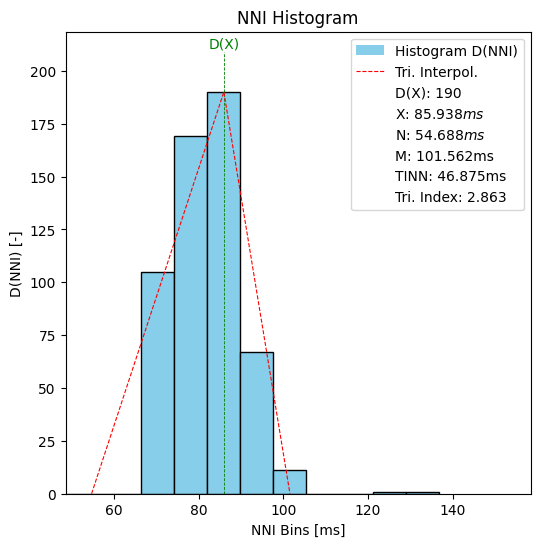

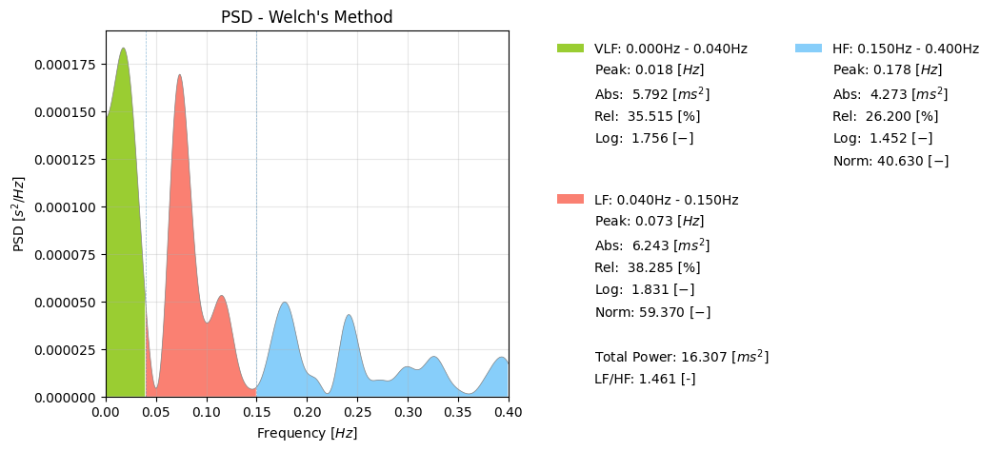

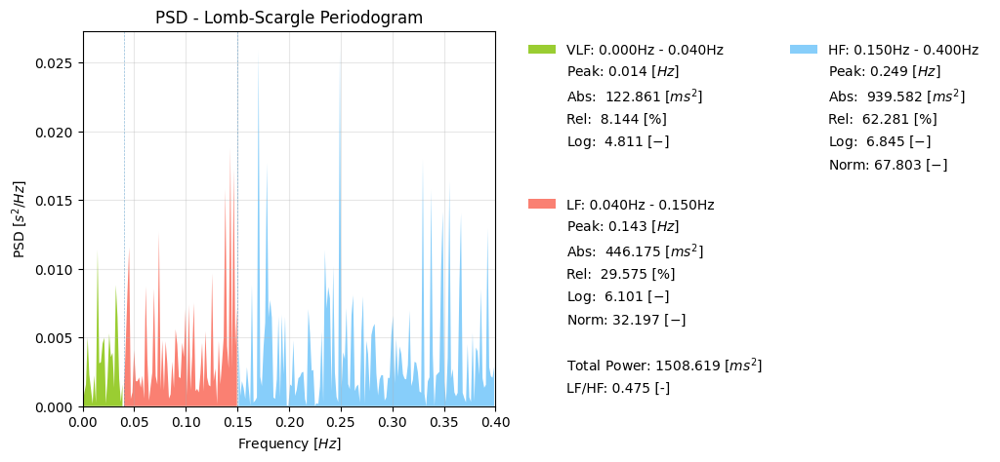

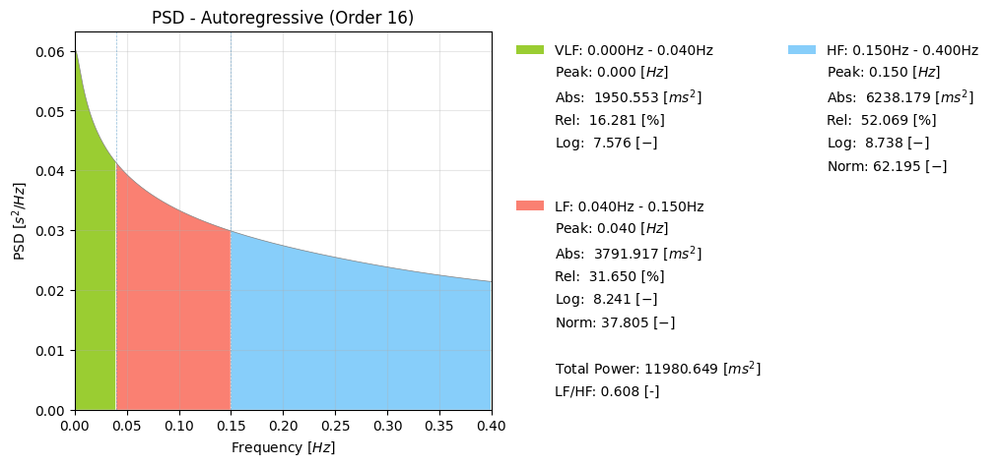

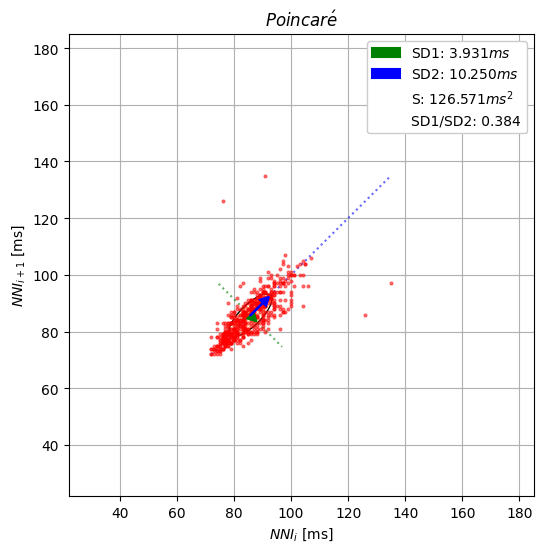

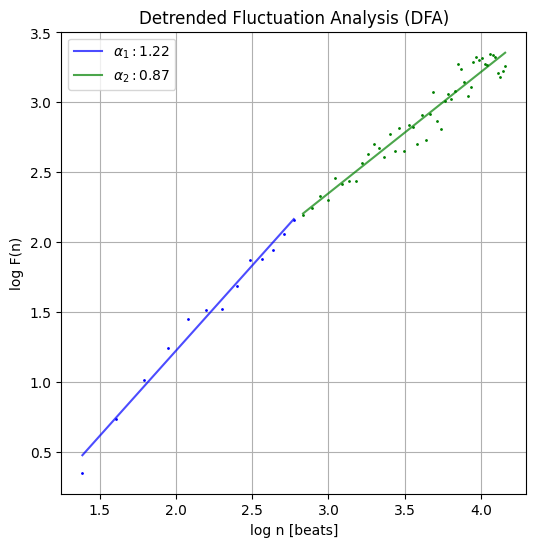

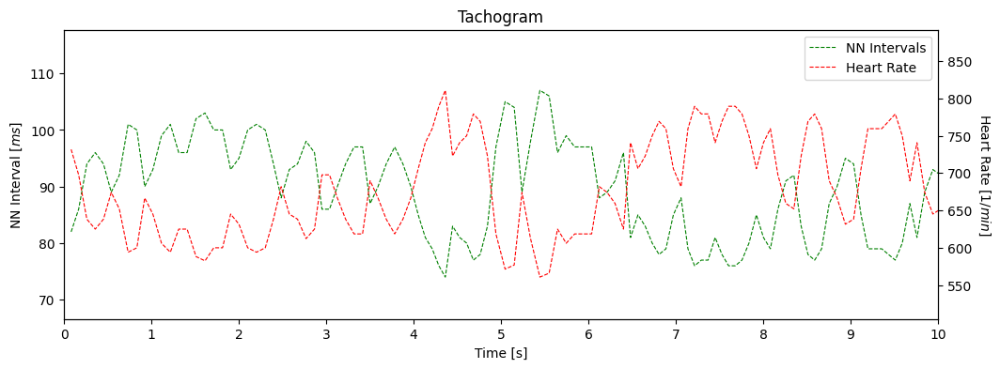

프로토콜: 3.0 MA


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/utils.py:367: UserWarning: Signal duration is to short for segmentation into 300000s. Input data will be returned.
  warnings.warn("Signal duration is to short for segmentation into %is. Input data will be returned." % duration)
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:303: UserWarning: Signal duration too short for SDANN computation.
  warnings.warn("Signal duration too short for SDANN computation.")
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:576: UserWarning: CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a malfunction of the function. This function will be reviewed over the next updates to solve this issue
  warnings.warn('CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a '


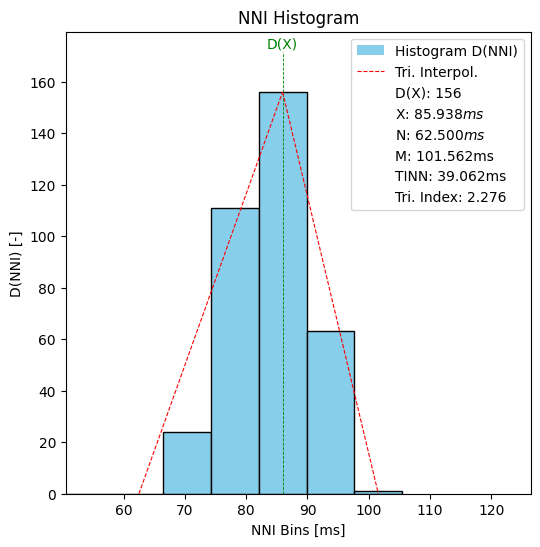

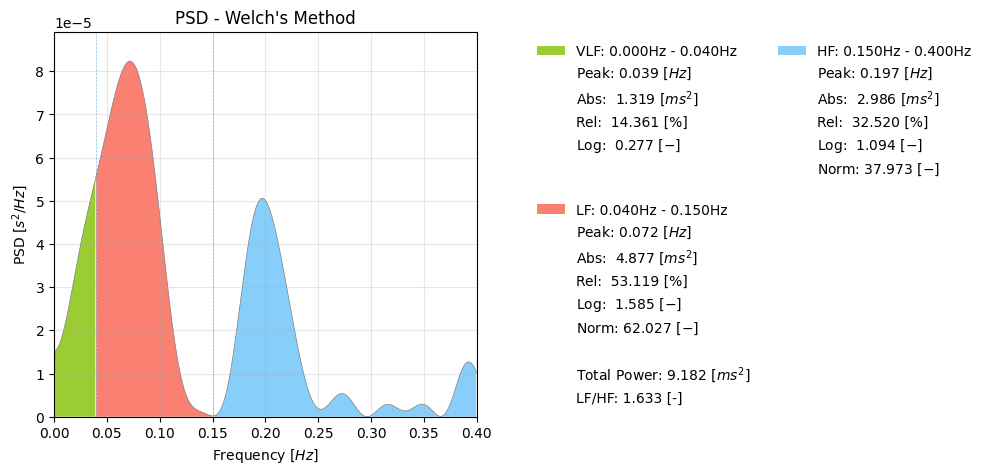

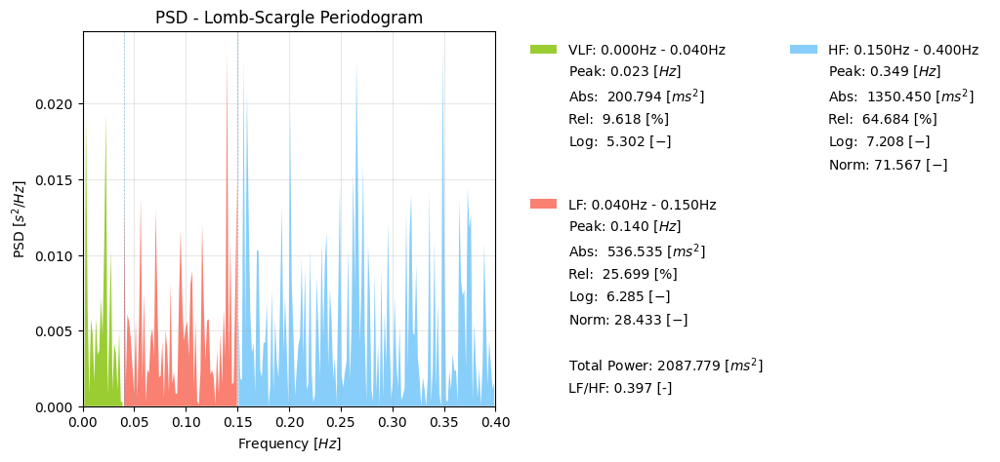

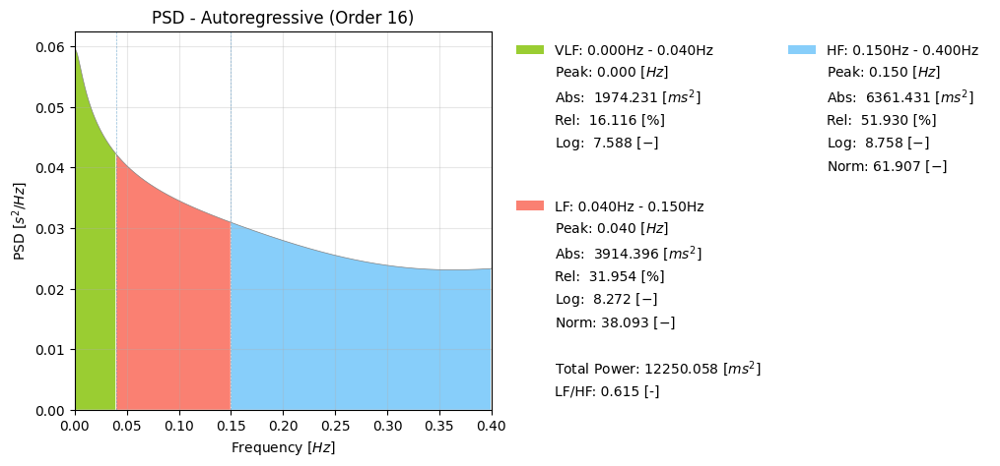

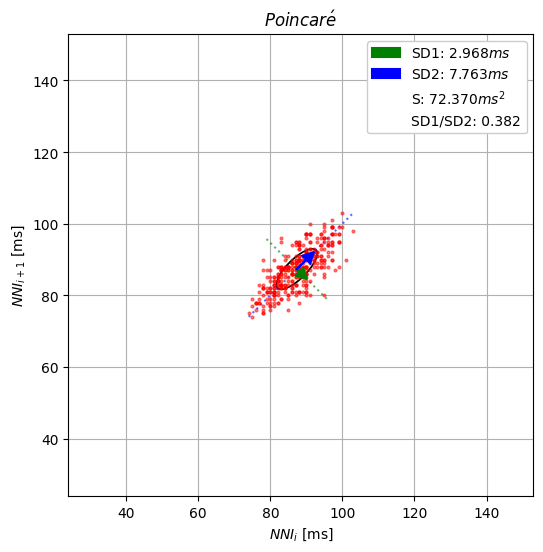

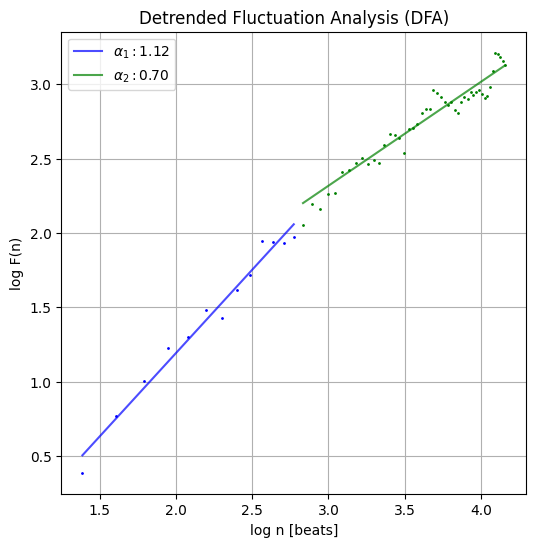

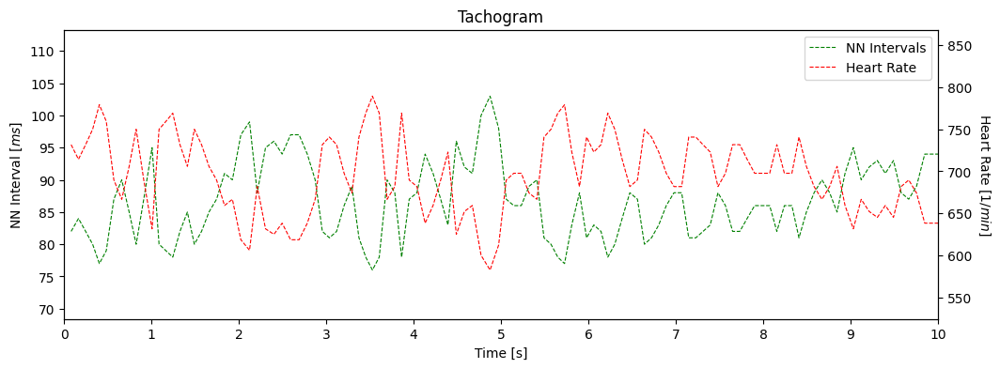

(M)013_20230507_113448_H10.csv
Value is nan
프로토콜: 1.0 BASELINE


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/utils.py:367: UserWarning: Signal duration is to short for segmentation into 300000s. Input data will be returned.
  warnings.warn("Signal duration is to short for segmentation into %is. Input data will be returned." % duration)
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:303: UserWarning: Signal duration too short for SDANN computation.
  warnings.warn("Signal duration too short for SDANN computation.")
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:576: UserWarning: CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a malfunction of the function. This function will be reviewed over the next updates to solve this issue
  warnings.warn('CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a '


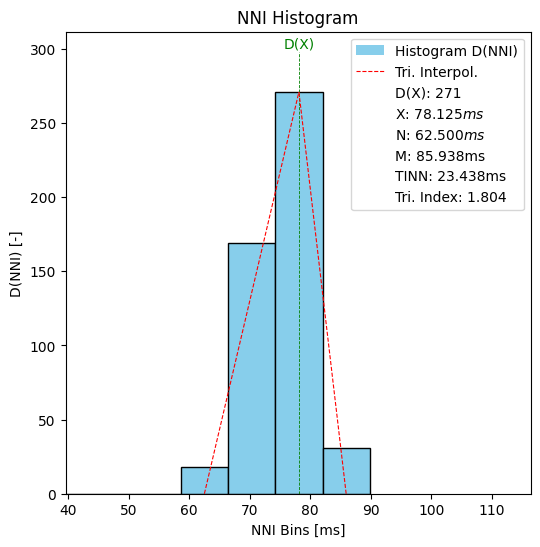

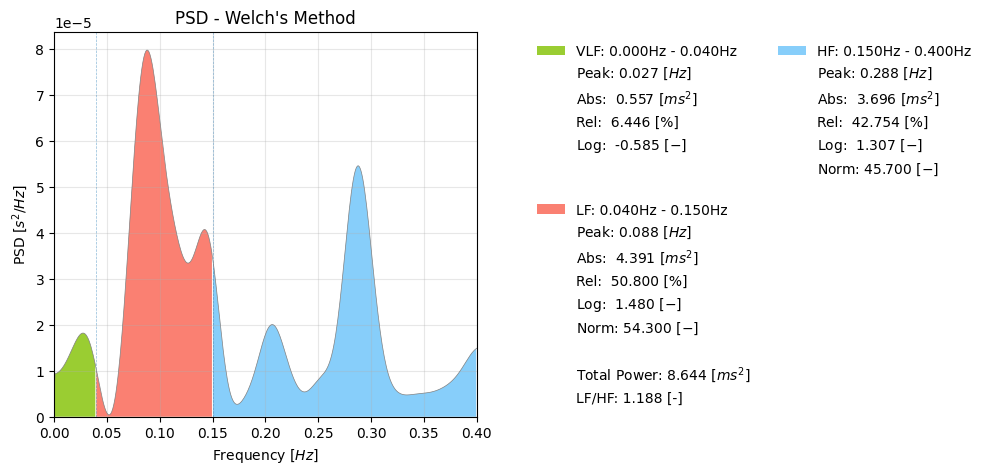

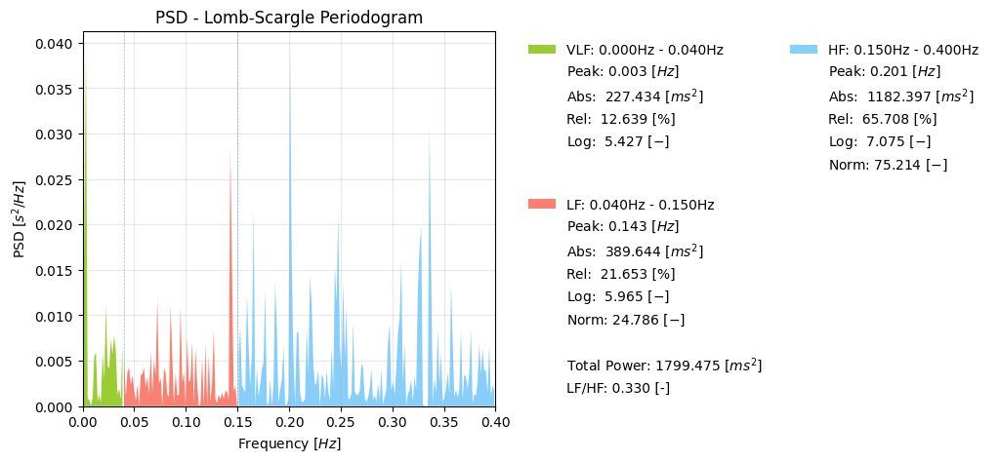

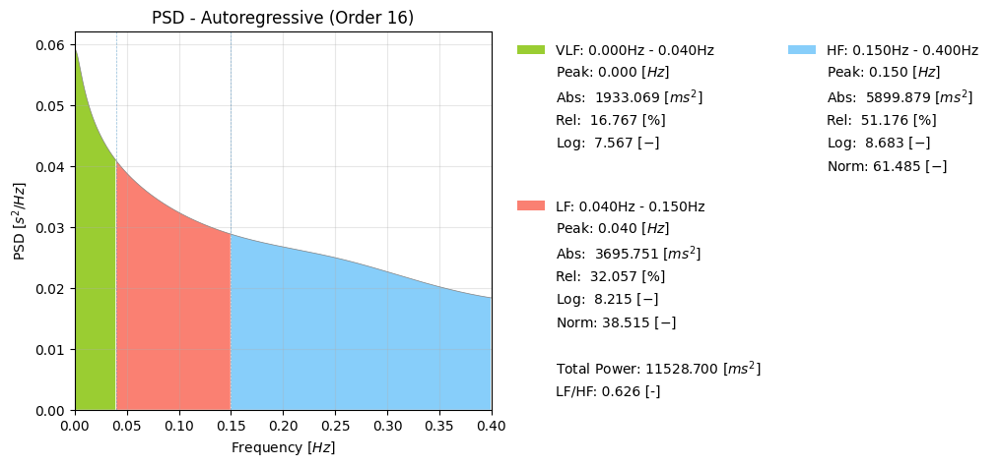

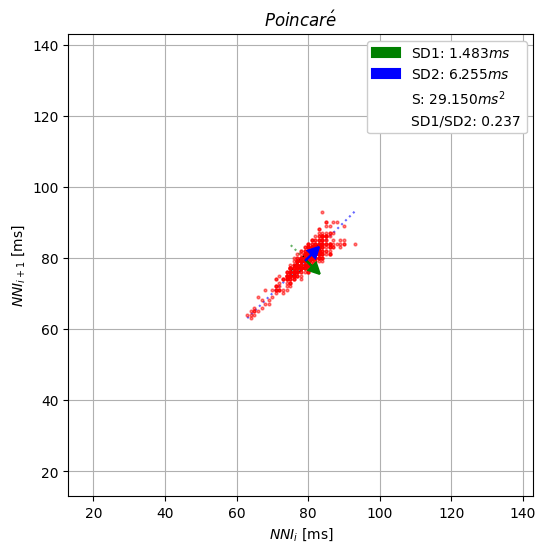

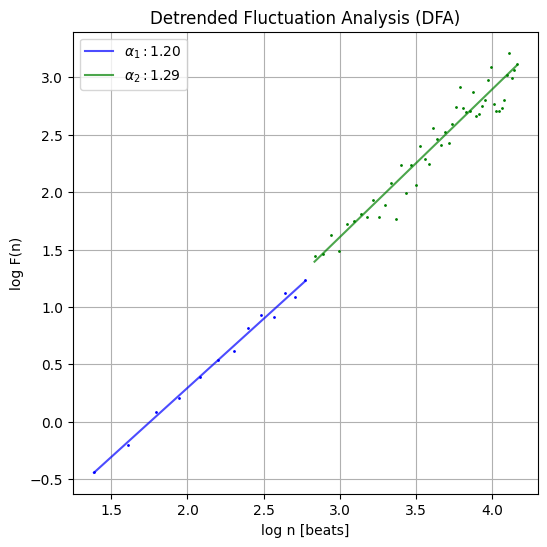

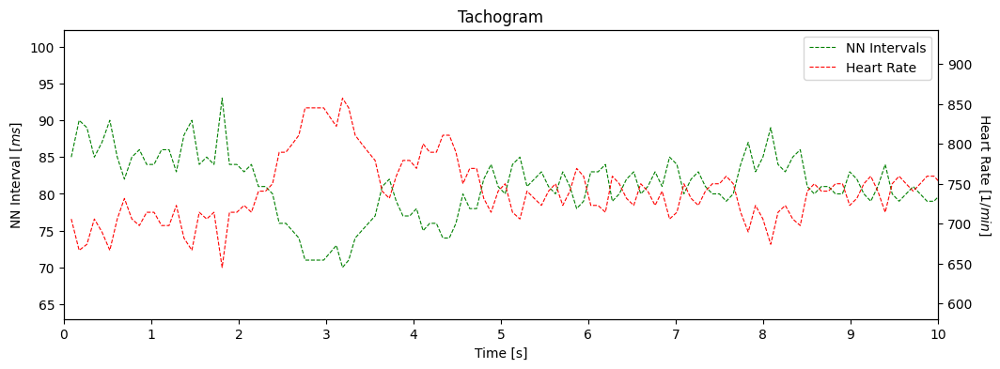

프로토콜: 2.0 HIT


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/utils.py:367: UserWarning: Signal duration is to short for segmentation into 300000s. Input data will be returned.
  warnings.warn("Signal duration is to short for segmentation into %is. Input data will be returned." % duration)
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:303: UserWarning: Signal duration too short for SDANN computation.
  warnings.warn("Signal duration too short for SDANN computation.")
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:576: UserWarning: CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a malfunction of the function. This function will be reviewed over the next updates to solve this issue
  warnings.warn('CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a '


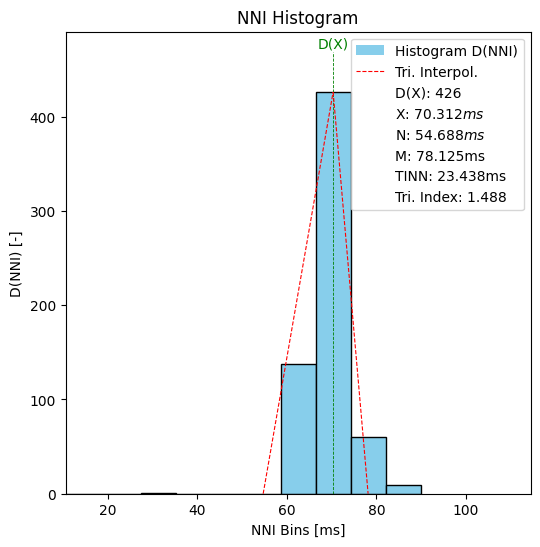

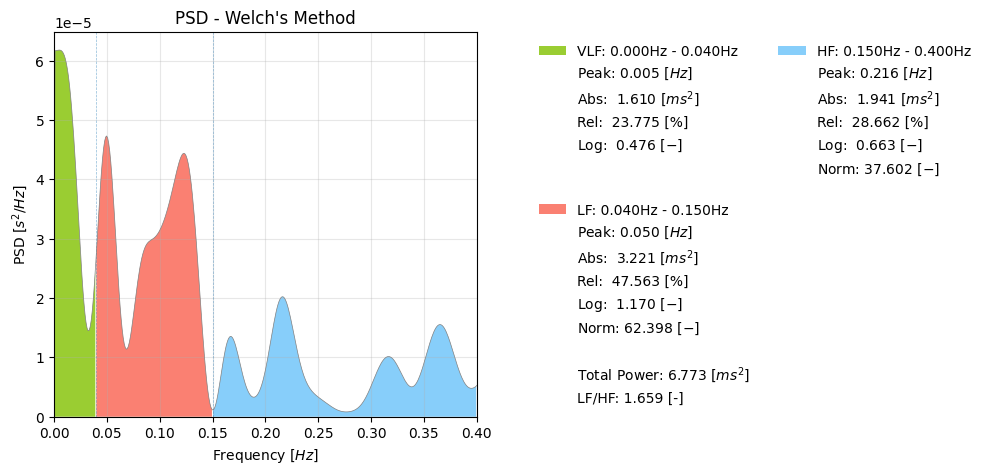

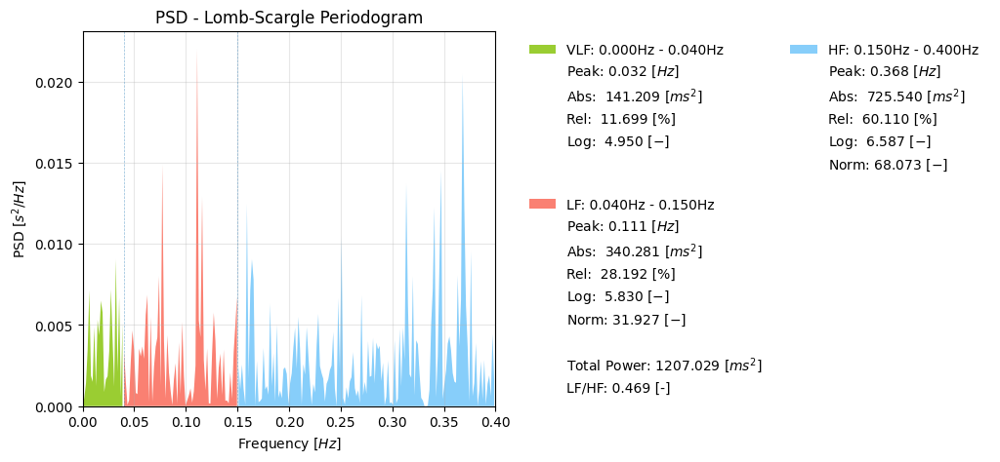

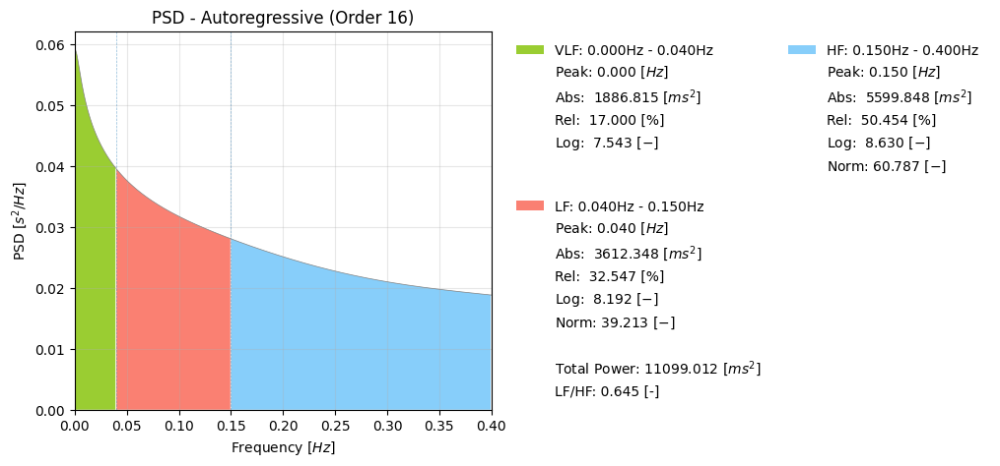

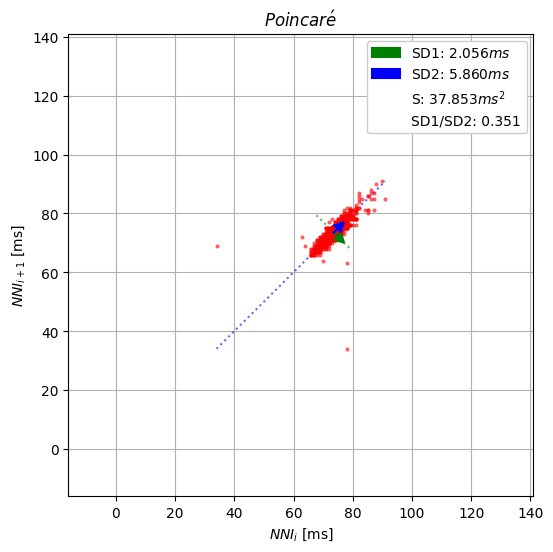

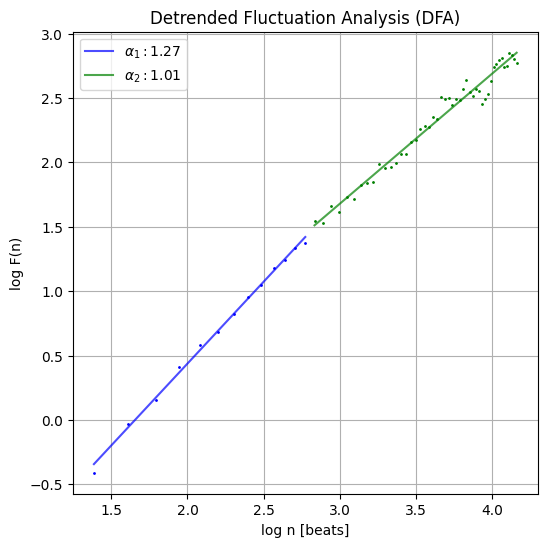

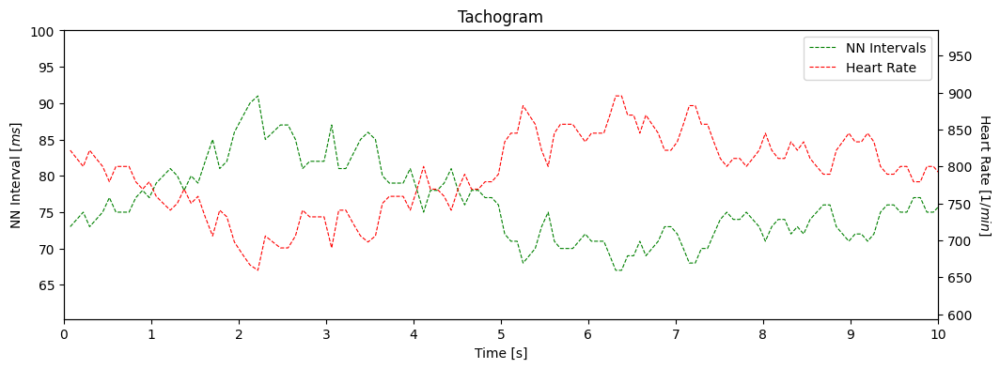

프로토콜: 3.0 MA


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/utils.py:367: UserWarning: Signal duration is to short for segmentation into 300000s. Input data will be returned.
  warnings.warn("Signal duration is to short for segmentation into %is. Input data will be returned." % duration)
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:303: UserWarning: Signal duration too short for SDANN computation.
  warnings.warn("Signal duration too short for SDANN computation.")
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:576: UserWarning: CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a malfunction of the function. This function will be reviewed over the next updates to solve this issue
  warnings.warn('CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a '


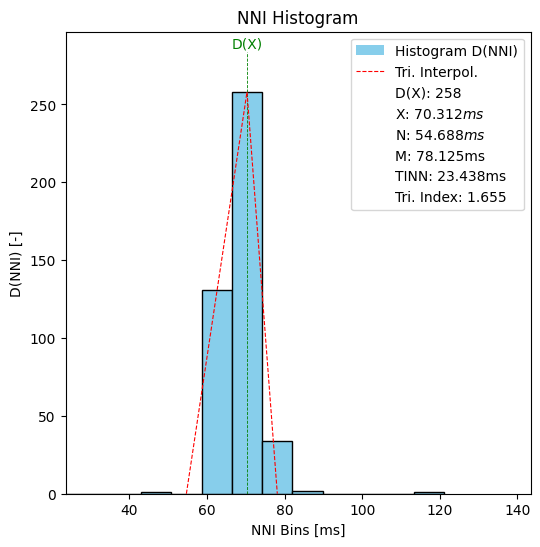

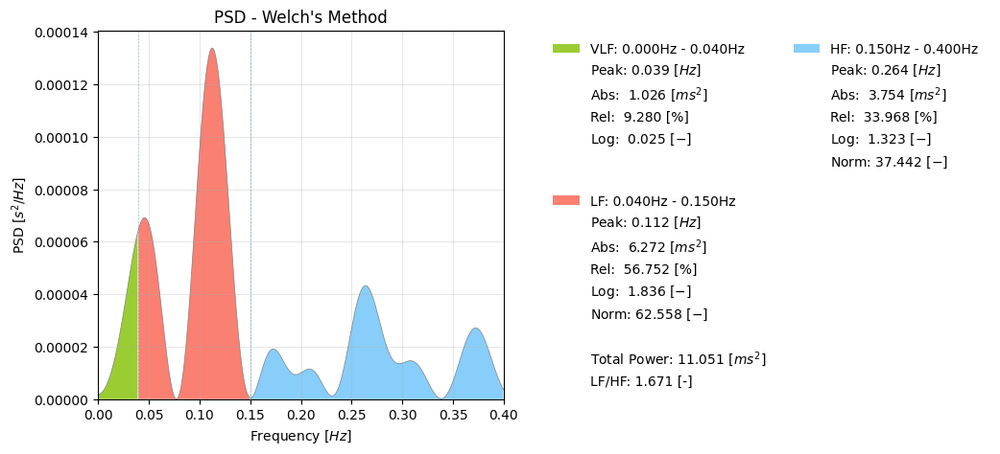

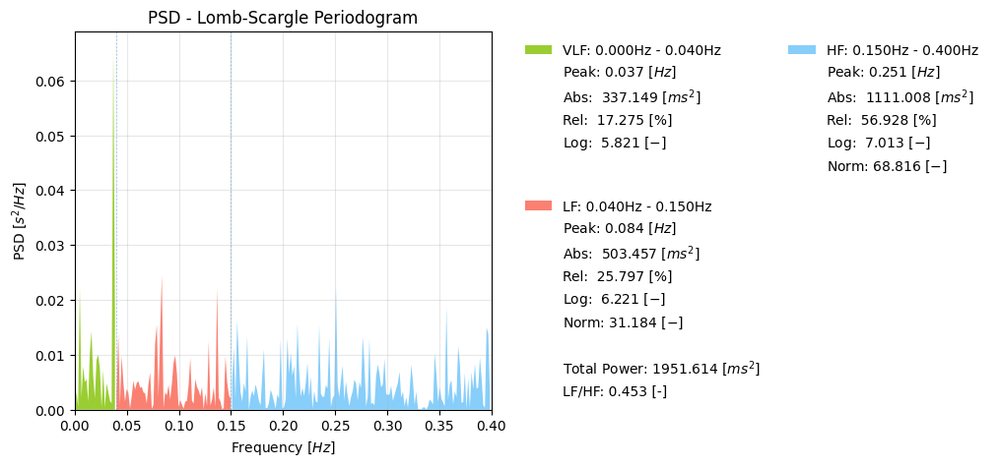

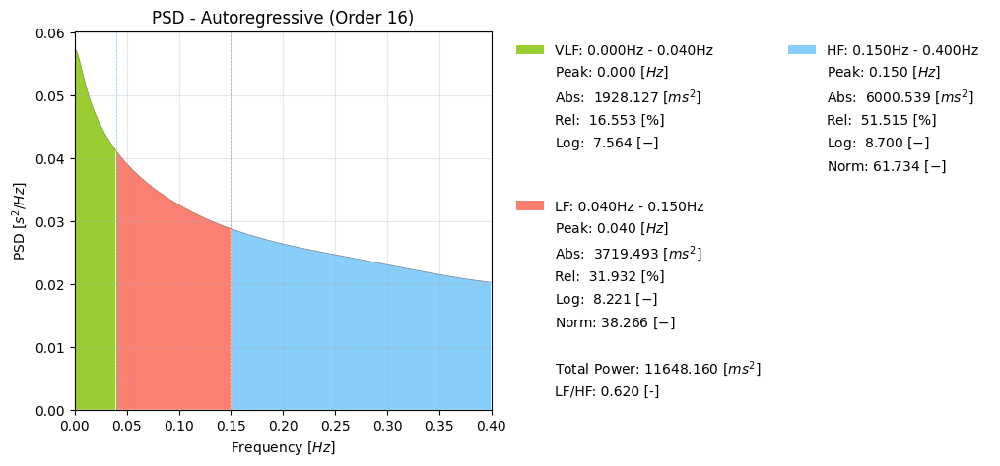

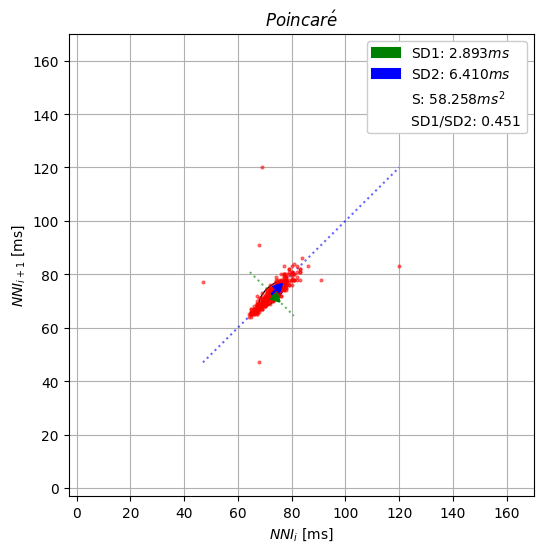

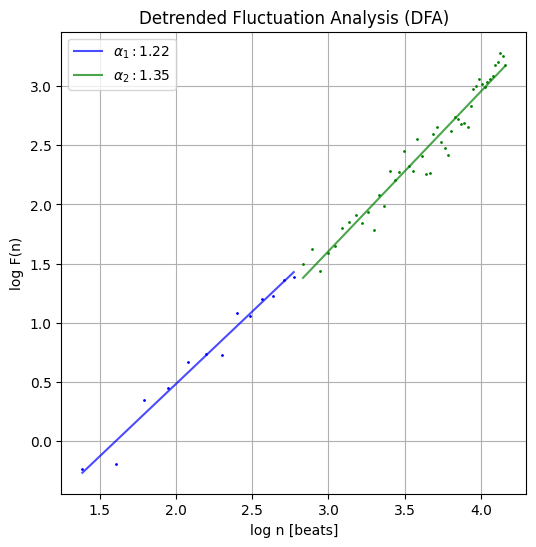

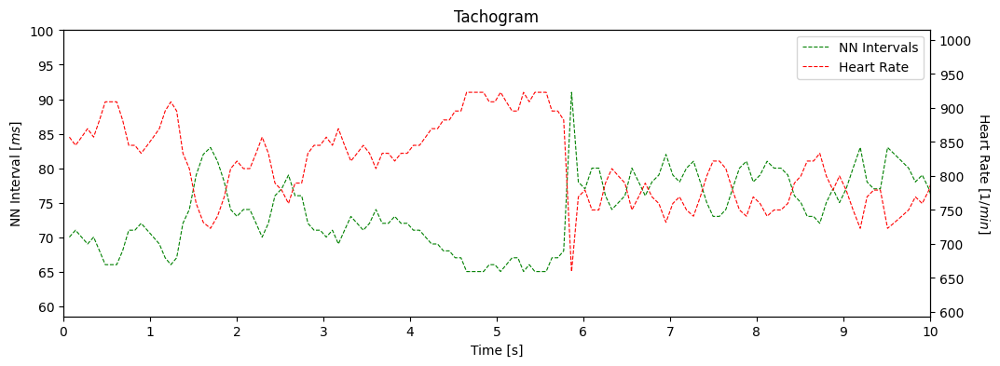

(M)014_20230507_095721_H10.csv
Value is nan
(M)016_20230507_085913_H10.csv
Value is nan
프로토콜: 1.0 BASELINE


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/utils.py:367: UserWarning: Signal duration is to short for segmentation into 300000s. Input data will be returned.
  warnings.warn("Signal duration is to short for segmentation into %is. Input data will be returned." % duration)
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:303: UserWarning: Signal duration too short for SDANN computation.
  warnings.warn("Signal duration too short for SDANN computation.")
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:576: UserWarning: CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a malfunction of the function. This function will be reviewed over the next updates to solve this issue
  warnings.warn('CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a '


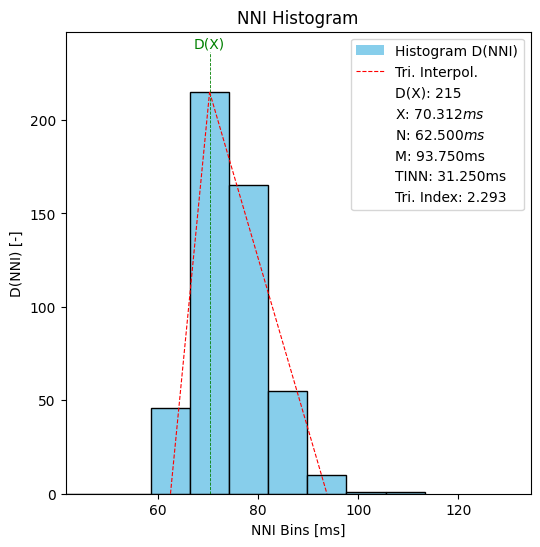

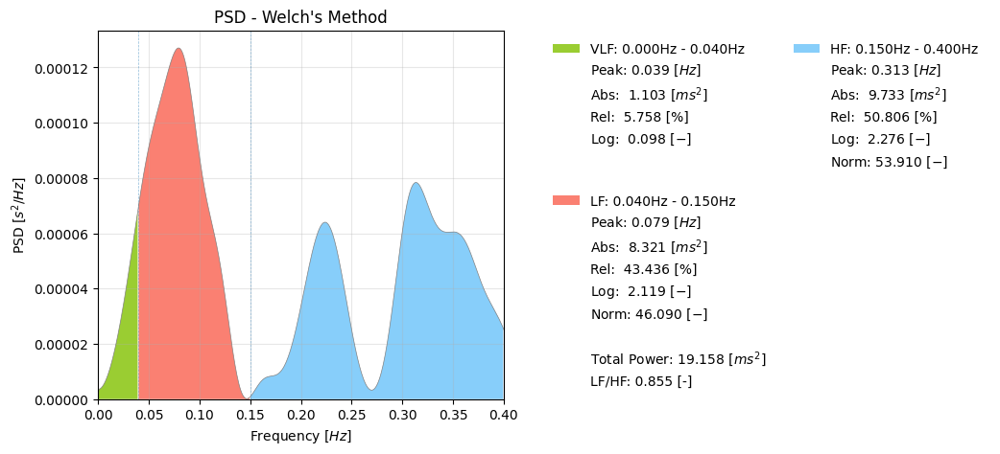

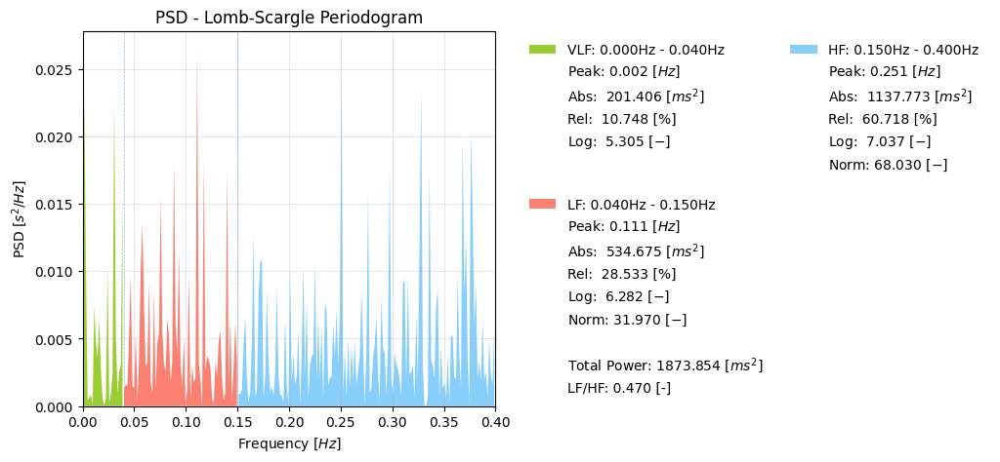

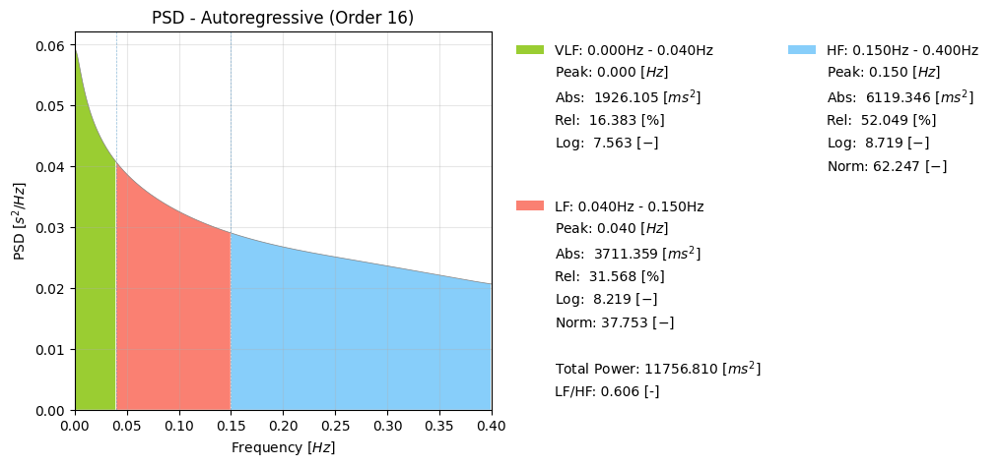

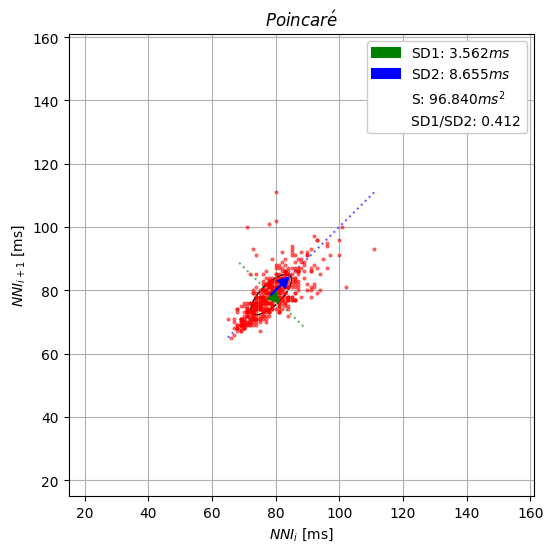

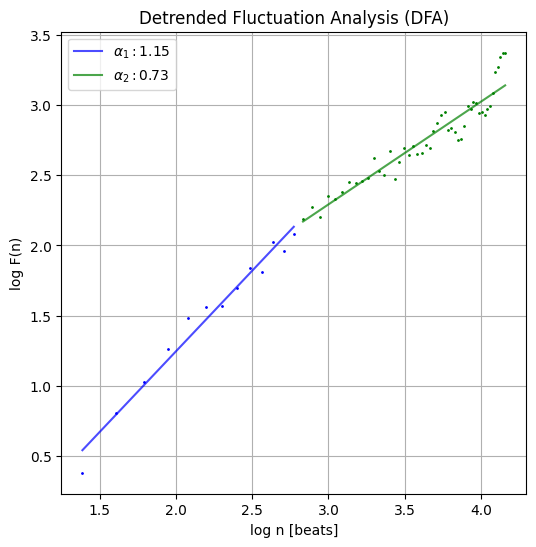

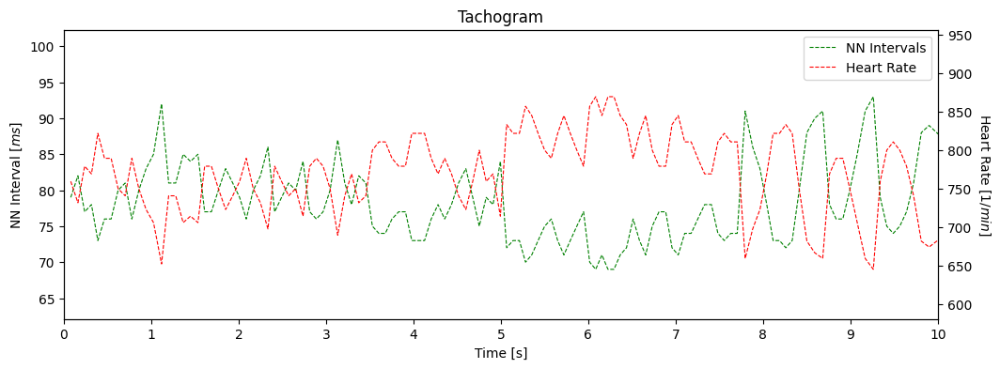

프로토콜: 2.0 HIT


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/utils.py:367: UserWarning: Signal duration is to short for segmentation into 300000s. Input data will be returned.
  warnings.warn("Signal duration is to short for segmentation into %is. Input data will be returned." % duration)
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:303: UserWarning: Signal duration too short for SDANN computation.
  warnings.warn("Signal duration too short for SDANN computation.")
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:576: UserWarning: CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a malfunction of the function. This function will be reviewed over the next updates to solve this issue
  warnings.warn('CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a '


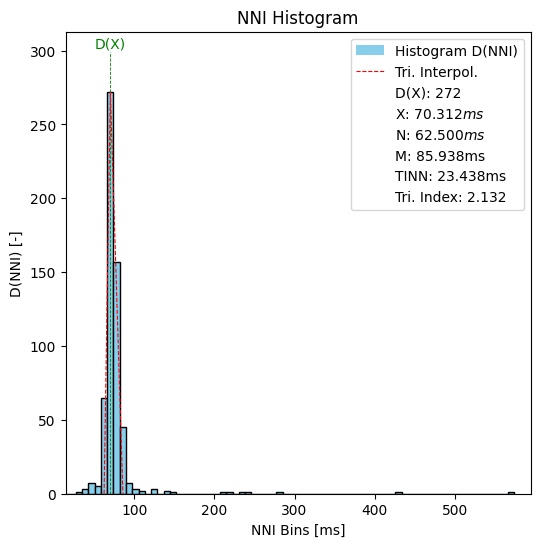

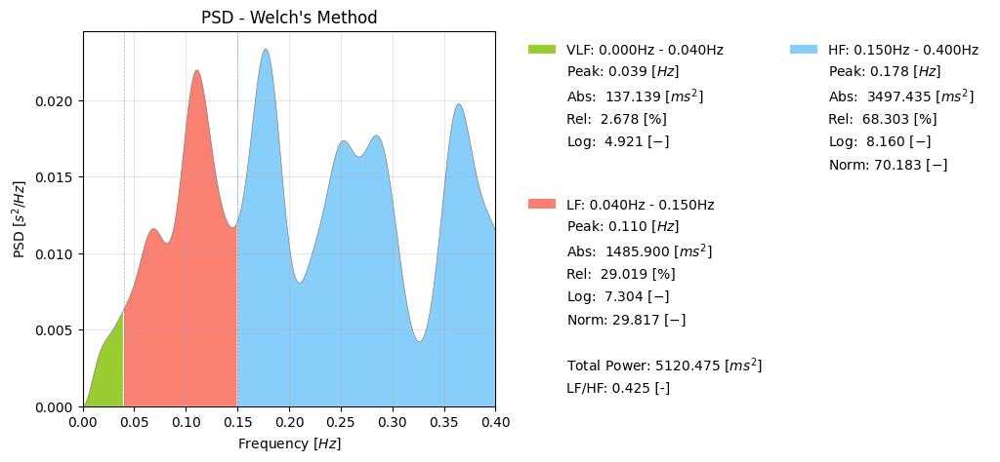

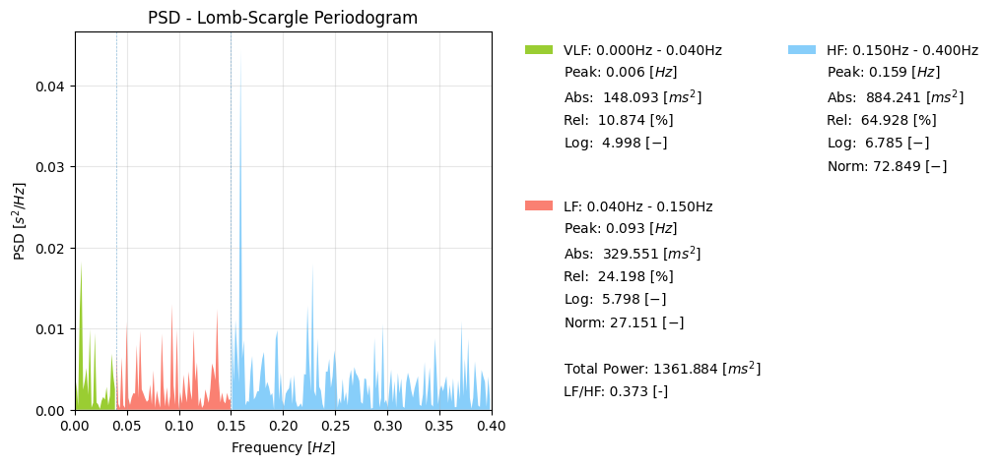

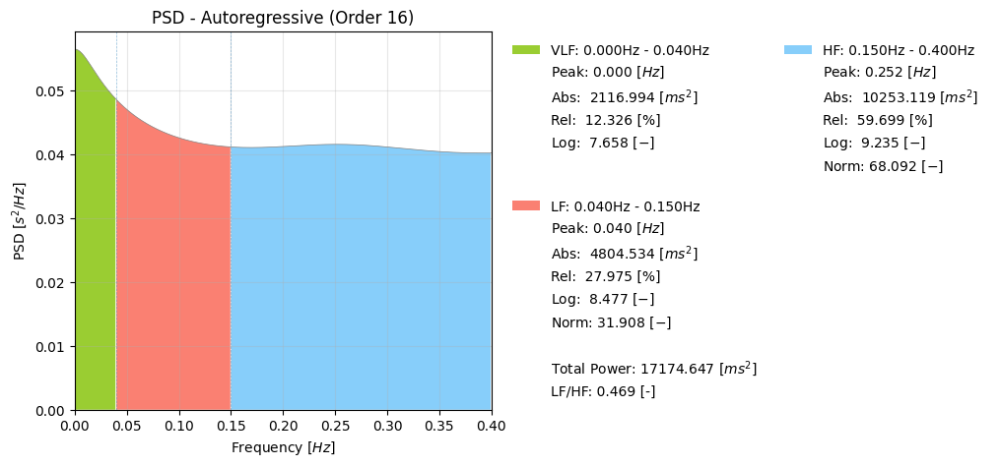

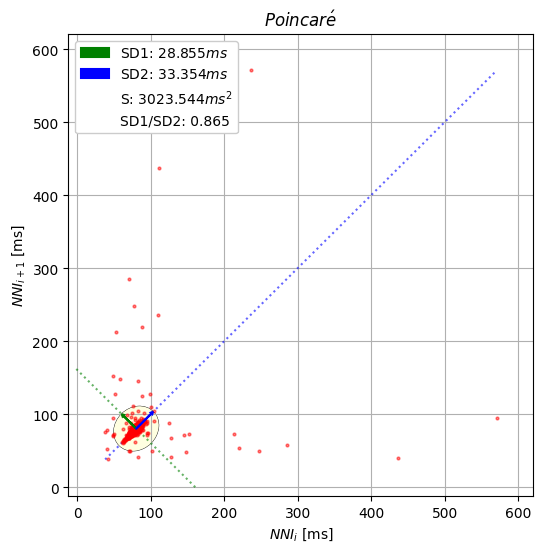

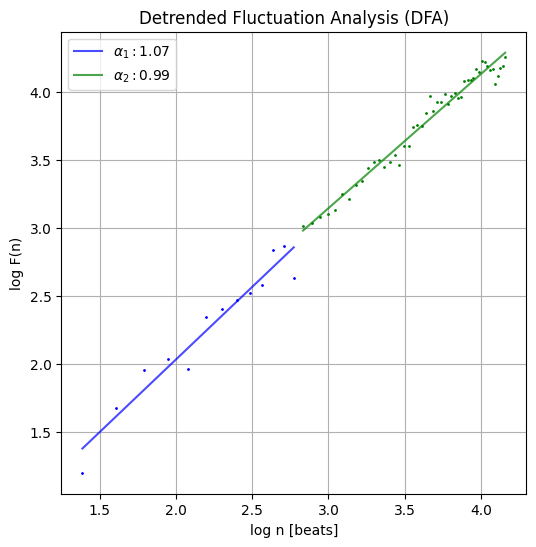

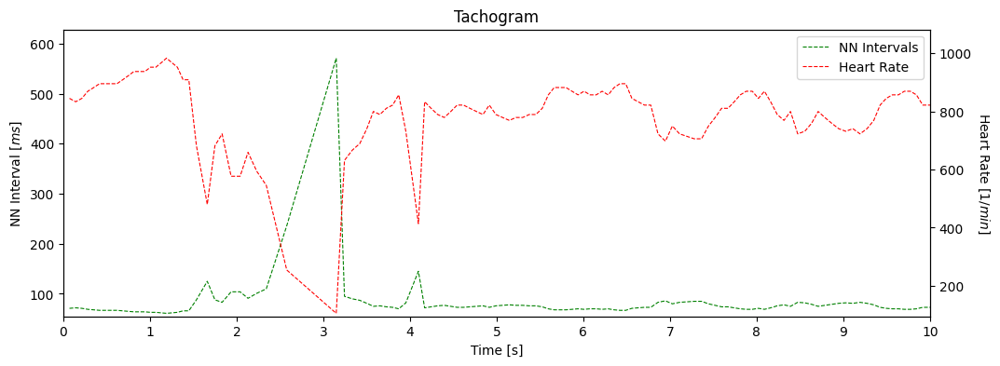

프로토콜: 3.0 MA


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/utils.py:367: UserWarning: Signal duration is to short for segmentation into 300000s. Input data will be returned.
  warnings.warn("Signal duration is to short for segmentation into %is. Input data will be returned." % duration)
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:303: UserWarning: Signal duration too short for SDANN computation.
  warnings.warn("Signal duration too short for SDANN computation.")
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:576: UserWarning: CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a malfunction of the function. This function will be reviewed over the next updates to solve this issue
  warnings.warn('CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a '


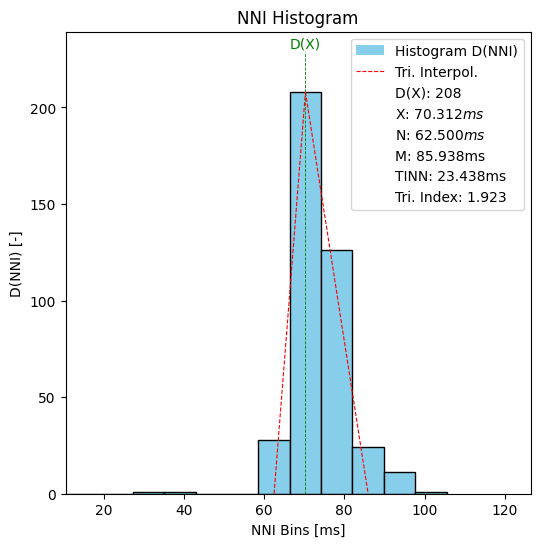

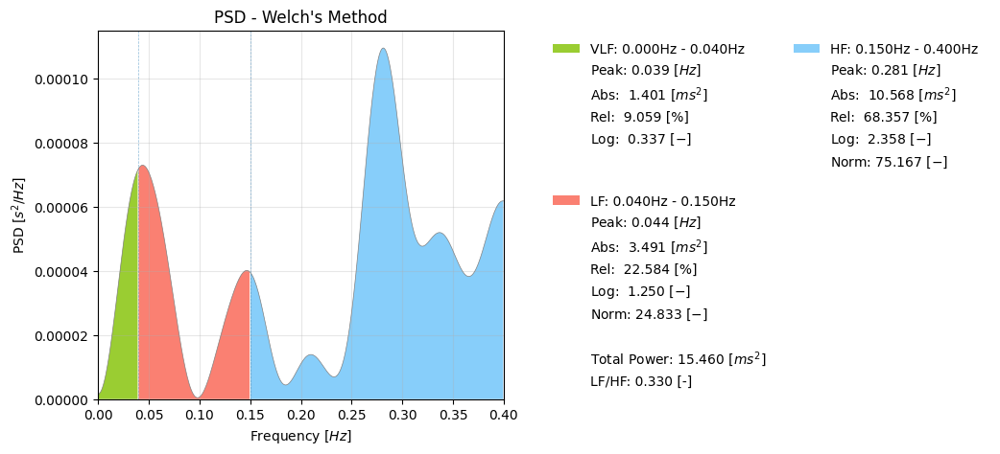

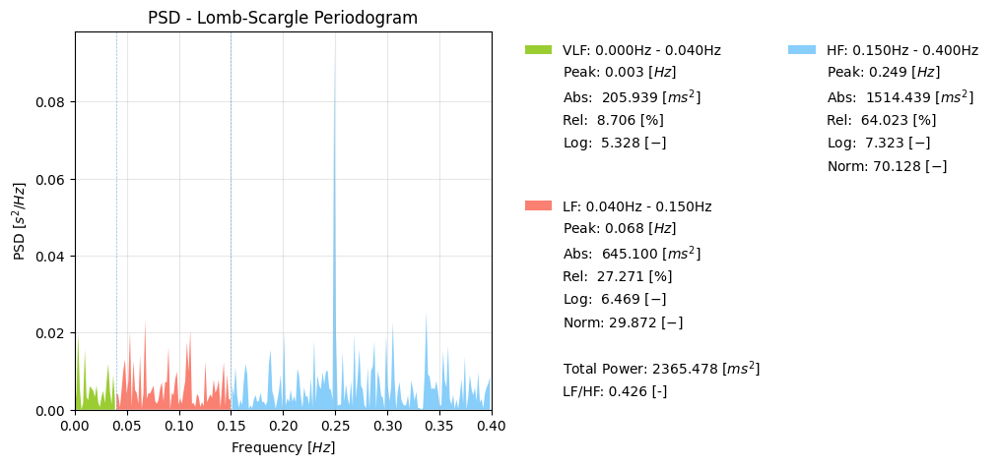

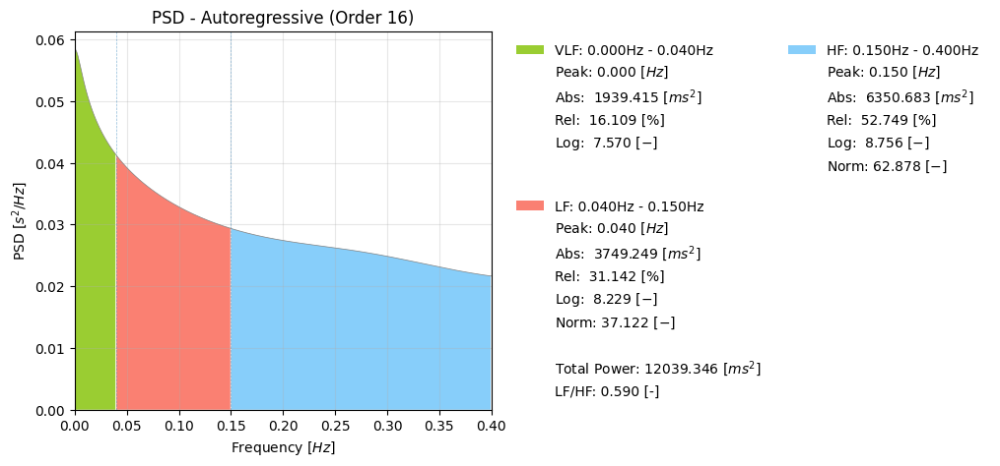

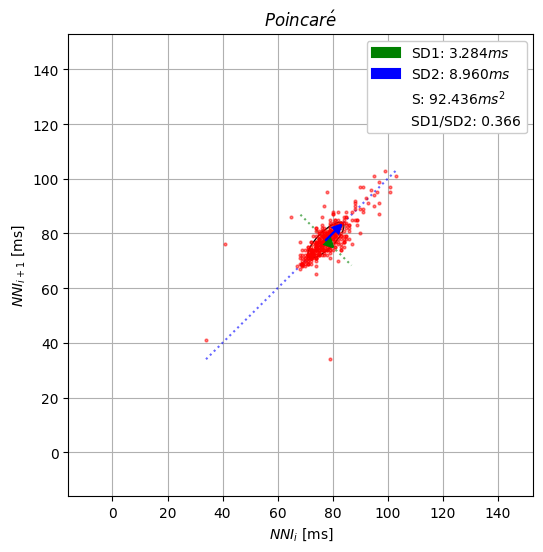

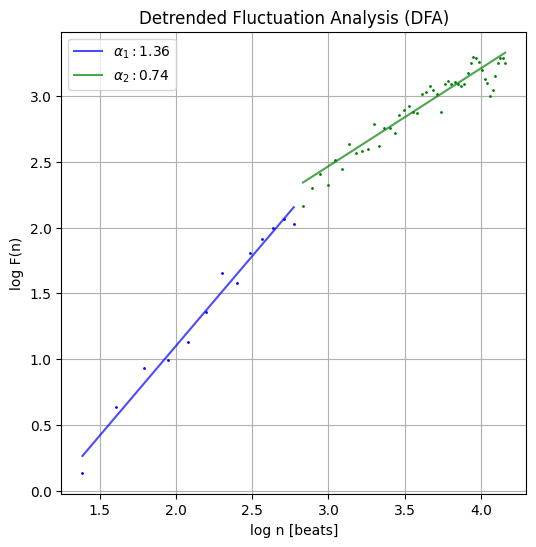

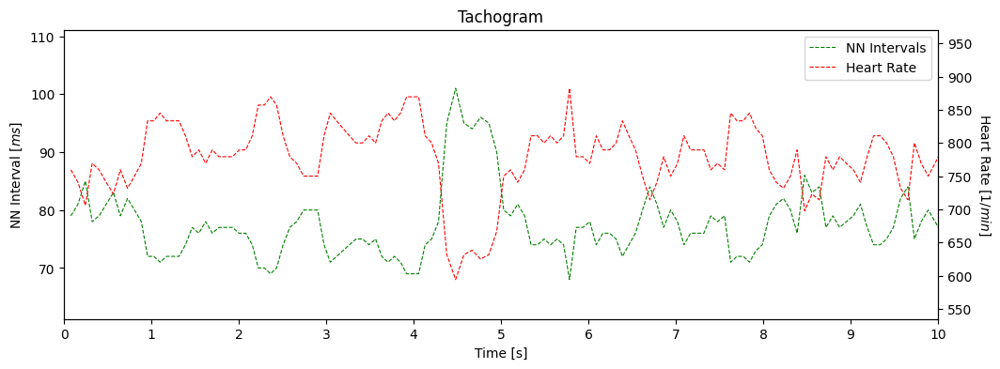

(M)017_20230507_110427_H10.csv
Value is nan
프로토콜: 1.0 BASELINE


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/utils.py:367: UserWarning: Signal duration is to short for segmentation into 300000s. Input data will be returned.
  warnings.warn("Signal duration is to short for segmentation into %is. Input data will be returned." % duration)
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:303: UserWarning: Signal duration too short for SDANN computation.
  warnings.warn("Signal duration too short for SDANN computation.")
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:576: UserWarning: CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a malfunction of the function. This function will be reviewed over the next updates to solve this issue
  warnings.warn('CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a '


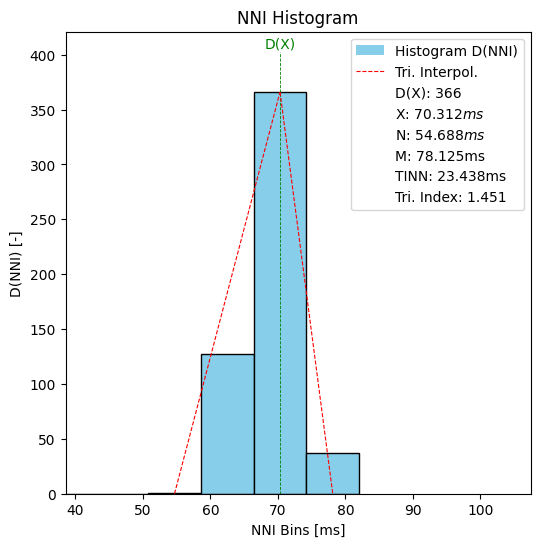

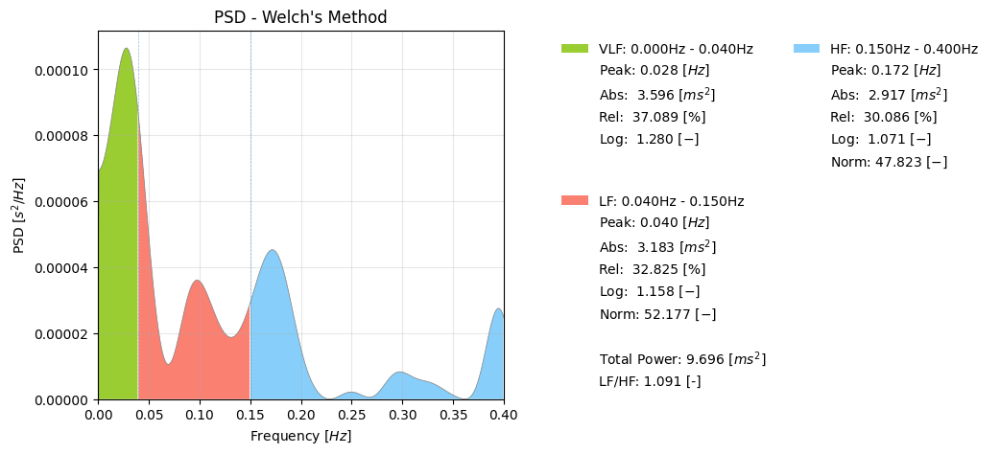

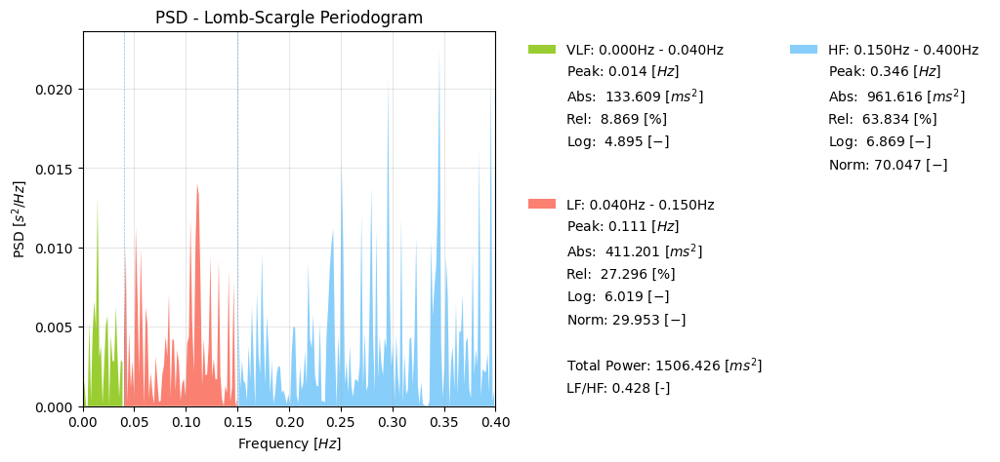

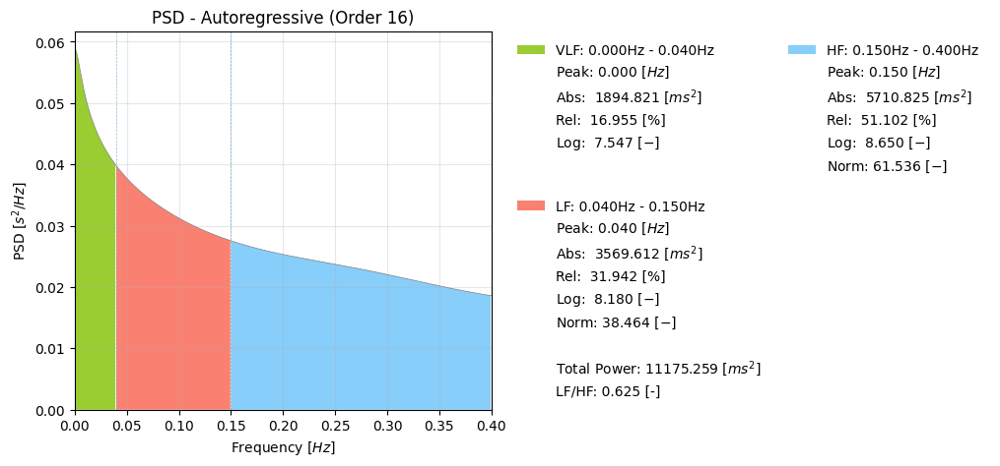

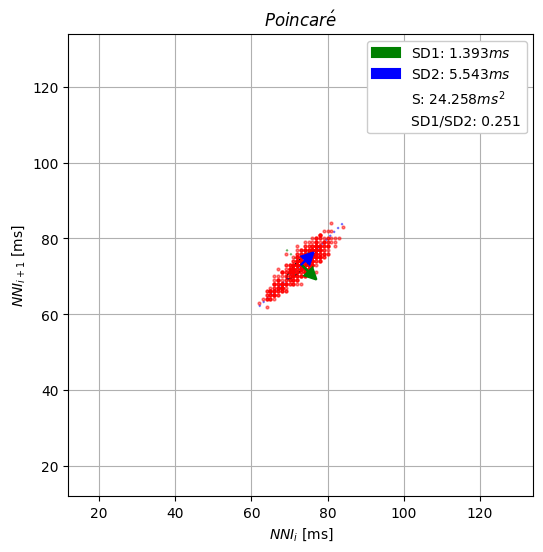

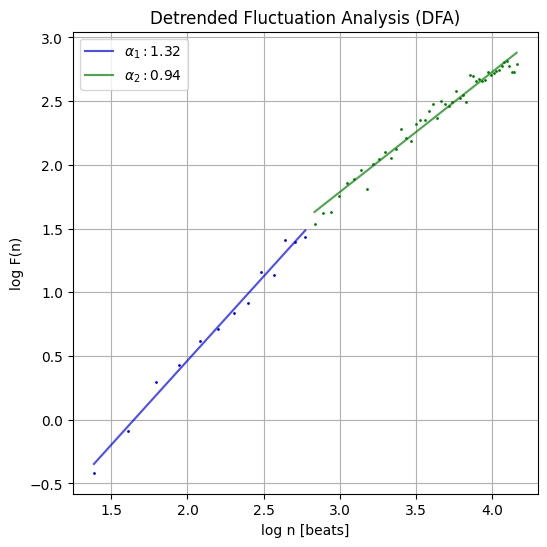

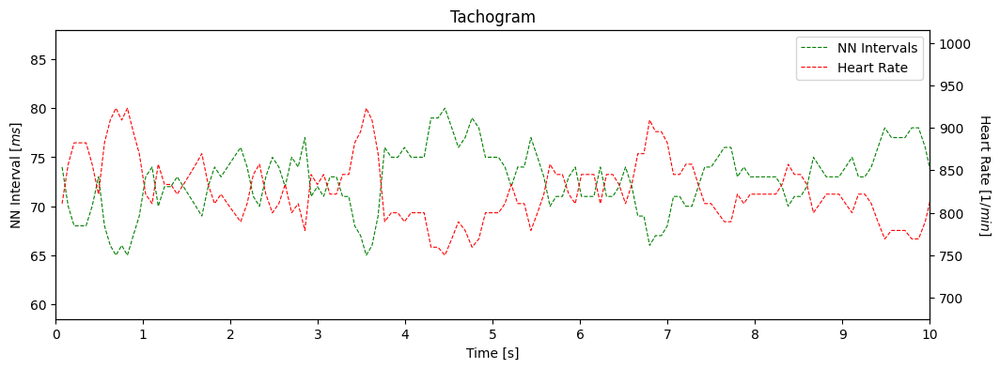

프로토콜: 2.0 HIT


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/utils.py:367: UserWarning: Signal duration is to short for segmentation into 300000s. Input data will be returned.
  warnings.warn("Signal duration is to short for segmentation into %is. Input data will be returned." % duration)
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:303: UserWarning: Signal duration too short for SDANN computation.
  warnings.warn("Signal duration too short for SDANN computation.")
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:576: UserWarning: CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a malfunction of the function. This function will be reviewed over the next updates to solve this issue
  warnings.warn('CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a '


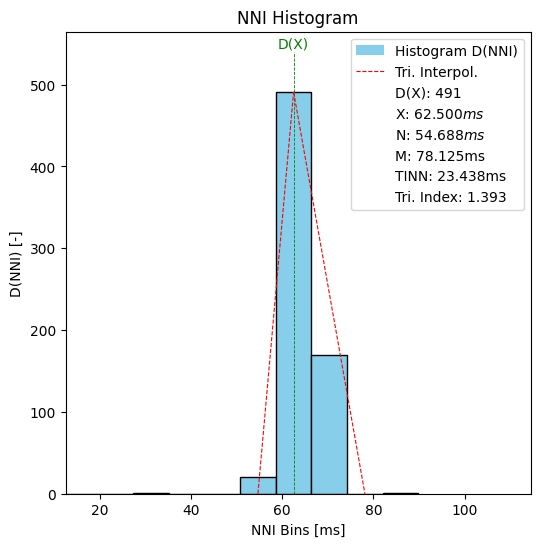

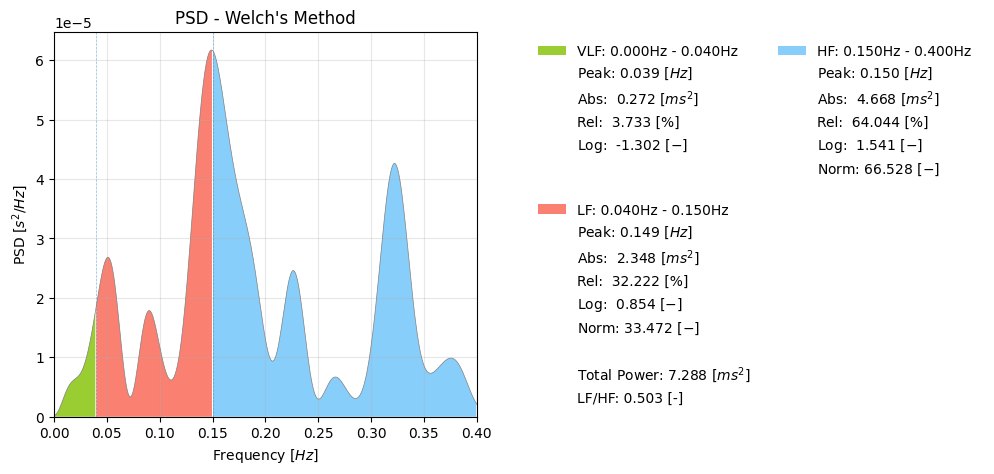

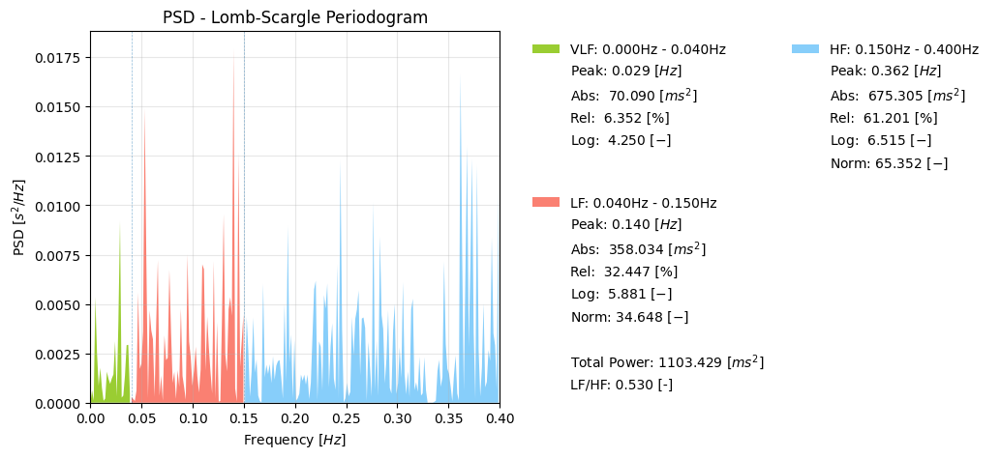

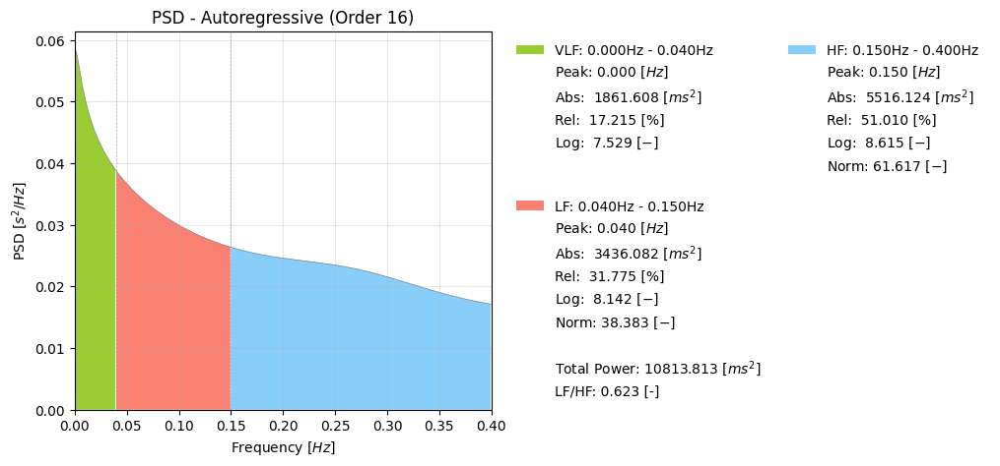

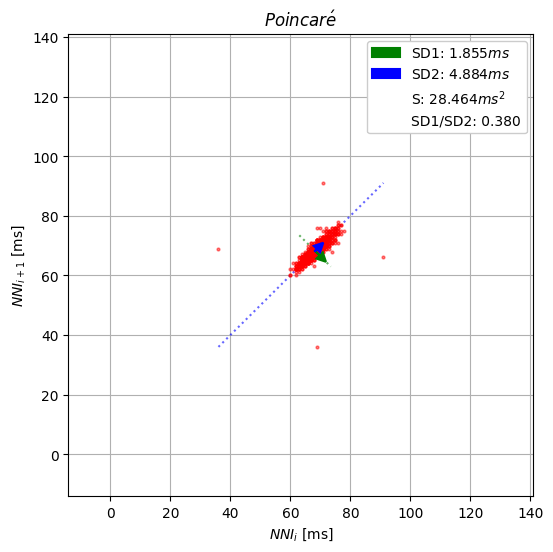

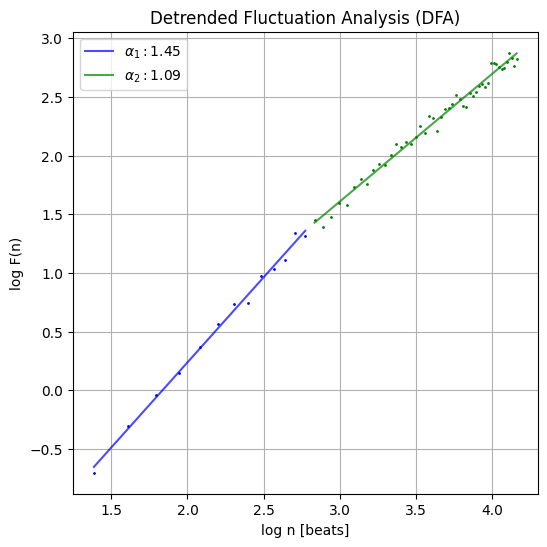

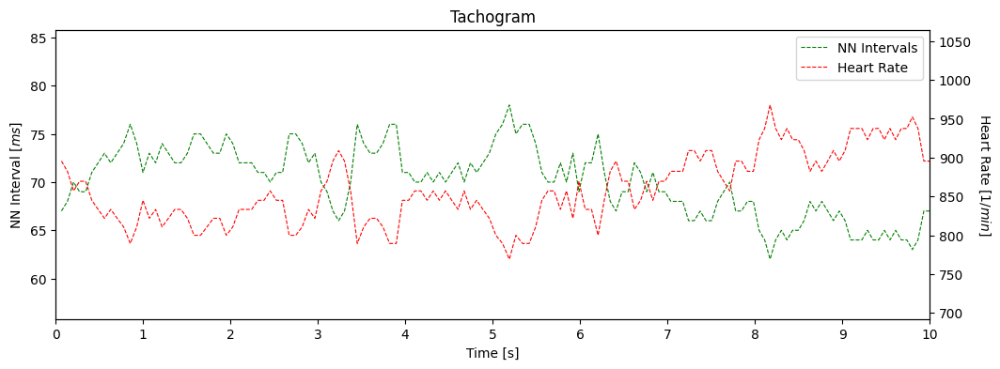

프로토콜: 3.0 MA


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/utils.py:367: UserWarning: Signal duration is to short for segmentation into 300000s. Input data will be returned.
  warnings.warn("Signal duration is to short for segmentation into %is. Input data will be returned." % duration)
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:303: UserWarning: Signal duration too short for SDANN computation.
  warnings.warn("Signal duration too short for SDANN computation.")
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:576: UserWarning: CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a malfunction of the function. This function will be reviewed over the next updates to solve this issue
  warnings.warn('CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a '


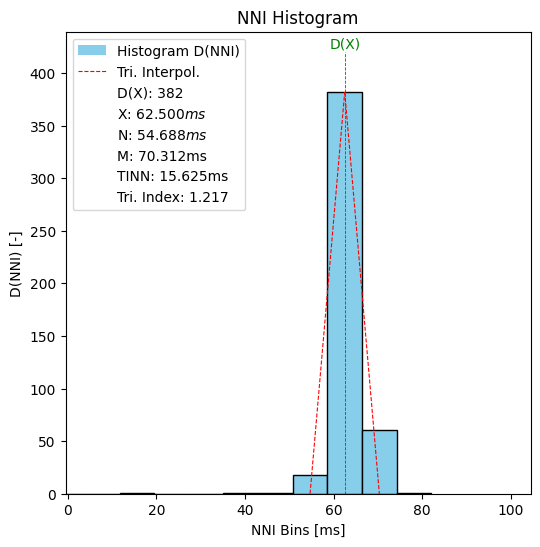

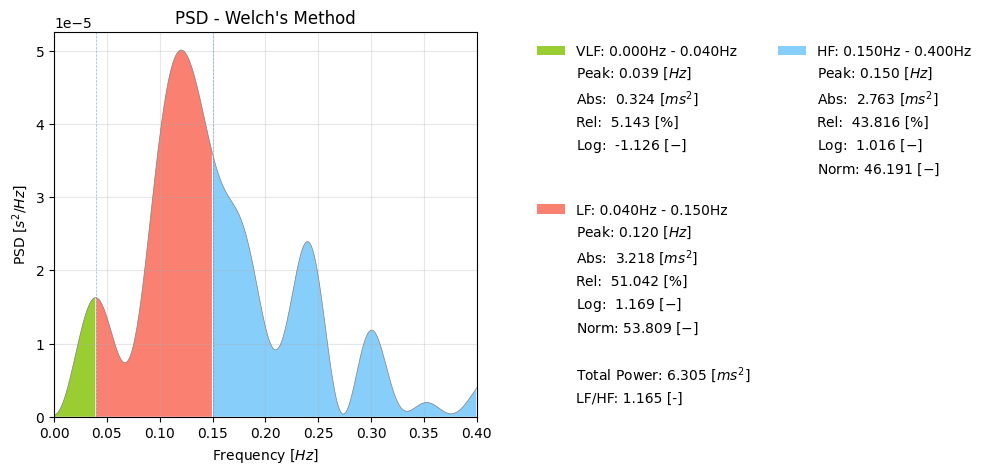

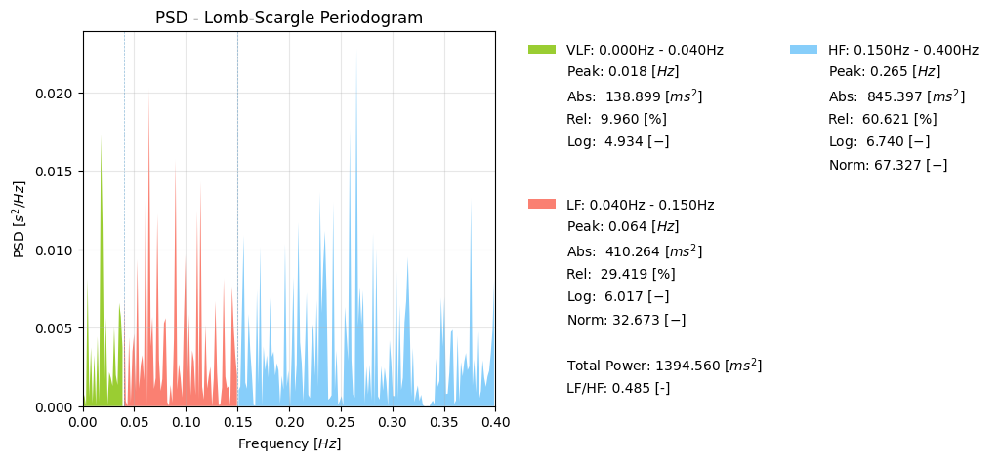

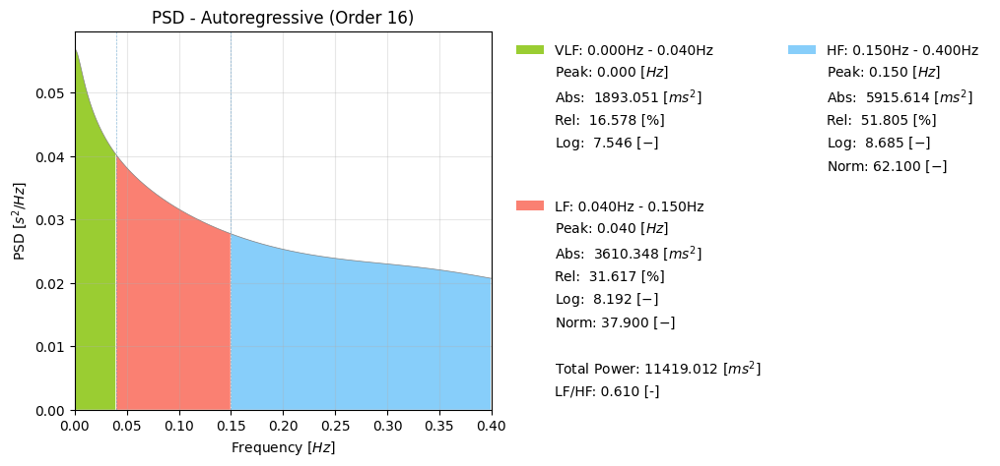

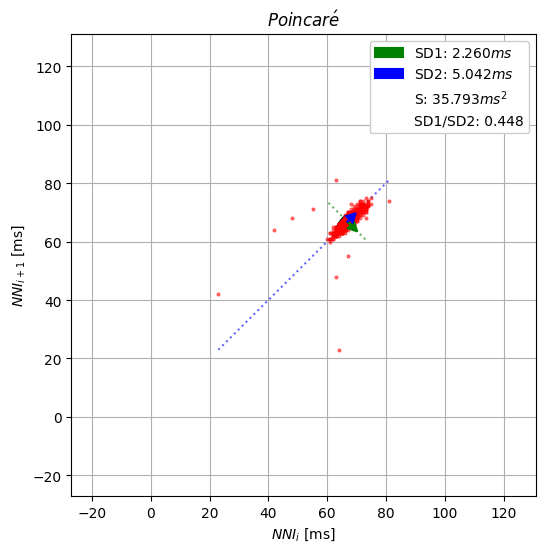

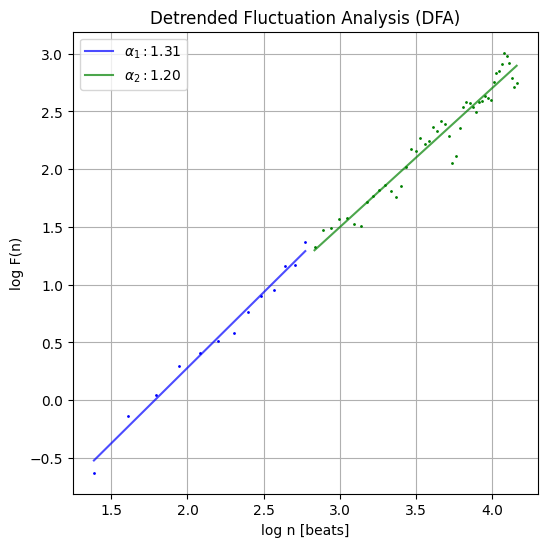

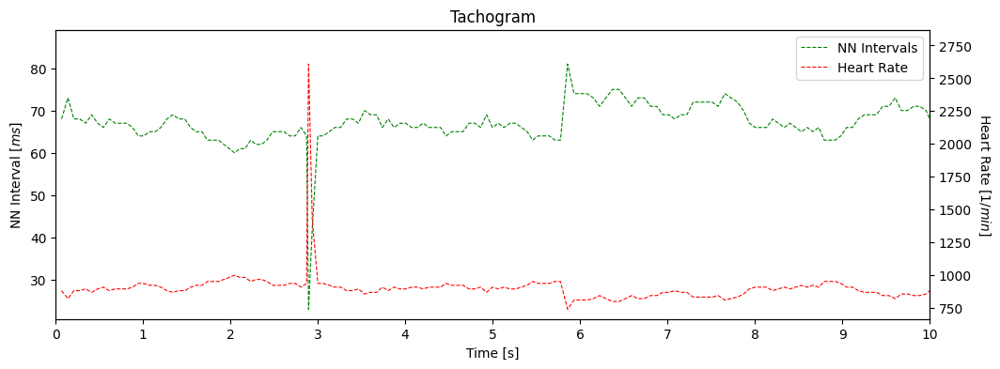

(M)018_20230507_100932_H10.csv
Value is nan
프로토콜: 1.0 BASELINE


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/utils.py:367: UserWarning: Signal duration is to short for segmentation into 300000s. Input data will be returned.
  warnings.warn("Signal duration is to short for segmentation into %is. Input data will be returned." % duration)
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:303: UserWarning: Signal duration too short for SDANN computation.
  warnings.warn("Signal duration too short for SDANN computation.")
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:576: UserWarning: CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a malfunction of the function. This function will be reviewed over the next updates to solve this issue
  warnings.warn('CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a '


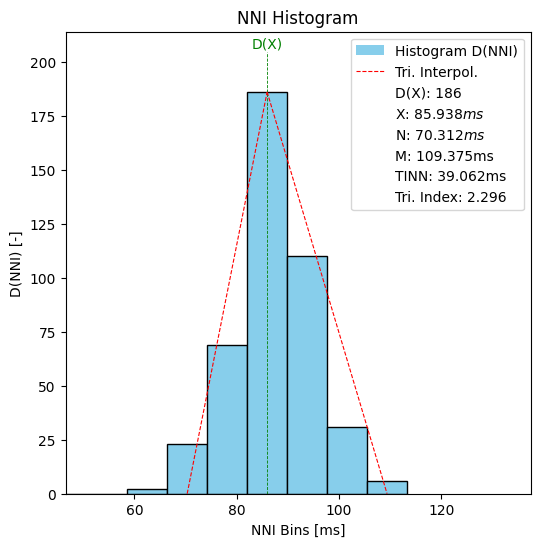

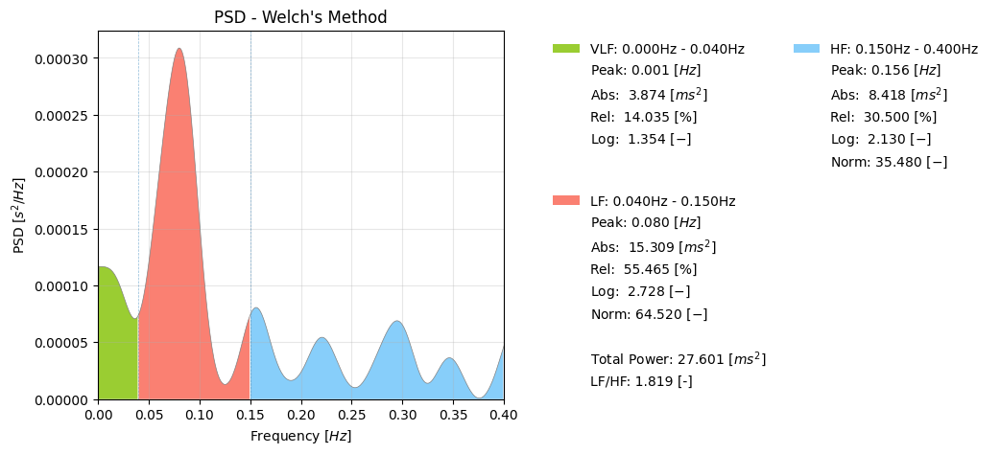

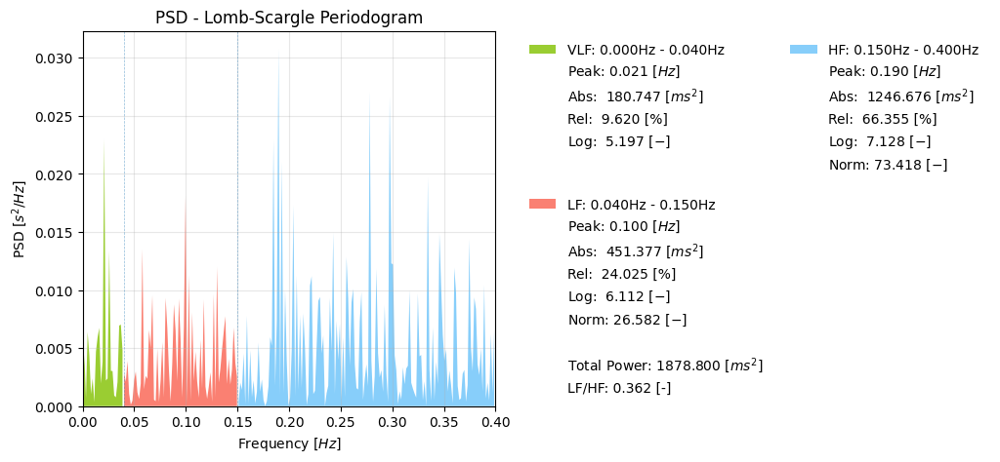

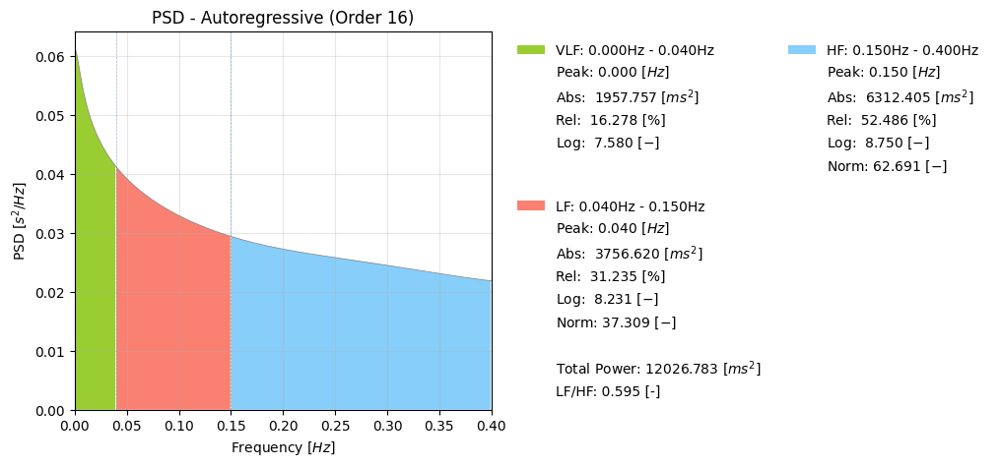

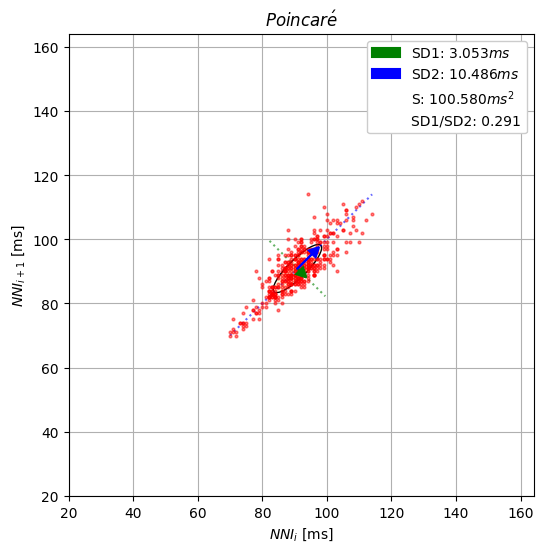

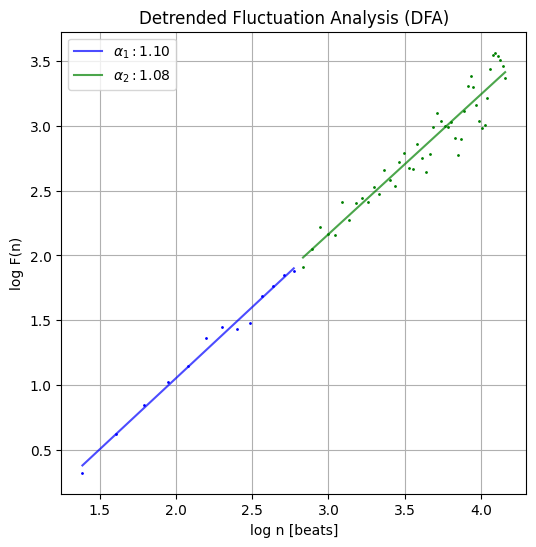

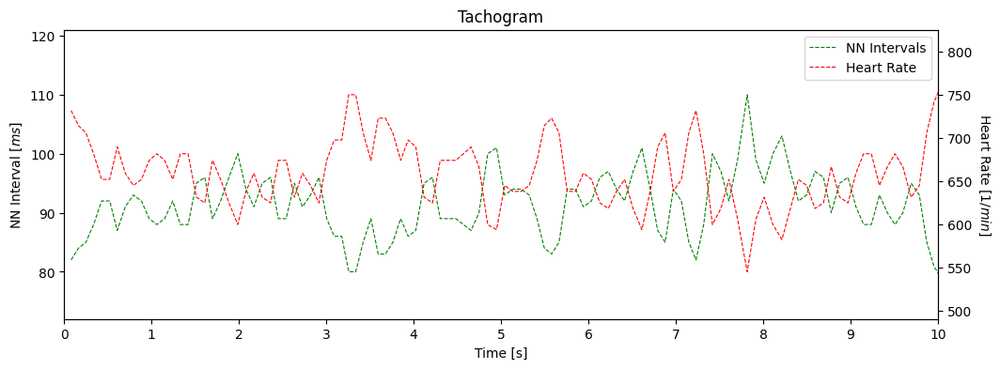

프로토콜: 2.0 HIT


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/utils.py:367: UserWarning: Signal duration is to short for segmentation into 300000s. Input data will be returned.
  warnings.warn("Signal duration is to short for segmentation into %is. Input data will be returned." % duration)
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:303: UserWarning: Signal duration too short for SDANN computation.
  warnings.warn("Signal duration too short for SDANN computation.")
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:576: UserWarning: CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a malfunction of the function. This function will be reviewed over the next updates to solve this issue
  warnings.warn('CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a '


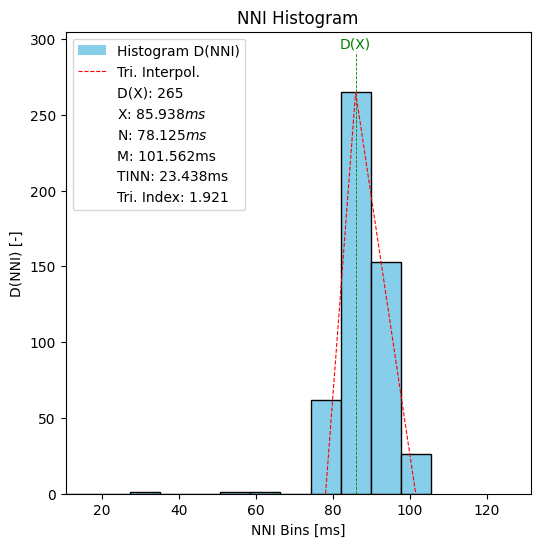

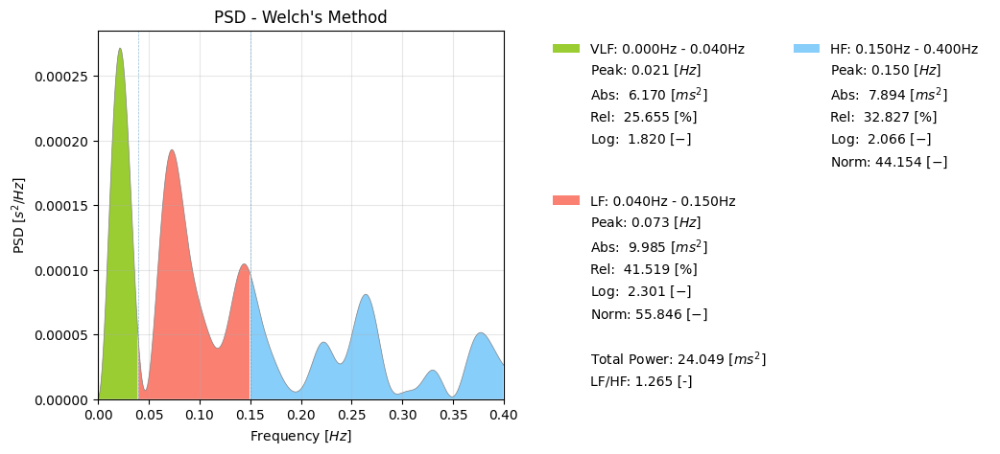

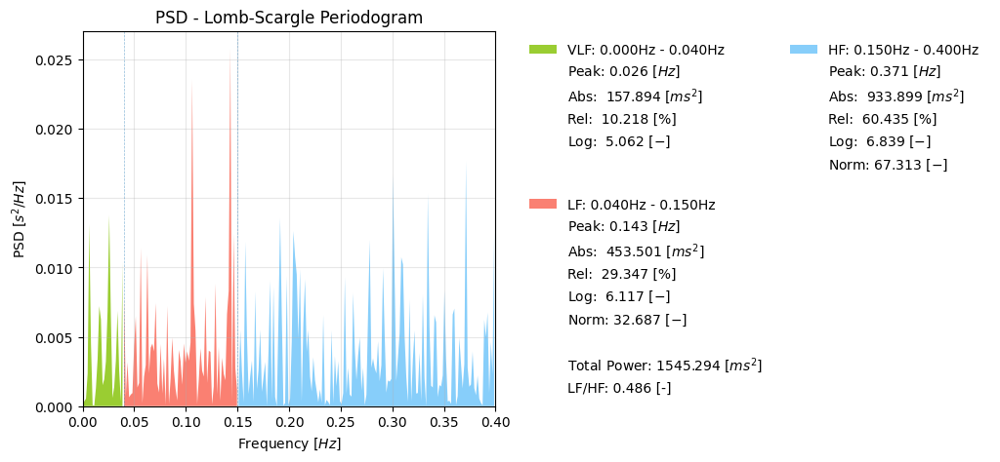

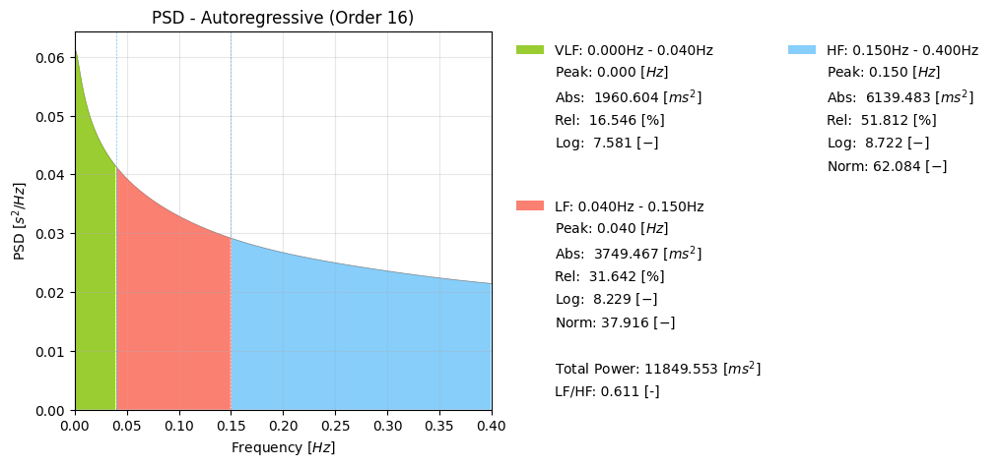

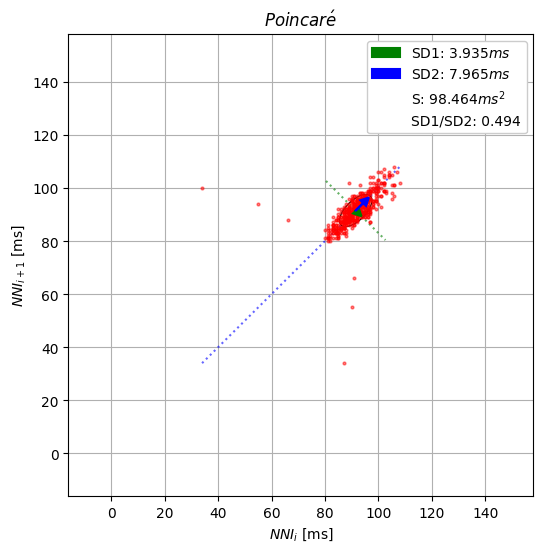

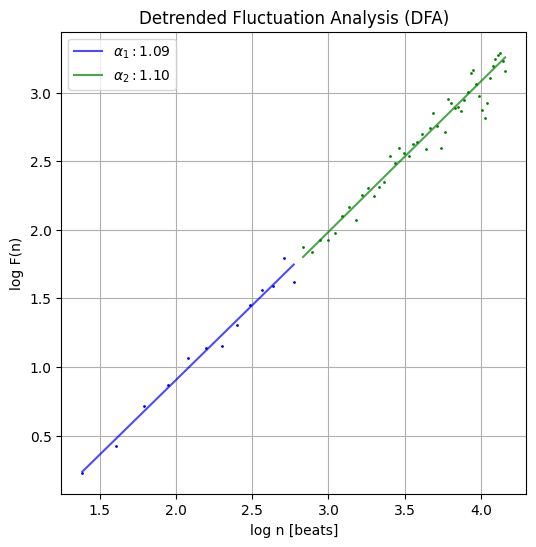

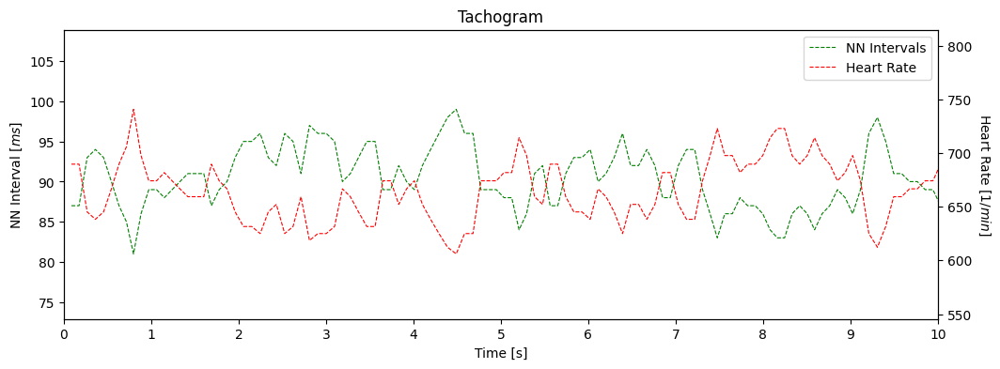

프로토콜: 3.0 MA


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/utils.py:367: UserWarning: Signal duration is to short for segmentation into 300000s. Input data will be returned.
  warnings.warn("Signal duration is to short for segmentation into %is. Input data will be returned." % duration)
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:303: UserWarning: Signal duration too short for SDANN computation.
  warnings.warn("Signal duration too short for SDANN computation.")
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:576: UserWarning: CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a malfunction of the function. This function will be reviewed over the next updates to solve this issue
  warnings.warn('CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a '


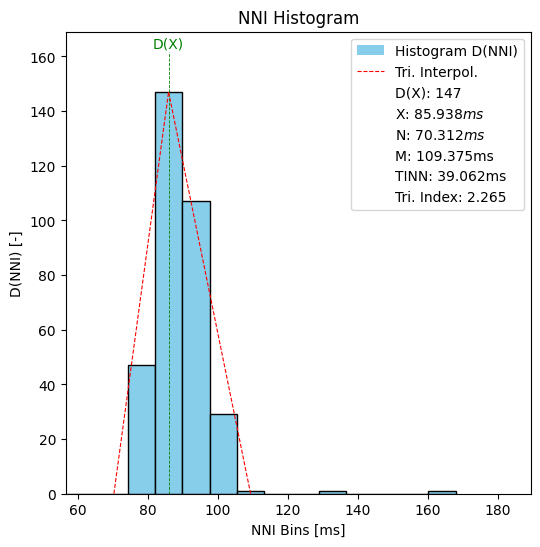

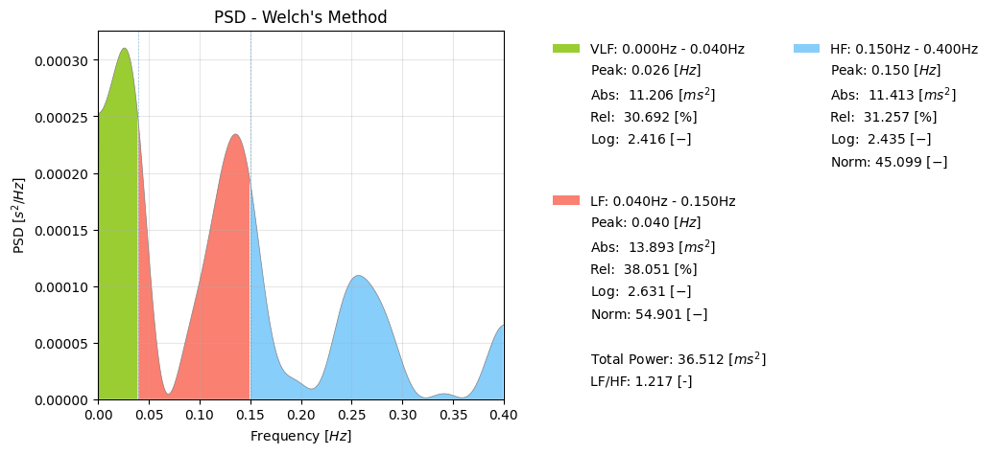

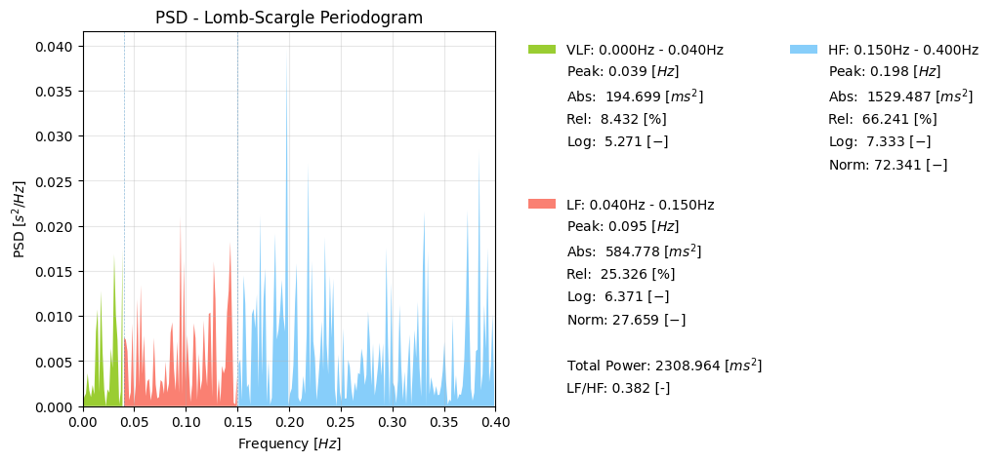

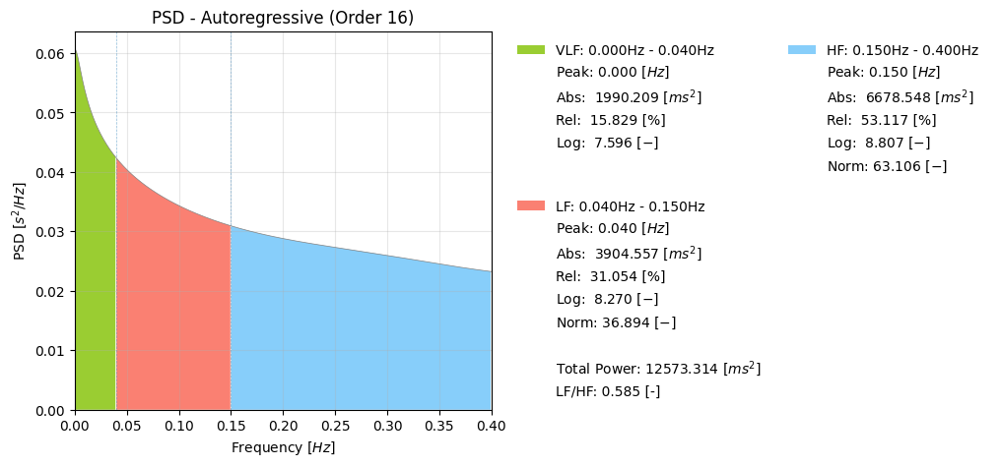

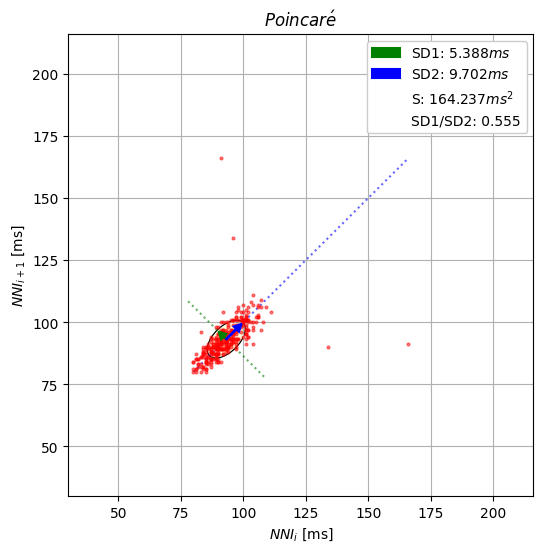

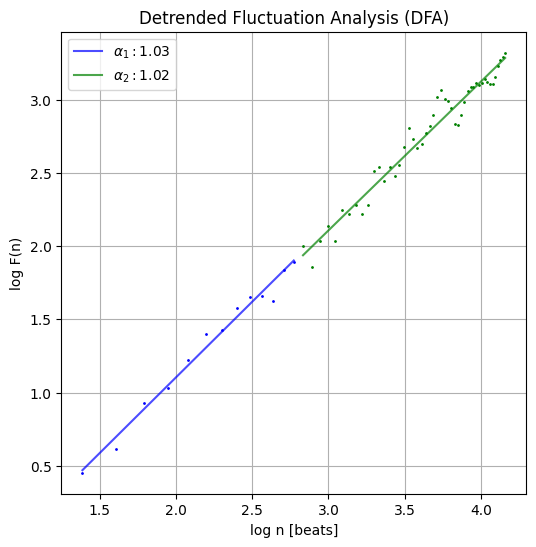

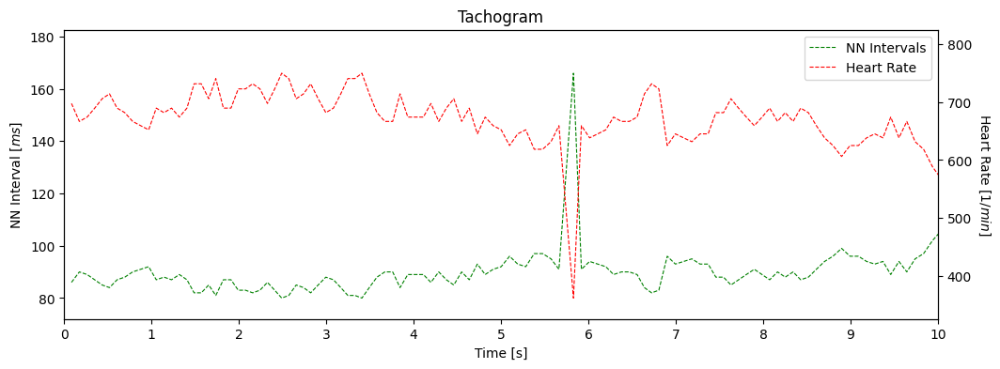

(M)019_20230507_101420_H10.csv
Value is nan
프로토콜: 1.0 BASELINE


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/utils.py:367: UserWarning: Signal duration is to short for segmentation into 300000s. Input data will be returned.
  warnings.warn("Signal duration is to short for segmentation into %is. Input data will be returned." % duration)
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:303: UserWarning: Signal duration too short for SDANN computation.
  warnings.warn("Signal duration too short for SDANN computation.")
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:576: UserWarning: CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a malfunction of the function. This function will be reviewed over the next updates to solve this issue
  warnings.warn('CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a '


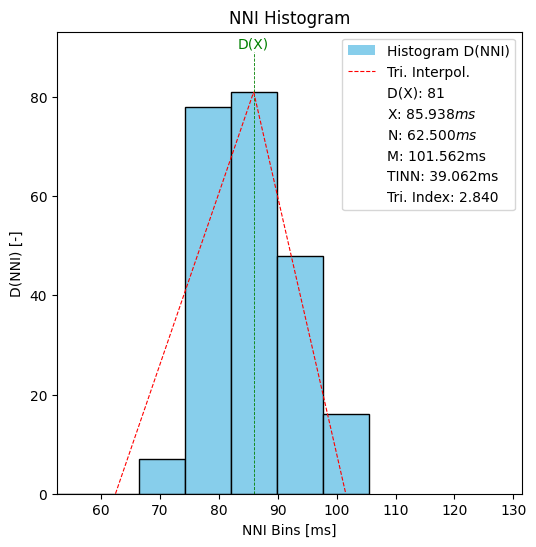

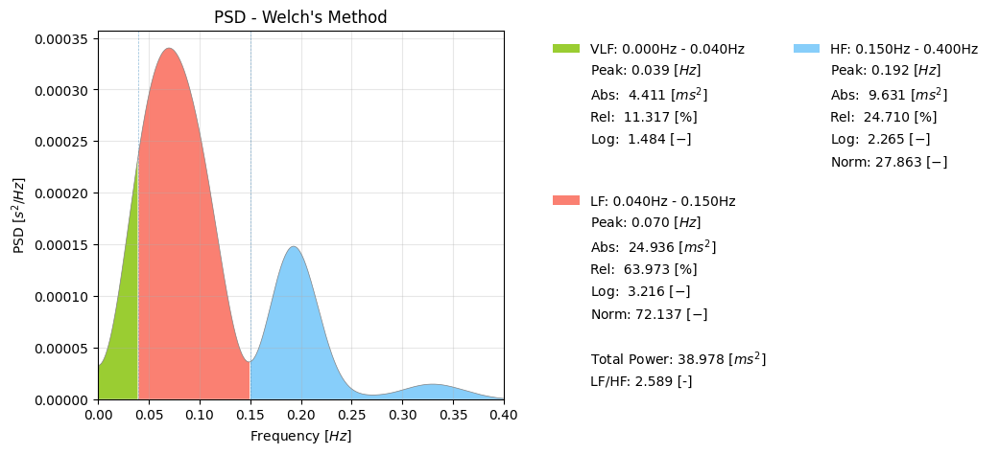

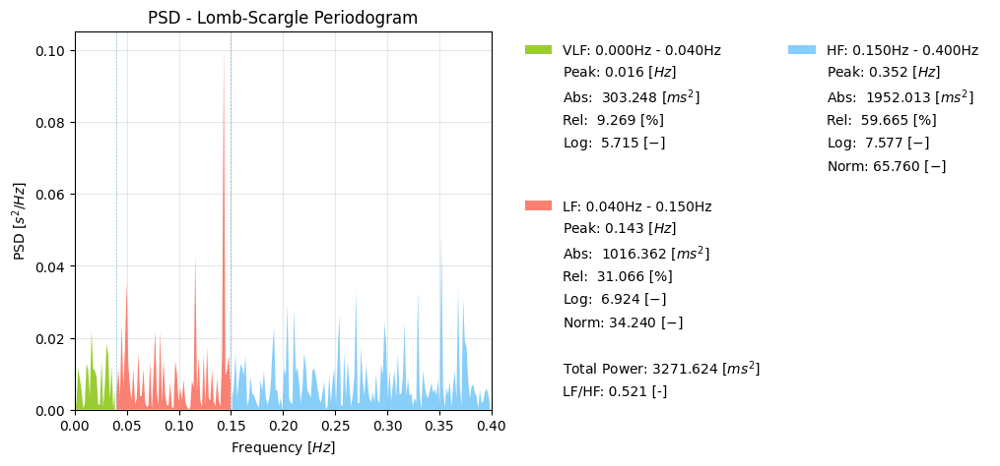

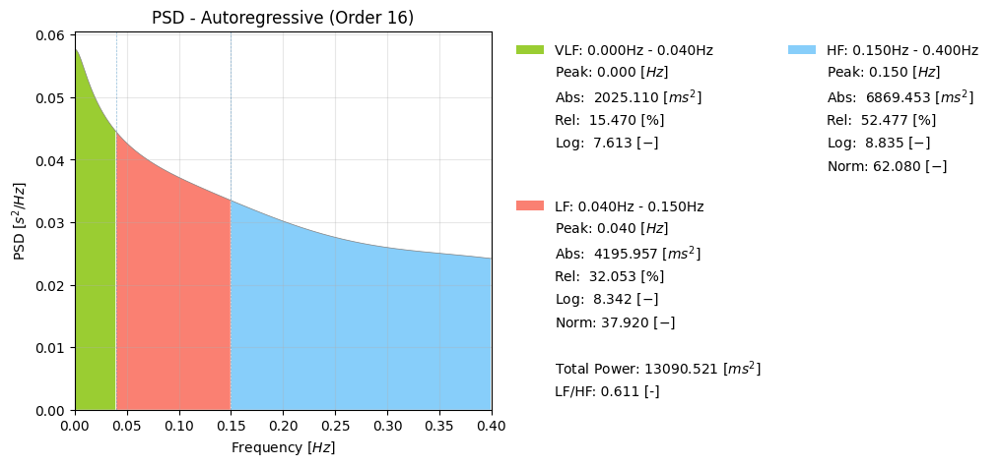

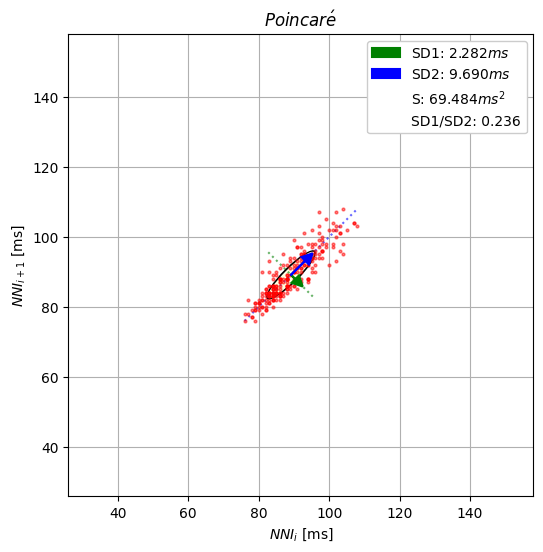

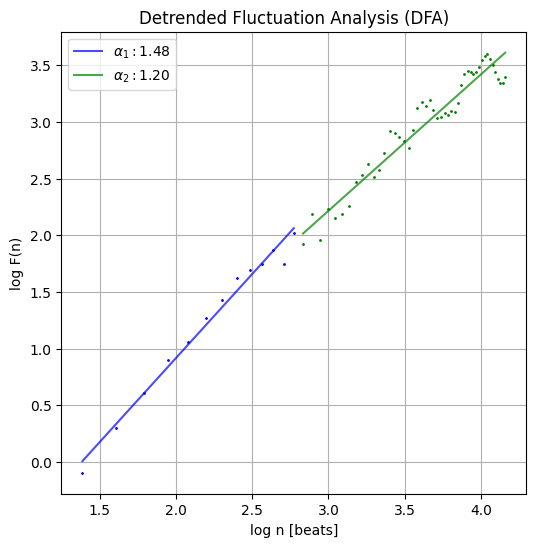

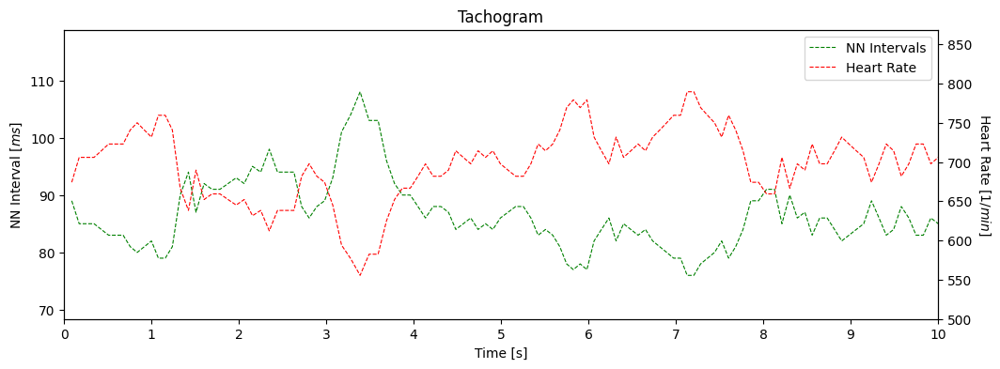

프로토콜: 2.0 HIT


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/utils.py:367: UserWarning: Signal duration is to short for segmentation into 300000s. Input data will be returned.
  warnings.warn("Signal duration is to short for segmentation into %is. Input data will be returned." % duration)
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:303: UserWarning: Signal duration too short for SDANN computation.
  warnings.warn("Signal duration too short for SDANN computation.")
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:576: UserWarning: CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a malfunction of the function. This function will be reviewed over the next updates to solve this issue
  warnings.warn('CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a '


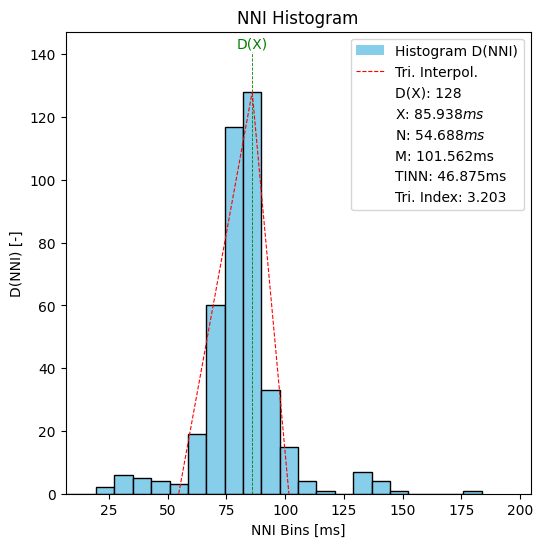

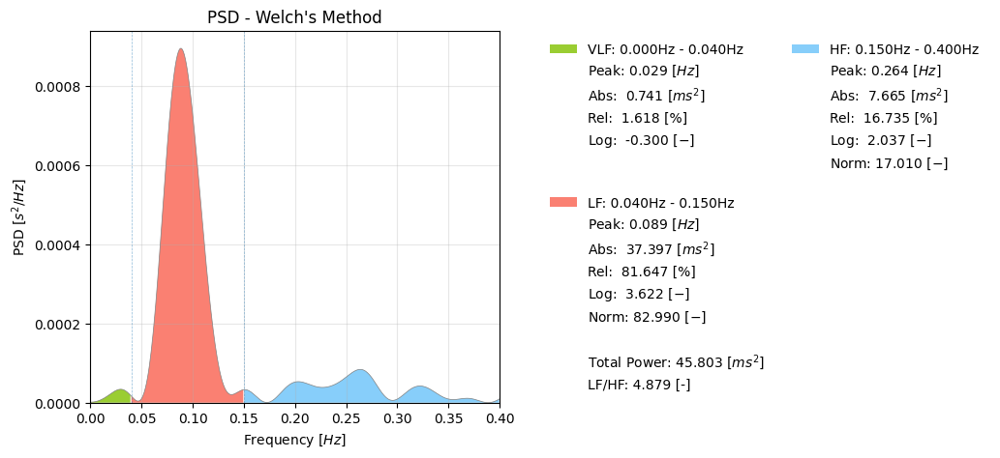

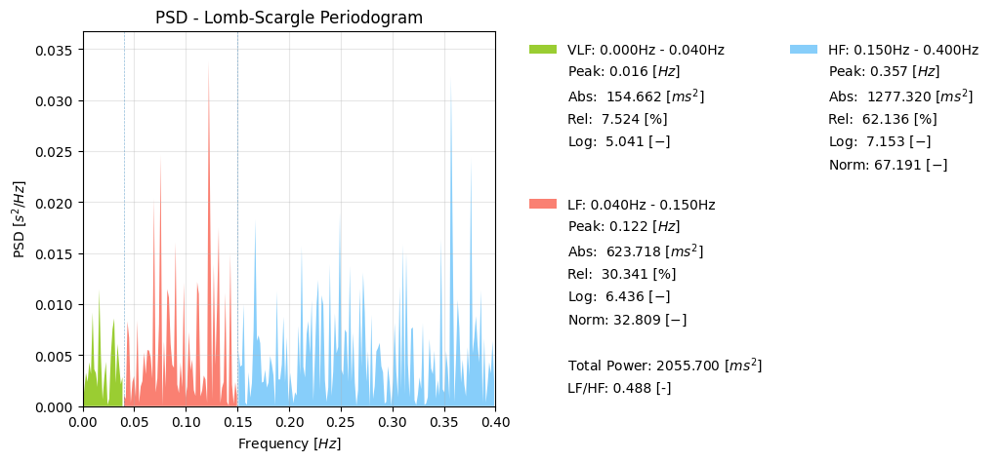

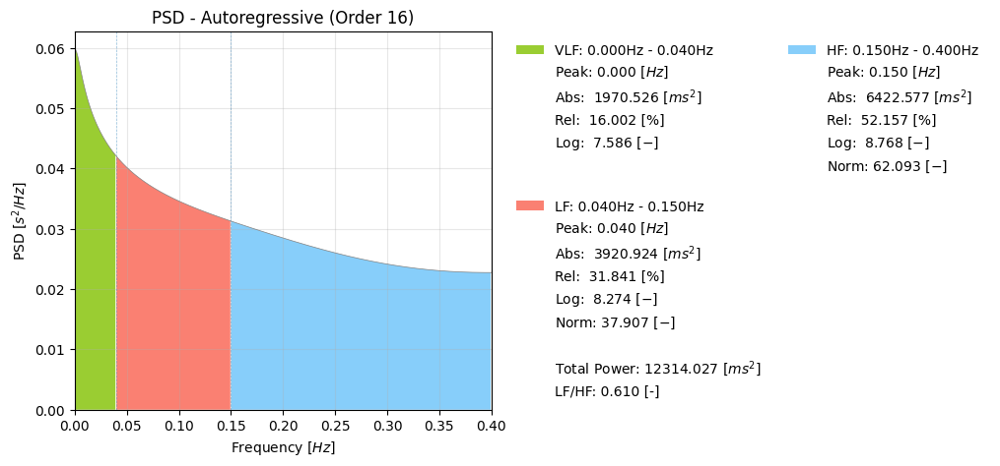

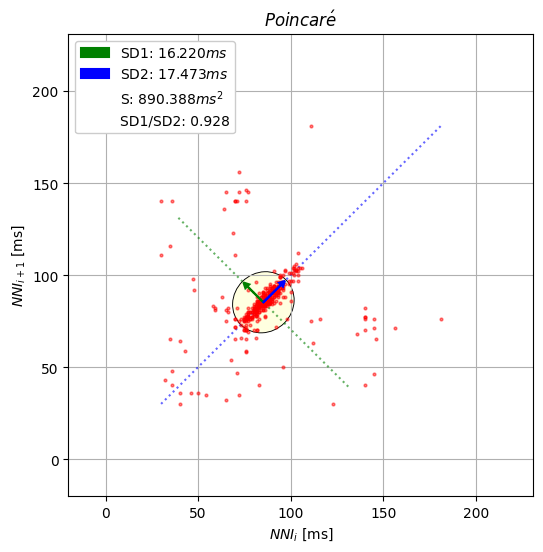

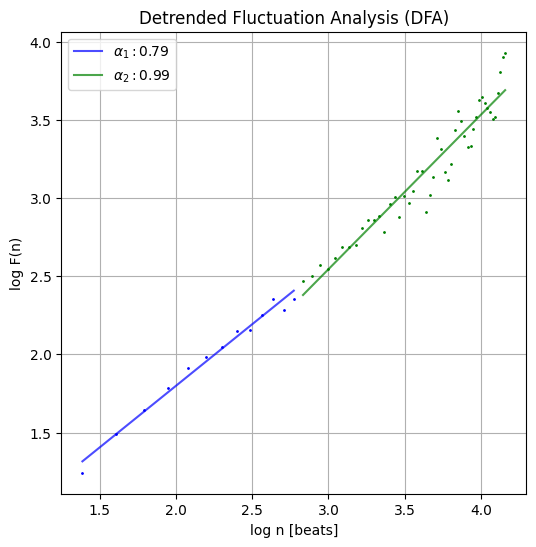

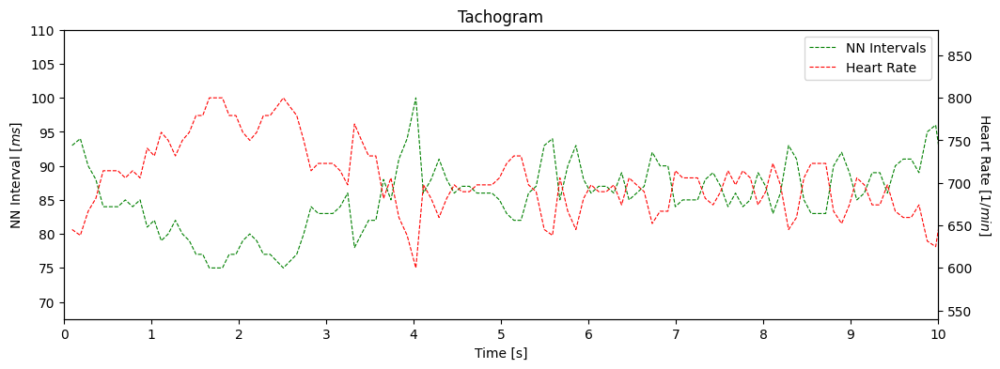

프로토콜: 3.0 MA


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/utils.py:367: UserWarning: Signal duration is to short for segmentation into 300000s. Input data will be returned.
  warnings.warn("Signal duration is to short for segmentation into %is. Input data will be returned." % duration)
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:303: UserWarning: Signal duration too short for SDANN computation.
  warnings.warn("Signal duration too short for SDANN computation.")
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:576: UserWarning: CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a malfunction of the function. This function will be reviewed over the next updates to solve this issue
  warnings.warn('CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a '


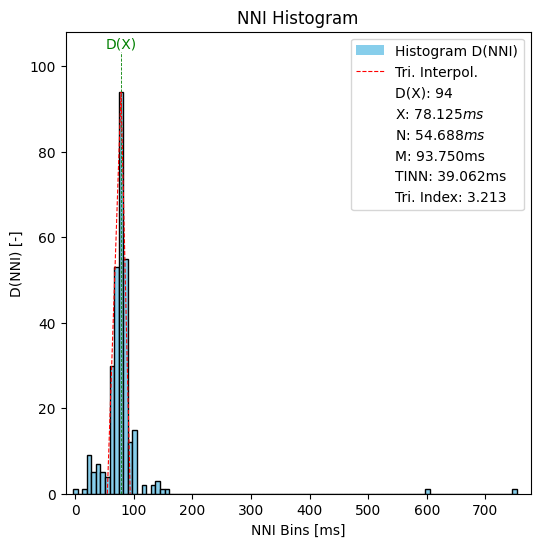

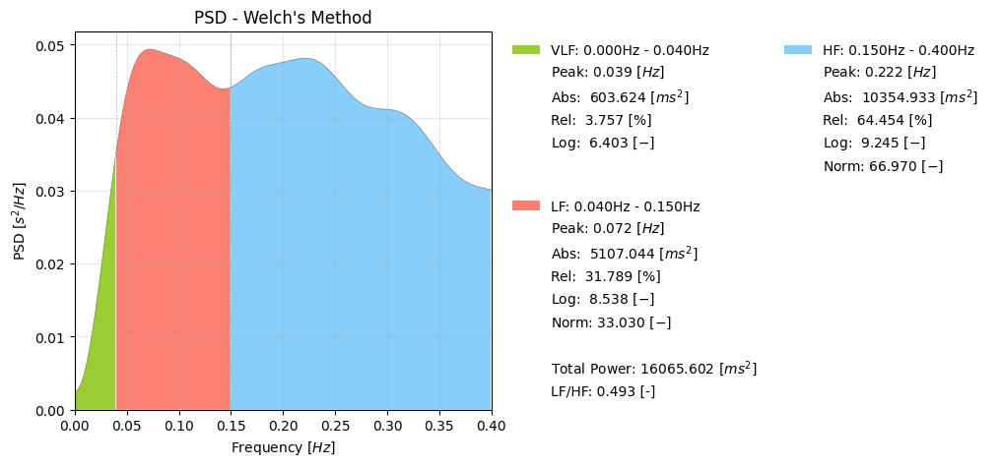

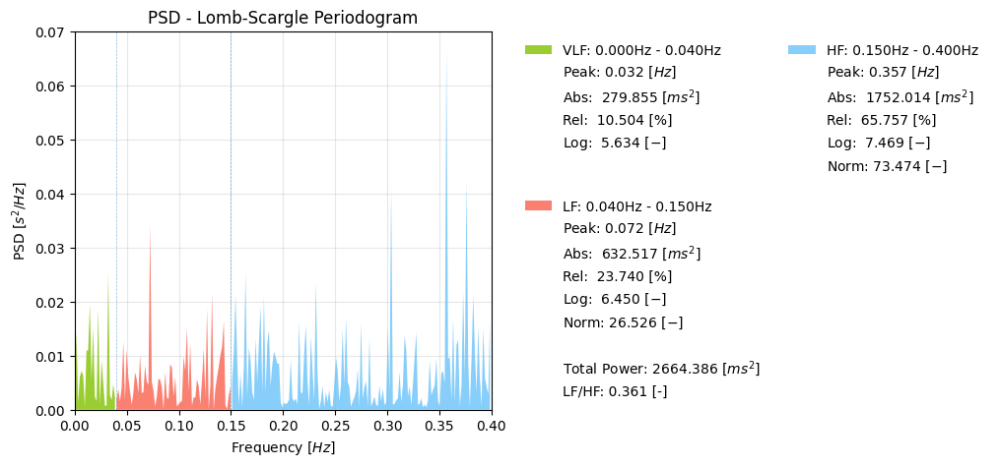

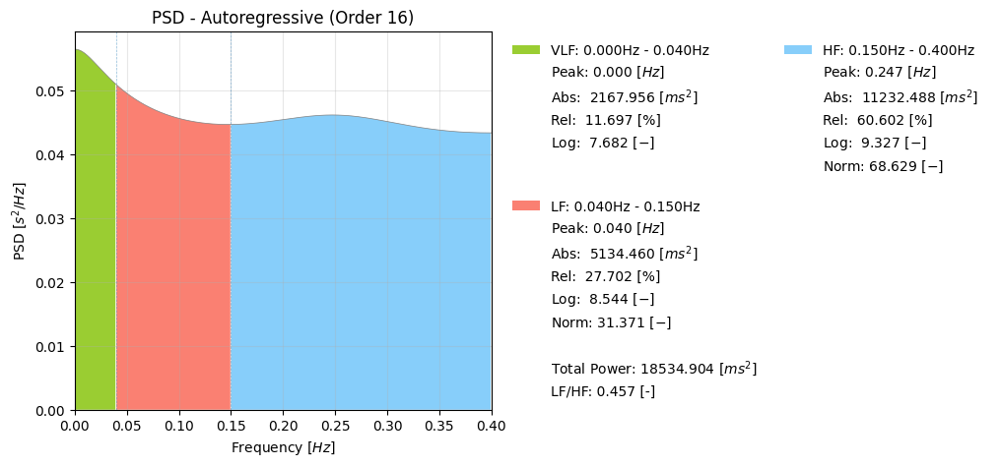

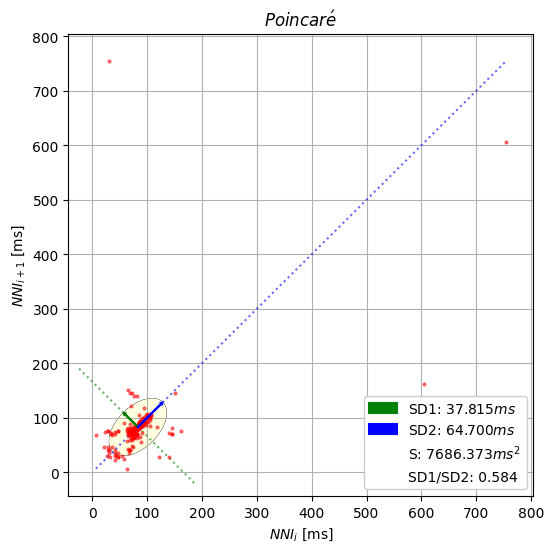

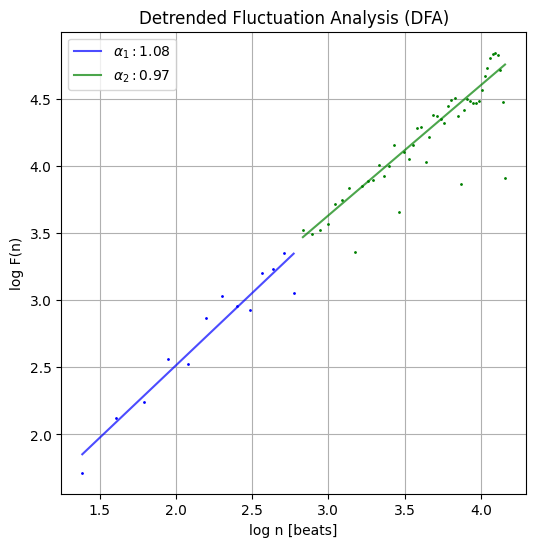

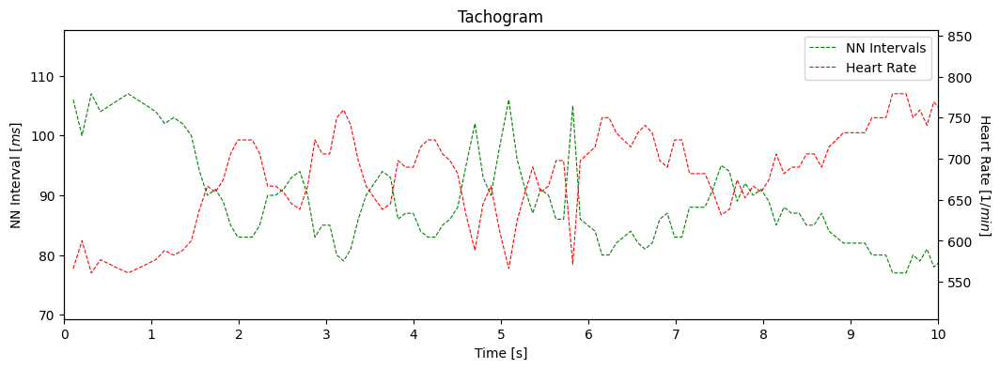

(M)020_20230507_122941_H10.csv
Value is nan
프로토콜: 1.0 BASELINE


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/utils.py:367: UserWarning: Signal duration is to short for segmentation into 300000s. Input data will be returned.
  warnings.warn("Signal duration is to short for segmentation into %is. Input data will be returned." % duration)
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:303: UserWarning: Signal duration too short for SDANN computation.
  warnings.warn("Signal duration too short for SDANN computation.")
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:576: UserWarning: CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a malfunction of the function. This function will be reviewed over the next updates to solve this issue
  warnings.warn('CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a '


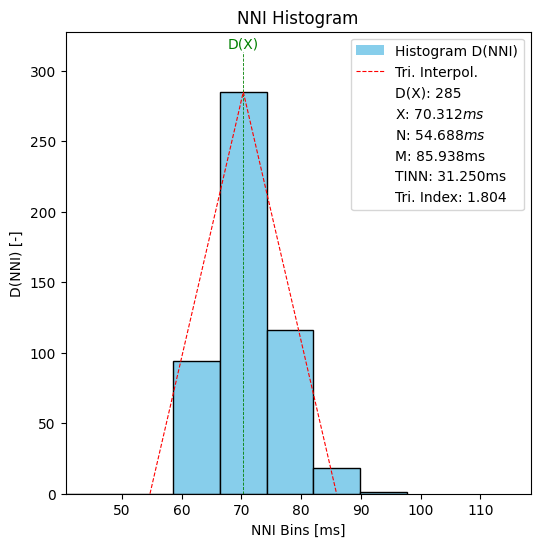

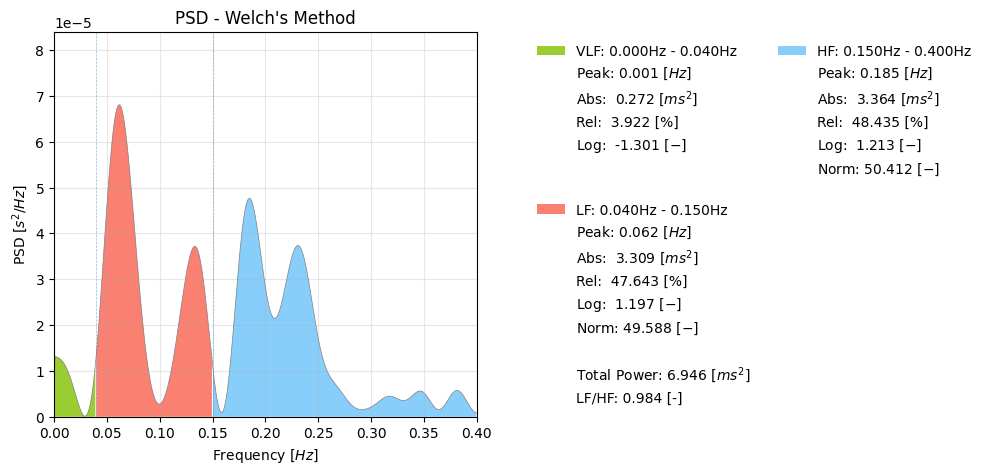

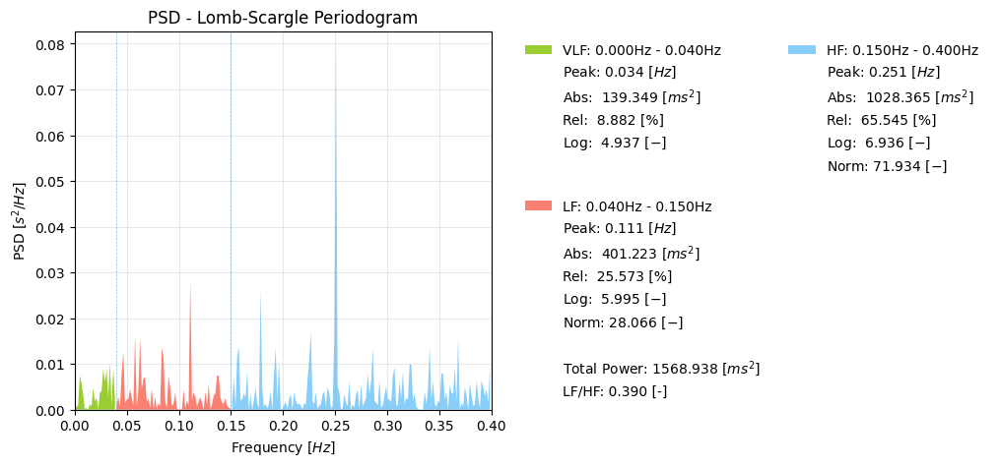

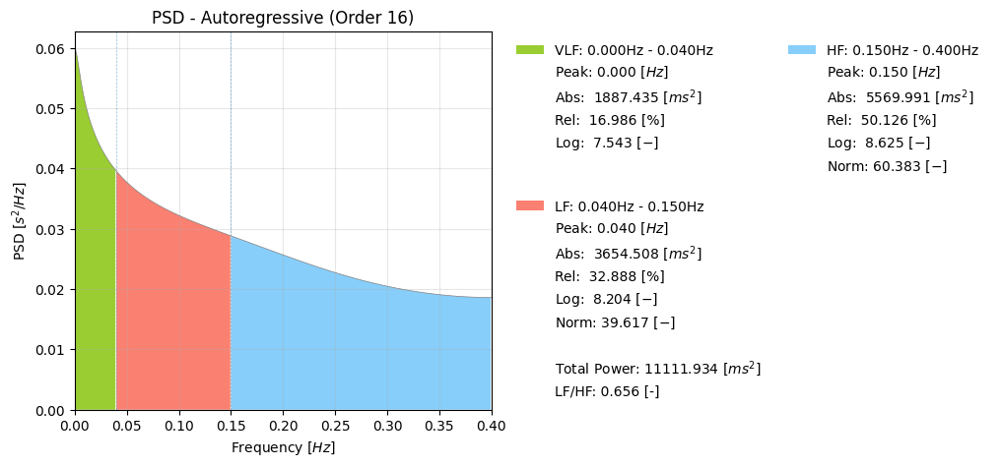

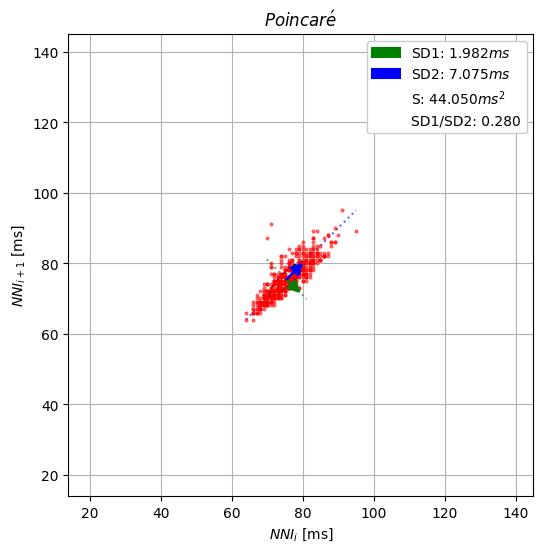

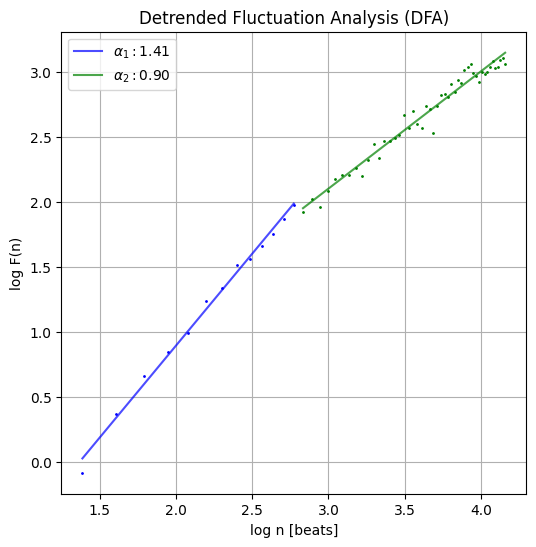

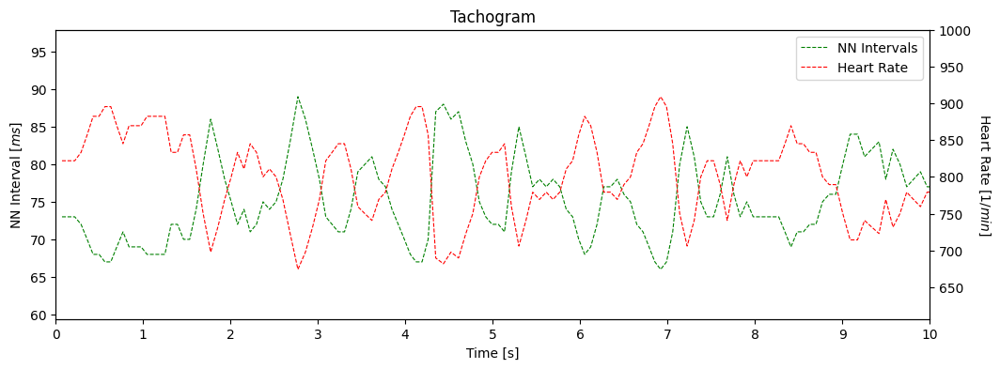

프로토콜: 2.0 HIT


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/utils.py:367: UserWarning: Signal duration is to short for segmentation into 300000s. Input data will be returned.
  warnings.warn("Signal duration is to short for segmentation into %is. Input data will be returned." % duration)
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:303: UserWarning: Signal duration too short for SDANN computation.
  warnings.warn("Signal duration too short for SDANN computation.")
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:576: UserWarning: CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a malfunction of the function. This function will be reviewed over the next updates to solve this issue
  warnings.warn('CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a '


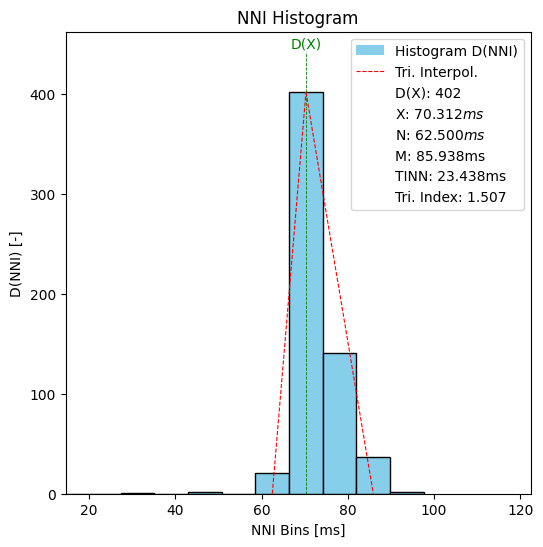

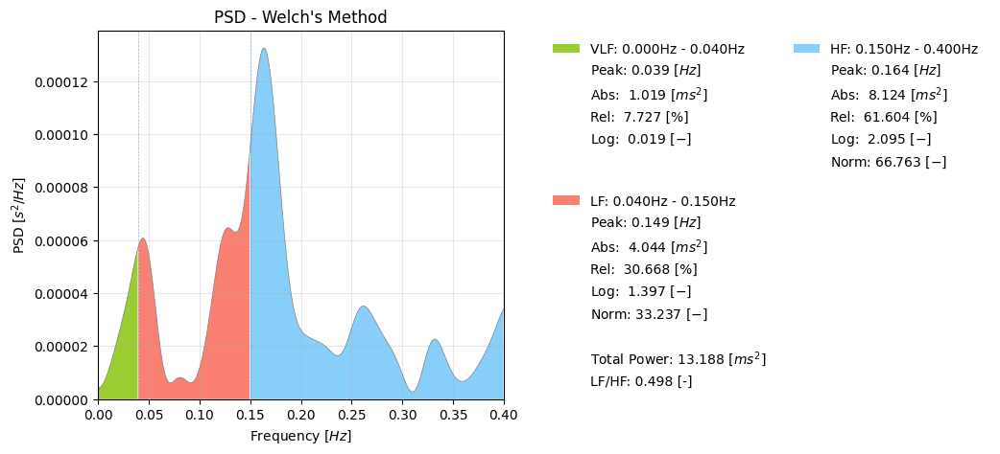

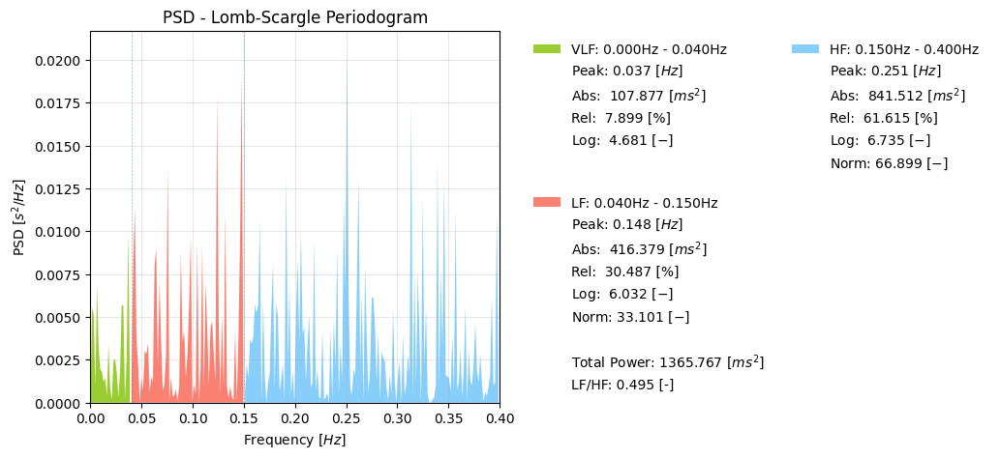

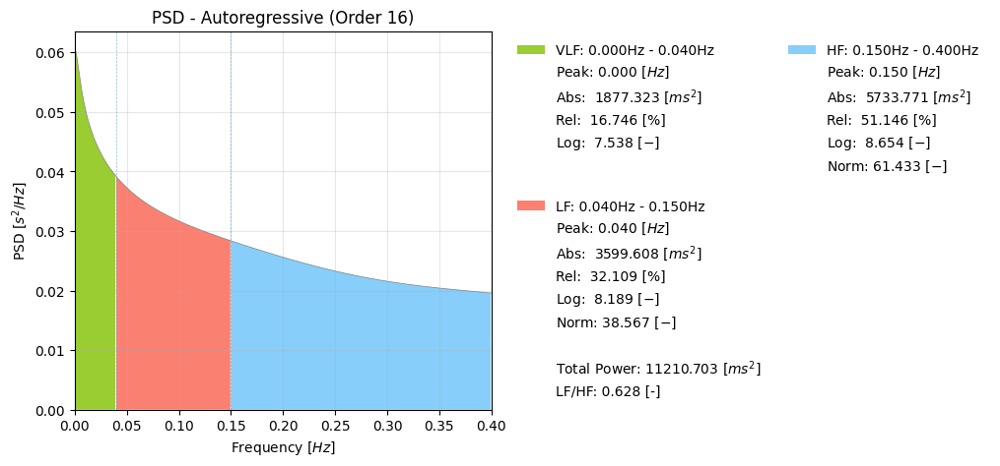

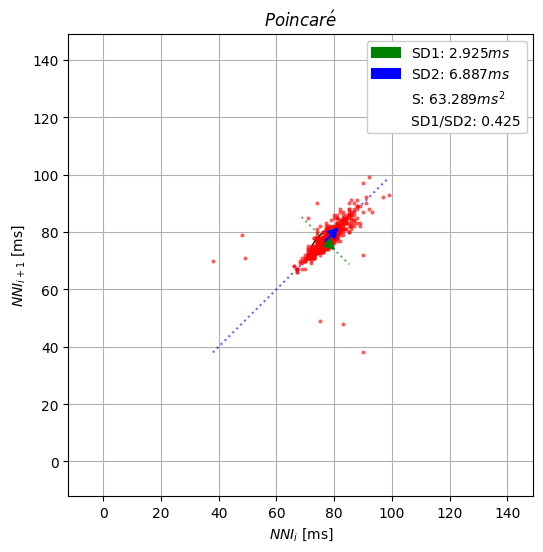

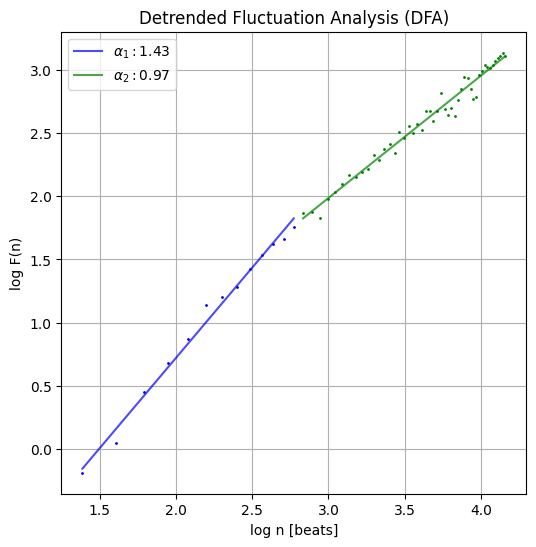

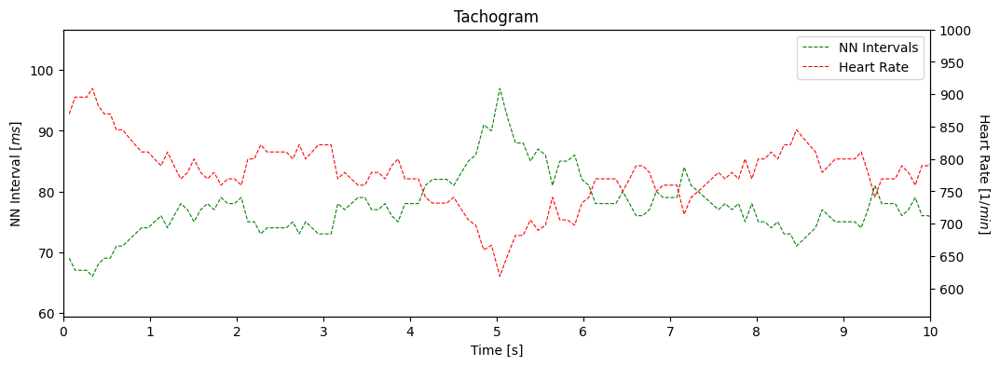

프로토콜: 3.0 MA


/home/pilab/.local/lib/python3.10/site-packages/pyhrv/utils.py:367: UserWarning: Signal duration is to short for segmentation into 300000s. Input data will be returned.
  warnings.warn("Signal duration is to short for segmentation into %is. Input data will be returned." % duration)
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:303: UserWarning: Signal duration too short for SDANN computation.
  warnings.warn("Signal duration too short for SDANN computation.")
/home/pilab/.local/lib/python3.10/site-packages/pyhrv/time_domain.py:576: UserWarning: CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a malfunction of the function. This function will be reviewed over the next updates to solve this issue
  warnings.warn('CAUTION: The TINN computation is currently providing incorrect results in the most cases due to a '


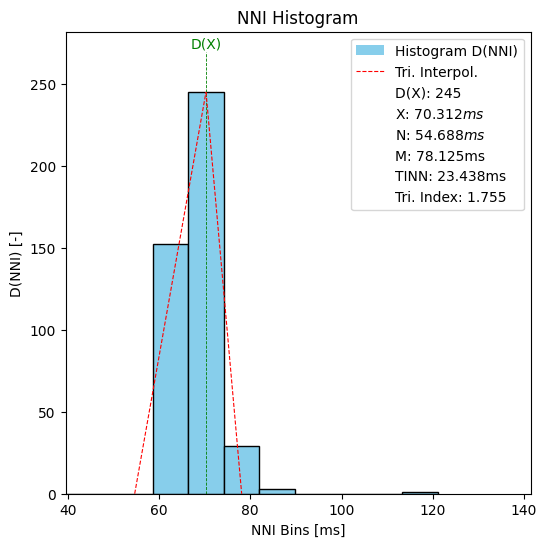

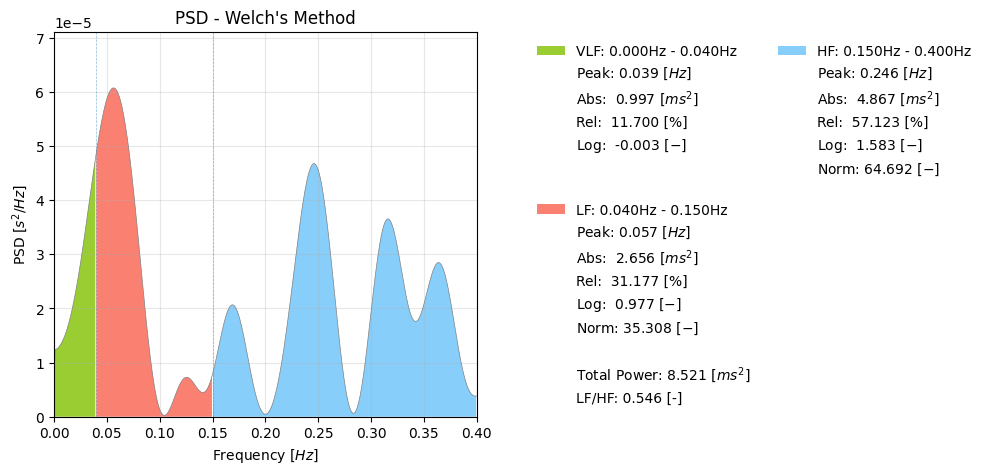

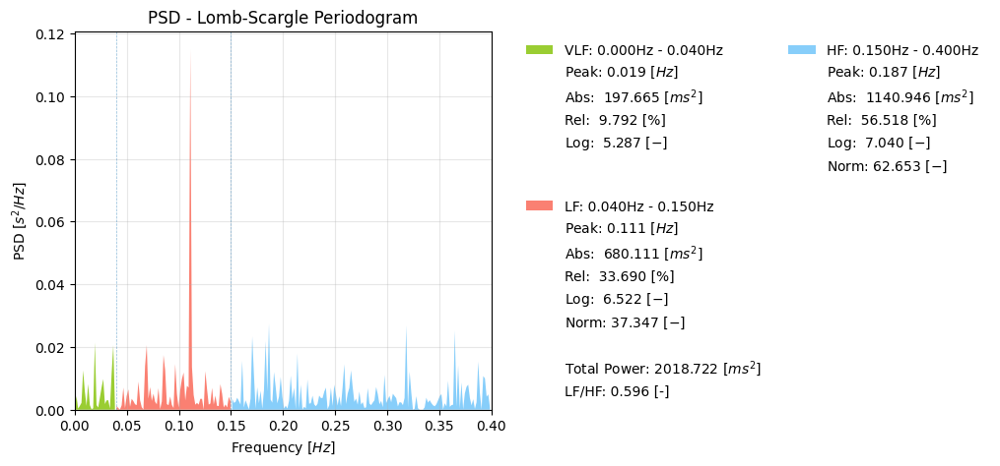

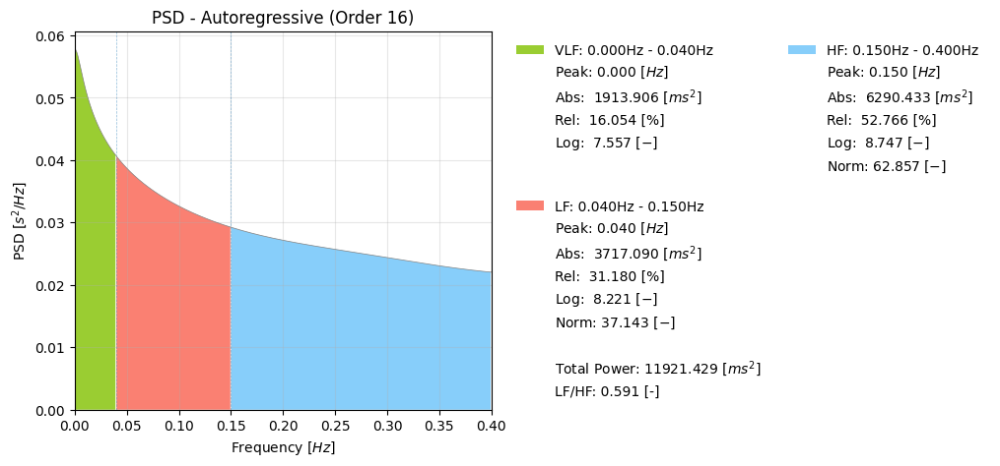

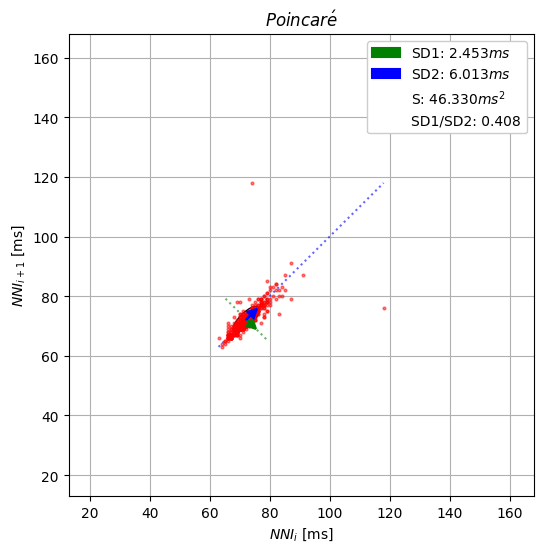

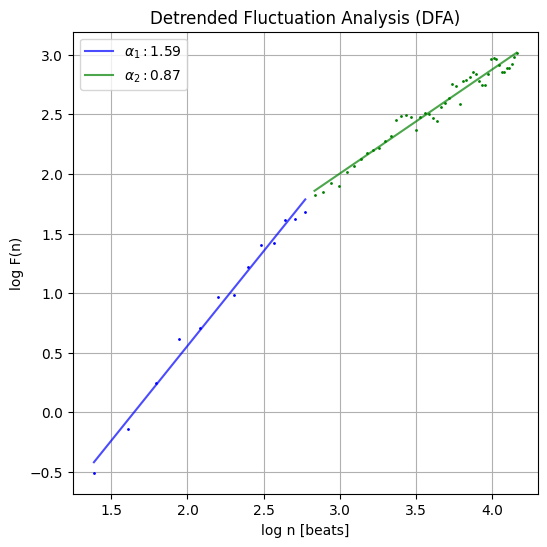

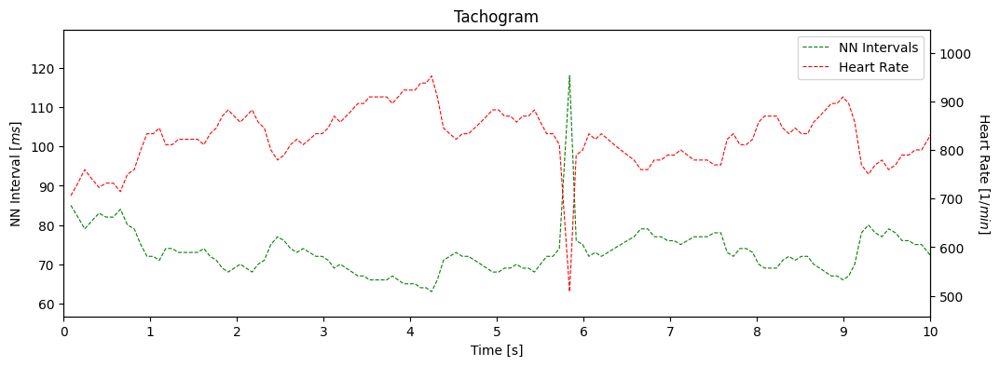

In [73]:
for i in mast_h10_dict:
    print(i)
    for p in mast_h10_dict[i]['proc'].unique():
        if np.isnan(p):
            print('Value is nan')
            continue
        else:
            print('프로토콜:', p, MAST_PROTOCOL_NAME[p])
            signal = mast_h10_dict[i][mast_h10_dict[i]['proc'] == p]['sensor']
            try:
                signal, rpeaks = biosppy.signals.ecg.ecg(signal= signal, sampling_rate = 130, show=False)[1:3]
                nni = tools.nn_intervals(rpeaks)
                try:
                    hrv_result = pyhrv.hrv(nni=nni, 
                                               rpeaks=rpeaks, 
                                               # signal=signal, 
                                               sampling_rate=130., 
                                               interval=[0, 10], 
                                               plot_ecg=True, 
                                               plot_tachogram=True, 
                                               show=True, 
                                               fbands=None)
                except:
                    print('fail')
            except:
                print(' VALUE ERROR')
                print('-'*30)
                pass

            # tools.hrv_export(hrv_result, path= path+'/Stress_sensor_data_processing/mast_result_h10', plots = True)

In [ ]:
with gzip.open('h10_dicttask.pickle','rb') as f:
    df = pickle.load(f)

for i in resting_h10_dict:
    print(i)
    print(len(resting_h10_dict[i]))
    signal = resting_h10_dict[i]['sensor']
    signal, rpeaks = biosppy.signals.ecg.ecg(signal= signal, 
                                             sampling_rate = 130, 
                                             show=False)[1:3]
    nni = tools.nn_intervals(rpeaks)
    result = td.time_domain(nni)
    for i in result.keys():
        print(f'{i}: {result[i]}', )